In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re
from DataLoader import *
import datetime
import random
import warnings
from VocalFeatureExtractor import VocalFeatureExtractor
from BehaviourAnnotation import *
from BehaviourFeatureExtractor import *
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
import pprint
from matplotlib.collections import LineCollection
from colour import Color
import copy

# Data loading #

In [2]:
data_dir = "data/"
DL = DataLoader(data_dir, path_to_config_file="config.json")
BF = BehaviourFeatureExtractor("config.json")
VF = VocalFeatureExtractor("config.json")

### Exporting processsed data together with pup cluster labels ###

In [ ]:
# mouse_ids = [mouse_id for mouse_id in os.listdir(data_dir) if os.path.isdir(os.path.join(data_dir, mouse_id))]
# print("Mouse IDs:", mouse_ids)
# days = [f"d{i}" for i in range(1, 7)]
# print("Days:", days)

# experiment_data = DL.collect_and_process_experiment_data(mouse_ids, days, BF, VF,
#                                                         processed_data_dir = "processed_data",
#                                                         export = True)

### Loading processsed data together with pup cluster labels ###

In [3]:
processed_data_dir = "processed_data"
mouse_ids = ["MBI3793R", "MBI5336LL"]
mouse_ids = [mouse_id for mouse_id in os.listdir(processed_data_dir) if os.path.isdir(os.path.join(processed_data_dir, mouse_id)) and (mouse_id.startswith("M") or mouse_id.startswith("V"))]

print("Mouse IDs:", mouse_ids)
days = ["d1", "d2"]
days = [f"d{i}" for i in range(1, 7)]

experiment_data_processed = load_processed_data(processed_data_dir, mouse_ids, days)

Mouse IDs: ['MBQ0231R', 'MBI5336LL', 'MBQ0012RR', 'MBI5335RR', 'VBQ0253LL', 'VAC0143LLR', 'VBQ0261L', 'MBI3793R']


### Sanity checks ###

In [ ]:
for mouse_id in mouse_ids:
    for day in days:
        for trial_num in experiment_data_processed[mouse_id][day]["trials"]:
            print(mouse_id, day, trial_num)
            print((experiment_data_processed[mouse_id][day]["trials"][trial_num]["dlc_data"]["pupA_likelihood"] == 0.).sum())    
            print(experiment_data_processed[mouse_id][day]["trials"][trial_num]["pup_locations"])

In [ ]:
for mouse_id in mouse_ids:
    for day in days:
        for trial_num in experiment_data[mouse_id][day]["trials"]:
            print(mouse_id, day, trial_num)
            print((experiment_data[mouse_id][day]["trials"][trial_num]["dlc_data"]["pup_x"].isna()).sum())    
            #print(experiment_data[mouse_id][day]["trials"][trial_num]["pup_locations"])

# Annotation functions #

### Preliminary data loading ###

In [4]:
import copy

In [5]:
examples = [("MBI3793R", "d2", 4), ("MBI3793R", "d2", 7), ("MBI3793R", "d1", 9), ("MBI5336LL", "d1", 5), ]

info_dict = {key: {} for key in examples}

for example in examples:
    mouse_id, day, trial_num = example

    pup_locations = copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["pup_locations"])
    trial_df = copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["dlc_data"])
    df_summary = copy.deepcopy(experiment_data_processed[mouse_id][day]["Behavior"]["df_summary"])

    info_dict[example] = {
        "pup_locations": pup_locations,
        "trial_df": trial_df,
        "df_summary": df_summary
    }

    print("\n\n#### Example id: ", example)

    print("#### Pup locations:")
    pprint.pprint(info_dict[example]["pup_locations"])
    pup_x_col = "pup_x"
    pup_y_col = "pup_y"
    time_seconds_col = "time_seconds"

    print("#### First 5 rows of trial_df:")
    print(trial_df.head(5)[[pup_x_col, pup_y_col, time_seconds_col]])
    print("Total number of implausible pup locations: ", (trial_df[pup_x_col].isna() | trial_df[pup_y_col].isna()).sum())

    print("### First 5 rows of df_summary:")
    print(df_summary[["AnimalID", "ExptID", "TrialNum",  "MouseFirstPickUpPupSecs", "BehavRecdTrialEndSecs", "TrialDesignAchieved"]].head(5))




#### Example id:  ('MBI3793R', 'd2', 4)
#### Pup locations:
{'pup_location1': {'cluster_label': 0.0,
                   'end_time': 649.8666666666667,
                   'start_time': 637.5},
 'pup_location2': {'cluster_label': 1.0,
                   'end_time': 663.9333333333333,
                   'start_time': 653.6333333333333},
 'pup_location3': {'cluster_label': 2.0,
                   'end_time': 755.9333333333333,
                   'start_time': 675.7333333333333}}
#### First 5 rows of trial_df:
        pup_x       pup_y  time_seconds
0  240.509933  218.822327    637.500000
1  240.528488  218.544647    637.533333
2  241.790227  217.410787    637.566667
3  234.572144  220.763779    637.600000
4  241.862498  217.359609    637.633333
Total number of implausible pup locations:  553
### First 5 rows of df_summary:
   AnimalID ExptID  TrialNum  MouseFirstPickUpPupSecs  BehavRecdTrialEndSecs  \
0  MBI3793R     d2         1                  412.549                414.957   
1  MBI3

### Helper functions ###

In [6]:
def convert_seconds_to_frame(seconds, frame_rate = 30):
    return round(seconds*frame_rate)

def get_pick_up_time(df_summary, trial_num, BF):
        """
        Get the time when mouse first picked up pup for a given trial.
        
        Parameters:
        -----------
        df_summary : pandas DataFrame
            DataFrame containing summary data
        trial_num : int
            Trial number
        BF : object
            BehaviorFinder object containing configuration parameters
            
        Returns:
        --------
        float
            Time in seconds when mouse first picked up pup
        """
        trial_num_col = BF.config["DLC_summary_columns"]["trial_num"]
        pick_up_time_col = BF.config["DLC_summary_columns"]["mouse_first_pick_up"]
        pick_up_value = df_summary.loc[df_summary[trial_num_col] == trial_num, pick_up_time_col].values[0]
        
        if pd.isna(pick_up_value):
            return None
        else:
            return pick_up_value

def get_success_retrieval_time(df_summary, trial_num, BF):
    """
    Get the time when mouse successfully retrieved pup for a given trial.
    
    Parameters: 
    -----------
    df_summary : pandas DataFrame
        DataFrame containing summary data
    trial_num : int
        Trial number    
    BF : object
        BehaviorFinder object containing configuration parameters

    Returns:
    --------
    float
        Time in seconds when mouse successfully retrieved pup
    """
    trial_num_col = BF.config["DLC_summary_columns"]["trial_num"]
    success_col = BF.config["DLC_summary_columns"]["trial_success"]
    end_time_col = BF.config["DLC_summary_columns"]["trial_end"]

    success_value = df_summary.loc[df_summary[trial_num_col] == trial_num, success_col].values[0]
    
    if success_value == 1:
        return df_summary.loc[df_summary[trial_num_col] == trial_num, end_time_col].values[0]
    else:
        return None



### Creating default columns for states ###

In [9]:
### 0. create default columns for states ###

def create_default_columns(trial_df, BF, states = None):
    if states is None:
        states = ["sleeping", "carrying", "approach", "crouching", "retrieval",
                "active_interaction", "pickup", "drop", "walking"] # TODO: add states to config file
    # in_nest was already done
    for state in states:
        trial_df[state] = False

    print("\nTrial df:")
    print(trial_df[states + ["in_nest"]].head(3))

    return trial_df

# execution
states = ["sleeping", "carrying", "approach", "crouching", "retrieval",
                "active_interaction", "pickup", "drop", "walking"] # TODO: add states to config file
for example in examples:
    mouse_id, day, trial_num = example
    trial_df = info_dict[example]["trial_df"].copy()
    trial_df = create_default_columns(trial_df, BF)
    info_dict[example]["trial_df"] = trial_df

    print(trial_df[states + ["in_nest"]].head(3))



Trial df:
   sleeping  carrying  approach  crouching  retrieval  active_interaction  \
0     False     False     False      False      False               False   
1     False     False     False      False      False               False   
2     False     False     False      False      False               False   

   pickup   drop  walking  in_nest  
0   False  False    False     True  
1   False  False    False     True  
2   False  False    False     True  
   sleeping  carrying  approach  crouching  retrieval  active_interaction  \
0     False     False     False      False      False               False   
1     False     False     False      False      False               False   
2     False     False     False      False      False               False   

   pickup   drop  walking  in_nest  
0   False  False    False     True  
1   False  False    False     True  
2   False  False    False     True  

Trial df:
   sleeping  carrying  approach  crouching  retrieval  active_in

In [10]:
### 1. mark existing pick up times and success/retrieval times

def mark_existing_times(trial_df, df_summary, trial_num, BF):
    pick_up_col = "pickup"
    retrieval_col = "retrieval"

    # get pick up time
    pick_up_time = get_pick_up_time(df_summary, trial_num, BF)
    print(f"* Pick up time: {pick_up_time}")
    # get success retrieval time
    success_retrieval_time = get_success_retrieval_time(df_summary, trial_num, BF)
    print(f"* Success time: {success_retrieval_time}")

    if pick_up_time is not None:
        pick_up_frame = convert_seconds_to_frame(pick_up_time)
        print(f"---> Pick up frame: {pick_up_frame}, Start frame: {trial_df['frame_index'].min()}, End frame: {trial_df['frame_index'].max()}")
        trial_df.loc[trial_df["frame_index"] == pick_up_frame, pick_up_col] = True

    if success_retrieval_time is not None:
        retrieval_frame = convert_seconds_to_frame(success_retrieval_time)
        print(f"---> Retrieval frame: {retrieval_frame}; Start frame: {trial_df['frame_index'].min()}; End frame: {trial_df['frame_index'].max()}")
        end_frame = trial_df["frame_index"].max()
        final_frame = min(end_frame, retrieval_frame)
        print(f"---> Final frame: {final_frame}")
        trial_df.loc[(trial_df["frame_index"] == final_frame), retrieval_col] = True

    return trial_df

pick_up_col = "pickup"
retrieval_col = "retrieval"
for example in examples:
    print(f"\n ==== Example: {example} ==== ")
    mouse_id, day, trial_num = example
    trial_df = info_dict[example]["trial_df"].copy()
    trial_df = mark_existing_times(trial_df, info_dict[example]["df_summary"], trial_num, BF)
    info_dict[example]["trial_df"] = trial_df

    # print(trial_df[["in_nest", pick_up_col, retrieval_col, "frame_index"]].head(3))
    print(trial_df[[pick_up_col]].value_counts())
    print(trial_df[[retrieval_col]].value_counts())



 ==== Example: ('MBI3793R', 'd2', 4) ==== 
* Pick up time: 671.382
* Success time: None
---> Pick up frame: 20141, Start frame: 19125, End frame: 22766
pickup
False     3641
True         1
Name: count, dtype: int64
retrieval
False        3642
Name: count, dtype: int64

 ==== Example: ('MBI3793R', 'd2', 7) ==== 
* Pick up time: 1070.51
* Success time: None
---> Pick up frame: 32115, Start frame: 31506, End frame: 35260
pickup
False     3754
True         1
Name: count, dtype: int64
retrieval
False        3755
Name: count, dtype: int64

 ==== Example: ('MBI3793R', 'd1', 9) ==== 
* Pick up time: 1122.051
* Success time: 1124.299
---> Pick up frame: 33662, Start frame: 33265, End frame: 33728
---> Retrieval frame: 33729; Start frame: 33265; End frame: 33728
---> Final frame: 33728
pickup
False     463
True        1
Name: count, dtype: int64
retrieval
False        463
True           1
Name: count, dtype: int64

 ==== Example: ('MBI5336LL', 'd1', 5) ==== 
* Pick up time: None
* Success time:

### Supplementing the pup_locations dictionary ###

In [11]:
### 2. assign pick_up and success types to pup_location clusters
def assign_pick_up_and_success_types(pup_locations, df_summary, trial_num, BF):
    
    pick_up_col = "pickup"
    retrieval_col = "retrieval"
    pick_up_time = get_pick_up_time(df_summary, trial_num, BF)
    success_time = get_success_retrieval_time(df_summary, trial_num, BF)
    # sort pup_locations by start_time
    pup_locations_keys = sorted(pup_locations.keys(), key=lambda x: pup_locations[x]["start_time"])
    last_pup_location = pup_locations_keys[-1]
    print(f"Pup locations keys: {pup_locations_keys}")
    print(f"Last location: {last_pup_location}")

    ### pick up positioning ###
    marked_locations = []
    if pick_up_time is not None:
        list_before = [pup_loc for pup_loc in pup_locations_keys if pick_up_time < pup_locations[pup_loc]["start_time"]]
        list_after = [pup_loc for pup_loc in pup_locations_keys if pick_up_time > pup_locations[pup_loc]["end_time"]]
        list_included = [pup_loc for pup_loc in pup_locations_keys if pick_up_time >= pup_locations[pup_loc]["start_time"] and pick_up_time <= pup_locations[pup_loc]["end_time"]]

        if list_included:
            location_included = list_included[0] # only one element in list_included
            pup_locations[location_included]["pickup"] = "included"
            marked_locations += [location_included]

        else:
            if list_before:
                first_cluster = list_before[0] # first element of list_before
                pup_locations[first_cluster]["pickup"] = "before"
                marked_locations += [first_cluster]

            if list_after:
                last_cluster = list_after[-1] # last element of list_after
                pup_locations[last_cluster]["pickup"] = "after"
                marked_locations += [last_cluster]    
            
    pup_locations_no_pickup = [pup_loc for pup_loc in pup_locations if pup_loc not in marked_locations]

    ### success retrieval positioning ###
    pup_locations[last_pup_location]["success"] = "retrieval" if success_time is not None else "failed"
    
    pup_locations_no_success = [pup_loc for pup_loc in pup_locations if pup_loc!=last_pup_location]
    print(f"Pup locations no success: {pup_locations_no_success}")

    ## setting success and pickup to None ##
    for pup_loc in pup_locations_no_pickup:
        pup_locations[pup_loc]["pickup"] = "none"

    for pup_loc in pup_locations_no_success:
        pup_locations[pup_loc]["success"] = "none"

    return pup_locations

for example in examples:
    print(f"\n ==== Example: {example} ==== ")

    mouse_id, day, trial_num = example
    df_summary = info_dict[example]["df_summary"].copy()
    pup_locations = copy.deepcopy(info_dict[example]["pup_locations"])
    #pprint.pprint(pup_locations)

    pup_locations = assign_pick_up_and_success_types(pup_locations, df_summary, trial_num, BF)

    info_dict[example]["pup_locations"] = pup_locations
    pprint.pprint(info_dict[example]["pup_locations"])
        


 ==== Example: ('MBI3793R', 'd2', 4) ==== 
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
{'pup_location1': {'cluster_label': 0.0,
                   'end_time': 649.8666666666667,
                   'pickup': 'none',
                   'start_time': 637.5,
                   'success': 'none'},
 'pup_location2': {'cluster_label': 1.0,
                   'end_time': 663.9333333333333,
                   'pickup': 'after',
                   'start_time': 653.6333333333333,
                   'success': 'none'},
 'pup_location3': {'cluster_label': 2.0,
                   'end_time': 755.9333333333333,
                   'pickup': 'before',
                   'start_time': 675.7333333333333,
                   'success': 'failed'}}

 ==== Example: ('MBI3793R', 'd2', 7) ==== 
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no

### Computing distances between consecutive clusters ###

In [12]:
def compute_distance(coords_1, coords_2):
            coords_1_x, coords_1_y = coords_1
            coords_2_x, coords_2_y = coords_2

            return np.sqrt((coords_1_x - coords_2_x)**2 + (coords_1_y - coords_2_y)**2).mean()

def compute_distances_clusters(pup_locations, trial_df, BF):

    pup_x_col = BF.config["DLC_columns"]["pup"]["x"]
    pup_y_col = BF.config["DLC_columns"]["pup"]["y"]
    pixel_to_cm = BF.config["pixels_to_cm_ratio"]
    time_col = BF.config["DLC_columns"]["time"]

    distances = []
    pup_locations_keys = sorted(pup_locations.keys(), key=lambda x: pup_locations[x]["start_time"])
    
    if len(pup_locations_keys) > 1:
        pup_locations_prev, pup_locations_next = pup_locations_keys[:-1], pup_locations_keys[1:]

        for prev_loc, next_loc in zip(pup_locations_prev, pup_locations_next):

            start_time_prev, end_time_prev = pup_locations[prev_loc]["start_time"], pup_locations[prev_loc]["end_time"]
            start_time_next, end_time_next = pup_locations[next_loc]["start_time"], pup_locations[next_loc]["end_time"]
            
            trial_prev = trial_df[(trial_df[time_col] >= start_time_prev) & (trial_df[time_col] <= end_time_prev)]
            trial_next = trial_df[(trial_df[time_col] >= start_time_next) & (trial_df[time_col] <= end_time_next)]

            (x_prev, y_prev) = (trial_prev[pup_x_col].mean(), trial_prev[pup_y_col].mean())
            (x_next, y_next) = (trial_next[pup_x_col].mean(), trial_next[pup_y_col].mean())
            pup_locations[prev_loc]["distance_to_next_cluster_cm"] = compute_distance((x_prev, y_prev), (x_next, y_next)) / pixel_to_cm

        pup_locations[pup_locations_keys[-1]]["distance_to_next_cluster_cm"] = "none"

    else:
        pup_locations[pup_locations_keys[0]]["distance_to_next_cluster_cm"] = "none"

    return pup_locations
    
for example in examples:
    print(f"\n ==== Example: {example} ==== ")

    mouse_id, day, trial_num = example
    pup_locations = copy.deepcopy(info_dict[example]["pup_locations"])
    trial_df = copy.deepcopy(info_dict[example]["trial_df"])
    pup_locations_distances = compute_distances_clusters(pup_locations, trial_df, BF)
    info_dict[example]["pup_locations"] = pup_locations_distances

    pprint.pprint(pup_locations_distances)





 ==== Example: ('MBI3793R', 'd2', 4) ==== 
{'pup_location1': {'cluster_label': 0.0,
                   'distance_to_next_cluster_cm': 1.2399695591380964,
                   'end_time': 649.8666666666667,
                   'pickup': 'none',
                   'start_time': 637.5,
                   'success': 'none'},
 'pup_location2': {'cluster_label': 1.0,
                   'distance_to_next_cluster_cm': 17.975867293475712,
                   'end_time': 663.9333333333333,
                   'pickup': 'after',
                   'start_time': 653.6333333333333,
                   'success': 'none'},
 'pup_location3': {'cluster_label': 2.0,
                   'distance_to_next_cluster_cm': 'none',
                   'end_time': 755.9333333333333,
                   'pickup': 'before',
                   'start_time': 675.7333333333333,
                   'success': 'failed'}}

 ==== Example: ('MBI3793R', 'd2', 7) ==== 
{'pup_location1': {'cluster_label': 0.0,
                   'dis

### Annotating pup directed behaviours ###

In [309]:
def label_pup_interaction_behaviors_trial(trial_df, start_time, end_time, df_summary, BF, kernel_size=20,
                                  pre_event_window_size_time=10, frame_rate=30,):
    """Labels mouse behaviors (approach, crouching, active interaction) in the time window before pup pickup"""
    
    time_seconds_col = BF.config["DLC_columns"]["time"]
    mouse_x_col = BF.config["DLC_columns"]["mouse_position"]["x"]
    mouse_y_col = BF.config["DLC_columns"]["mouse_position"]["y"]
    head_x_col = BF.config["DLC_columns"]["head_position"]["x"]
    head_y_col = BF.config["DLC_columns"]["head_position"]["y"]
    pup_x_col = BF.config["DLC_columns"]["pup"]["x"]
    pup_y_col = BF.config["DLC_columns"]["pup"]["y"]
    distance_to_pup_col = BF.config["DLC_behaviour_columns"]["distance_mouse_pup"]
    distance_to_head_col = BF.config["DLC_behaviour_columns"]["distance_head_pup"]
    
    # Get window of interest
    window_frames = (trial_df[time_seconds_col] >= start_time) & (trial_df[time_seconds_col] <= end_time)
    window = trial_df.loc[window_frames].copy()

    # Calculate distance to pup center
    pup_corner_bounds = BF.extract_pup_starting_position_bounds(df_summary, trial_num)
    pup_center_x = pup_corner_bounds["xmin"] + (pup_corner_bounds["xmax"] - pup_corner_bounds["xmin"]) / 2
    pup_center_y = pup_corner_bounds["ymin"] + (pup_corner_bounds["ymax"] - pup_corner_bounds["ymin"]) / 2

    # Convert distances to cm and calculate derivatives
    columns = [BF.config["DLC_behaviour_columns"]["mouse_speed"], distance_to_pup_col, distance_to_head_col]
    px_cm_ratio = BF.config["pixels_to_cm_ratio"]
    for col in columns:
        window[col+"_cm"] = window[col] / px_cm_ratio
        window[col+"_cm_deriv"] = np.gradient(window[col+"_cm"])

    # Smooth derivatives
    kernel = np.ones(kernel_size) / kernel_size

    window["mouse_speed_px/s_cm_convolved"] = np.convolve(window["mouse_speed_px/s_cm"], kernel, mode='same')
    window["mouse_speed_px/s_cm_deriv_convolved"] = np.gradient(window["mouse_speed_px/s_cm_convolved"])
    window[distance_to_pup_col + "_cm" + "_deriv" + "_convolved"] = np.convolve(window[distance_to_pup_col + "_cm" + "_deriv"], kernel, mode='same')
    
    # Label behaviors
    mask_approach = (window[distance_to_pup_col + "_cm" + "_deriv" + "_convolved"] < -0.1)
    mask_crouching = (window[distance_to_pup_col + "_cm"] < 2) & (window["mouse_speed_px/s_cm_convolved"] < 5)
    mask_active_interaction = (window[distance_to_head_col + "_cm"] < 2) & (window["mouse_speed_px/s_cm_convolved"] < 5)
        
    # mask approach, crouching and active interaction
    window["approach"] = mask_approach
    window["crouching"] = mask_crouching
    window["active_interaction"] = mask_active_interaction

    return window


def annotate_full_trial(trial_df, df_summary, pup_locations, BF):
    """Labels mouse behaviors (approach, crouching, active interaction) by iterating over all pup locations and labeling the behaviors in the time window before each pup location"""

    def get_pickup_frame(trial_df, pickup_time, BF):
        if pickup_time is not None:
            pickup_mask = (trial_df[pick_up_col] == True)
            pick_up_frame = trial_df[pickup_mask][frame_index_col].values[0]
            return pick_up_frame
        else:
            return None

    def get_start_end_frames_cluster(trial_df, pup_locations, pup_loc_id):

        time_seconds_col = BF.config["DLC_columns"]["time"]
        frame_index_col = BF.config["DLC_columns"]["frame"]

        start_time_window = pup_locations[pup_loc_id]["start_time"]
        end_time_window = pup_locations[pup_loc_id]["end_time"]

        mask_pup_location = (trial_df[time_seconds_col] >= start_time_window) & (trial_df[time_seconds_col] <= end_time_window)
        window = trial_df.loc[mask_pup_location].copy()

        end_time_frame = window[frame_index_col].max()
        start_time_frame = window[frame_index_col].min()

        return start_time_frame, end_time_frame

    
    pick_up_col = "pickup"
    time_seconds_col = BF.config["DLC_columns"]["time"]
    frame_index_col = BF.config["DLC_columns"]["frame"]

    pup_x_col = BF.config["DLC_columns"]["pup"]["x"]
    pup_y_col = BF.config["DLC_columns"]["pup"]["y"]
    distance_to_pup_col = BF.config["DLC_behaviour_columns"]["distance_mouse_pup"]
    distance_to_head_col = BF.config["DLC_behaviour_columns"]["distance_head_pup"]
    head_angle_to_pup_col = BF.config["DLC_behaviour_columns"]["head_angle_to_pup"]
    drop_col = "drop"
    retrieval_col = "retrieval"
    frame_rate = BF.config["frame_rate_dlc"]
    
    pickup_time = get_pick_up_time(df_summary, trial_num, BF)
    pick_up_frame = get_pickup_frame(trial_df, pickup_time, BF)
    print("* Pick up frame: ", pick_up_frame, "* Pickup time: ", pickup_time)

    pup_related_cols = [pup_x_col, pup_y_col, distance_to_pup_col, distance_to_head_col, head_angle_to_pup_col]
    print(pup_related_cols)

    pup_locations_keys = sorted(pup_locations.keys(), key=lambda x: pup_locations[x]["start_time"])
    last_pup_location = pup_locations_keys[-1]

    #### annotation of carrying, pickup and drop ####
    for i, pup_loc in enumerate(pup_locations_keys):

        print(f"====== {pup_loc}: Annotation of carrying, pickup and drop  ======")

        print("Before annotation and analysis:")
        print(trial_df[["approach", "crouching", "active_interaction"]].value_counts())

        start_time_window, end_time_window = pup_locations[pup_loc]["start_time"], pup_locations[pup_loc]["end_time"]

        start_time_frame, end_time_frame = get_start_end_frames_cluster(trial_df, pup_locations, pup_loc)

        pickup_type = pup_locations[pup_loc]["pickup"]
        success_type = pup_locations[pup_loc]["success"]

        print(f"====== {pup_loc}: pickup_type: '{pickup_type}' success_type: '{success_type}' ")

        if pickup_type != "none": # if there is a pickup surrounding or within the cluster

            if pickup_type == "after":
                end_time_window = pickup_time
                mask_start_to_pickup = (trial_df[frame_index_col] < pick_up_frame) & (trial_df[time_seconds_col] >= start_time_window)
                print(trial_df.columns)
                print("NaN counts before forward fill: ", trial_df.loc[mask_start_to_pickup, pup_related_cols].isna().sum())
                print("---Overall NaN counts: ", trial_df[pup_related_cols].isna().sum())

                trial_df.loc[mask_start_to_pickup, pup_related_cols] = trial_df.loc[mask_start_to_pickup, pup_related_cols].ffill().values # forward fill the time window
                print("NaN counts after forward fill: ", trial_df.loc[mask_start_to_pickup, pup_related_cols].isna().sum())
                print("---Overall NaN counts: ", trial_df[pup_related_cols].isna().sum())
                pup_locations[pup_loc]["end_time"] = pickup_time
                print(f"Pup location end time updated to: {pickup_time}")
                print("Propagating pup coordinates to the pickup time")

            elif pickup_type == "before":
                mask_pickup_to_start = (trial_df[frame_index_col] > pick_up_frame) & (trial_df[time_seconds_col] < start_time_window)
                frame_start_drop = convert_seconds_to_frame(start_time_window, frame_rate)

                trial_df.loc[mask_pickup_to_start, "carrying"] = True
                trial_df.loc[trial_df[frame_index_col] == frame_start_drop, drop_col] = True

                print(f"Carry from {pick_up_frame} to drop at {frame_start_drop}")

            elif pickup_type == "included": # drop instantly after pickup
                frame_drop = pick_up_frame + 1
                trial_df.loc[trial_df[frame_index_col] == frame_drop, drop_col] = True # set drop to true at the next frame
                print(f"Pick up at {pick_up_frame}, instantly drop at {frame_drop}")

            # additional processing for last pup location
            if pup_loc == last_pup_location:
                print(f"---> Processing last pup location: {pup_loc}")
                if pickup_type == "after":
                    mask_pickup_to_end = (trial_df[frame_index_col] > pick_up_frame)
                    trial_df.loc[mask_pickup_to_end, "carrying"] = True
                    end_col = retrieval_col if success_type == "retrieval" else drop_col
                    trial_df.iloc[-1][end_col] = True
                    print(f"Carry from pick up point {pick_up_frame} to end of trial, retrieval at {trial_df[frame_index_col].max()}")

                elif pickup_type == "before":

                    if success_type == "retrieval":
                        mask_pickup_to_end = (trial_df[frame_index_col] > pick_up_frame)
                        mask_exact_pickup = (trial_df[frame_index_col] == pick_up_frame)
                        trial_df.loc[mask_exact_pickup, "pickup"] = True
                        trial_df.loc[mask_pickup_to_end, "carrying"] = True
                        trial_df.iloc[-1][retrieval_col] = True
                        print(f"Pickup at {pick_up_frame}, Carry -> Retrieval at {trial_df[frame_index_col].max()}")
                    else:
                        # propagate pup coordinates to the end of the trial and adjust end time of cluster
                        mask_end_cluster_to_final = (trial_df[frame_index_col] > end_time_frame)
                        trial_df.loc[mask_end_cluster_to_final, pup_related_cols] = trial_df.iloc[-1][pup_related_cols].values
                        pup_locations[pup_loc]["end_time"] = trial_df[time_seconds_col].max()
                        print(f"Propagating pup coordinates to the end of the trial at {end_time_frame}")
                        print("Pup location end time updated to: ", trial_df[time_seconds_col].max())

                elif pickup_type == "included":
                    if success_type == "retrieval":
                        mask_pickup_to_end = (trial_df[frame_index_col] > end_time_frame)
                        mask_exact_pickup = (trial_df[frame_index_col] == end_time_frame)
                        trial_df.loc[mask_exact_pickup, "pickup"] = True
                        trial_df.loc[mask_pickup_to_end, "carrying"] = True
                        trial_df.iloc[-1][retrieval_col] = True
                        print(f"Pickup at {end_time_frame}, Carry -> Retrieval at {trial_df[frame_index_col].max()}")
                    else:
                        mask_end_cluster_to_final = (trial_df[frame_index_col] >= end_time_frame)
                        trial_df.loc[mask_end_cluster_to_final, pup_related_cols] = trial_df.iloc[-1][pup_related_cols].values
                        pup_locations[pup_loc]["end_time"] = trial_df[time_seconds_col].max()
                        print(f"Propagating pup coordinates to the end of the trial at {end_time_frame}")
                        print("Pup location end time updated to: ", trial_df[time_seconds_col].max())

        elif pickup_type == "none":

            # get distance to next cluster
            distance_to_next_cluster = pup_locations[pup_loc]["distance_to_next_cluster_cm"]
            max_distance_between_clusters_cm = 5 #BF.config["distance_between_clusters_cm"]
            if distance_to_next_cluster!="none" and distance_to_next_cluster > max_distance_between_clusters_cm:
                print("Distance to next cluster is too big: ", distance_to_next_cluster)

                next_cluster_id = pup_locations_keys[i+1]

                start_frame_next_cluster, end_frame_next_cluster = get_start_end_frames_cluster(trial_df, pup_locations, next_cluster_id)

                # insert a pickup at the end of the cluster, then carry to the next cluster, drop at the start of the next cluster
                mask_exact_pickup = (trial_df[frame_index_col] == end_time_frame)
                mask_carry_to_next_cluster = (trial_df[frame_index_col] > end_time_frame) & (trial_df[frame_index_col] < start_frame_next_cluster)
                mask_drop_at_next_cluster = (trial_df[frame_index_col] == start_frame_next_cluster)
                
                trial_df.loc[mask_exact_pickup, "pickup"] = True
                trial_df.loc[mask_carry_to_next_cluster, "carrying"] = True
                trial_df.loc[mask_drop_at_next_cluster, "drop"] = True


            elif pup_loc == last_pup_location:
                if success_type == "retrieval":
                    mask_exact_pickup = (trial_df[frame_index_col] == end_time_frame)
                    mask_carry_to_end = (trial_df[frame_index_col] > end_time_frame)
                    trial_df.loc[mask_exact_pickup, "pickup"] = True
                    trial_df.loc[mask_carry_to_end, "carrying"] = True
                    trial_df.iloc[-1][retrieval_col] = True

                elif success_type == "failed":
                    # propagate pup coordinates to the end of the trial and adjust end time of cluster
                    mask_end_cluster_to_final = (trial_df[frame_index_col] >= end_time_frame)
                    trial_df.loc[mask_end_cluster_to_final, pup_related_cols] = trial_df.iloc[-1][pup_related_cols].values
                    pup_locations[pup_loc]["end_time"] = trial_df[time_seconds_col].max()
                    print(f"Propagating pup coordinates to the end of the trial at {end_time_frame}")
                    print("Pup location end time updated to: ", trial_df[time_seconds_col].max())
        
        print("\n===== After annotations edits:")
        print(trial_df[["drop", "pickup", "carrying", "retrieval"]].value_counts())

        ##### pup-directed behavioral analysis on the appropriate time windows #####
        print("\n===== General pup-directed analysis =====")
        start_time_window = pup_locations[pup_loc]["start_time"]
        end_time_window = pup_locations[pup_loc]["end_time"]
        mask_window = (trial_df[time_seconds_col] >= start_time_window) & (trial_df[time_seconds_col] <= end_time_window)
        print(f" -> Window: {start_time_window} to {end_time_window}")

        pup_cluster_df = trial_df.loc[mask_window].copy()
        annotated_cluster_df = label_pup_interaction_behaviors_trial(pup_cluster_df, start_time_window, end_time_window, df_summary, BF)
        trial_df.loc[mask_window, trial_df.columns] = annotated_cluster_df[trial_df.columns].values
        
        print("\n=====> After ALL edits:")
        print(trial_df[["approach", "crouching", "active_interaction"]].value_counts())
        print(trial_df[["drop", "pickup", "carrying", "retrieval"]].value_counts())
    print(" **** Final pup locations: **** ")
    pprint.pprint(pup_locations)
    return trial_df, pup_locations


In [310]:
for example in examples[:]:
    
    print(f"\n ==== Example: {example} ==== ")

    mouse_id, day, trial_num = example
    pup_locations = copy.deepcopy(info_dict[example]["pup_locations"])
    df_summary = copy.deepcopy(info_dict[example]["df_summary"])
    pprint.pprint(pup_locations)
    trial_df = copy.deepcopy(info_dict[example]["trial_df"])
    trial_df_annotated, pup_locations_annotated = annotate_full_trial(trial_df, df_summary, pup_locations, BF)
    info_dict[example]["trial_df_annotated"] = trial_df_annotated
    info_dict[example]["pup_locations_annotated"] = pup_locations_annotated


 ==== Example: ('MBI3793R', 'd2', 4) ==== 
{'pup_location1': {'cluster_label': 0.0,
                   'distance_to_next_cluster_cm': 1.2399695591380964,
                   'end_time': 649.8666666666667,
                   'pickup': 'none',
                   'start_time': 637.5,
                   'success': 'none'},
 'pup_location2': {'cluster_label': 1.0,
                   'distance_to_next_cluster_cm': 17.975867293475712,
                   'end_time': 663.9333333333333,
                   'pickup': 'after',
                   'start_time': 653.6333333333333,
                   'success': 'none'},
 'pup_location3': {'cluster_label': 2.0,
                   'distance_to_next_cluster_cm': 'none',
                   'end_time': 755.9333333333333,
                   'pickup': 'before',
                   'start_time': 675.7333333333333,
                   'success': 'failed'}}
* Pick up frame:  20141 * Pickup time:  671.382
['pup_x', 'pup_y', 'distance_mouse_to_pup', 'distance_head_t

### Visualization of pup-directed annotations over full trial ###

In [312]:

def plot_behavioral_annotations(trial_df_annotated, df_summary, pup_locations, 
                                mouse_id, day, trial_num, BF, start_time = None, end_time = None, add_USV_plot = False):
    """Plots the labeled behaviors and USV data leading up to pup pickup"""

    trial_pickup_time = get_pick_up_time(df_summary, trial_num, BF)

    if start_time is None:
        trial_start_time = trial_df_annotated[time_seconds_col].iloc[0]
    else:
        trial_start_time = start_time

    if end_time is None:
        trial_end_time = trial_df_annotated[time_seconds_col].iloc[-1]
    else:
        trial_end_time = end_time

    trial_df_annotated = trial_df_annotated[(trial_df_annotated[time_seconds_col] >= trial_start_time) & (trial_df_annotated[time_seconds_col] <= trial_end_time)]

    pup_x_col = BF.config["DLC_columns"]["pup"]["x"]
    pup_y_col = BF.config["DLC_columns"]["pup"]["y"]
    distance_to_pup_col = BF.config["DLC_behaviour_columns"]["distance_mouse_pup"]
    pixels_to_cm_ratio = BF.config["pixels_to_cm_ratio"]
    
    pickup_col = "pickup"
    drop_col = "drop"
    retrieval_col = "retrieval"

    states = ["approach", "crouching", "active_interaction", "pickup", "drop", "carrying", "retrieval"]

    single_event_states = [pick_up_col, drop_col, retrieval_col]
    
    trial_pickup_time_minutes = f"{str(int(trial_pickup_time//60))}:{int(trial_pickup_time%60)}" if trial_pickup_time is not None else "None"
    trial_start_time_minutes = f"{str(int(trial_start_time//60))}:{int(trial_start_time%60)}"  
    trial_end_time_minutes = f"{str(int(trial_end_time//60))}:{int(trial_end_time%60)}"
    
    # Create plot of distance to pup
    fig, ax = plt.subplots(1, 1, figsize=(12, 6))
    trial_df_annotated[distance_to_pup_col+"_cm"] = trial_df_annotated[distance_to_pup_col] / pixels_to_cm_ratio
    trial_df_annotated.plot(x="time_seconds", y=[distance_to_pup_col+"_cm"], color="black", linewidth=1, ax=ax, zorder = 0)

    # Add USV plot
    if add_USV_plot:
        ax2 = ax.twinx()
        trial_df_annotated.plot(x="time_seconds", y=["average_frequency"],
                ax=ax2, kind="scatter", color="purple", zorder=0, s=10)
        ax2.set_ylabel("Average frequency of USVs (kHz)", color="purple")

    # for each state, pick a color
    dict_colors = {"approach": "green",
                "crouching": "red",
                "active_interaction": "dodgerblue",
                "pickup": "magenta",
                "drop": "crimson",
                "carrying": "darkorange",
                "retrieval": "lime"}

    pup_locations_keys = sorted(pup_locations.keys(), key=lambda x: pup_locations[x]["start_time"])
    gradient_blues = ["deepskyblue",  "royalblue",  "darkblue", "blue", "blueviolet"]
    colors_pup_locations = {pup_loc: gradient_blues[i] for i, pup_loc in enumerate(pup_locations_keys)}
    
    
    for pup_loc in pup_locations_keys:
        print("pup_loc", pup_loc)
        mask_pup_available = (trial_df_annotated[time_seconds_col] >= pup_locations[pup_loc]["start_time"]) & (trial_df_annotated[time_seconds_col] <= pup_locations[pup_loc]["end_time"])
        print("mask_pup_available", mask_pup_available.sum())
        ax.fill_between(trial_df_annotated["time_seconds"], 0.95, 0.97, 
                where=mask_pup_available,
                transform=ax.get_xaxis_transform(),
                facecolor=colors_pup_locations[pup_loc], alpha=1., zorder = 2)
    

    # Add behavior shading
    for behavior, color in dict_colors.items():
        # Get time points where behavior is True
        behavior_times = trial_df_annotated.loc[trial_df_annotated[behavior], "time_seconds"]
        times = trial_df_annotated["time_seconds"]
        # Create spans for each time point
        if behavior_times.size > 0:
            if behavior in single_event_states:
                for time in behavior_times:
                    ax.axvline(x=time, 
                            ymin=0, ymax=0.875,  # Same vertical span as before
                            color=color,
                            linewidth=2,  # Makes the line thicker
                            alpha=1., zorder = 2)
            else:
                ax.fill_between(times, 0, 0.875, 
                        where=trial_df_annotated[behavior],
                        transform=ax.get_xaxis_transform(),
                        facecolor=color, alpha=0.4, zorder = 1)

    

    # Add legend
    legend_elements_states_span = [mpatches.Patch(color=color, label=state, alpha=0.5) for state, color in dict_colors.items() if state not in single_event_states]
    legend_states_single_event = [mpatches.Patch(color=color, label=state, alpha=1.) for state, color in dict_colors.items() if state in single_event_states]
    legend_elements_pup_location = [mpatches.Patch(color=color, label=pup_loc, alpha=1) for pup_loc, color in colors_pup_locations.items()]


    legend_elements = legend_elements_states_span + legend_states_single_event
    legend_elements.append(mlines.Line2D([], [], color='black', label='Distance to pup'))

    
    # Create first legend in lower right with high zorder
    first_legend = ax.legend(handles=legend_elements, loc="lower right")
    # Add the first legend manually to the plot
    ax.add_artist(first_legend)
    # Create second legend in upper right with high zorder
    second_legend = ax.legend(handles=legend_elements_pup_location, loc="upper right")
    ax.add_artist(second_legend)
    # Create third legend for distance curve with high zorder
    distance_legend = ax.legend(handles=[mlines.Line2D([], [], color='black', label='Distance to pup')], loc='center right')
    ax.add_artist(distance_legend)

    ax.set_title(f"{mouse_id} - {day} - Trial {trial_num}: Distance to pup and USV to pick up point at {trial_pickup_time_minutes}, trial start was at {trial_start_time_minutes}")
    
    plt.show()

In [314]:
# for example in examples[:]:

#     mouse_id, day, trial_num = example
#     print(" ==== Example: ", example, " ==== ")

#     trial_df_annotated = info_dict[example]["trial_df_annotated"]
#     trial_df_original = info_dict[example]["trial_df"]
#     df_summary = info_dict[example]["df_summary"]
#     pup_locations = info_dict[example]["pup_locations"]
#     pup_locations_annotated = info_dict[example]["pup_locations_annotated"]

#     # print and compare the nan counts before and afeter annotation in pup_x
#     print("Before annotation: ", trial_df_original[pup_x_col].isna().sum())
#     print("After annotation: ", trial_df_annotated[pup_x_col].isna().sum())

pup_loc pup_location1
mask_pup_available 372
pup_loc pup_location2
mask_pup_available 533
pup_loc pup_location3
mask_pup_available 2495


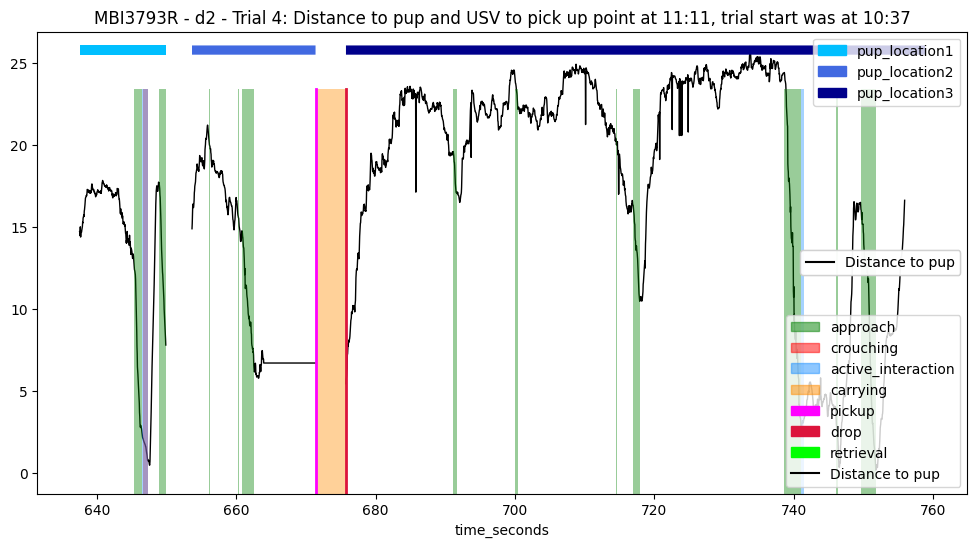

pup_loc pup_location1
mask_pup_available 47
pup_loc pup_location2
mask_pup_available 3403


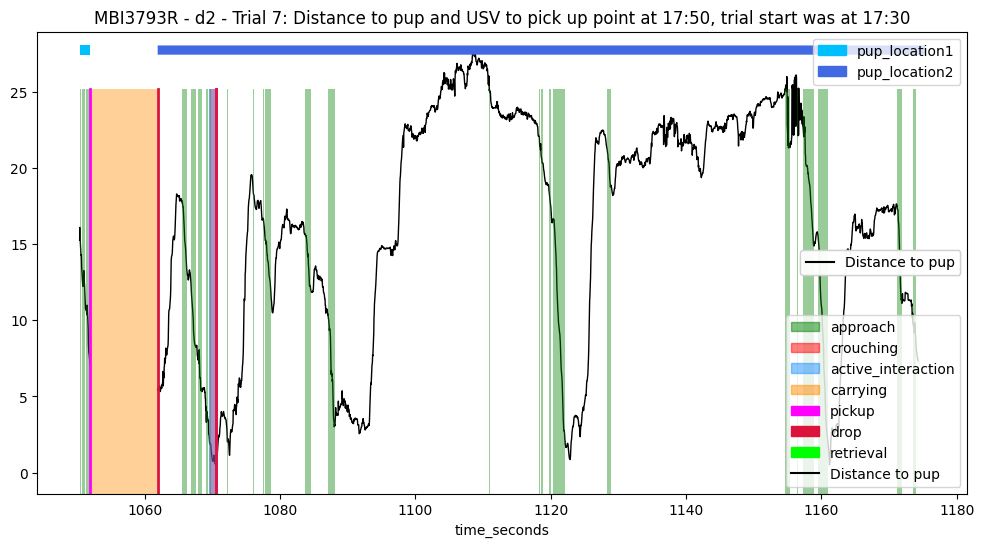

pup_loc pup_location1
mask_pup_available 397


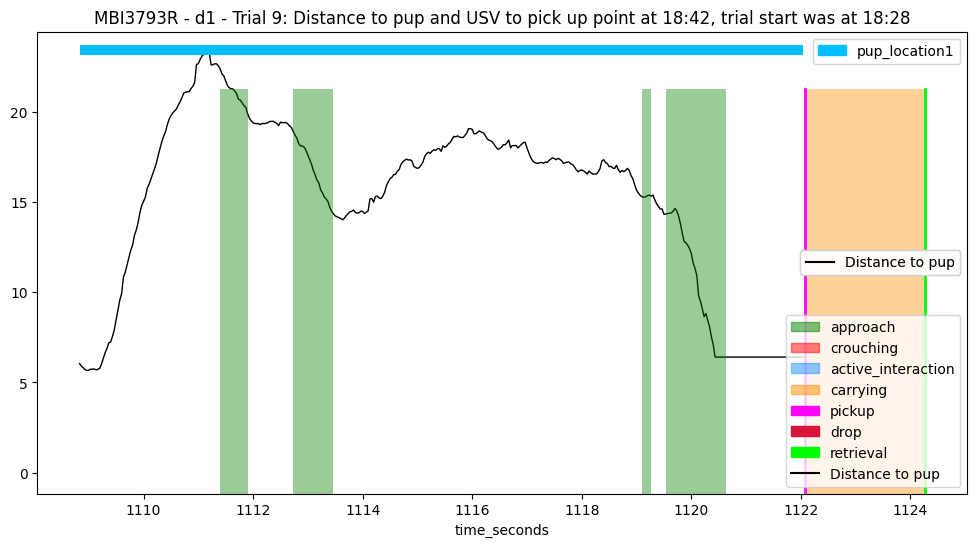

pup_loc pup_location1
mask_pup_available 2062
pup_loc pup_location2
mask_pup_available 1649


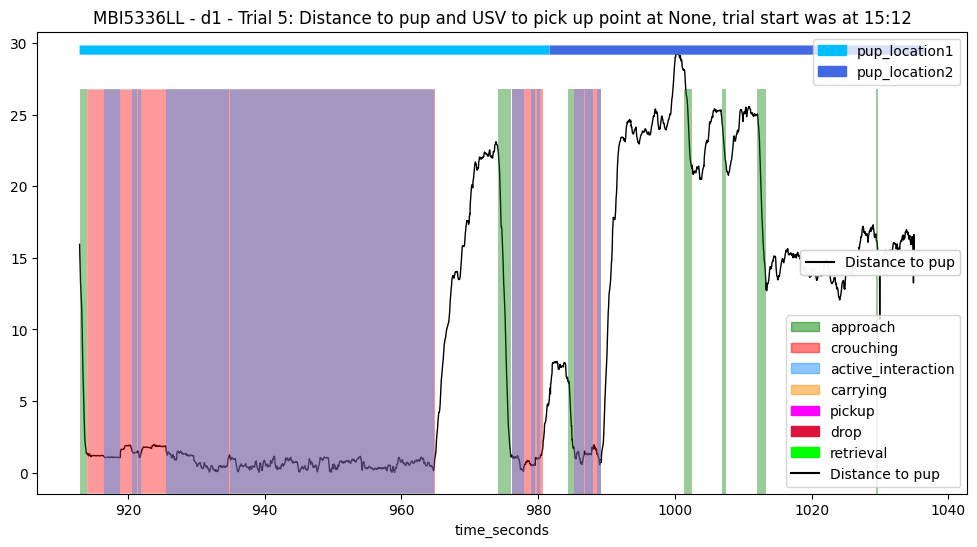

In [315]:
for example in examples[:]:

    mouse_id, day, trial_num = example

    trial_df_annotated = info_dict[example]["trial_df_annotated"]
    pup_locations_annotated = copy.deepcopy(info_dict[example]["pup_locations_annotated"])
    df_summary = copy.deepcopy(info_dict[example]["df_summary"])
    
    # zoom_min = 1068
    # zoom_max = 1075

    plot_behavioral_annotations(trial_df_annotated, df_summary, pup_locations_annotated,
                            mouse_id, day, trial_num, BF,
                            start_time = None, end_time = None, add_USV_plot = False)

    # time_slice = trial_df_annotated[(trial_df_annotated["time_seconds"] >= zoom_min) & (trial_df_annotated["time_seconds"] <= zoom_max)]
    # print(time_slice[["drop", "pickup", "carrying", "retrieval", "active_interaction"]].value_counts())

# 

# Annotation pipeline on all animal data #

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import os
import re
from DataLoader import *
import datetime
import random
import warnings
from VocalFeatureExtractor import VocalFeatureExtractor
from BehaviourAnnotation import *
from BehaviourFeatureExtractor import *
import pandas as pd
import numpy as np
from sklearn.cluster import DBSCAN
import matplotlib.pyplot as plt
import pprint
from matplotlib.collections import LineCollection
from colour import Color
import copy
import os

### Executing the pipeline ###

In [2]:
processed_data_dir = "processed_data"
#mouse_ids = ["MBI3793R", "MBI5336LL"]
mouse_ids = [mouse_id for mouse_id in os.listdir(processed_data_dir) if os.path.isdir(os.path.join(processed_data_dir, mouse_id)) and (mouse_id.startswith("M") or mouse_id.startswith("V"))]

print("Mouse IDs:", mouse_ids)
#days = ["d1", "d2"]
days = [f"d{i}" for i in range(1, 7)]

experiment_data_processed = load_processed_data(processed_data_dir, mouse_ids, days)

Mouse IDs: ['MBQ0231R', 'MBI5336LL', 'MBQ0012RR', 'MBI5335RR', 'VBQ0253LL', 'VAC0143LLR', 'VBQ0261L', 'MBI3793R']


In [3]:
BA = BehaviourAnnotator("config.json")

 ==== Example: MBQ0231R - d1 - 1 ==== 
 ==== Example: MBQ0231R - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3758
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3758
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 437.6 to 484.3
Window lengt

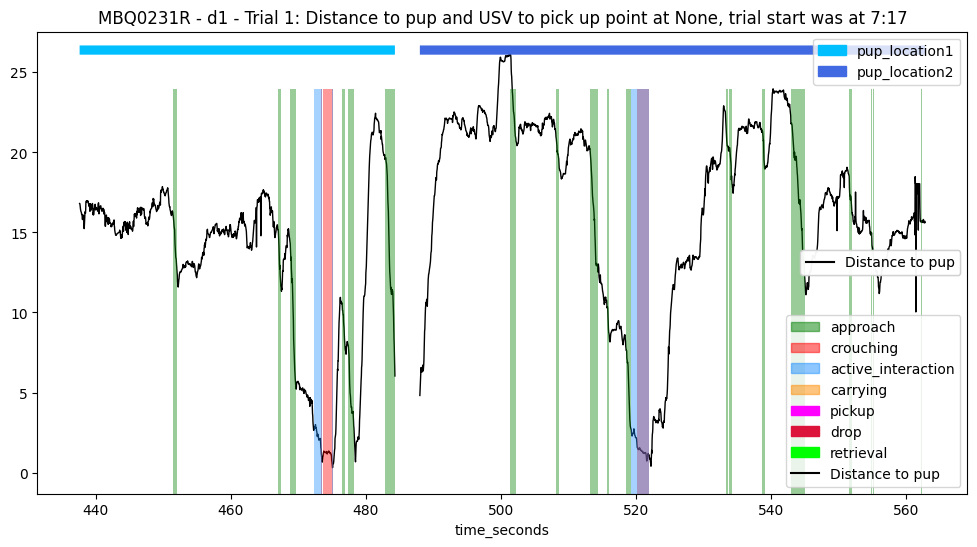

 ==== Example: MBQ0231R - d1 - 2 ==== 
 ==== Example: MBQ0231R - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 5261
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        82
distance_head_to_pup         82
head_angle_to_pup_degrees    82
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        85
distance_head_to_pup         85
head_angle_to_pup_

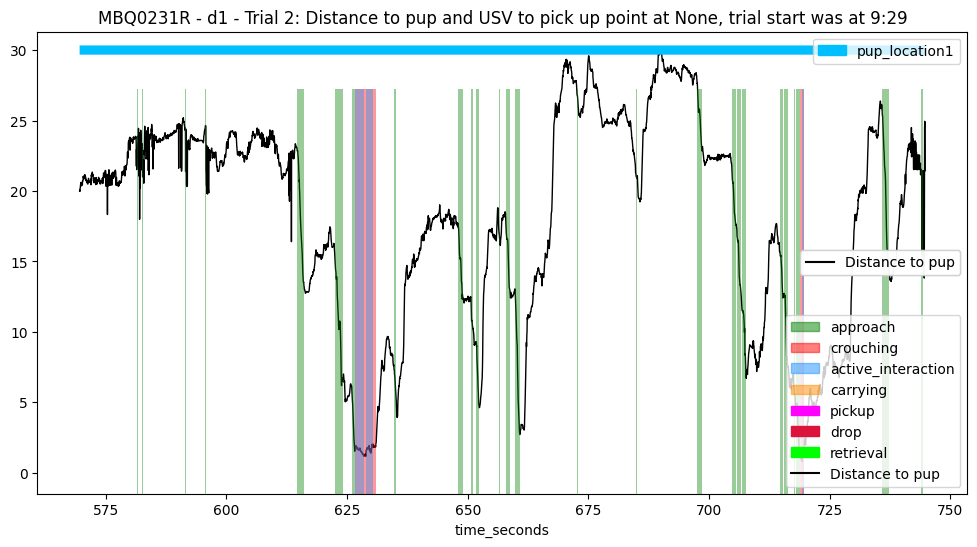

 ==== Example: MBQ0231R - d1 - 3 ==== 
 ==== Example: MBQ0231R - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4363
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        62
distance_head_to_pup         62
head_angle_to_pup_degrees    62
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        62
distance_head_to_pup         62
head_angle_to_pup_

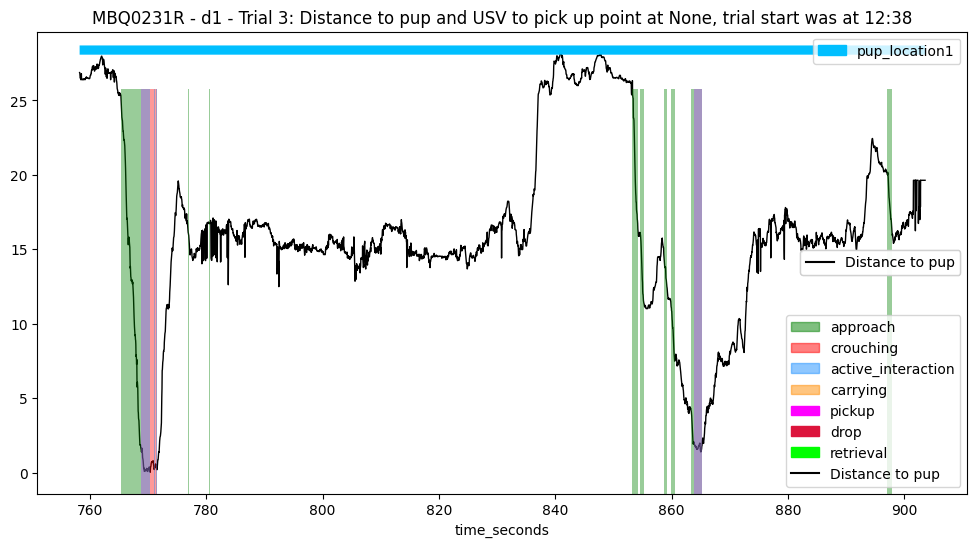

 ==== Example: MBQ0231R - d1 - 4 ==== 
 ==== Example: MBQ0231R - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 997.732
* Success time: None
---> Pick up frame: 29932, Start frame: 27508, End frame: 32165
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  29932 * Pickup time:  997.732
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4658
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 29932, instantly drop at 29933
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        93
distance_head_to_

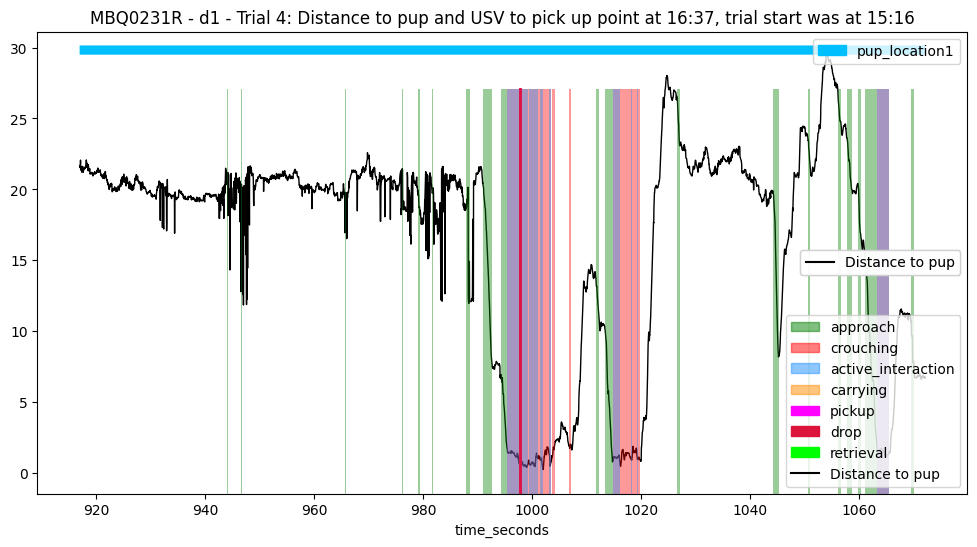

 ==== Example: MBQ0231R - d1 - 5 ==== 
 ==== Example: MBQ0231R - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4138
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        57
distance_head_to_pup         57
head_angle_to_pup_degrees    57
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        61
distance_head_to_pup         61
head_angle_to_pup_

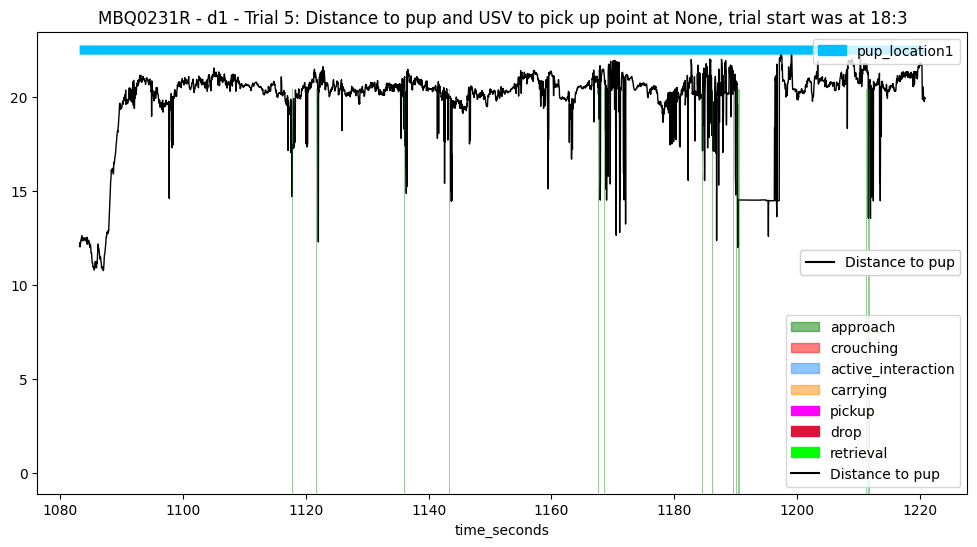

 ==== Example: MBQ0231R - d1 - 6 ==== 
 ==== Example: MBQ0231R - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1270.66
* Success time: 1275.581
---> Pick up frame: 38120, Start frame: 36987, End frame: 38267
---> Retrieval frame: 38267; Start frame: 36987; End frame: 38267
---> Final frame: 38267
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38120 * Pickup time:  1270.66
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1281
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        171
distance_head

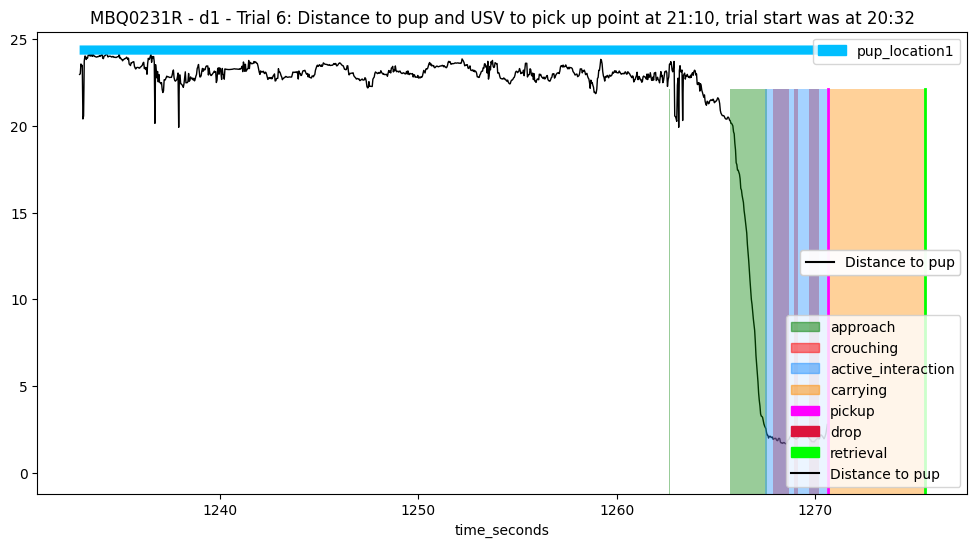

 ==== Example: MBQ0231R - d1 - 7 ==== 
 ==== Example: MBQ0231R - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1367.924
* Success time: 1371.908
---> Pick up frame: 41038, Start frame: 38727, End frame: 41157
---> Retrieval frame: 41157; Start frame: 38727; End frame: 41157
---> Final frame: 41157
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41038 * Pickup time:  1367.924
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2431
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        87
distance_hea

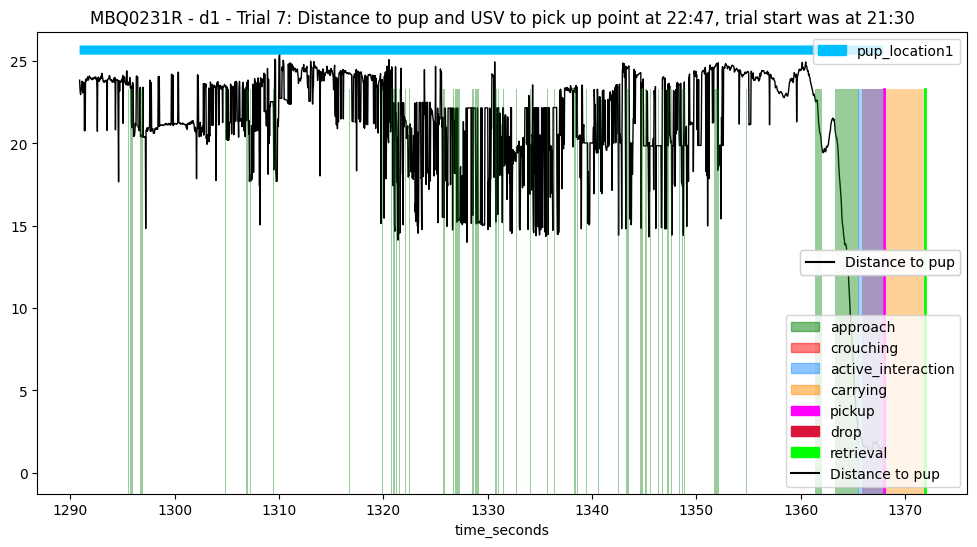

 ==== Example: MBQ0231R - d1 - 8 ==== 
 ==== Example: MBQ0231R - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1435.404
* Success time: 1437.66
---> Pick up frame: 43062, Start frame: 41690, End frame: 43129
---> Retrieval frame: 43130; Start frame: 41690; End frame: 43129
---> Final frame: 43129
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  43062 * Pickup time:  1435.404
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1440
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        264
distance_hea

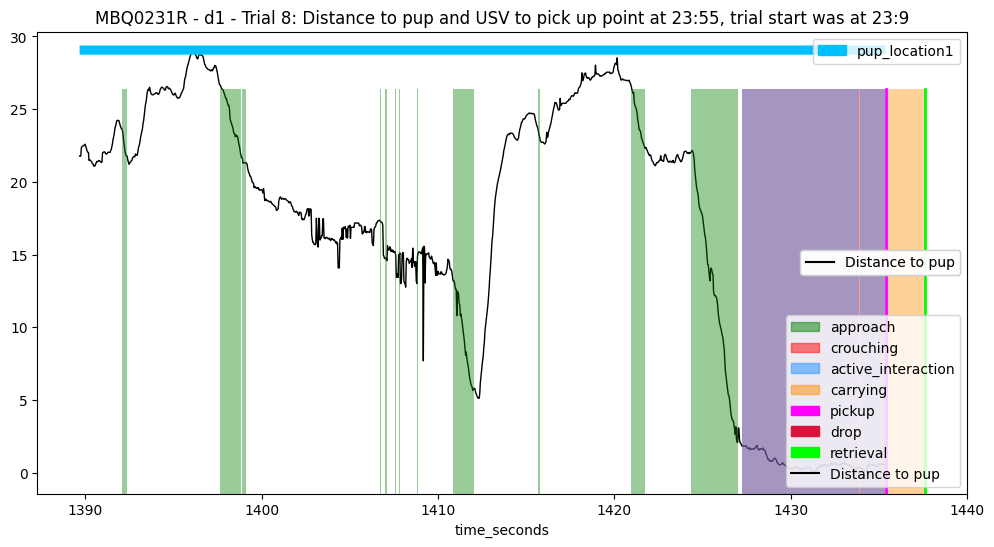

 ==== Example: MBQ0231R - d1 - 9 ==== 
 ==== Example: MBQ0231R - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1507.22
* Success time: 1511.173
---> Pick up frame: 45217, Start frame: 43563, End frame: 45335
---> Retrieval frame: 45335; Start frame: 43563; End frame: 45335
---> Final frame: 45335
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  45217 * Pickup time:  1507.22
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1773
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        100
distance_head

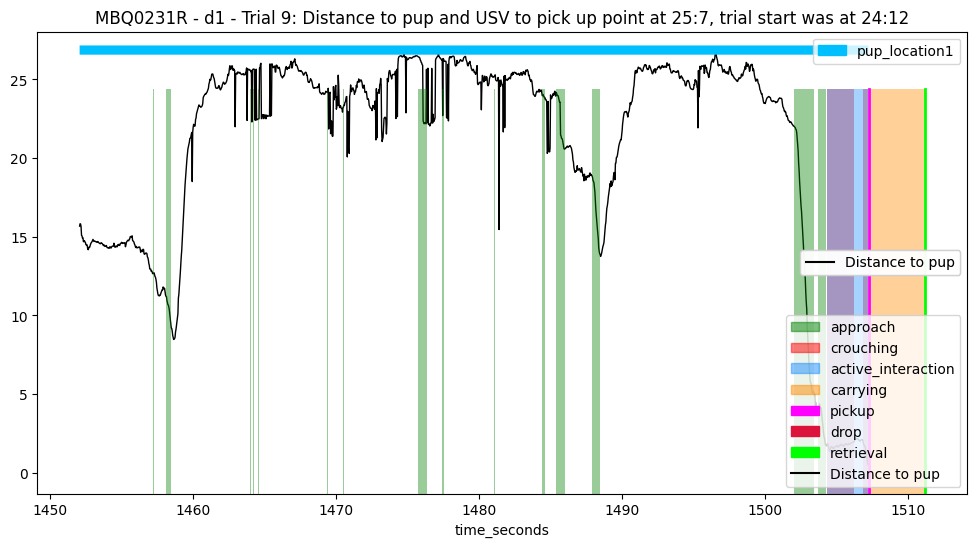

 ==== Example: MBQ0231R - d2 - 1 ==== 
 ==== Example: MBQ0231R - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 435.865
* Success time: 438.953
---> Pick up frame: 13076, Start frame: 12786, End frame: 13168
---> Retrieval frame: 13169; Start frame: 12786; End frame: 13168
---> Final frame: 13168
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13076 * Pickup time:  435.865
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 383
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        200
distance_head_t

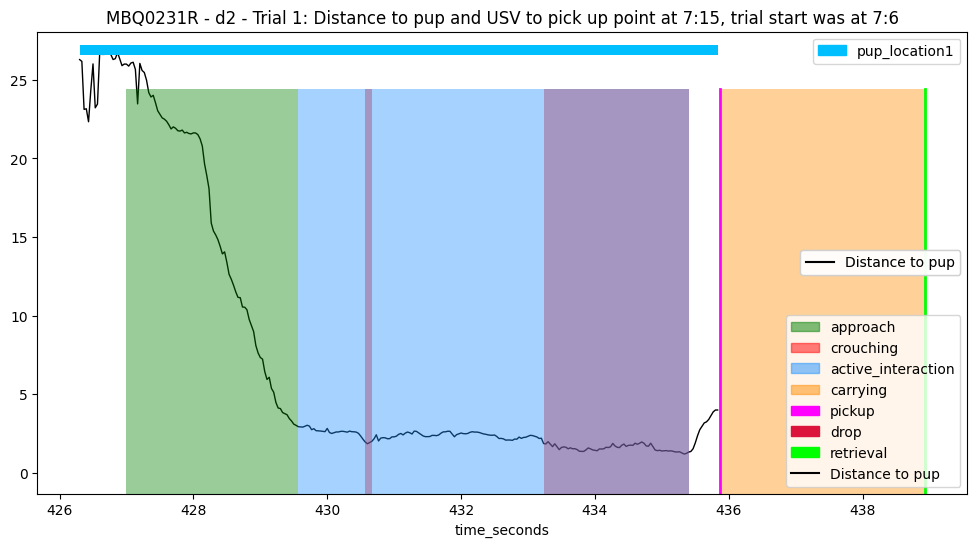

 ==== Example: MBQ0231R - d2 - 2 ==== 
 ==== Example: MBQ0231R - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 459.225
* Success time: 463.025
---> Pick up frame: 13777, Start frame: 13642, End frame: 13890
---> Retrieval frame: 13891; Start frame: 13642; End frame: 13890
---> Final frame: 13890
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13777 * Pickup time:  459.225
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 249
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_to

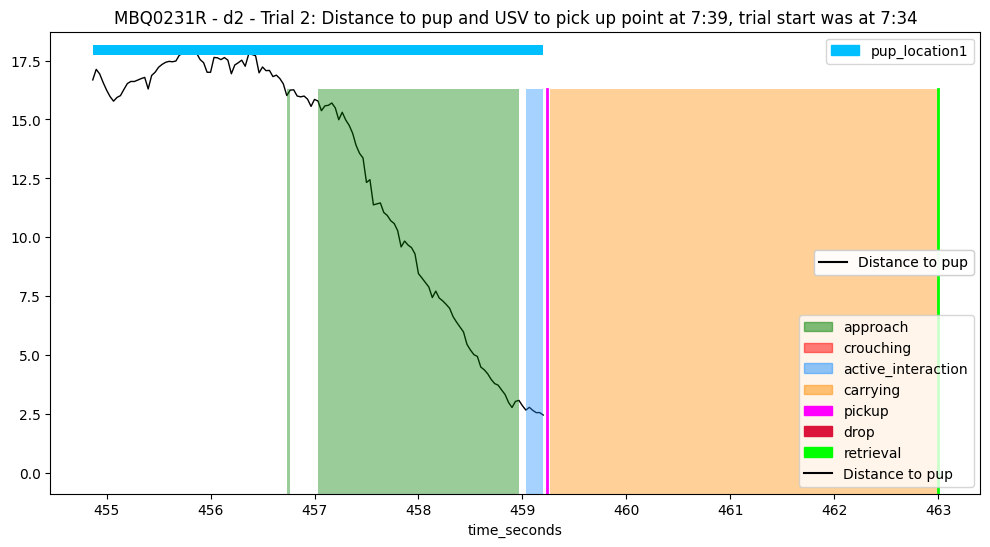

 ==== Example: MBQ0231R - d2 - 3 ==== 
 ==== Example: MBQ0231R - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 491.065
* Success time: 494.369
---> Pick up frame: 14732, Start frame: 14450, End frame: 14831
---> Retrieval frame: 14831; Start frame: 14450; End frame: 14831
---> Final frame: 14831
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14732 * Pickup time:  491.065
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 382
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        41
distance_head_to

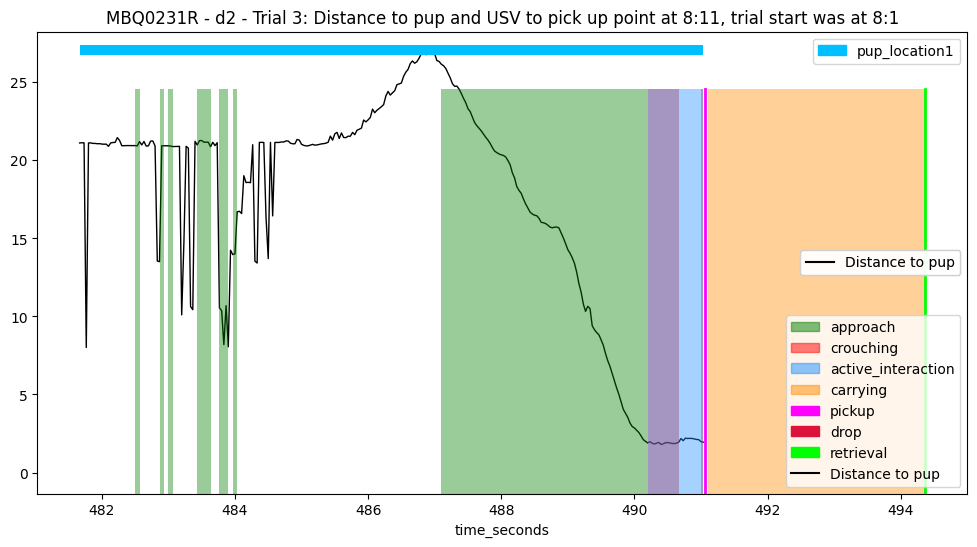

 ==== Example: MBQ0231R - d2 - 4 ==== 
 ==== Example: MBQ0231R - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3814
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        88
distance_head_to_pup         88
head_angle_to_pup_degrees    88
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        88
distance_head_to_pup         88
head_angle_to_pup_

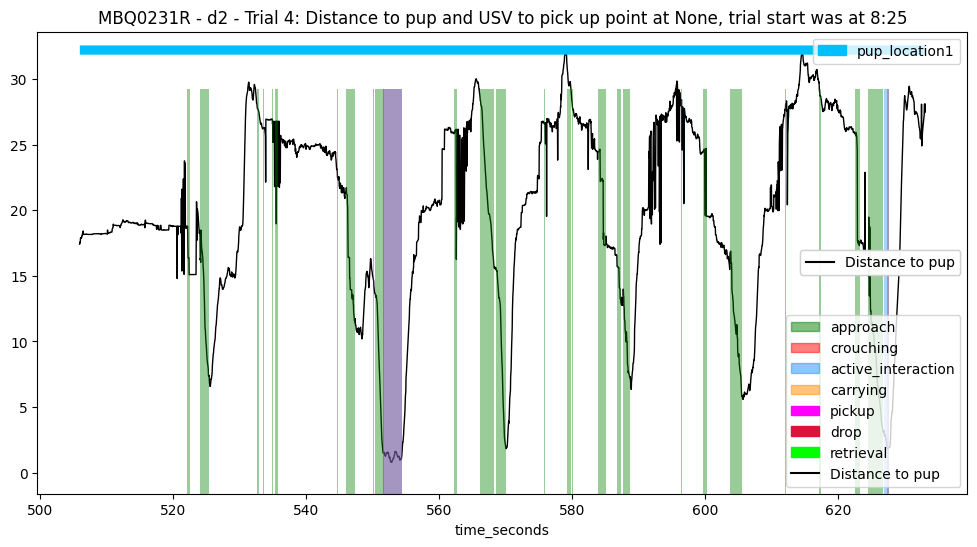

 ==== Example: MBQ0231R - d2 - 5 ==== 
 ==== Example: MBQ0231R - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 653.041
* Success time: 655.313
---> Pick up frame: 19591, Start frame: 19553, End frame: 19659
---> Retrieval frame: 19659; Start frame: 19553; End frame: 19659
---> Final frame: 19659
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19591 * Pickup time:  653.041
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 107
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 19591, instantly drop at 19592
---> Processing last pup location: p

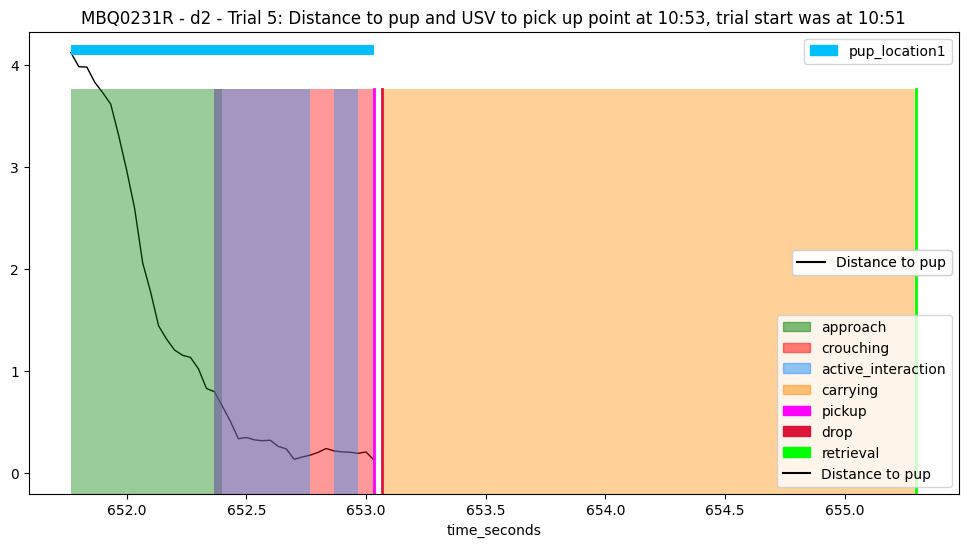

 ==== Example: MBQ0231R - d2 - 6 ==== 
 ==== Example: MBQ0231R - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 676.977
* Success time: 682.545
---> Pick up frame: 20309, Start frame: 20245, End frame: 20476
---> Retrieval frame: 20476; Start frame: 20245; End frame: 20476
---> Final frame: 20476
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20309 * Pickup time:  676.977
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 232
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 20309, instantly drop at 20310
---> Processing last pup location: p

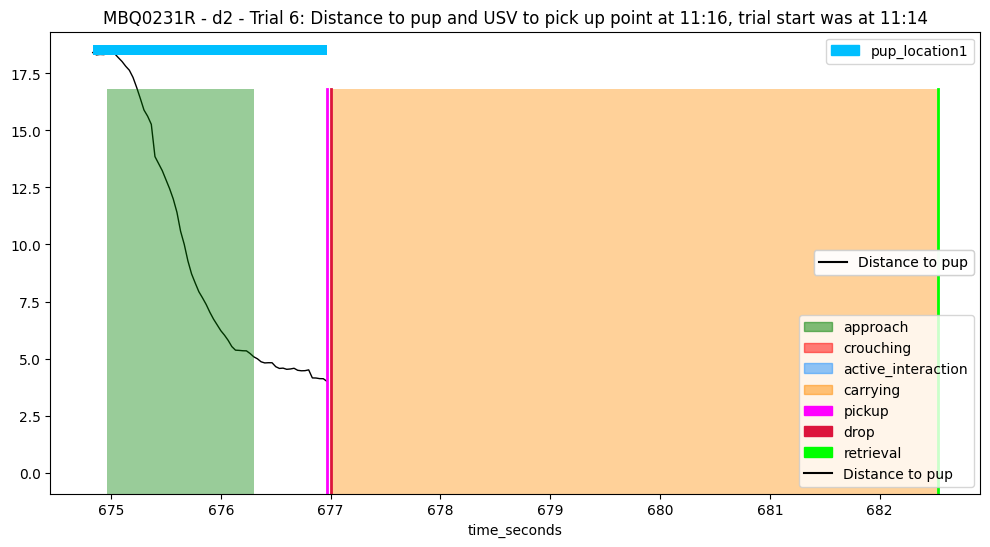

 ==== Example: MBQ0231R - d2 - 7 ==== 
 ==== Example: MBQ0231R - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3943
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        88
distance_head_to_pup         88
head_angle_to_pup_degrees    88
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        92
distance_head_to_pup         92
head_angle_to_pup_

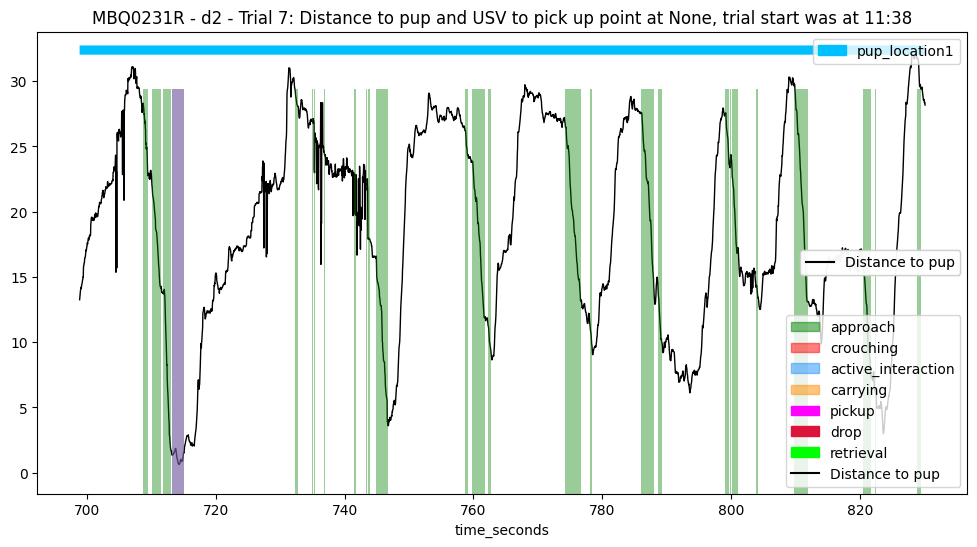

 ==== Example: MBQ0231R - d2 - 8 ==== 
 ==== Example: MBQ0231R - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3733
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3733
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 846.2333333333333 to 922.33

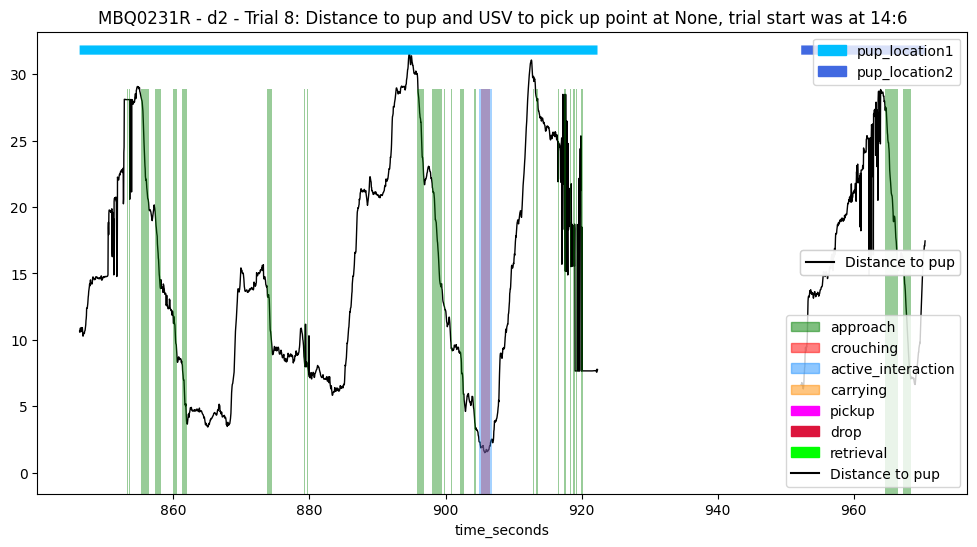

 ==== Example: MBQ0231R - d2 - 9 ==== 
 ==== Example: MBQ0231R - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1011.393
* Success time: 1014.081
---> Pick up frame: 30342, Start frame: 29469, End frame: 30422
---> Retrieval frame: 30422; Start frame: 29469; End frame: 30422
---> Final frame: 30422
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  30342 * Pickup time:  1011.393
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 954
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        58
distance_head

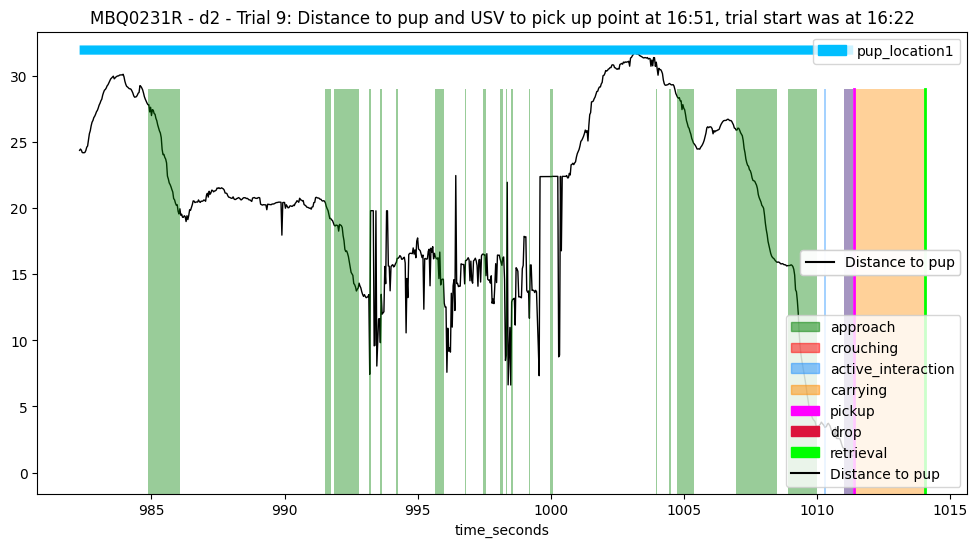

 ==== Example: MBQ0231R - d3 - 1 ==== 
 ==== Example: MBQ0231R - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 463.226
* Success time: None
---> Pick up frame: 13897, Start frame: 13674, End frame: 18016
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13897 * Pickup time:  463.226
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4343
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 13897, instantly drop at 13898
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        98
distance_head_to_

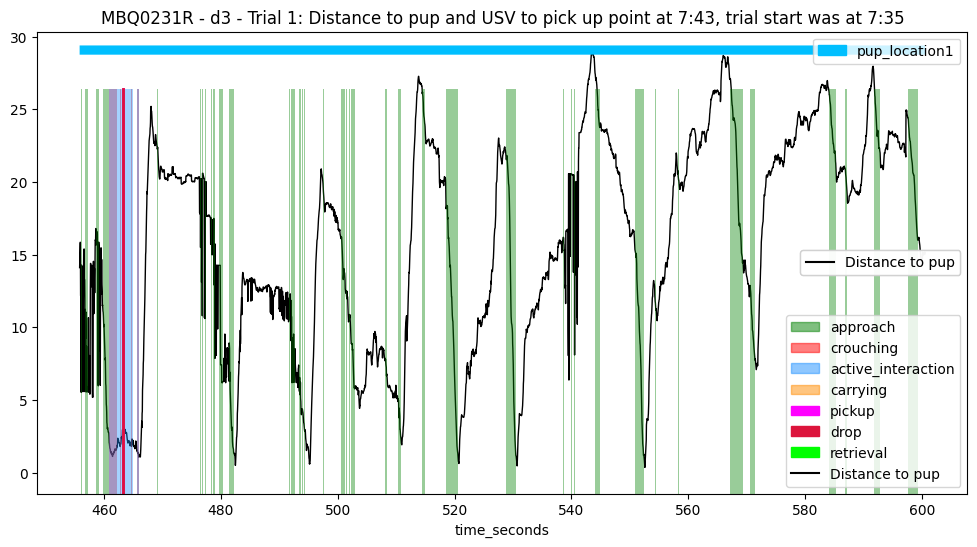

 ==== Example: MBQ0231R - d3 - 2 ==== 
 ==== Example: MBQ0231R - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4127
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        103
distance_head_to_pup         103
head_angle_to_pup_degrees    103
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        103
distance_head_to_pup         103
head_angle_to

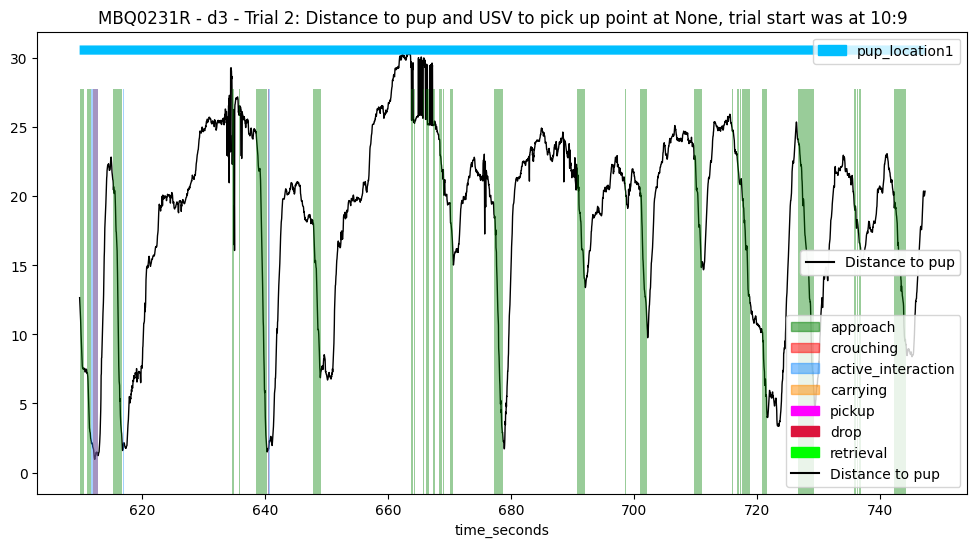

 ==== Example: MBQ0231R - d3 - 3 ==== 
 ==== Example: MBQ0231R - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 793.07
* Success time: 797.0
---> Pick up frame: 23792, Start frame: 23050, End frame: 23910
---> Retrieval frame: 23910; Start frame: 23050; End frame: 23910
---> Final frame: 23910
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23792 * Pickup time:  793.07
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 861
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        150
distance_head_to_pu

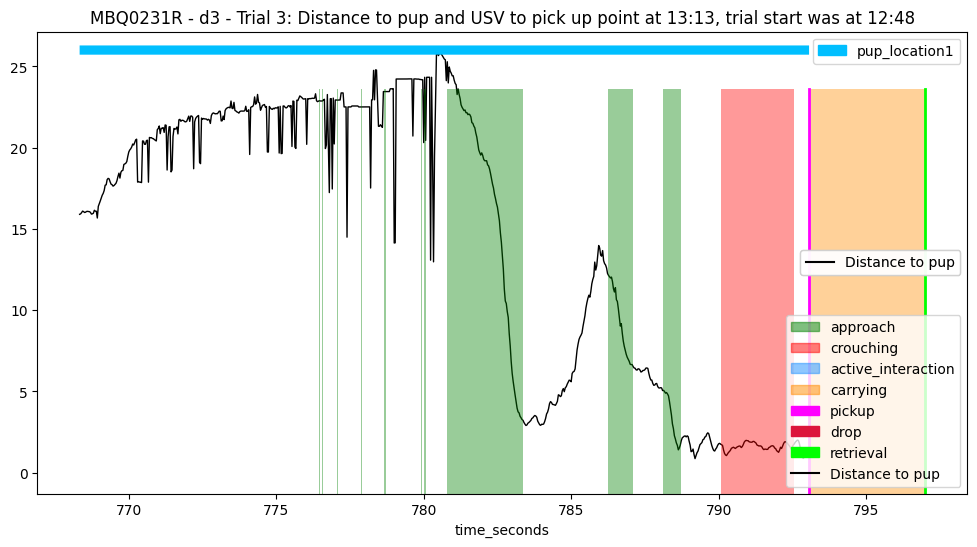

 ==== Example: MBQ0231R - d3 - 4 ==== 
 ==== Example: MBQ0231R - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 934.955
* Success time: None
---> Pick up frame: 28049, Start frame: 26195, End frame: 28848
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  28049 * Pickup time:  934.955
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2654
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        2653
   

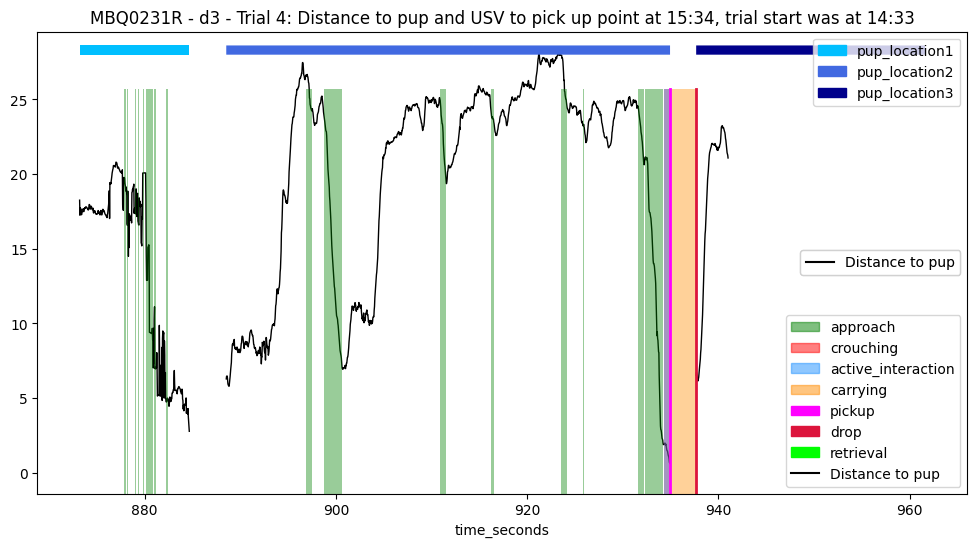

 ==== Example: MBQ0231R - d3 - 5 ==== 
 ==== Skipping example: ('MBQ0231R', 'd3', 5) ==== 
 ==== Example: MBQ0231R - d3 - 6 ==== 
 ==== Example: MBQ0231R - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: 1160.178
---> Retrieval frame: 34805; Start frame: 34304; End frame: 34805
---> Final frame: 34805
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 502
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'retrieval' 

===== After annotations edits:
drop   pickup  carrying  retr

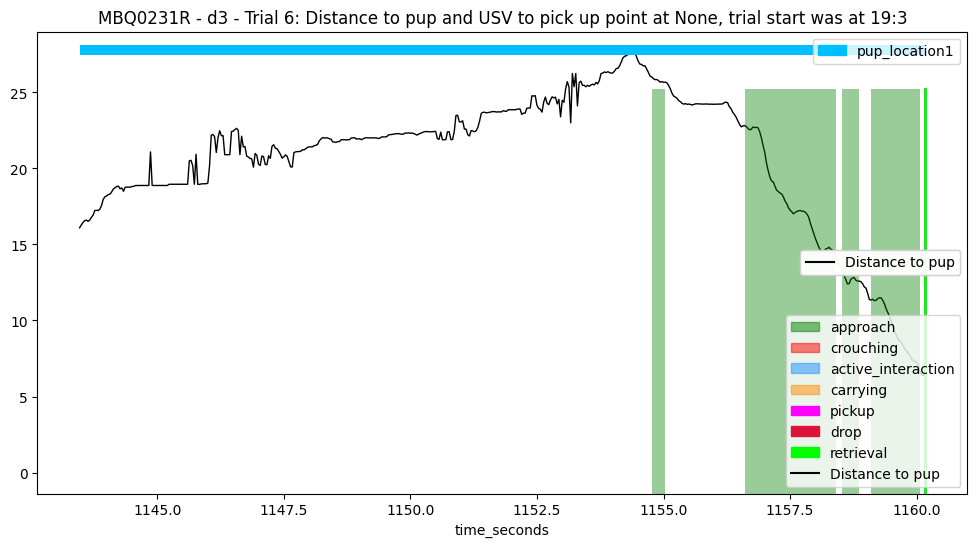

 ==== Example: MBQ0231R - d3 - 7 ==== 
 ==== Example: MBQ0231R - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1294.299
* Success time: 1297.523
---> Pick up frame: 38829, Start frame: 37885, End frame: 38925
---> Retrieval frame: 38926; Start frame: 37885; End frame: 38925
---> Final frame: 38925
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38829 * Pickup time:  1294.299
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1041
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        564
distance_he

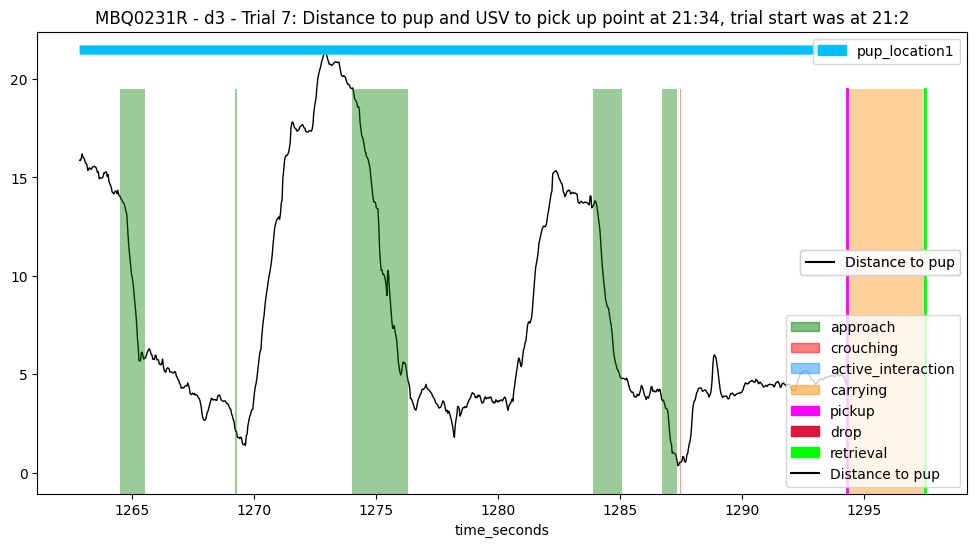

 ==== Example: MBQ0231R - d3 - 8 ==== 
 ==== Example: MBQ0231R - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1316.099
* Success time: 1318.315
---> Pick up frame: 39483, Start frame: 39351, End frame: 39549
---> Retrieval frame: 39549; Start frame: 39351; End frame: 39549
---> Final frame: 39549
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  39483 * Pickup time:  1316.099
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 199
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        110
distance_hea

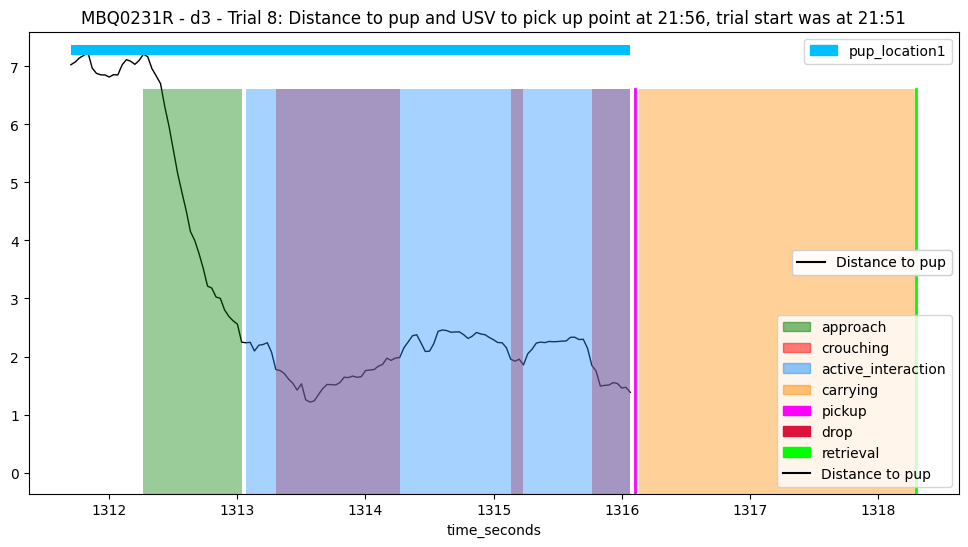

 ==== Example: MBQ0231R - d3 - 9 ==== 
 ==== Example: MBQ0231R - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1357.403
* Success time: None
---> Pick up frame: 40722, Start frame: 40257, End frame: 44233
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  40722 * Pickup time:  1357.403
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3977
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        89
distance_head_to_pup         89
head_angle_to

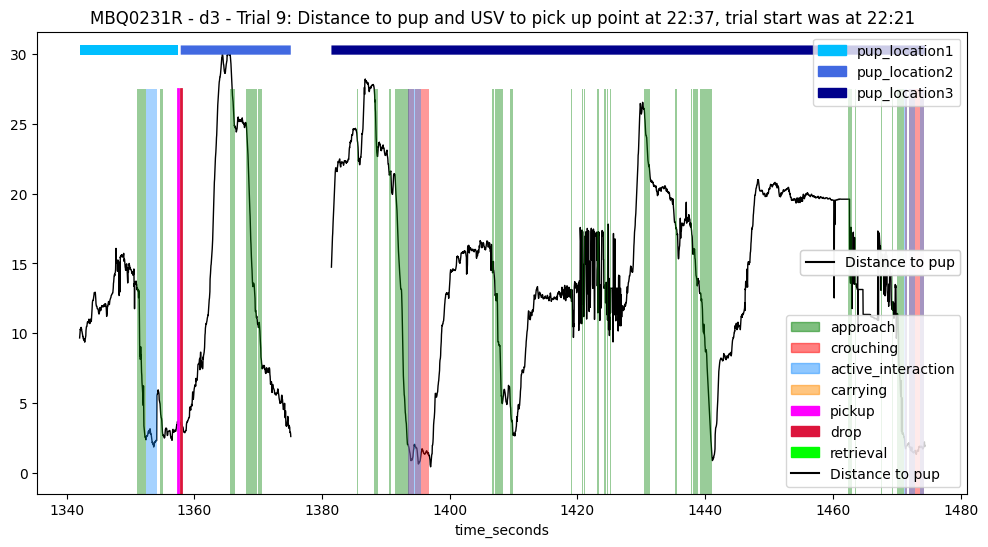

 ==== Example: MBQ0231R - d4 - 1 ==== 
 ==== Example: MBQ0231R - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 433.883
* Success time: 434.62
---> Pick up frame: 13016, Start frame: 12597, End frame: 13038
---> Retrieval frame: 13039; Start frame: 12597; End frame: 13038
---> Final frame: 13038
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13016 * Pickup time:  433.883
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 442
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        162
distance_head_to

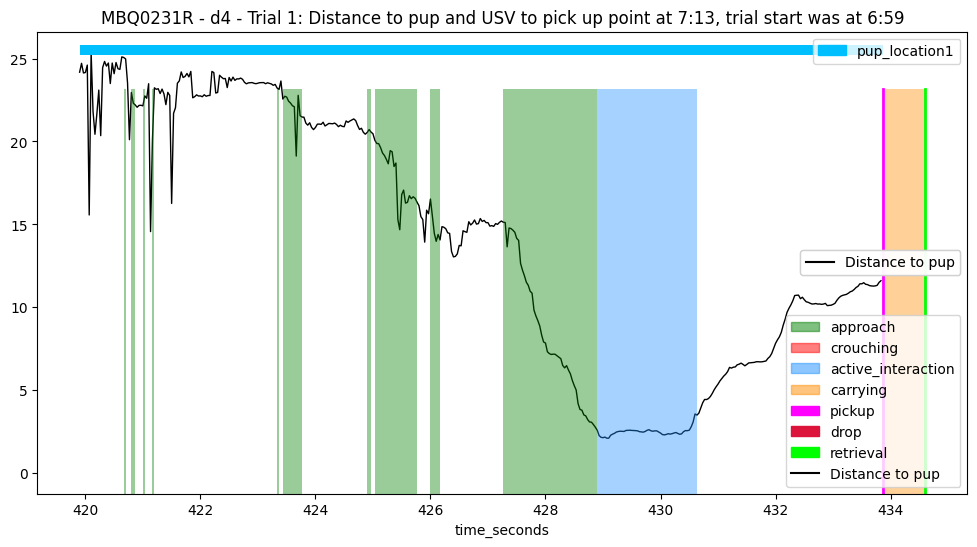

 ==== Example: MBQ0231R - d4 - 2 ==== 
 ==== Example: MBQ0231R - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 450.82
* Success time: 454.068
---> Pick up frame: 13525, Start frame: 13351, End frame: 13622
---> Retrieval frame: 13622; Start frame: 13351; End frame: 13622
---> Final frame: 13622
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13525 * Pickup time:  450.82
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 272
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to_p

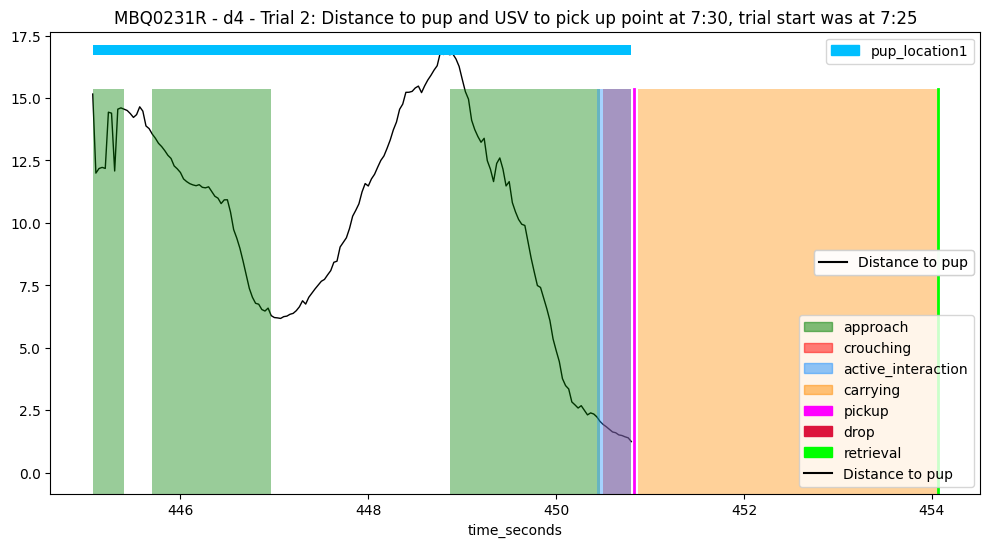

 ==== Example: MBQ0231R - d4 - 3 ==== 
 ==== Example: MBQ0231R - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 466.963
* Success time: 470.403
---> Pick up frame: 14009, Start frame: 13945, End frame: 14112
---> Retrieval frame: 14112; Start frame: 13945; End frame: 14112
---> Final frame: 14112
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14009 * Pickup time:  466.963
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 168
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to

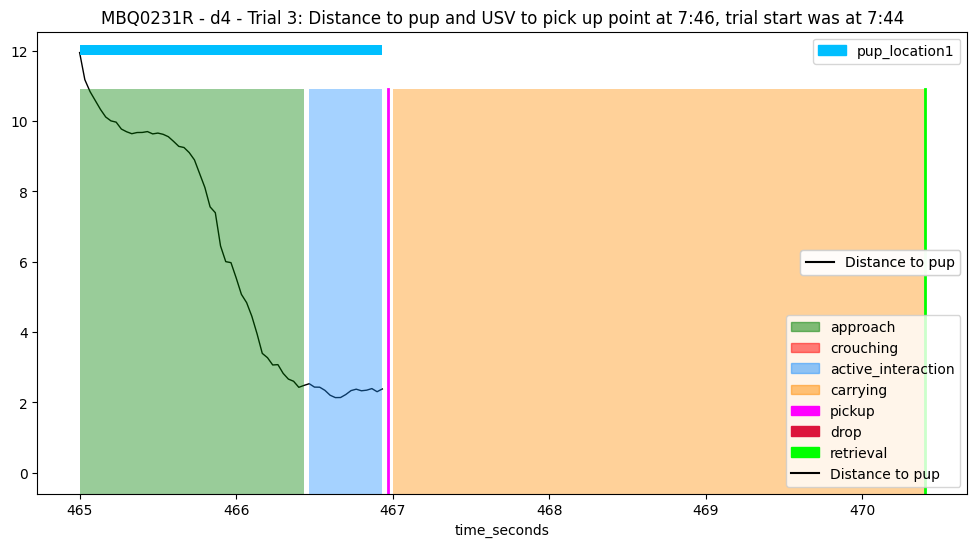

 ==== Example: MBQ0231R - d4 - 4 ==== 
 ==== Example: MBQ0231R - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 494.203
* Success time: 496.532
---> Pick up frame: 14826, Start frame: 14502, End frame: 14895
---> Retrieval frame: 14896; Start frame: 14502; End frame: 14895
---> Final frame: 14895
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14826 * Pickup time:  494.203
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 394
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_head_to

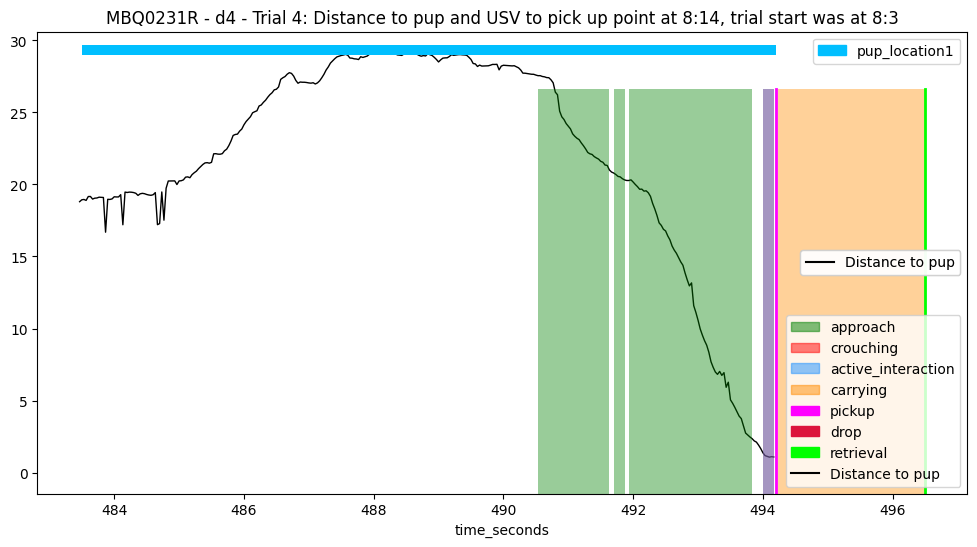

 ==== Example: MBQ0231R - d4 - 5 ==== 
 ==== Example: MBQ0231R - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 514.356
* Success time: 516.955
---> Pick up frame: 15431, Start frame: 15281, End frame: 15508
---> Retrieval frame: 15509; Start frame: 15281; End frame: 15508
---> Final frame: 15508
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15431 * Pickup time:  514.356
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 228
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_to

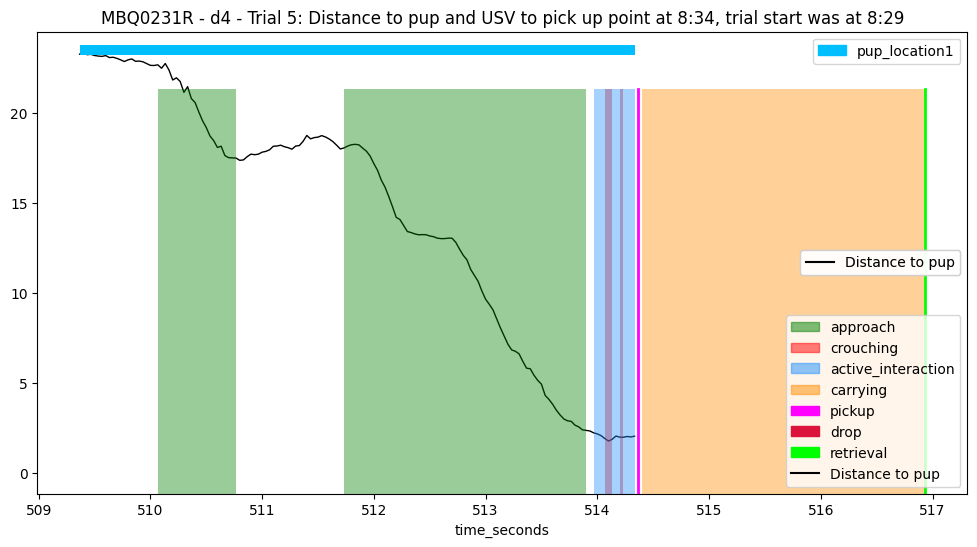

 ==== Example: MBQ0231R - d4 - 6 ==== 
 ==== Example: MBQ0231R - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 551.627
* Success time: 553.299
---> Pick up frame: 16549, Start frame: 15872, End frame: 16598
---> Retrieval frame: 16599; Start frame: 15872; End frame: 16598
---> Final frame: 16598
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16549 * Pickup time:  551.627
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 727
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        83
distance_head_to

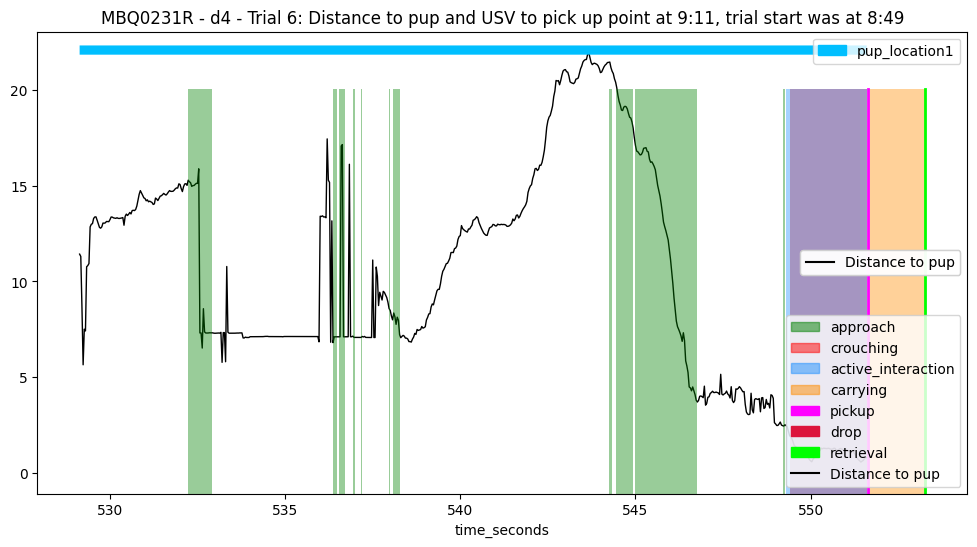

 ==== Example: MBQ0231R - d4 - 7 ==== 
 ==== Example: MBQ0231R - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 565.227
* Success time: 567.564
---> Pick up frame: 16957, Start frame: 16915, End frame: 17026
---> Retrieval frame: 17027; Start frame: 16915; End frame: 17026
---> Final frame: 17026
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16957 * Pickup time:  565.227
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 112
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_

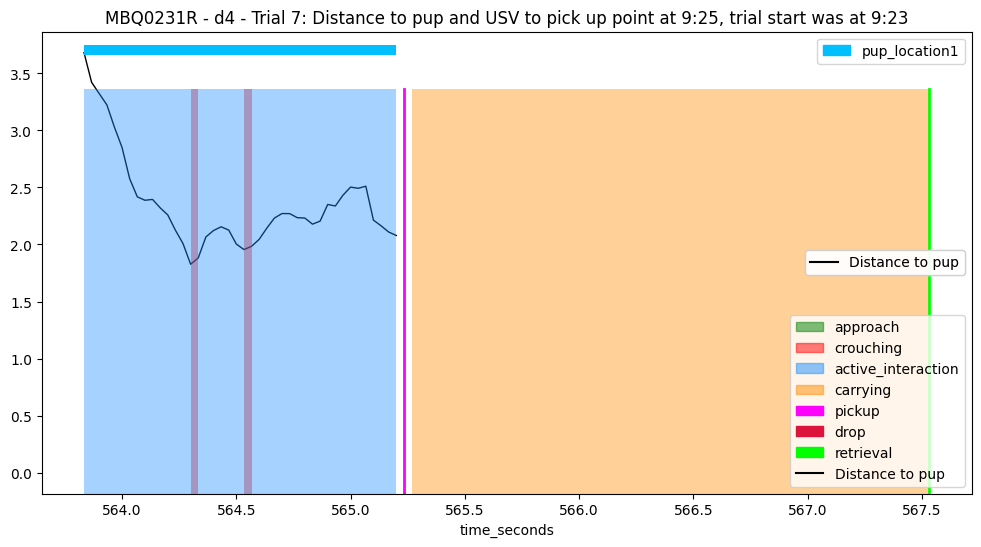

 ==== Example: MBQ0231R - d4 - 8 ==== 
 ==== Example: MBQ0231R - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 605.508
* Success time: 609.163
---> Pick up frame: 18165, Start frame: 17745, End frame: 18274
---> Retrieval frame: 18275; Start frame: 17745; End frame: 18274
---> Final frame: 18274
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18165 * Pickup time:  605.508
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 530
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to

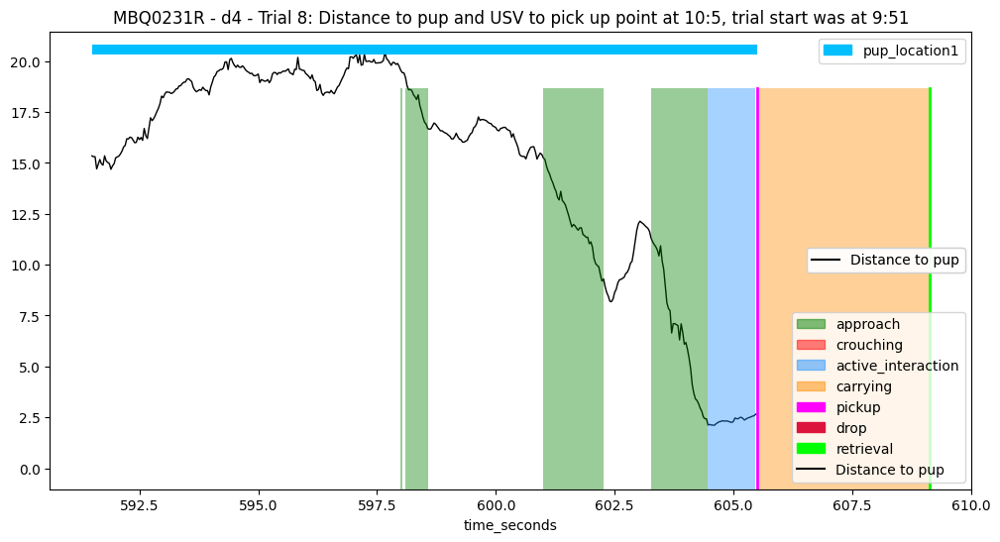

 ==== Example: MBQ0231R - d4 - 9 ==== 
 ==== Example: MBQ0231R - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 641.411
* Success time: 645.348
---> Pick up frame: 19242, Start frame: 18644, End frame: 19360
---> Retrieval frame: 19360; Start frame: 18644; End frame: 19360
---> Final frame: 19360
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19242 * Pickup time:  641.411
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 717
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        15
distance_head_to

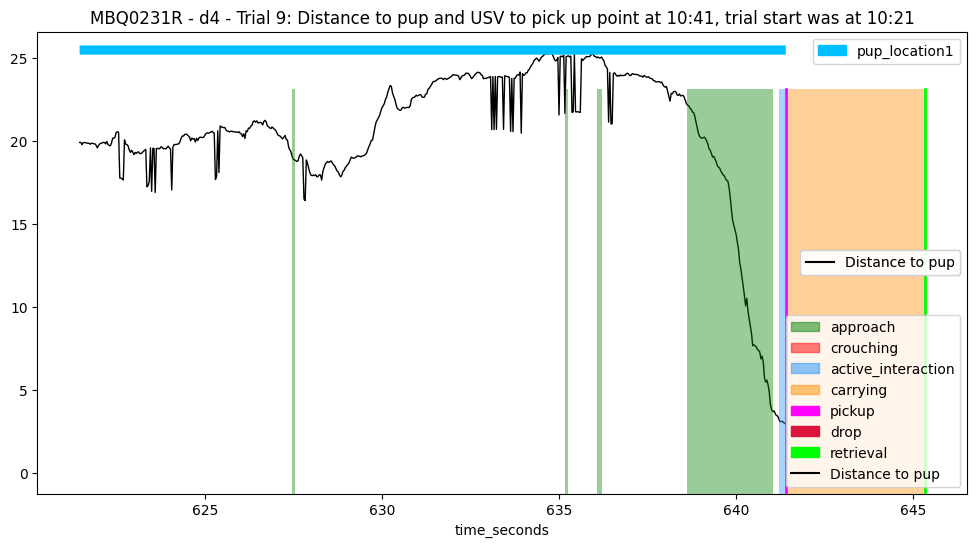

 ==== Example: MBQ0231R - d5 - 1 ==== 
 ==== Example: MBQ0231R - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 420.596
* Success time: None
---> Pick up frame: 12618, Start frame: 12173, End frame: 15911
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12618 * Pickup time:  420.596
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3739
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 12618, instantly drop at 12619
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head_to_

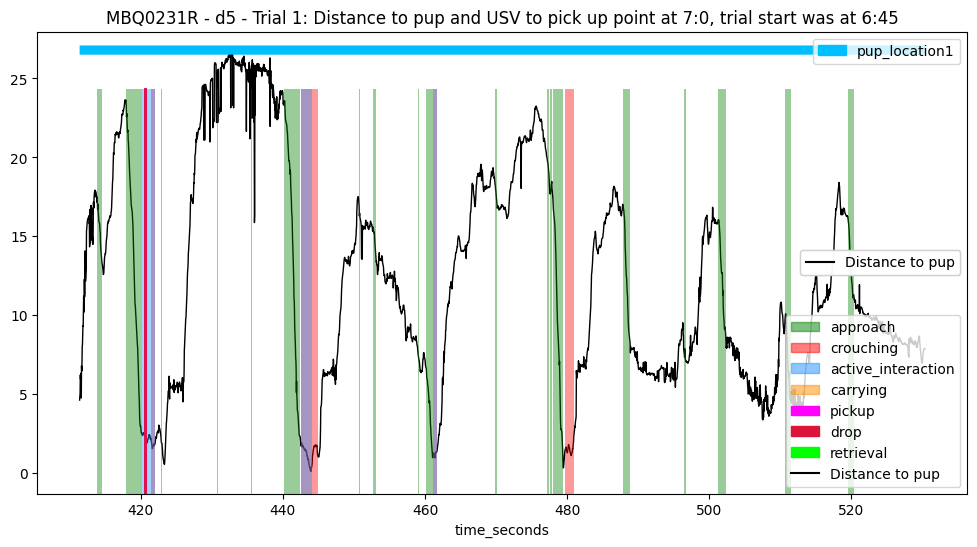

 ==== Example: MBQ0231R - d5 - 2 ==== 
 ==== Example: MBQ0231R - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 538.476
* Success time: 541.628
---> Pick up frame: 16154, Start frame: 16079, End frame: 16248
---> Retrieval frame: 16249; Start frame: 16079; End frame: 16248
---> Final frame: 16248
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16154 * Pickup time:  538.476
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 170
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        51
distance_head_to

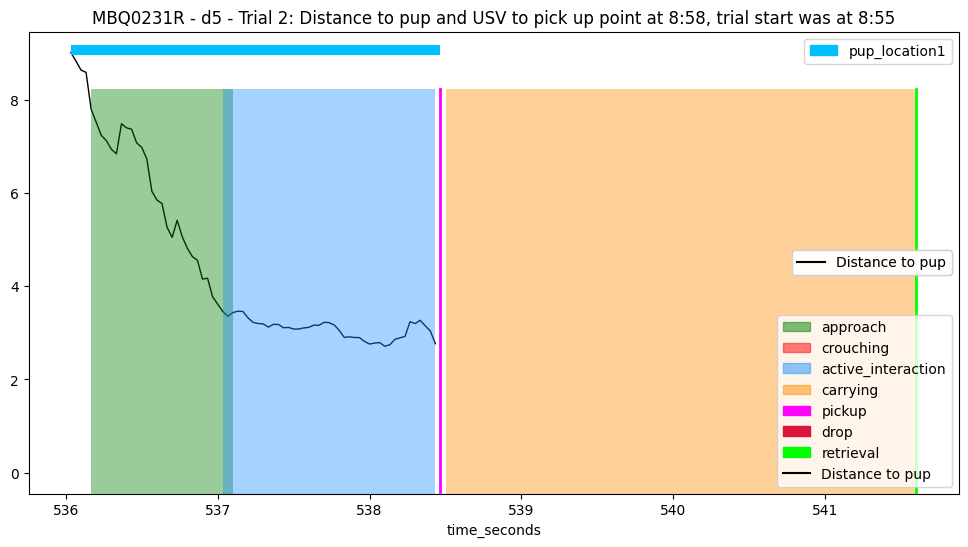

 ==== Example: MBQ0231R - d5 - 3 ==== 
 ==== Example: MBQ0231R - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 574.724
* Success time: 578.084
---> Pick up frame: 17242, Start frame: 16763, End frame: 17342
---> Retrieval frame: 17343; Start frame: 16763; End frame: 17342
---> Final frame: 17342
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17242 * Pickup time:  574.724
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 580
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        95
distance_head_to

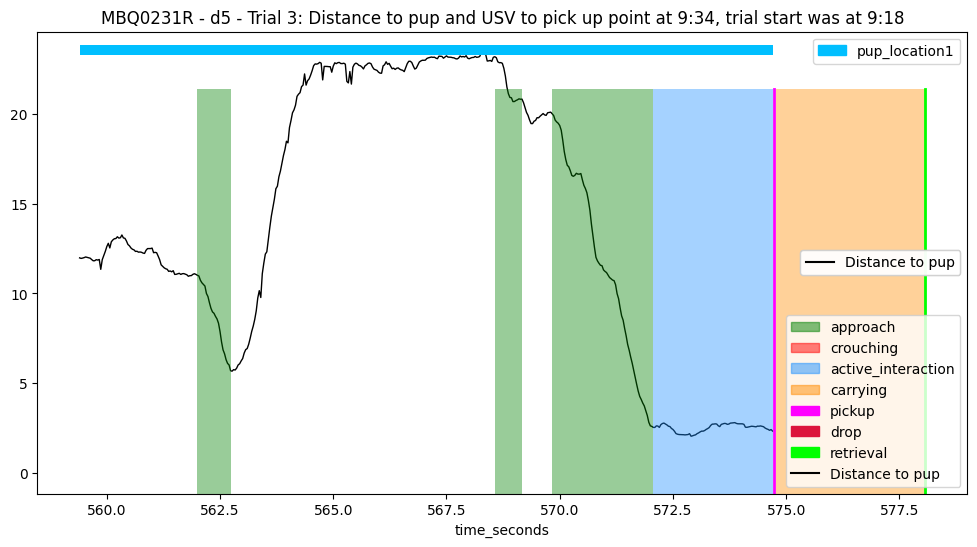

 ==== Example: MBQ0231R - d5 - 4 ==== 
 ==== Example: MBQ0231R - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 604.428
* Success time: 609.636
---> Pick up frame: 18133, Start frame: 17749, End frame: 18289
---> Retrieval frame: 18289; Start frame: 17749; End frame: 18289
---> Final frame: 18289
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18133 * Pickup time:  604.428
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 541
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_to

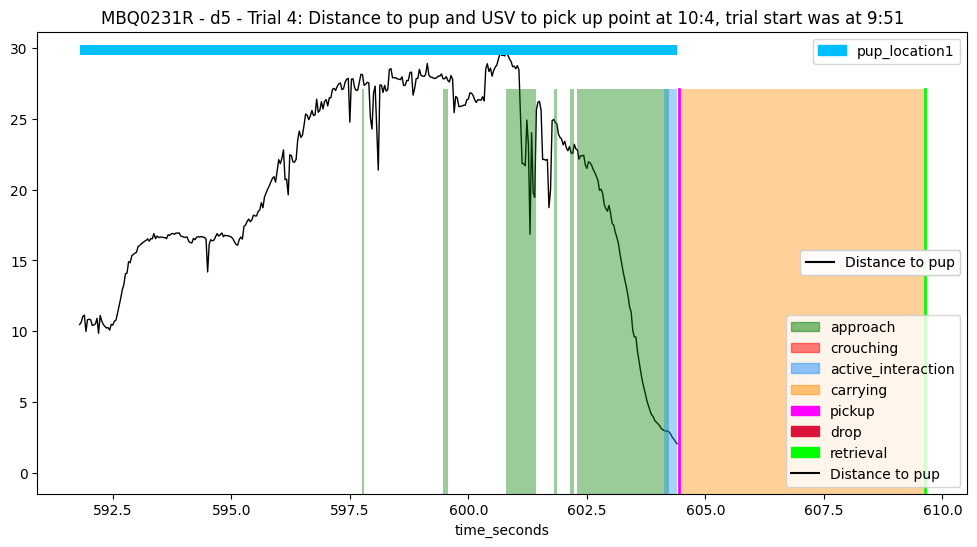

 ==== Example: MBQ0231R - d5 - 5 ==== 
 ==== Example: MBQ0231R - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 625.404
* Success time: 628.092
---> Pick up frame: 18762, Start frame: 18687, End frame: 18842
---> Retrieval frame: 18843; Start frame: 18687; End frame: 18842
---> Final frame: 18842
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18762 * Pickup time:  625.404
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 156
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        24
distance_head_to

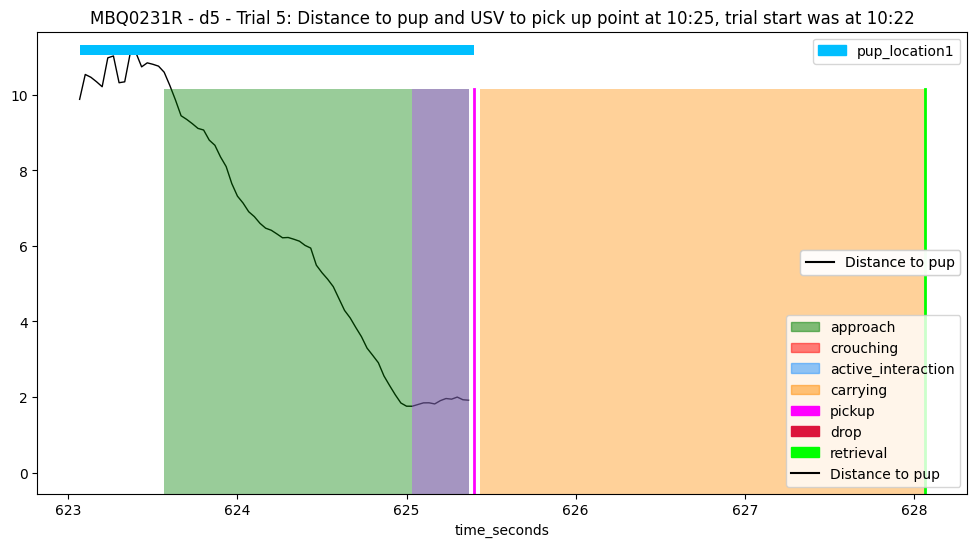

 ==== Example: MBQ0231R - d5 - 6 ==== 
 ==== Example: MBQ0231R - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 641.1
* Success time: 644.516
---> Pick up frame: 19233, Start frame: 19203, End frame: 19335
---> Retrieval frame: 19335; Start frame: 19203; End frame: 19335
---> Final frame: 19335
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19233 * Pickup time:  641.1
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 133
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 19233, instantly drop at 19234
---> Processing last pup location: pup_l

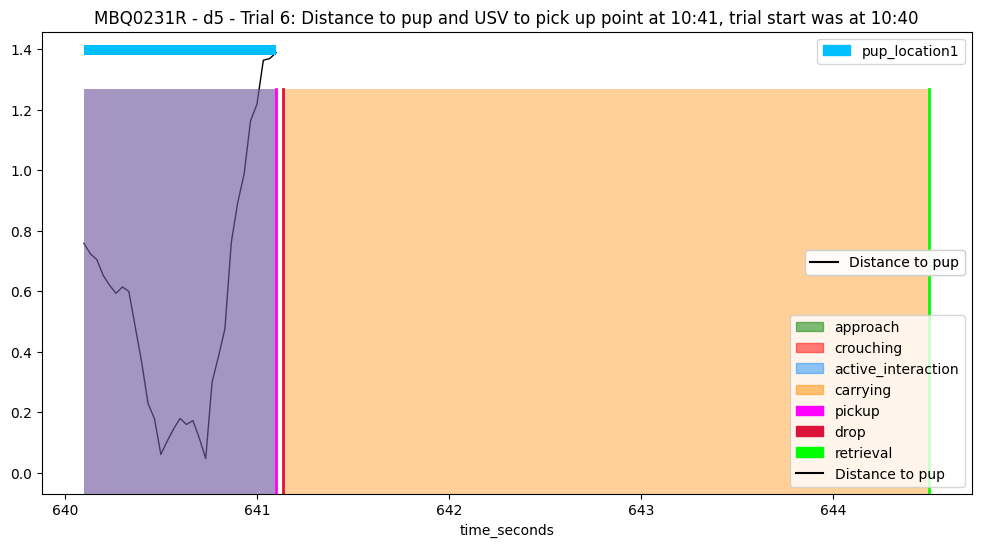

 ==== Example: MBQ0231R - d5 - 7 ==== 
 ==== Example: MBQ0231R - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 681.196
* Success time: 682.764
---> Pick up frame: 20436, Start frame: 19705, End frame: 20482
---> Retrieval frame: 20483; Start frame: 19705; End frame: 20482
---> Final frame: 20482
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  20436 * Pickup time:  681.196
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 778
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup

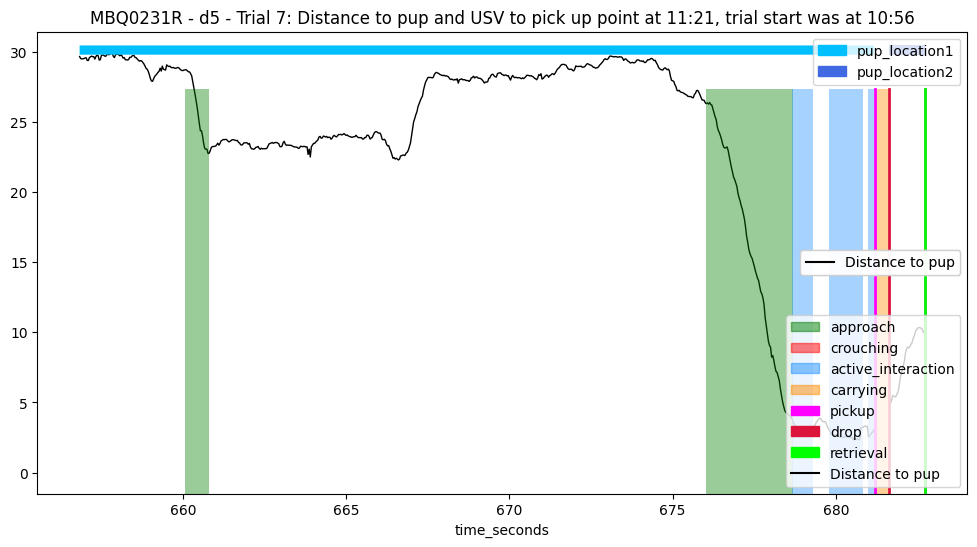

 ==== Example: MBQ0231R - d5 - 8 ==== 
 ==== Example: MBQ0231R - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 703.053
* Success time: 705.228
---> Pick up frame: 21092, Start frame: 21032, End frame: 21156
---> Retrieval frame: 21157; Start frame: 21032; End frame: 21156
---> Final frame: 21156
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  21092 * Pickup time:  703.053
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 125
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup

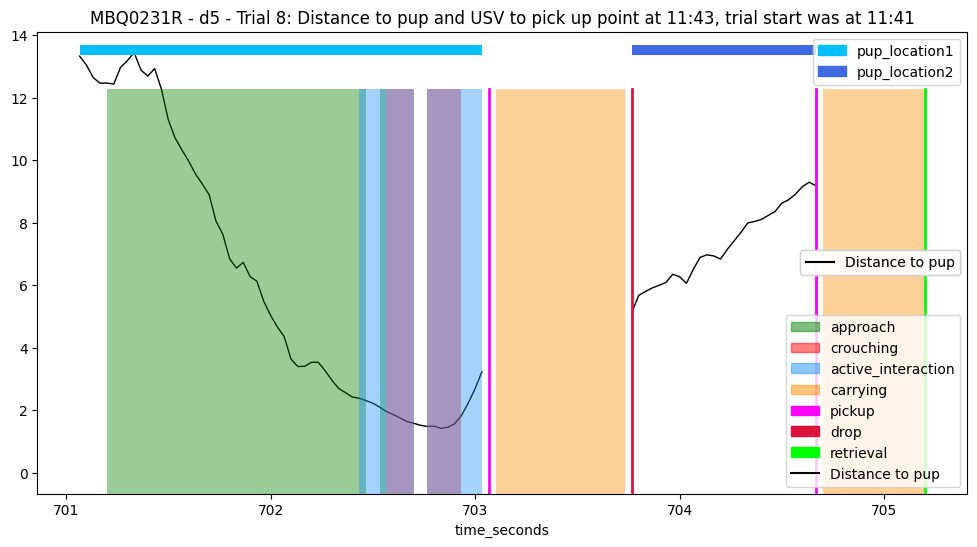

 ==== Example: MBQ0231R - d5 - 9 ==== 
 ==== Example: MBQ0231R - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 746.876
* Success time: 749.564
---> Pick up frame: 22406, Start frame: 21677, End frame: 22486
---> Retrieval frame: 22487; Start frame: 21677; End frame: 22486
---> Final frame: 22486
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22406 * Pickup time:  746.876
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 810
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        18
distance_head_to

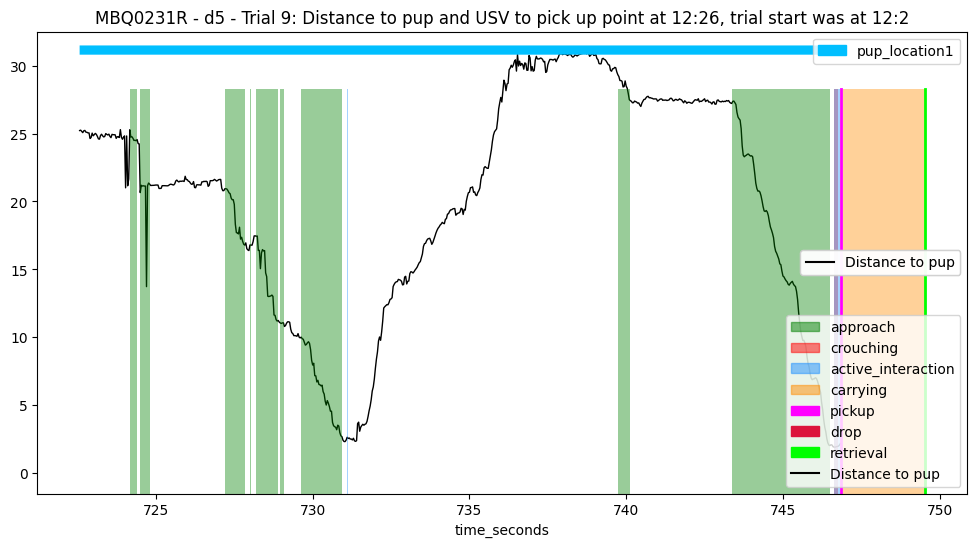

 ==== Example: MBQ0231R - d6 - 1 ==== 
 ==== Example: MBQ0231R - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3676
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_degrees    0
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        1075
distance_head_to_pup         1075
head_angle_to_pup

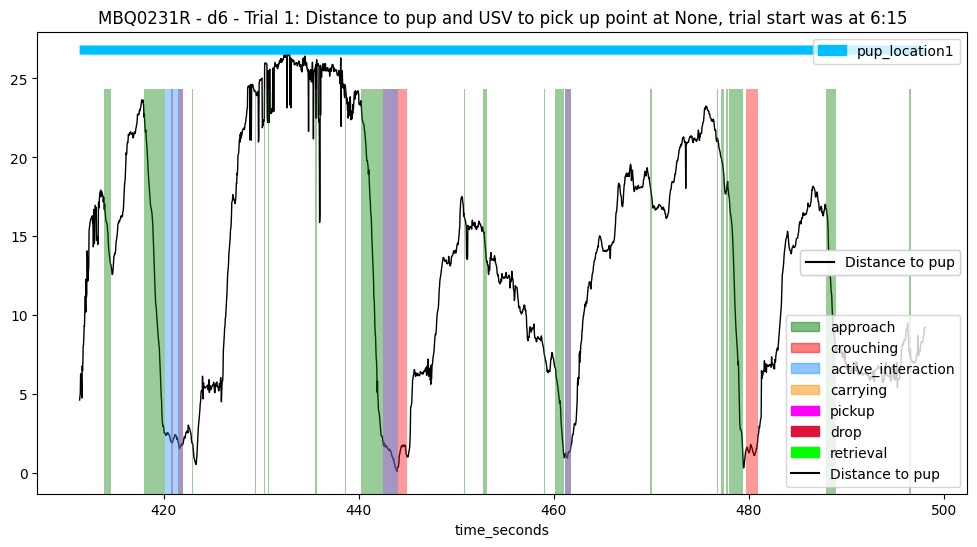

 ==== Example: MBQ0231R - d6 - 2 ==== 
 ==== Example: MBQ0231R - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 513.018
* Success time: 515.578
---> Pick up frame: 15391, Start frame: 15262, End frame: 15467
---> Retrieval frame: 15467; Start frame: 15262; End frame: 15467
---> Final frame: 15467
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15391 * Pickup time:  513.018
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 206
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 15391, instantly drop at 15392
---> Processing last pup location: p

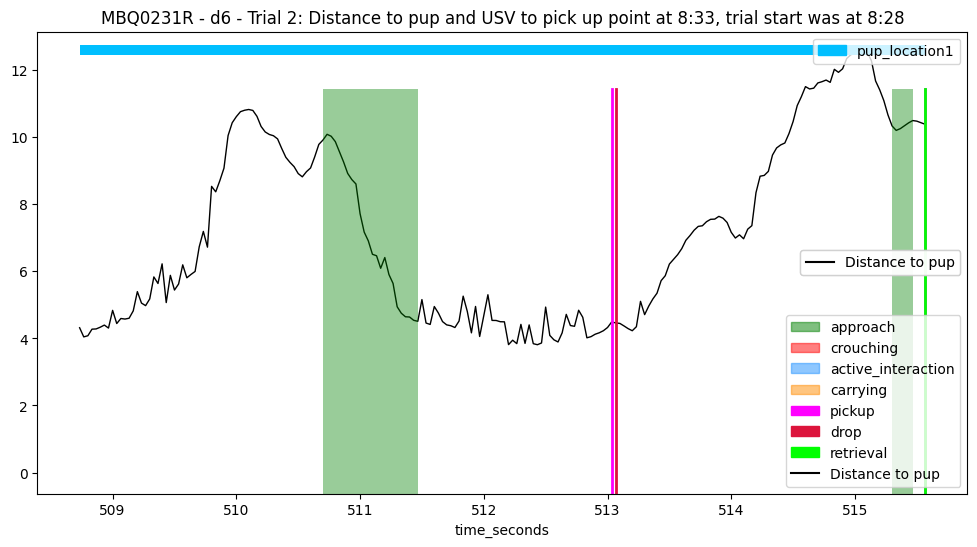

 ==== Example: MBQ0231R - d6 - 3 ==== 
 ==== Example: MBQ0231R - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 549.622
* Success time: 554.258
---> Pick up frame: 16489, Start frame: 16065, End frame: 16627
---> Retrieval frame: 16628; Start frame: 16065; End frame: 16627
---> Final frame: 16627
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  16489 * Pickup time:  549.622
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 563
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  21.66358711405858

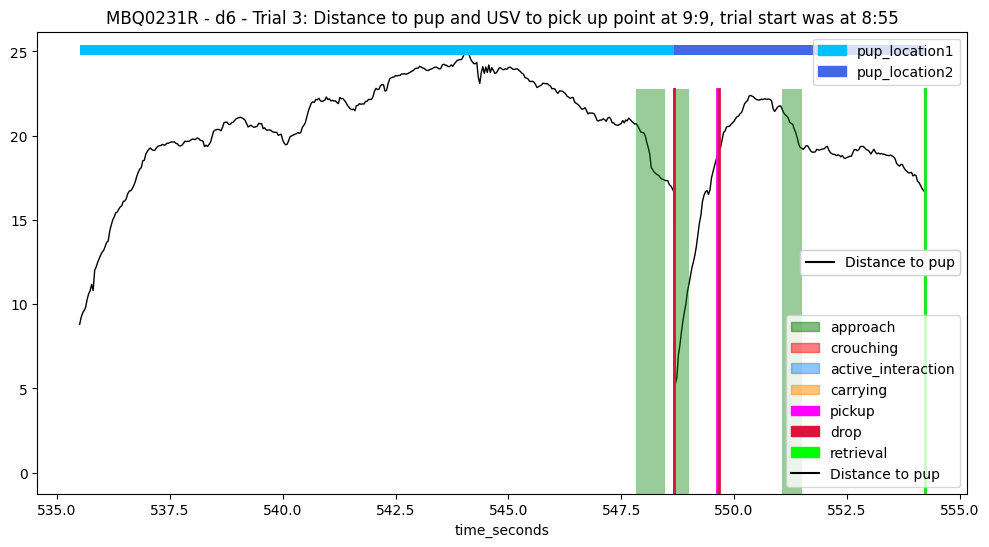

 ==== Example: MBQ0231R - d6 - 4 ==== 
 ==== Example: MBQ0231R - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 569.41
* Success time: 576.098
---> Pick up frame: 17082, Start frame: 17019, End frame: 17282
---> Retrieval frame: 17283; Start frame: 17019; End frame: 17282
---> Final frame: 17282
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17082 * Pickup time:  569.41
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 264
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 17082, instantly drop at 17083
---> Processing last pup location: pup

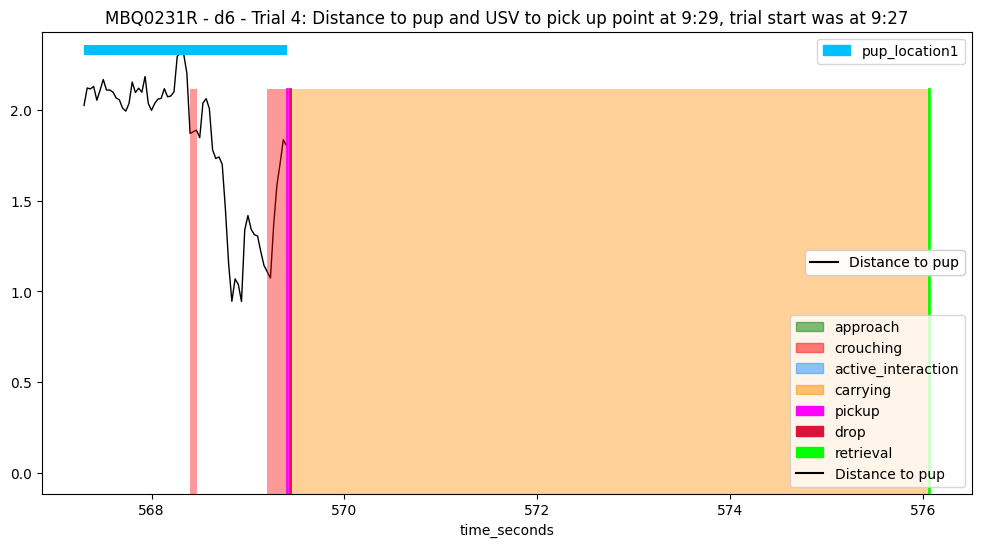

 ==== Example: MBQ0231R - d6 - 5 ==== 
 ==== Example: MBQ0231R - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 609.538
* Success time: 612.706
---> Pick up frame: 18286, Start frame: 18008, End frame: 18381
---> Retrieval frame: 18381; Start frame: 18008; End frame: 18381
---> Final frame: 18381
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18286 * Pickup time:  609.538
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 374
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 18286, instantly drop at 18287
---> Processing last pup location: p

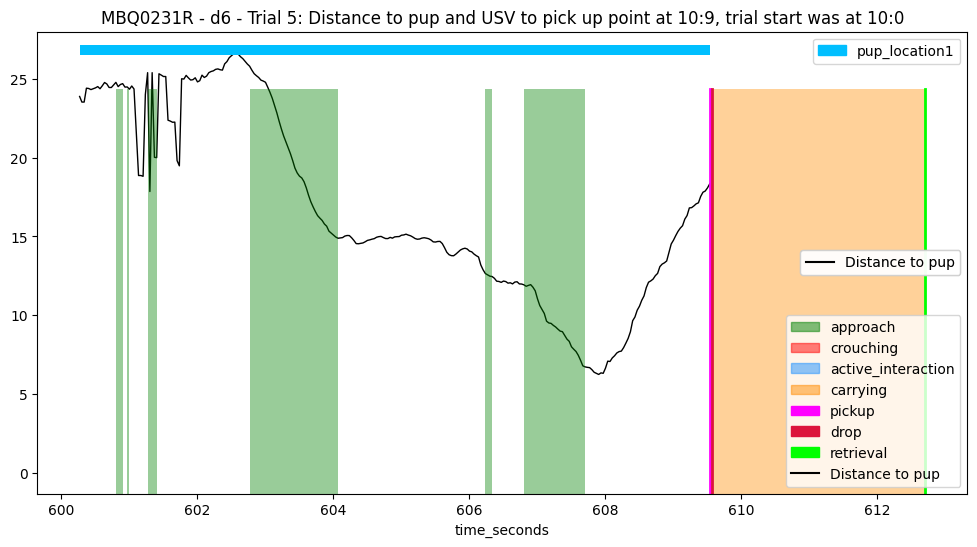

 ==== Example: MBQ0231R - d6 - 6 ==== 
 ==== Example: MBQ0231R - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 636.882
* Success time: 638.93
---> Pick up frame: 19106, Start frame: 18695, End frame: 19167
---> Retrieval frame: 19168; Start frame: 18695; End frame: 19167
---> Final frame: 19167
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  19106 * Pickup time:  636.882
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 473
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  6.306697694660975


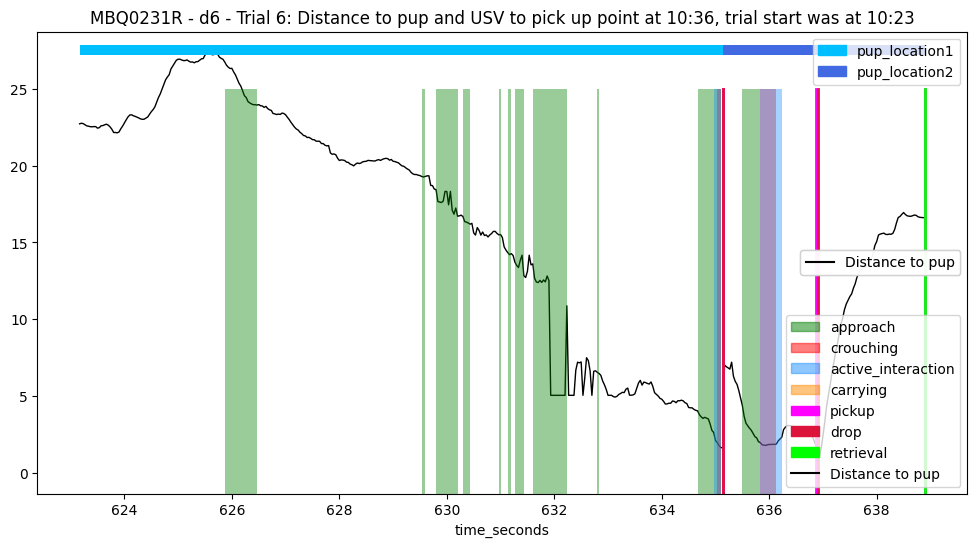

 ==== Example: MBQ0231R - d6 - 7 ==== 
 ==== Example: MBQ0231R - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 652.202
* Success time: 656.33
---> Pick up frame: 19566, Start frame: 19544, End frame: 19689
---> Retrieval frame: 19690; Start frame: 19544; End frame: 19689
---> Final frame: 19689
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19566 * Pickup time:  652.202
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 146
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 19566, instantly drop at 19567
---> Processing last pup location: pu

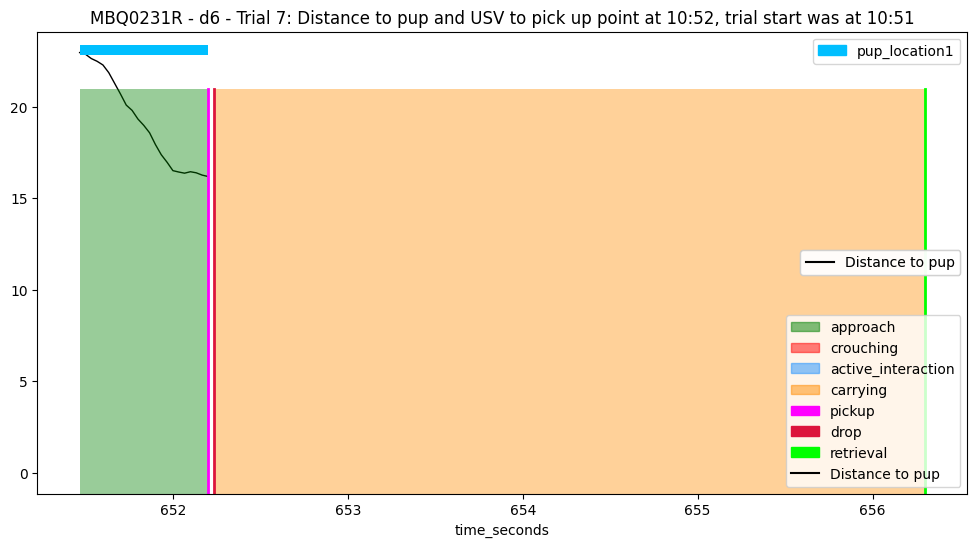

 ==== Example: MBQ0231R - d6 - 8 ==== 
 ==== Example: MBQ0231R - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 686.506
* Success time: 693.442
---> Pick up frame: 20595, Start frame: 20045, End frame: 20803
---> Retrieval frame: 20803; Start frame: 20045; End frame: 20803
---> Final frame: 20803
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  20595 * Pickup time:  686.506
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 759
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  22.97726166483119

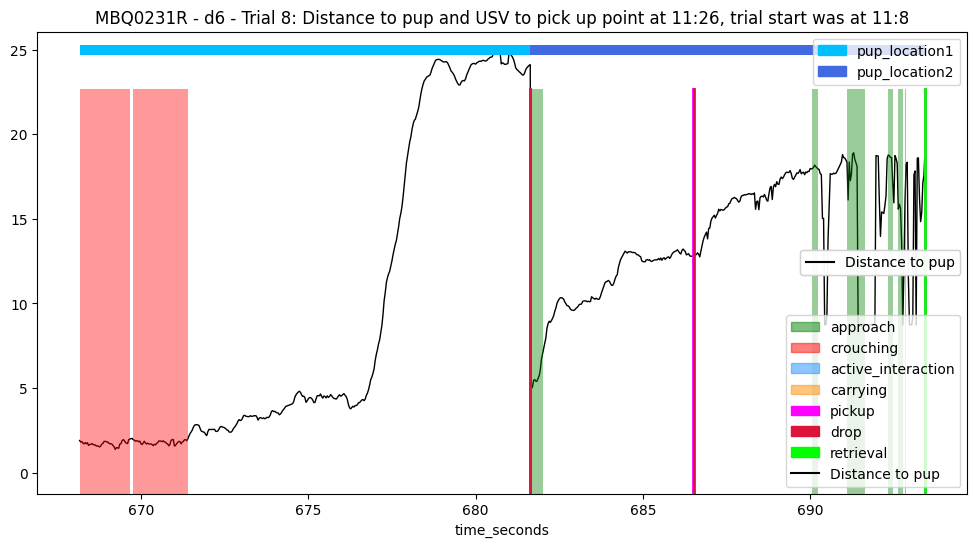

 ==== Example: MBQ0231R - d6 - 9 ==== 
 ==== Example: MBQ0231R - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 705.546
* Success time: 709.962
---> Pick up frame: 21166, Start frame: 21139, End frame: 21298
---> Retrieval frame: 21299; Start frame: 21139; End frame: 21298
---> Final frame: 21298
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21166 * Pickup time:  705.546
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 160
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 21166, instantly drop at 21167
---> Processing last pup location: p

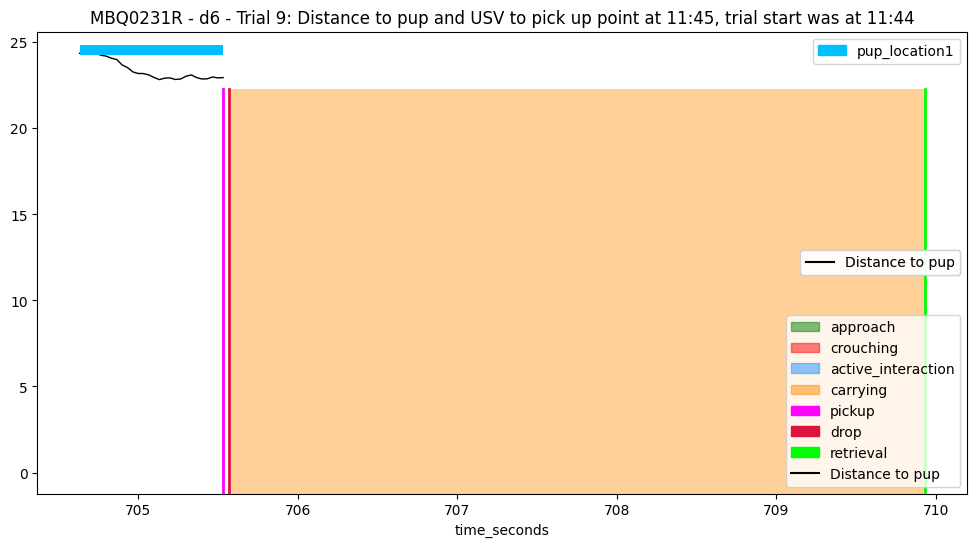

 ==== Example: MBI5336LL - d1 - 1 ==== 
 ==== Example: MBI5336LL - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 406.439
* Success time: None
---> Pick up frame: 12193, Start frame: 10040, End frame: 14144
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12193 * Pickup time:  406.439
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4105
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 12193, instantly drop at 12194
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        168
distance_head_

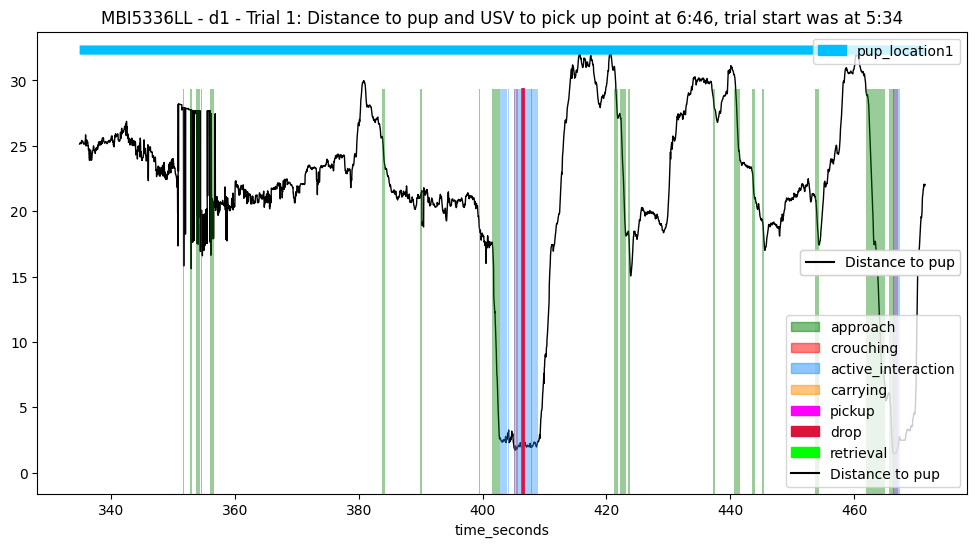

 ==== Example: MBI5336LL - d1 - 2 ==== 
 ==== Example: MBI5336LL - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 601.903
* Success time: None
---> Pick up frame: 18057, Start frame: 14285, End frame: 18227
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18057 * Pickup time:  601.903
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3943
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 18057, instantly drop at 18058
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        32
distance_head_t

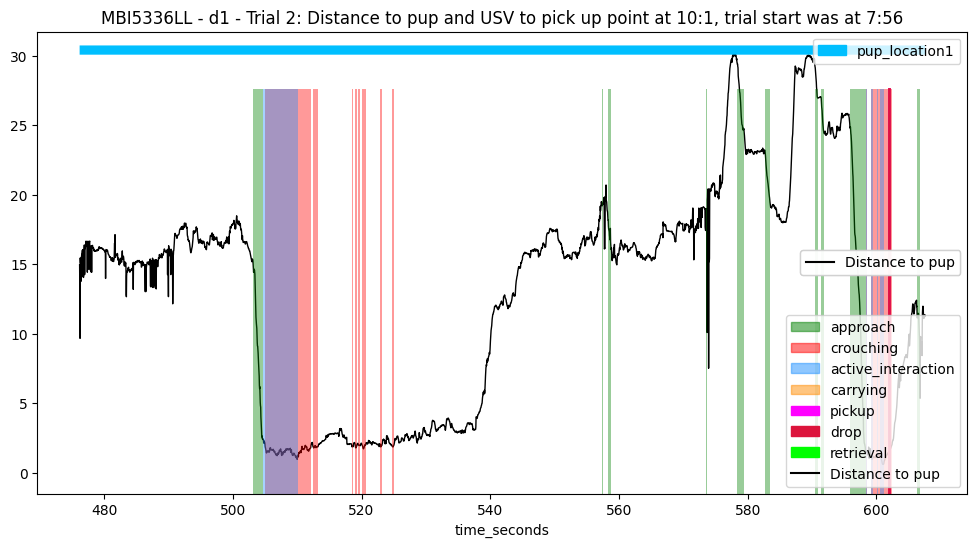

 ==== Example: MBI5336LL - d1 - 3 ==== 
 ==== Example: MBI5336LL - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3650
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pup_degrees    52
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pu

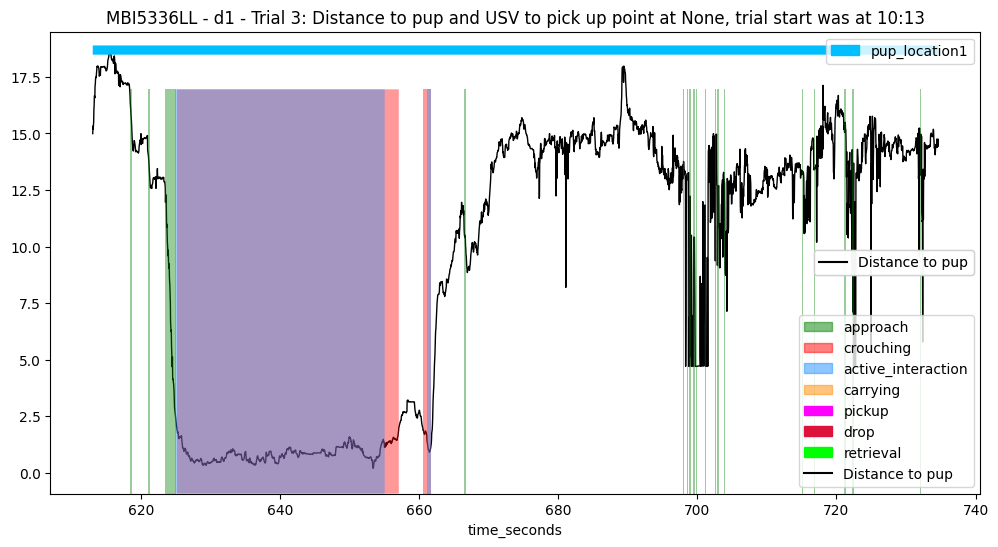

 ==== Example: MBI5336LL - d1 - 4 ==== 
 ==== Example: MBI5336LL - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4122
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        76
distance_head_to_pup         76
head_angle_to_pup_degrees    76
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        76
distance_head_to_pup         76
head_angle_to_pu

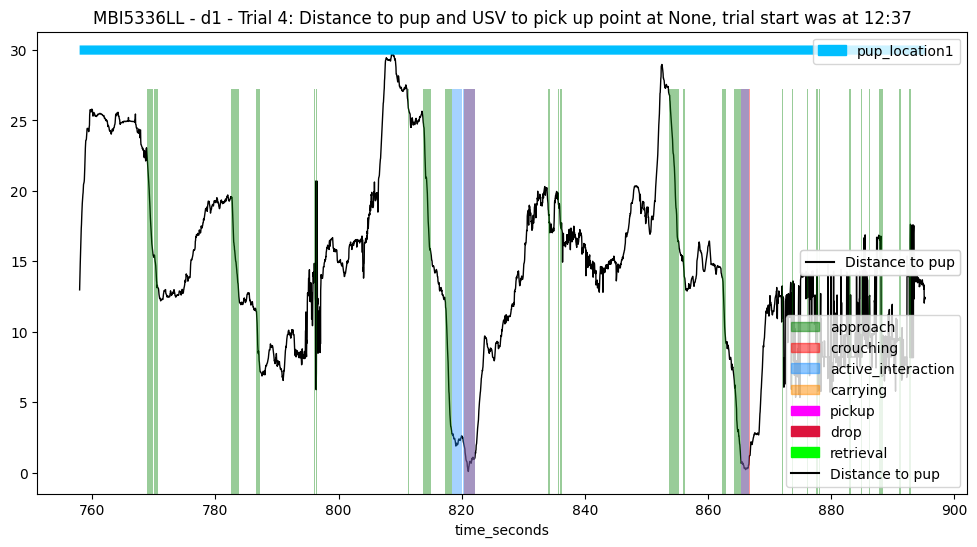

 ==== Example: MBI5336LL - d1 - 5 ==== 
 ==== Example: MBI5336LL - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3711
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3711
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 912.903 to 981.6333333333

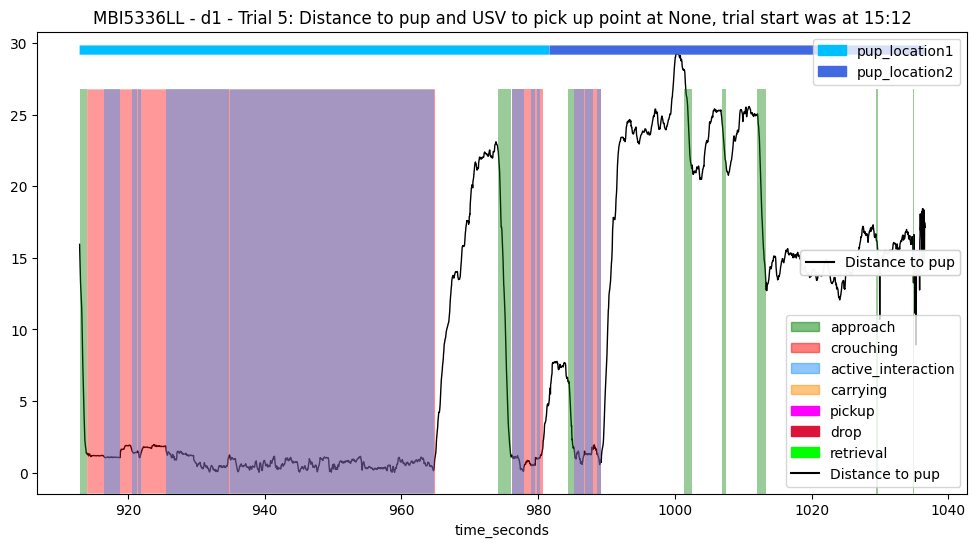

 ==== Example: MBI5336LL - d1 - 6 ==== 
 ==== Example: MBI5336LL - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3549
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pup_degrees    47
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pu

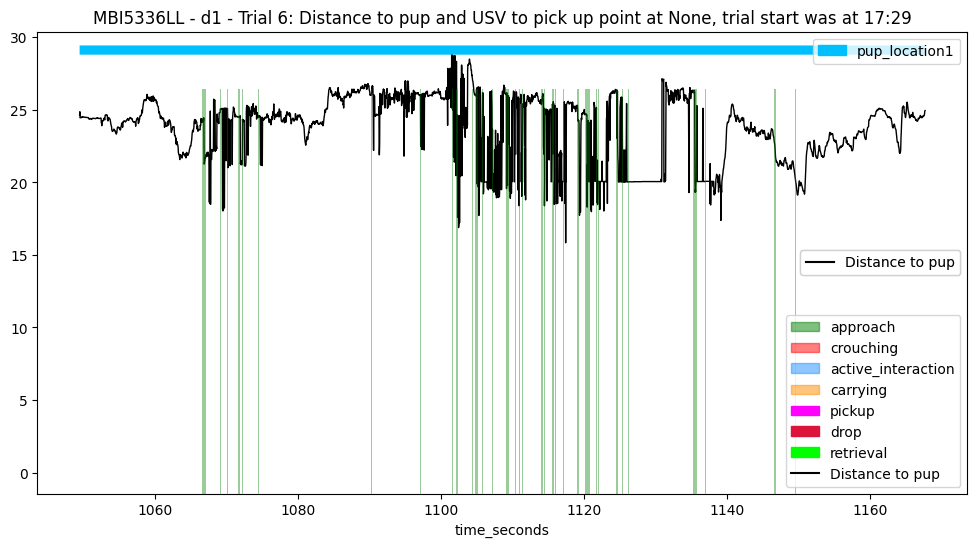

 ==== Example: MBI5336LL - d1 - 7 ==== 
 ==== Example: MBI5336LL - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3921
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        49
distance_head_to_pup         49
head_angle_to_pup_degrees    49
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pu

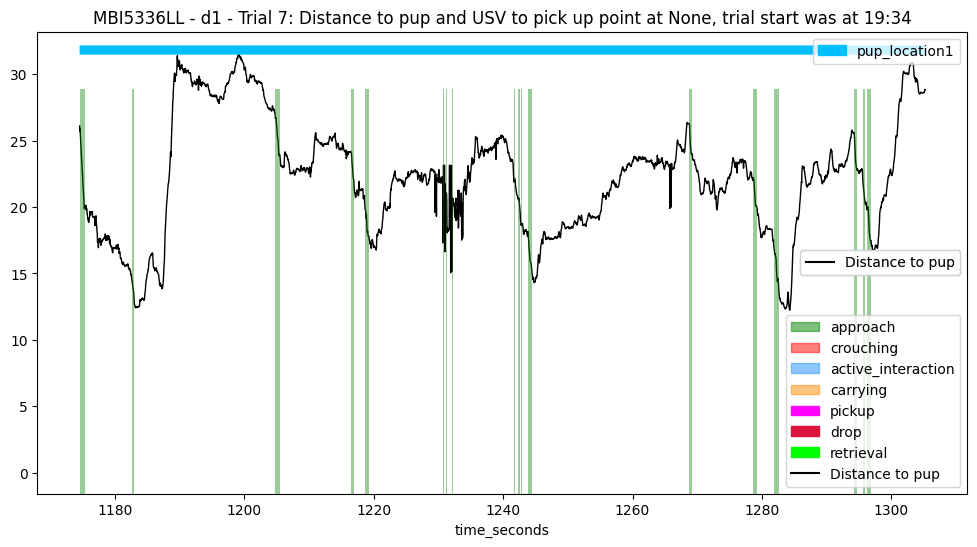

 ==== Example: MBI5336LL - d1 - 8 ==== 
 ==== Example: MBI5336LL - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1368.327
* Success time: 1370.272
---> Pick up frame: 41050, Start frame: 39509, End frame: 41108
---> Retrieval frame: 41108; Start frame: 39509; End frame: 41108
---> Final frame: 41108
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41050 * Pickup time:  1368.327
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1600
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_h

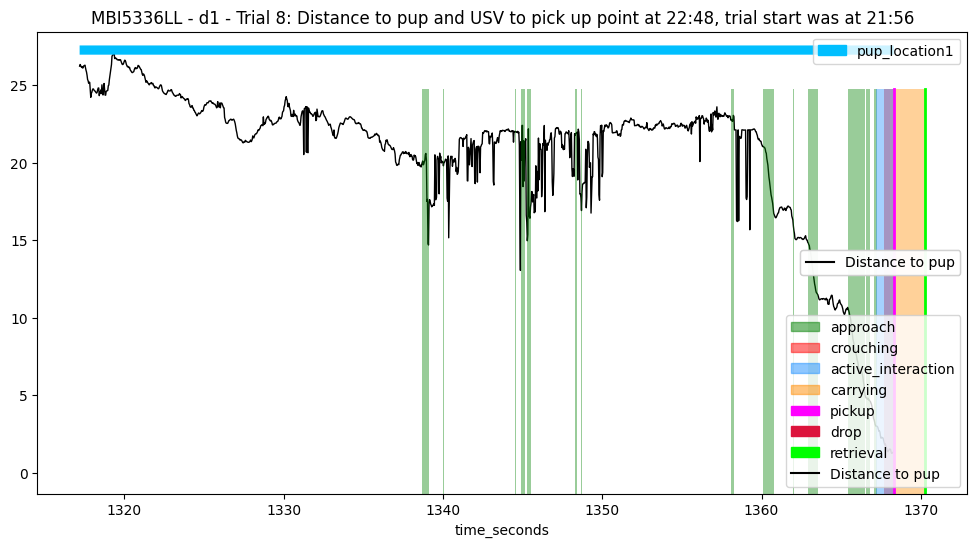

 ==== Example: MBI5336LL - d1 - 9 ==== 
 ==== Example: MBI5336LL - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1386.631
* Success time: 1393.247
---> Pick up frame: 41599, Start frame: 41444, End frame: 41797
---> Retrieval frame: 41797; Start frame: 41444; End frame: 41797
---> Final frame: 41797
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41599 * Pickup time:  1386.631
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 354
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 41599, instantly drop at 41600
---> Processing last pup locati

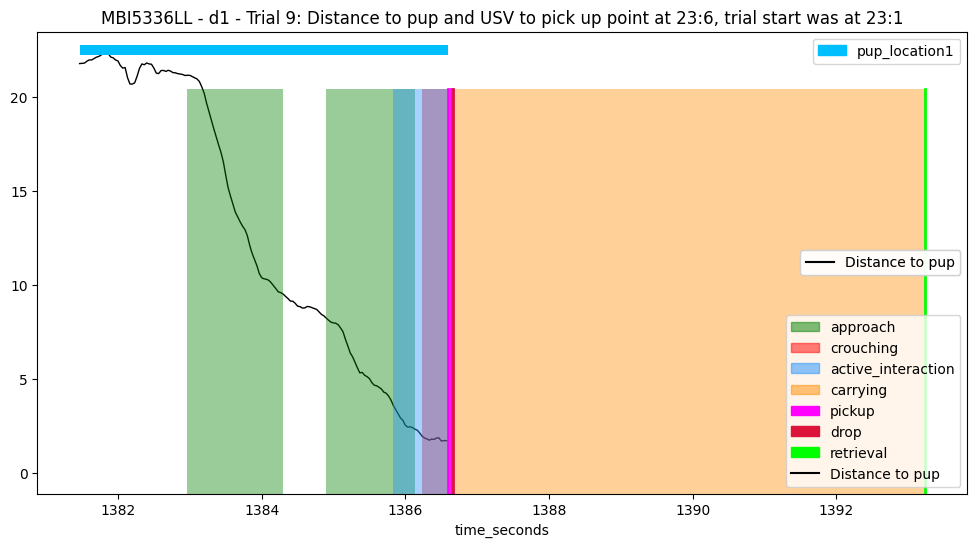

 ==== Example: MBI5336LL - d2 - 1 ==== 
 ==== Example: MBI5336LL - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 406.2
* Success time: 409.08
---> Pick up frame: 12186, Start frame: 11367, End frame: 12272
---> Retrieval frame: 12272; Start frame: 11367; End frame: 12272
---> Final frame: 12272
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12186 * Pickup time:  406.2
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 906
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        79
distance_head_to_pu

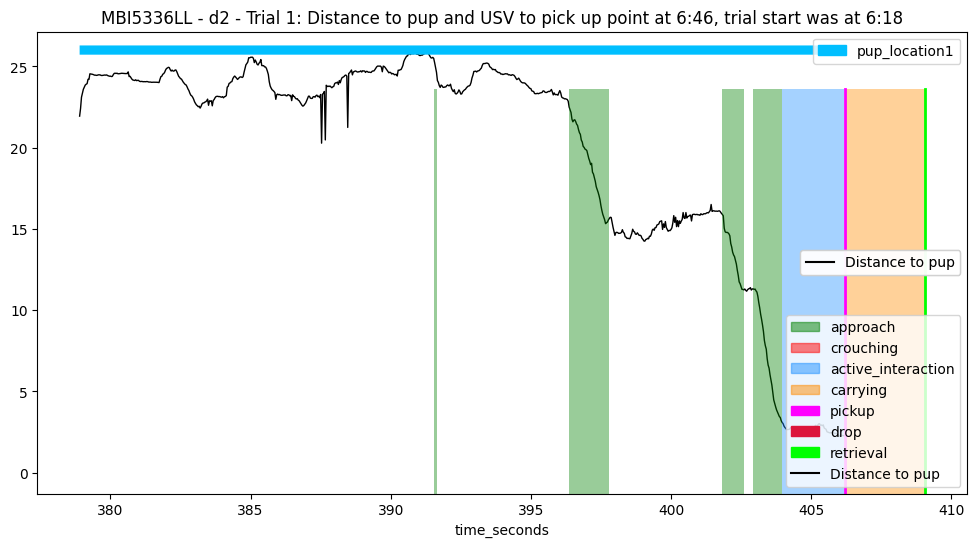

 ==== Example: MBI5336LL - d2 - 2 ==== 
 ==== Example: MBI5336LL - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 584.13
* Success time: 588.15
---> Pick up frame: 17524, Start frame: 14128, End frame: 17644
---> Retrieval frame: 17644; Start frame: 14128; End frame: 17644
---> Final frame: 17644
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17524 * Pickup time:  584.13
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3517
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        83
distance_head_to

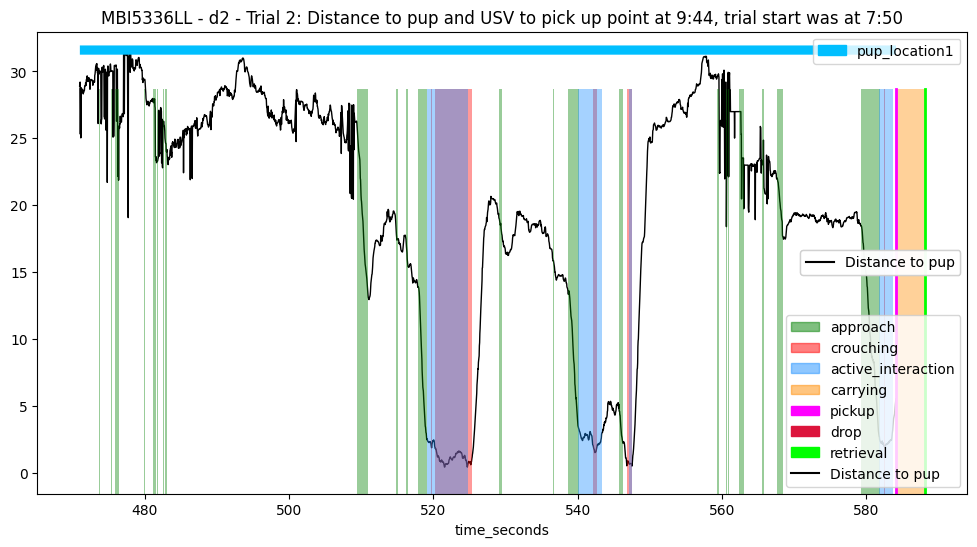

 ==== Example: MBI5336LL - d2 - 3 ==== 
 ==== Example: MBI5336LL - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4022
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        67
distance_head_to_pup         67
head_angle_to_pup_degrees    67
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        70
distance_head_to_pup         70
head_angle_to_pu

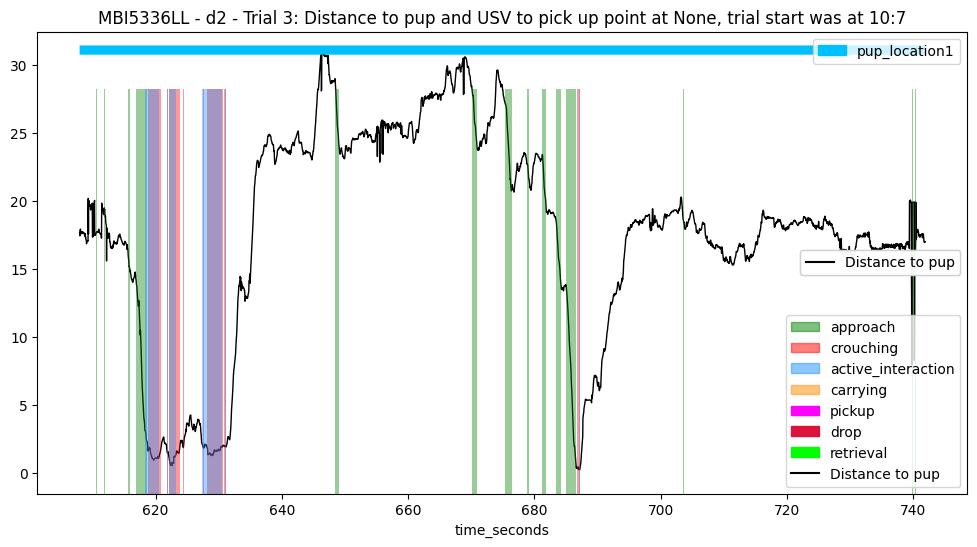

 ==== Example: MBI5336LL - d2 - 4 ==== 
 ==== Example: MBI5336LL - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 756.888
* Success time: 762.96
---> Pick up frame: 22707, Start frame: 22408, End frame: 22888
---> Retrieval frame: 22889; Start frame: 22408; End frame: 22888
---> Final frame: 22888
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22707 * Pickup time:  756.888
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 481
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_t

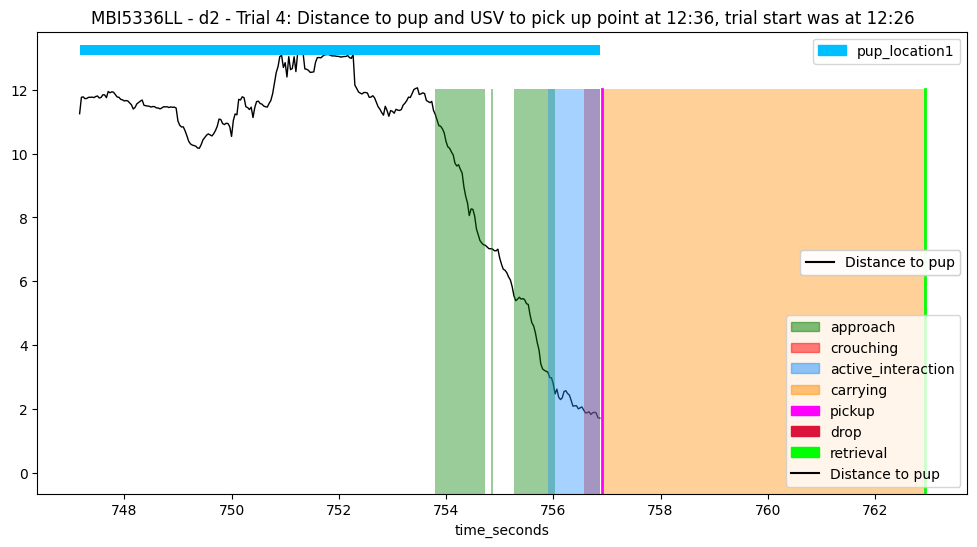

 ==== Example: MBI5336LL - d2 - 5 ==== 
 ==== Example: MBI5336LL - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 834.504
* Success time: 837.576
---> Pick up frame: 25035, Start frame: 23325, End frame: 25127
---> Retrieval frame: 25127; Start frame: 23325; End frame: 25127
---> Final frame: 25127
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25035 * Pickup time:  834.504
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1803
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        80
distance_head

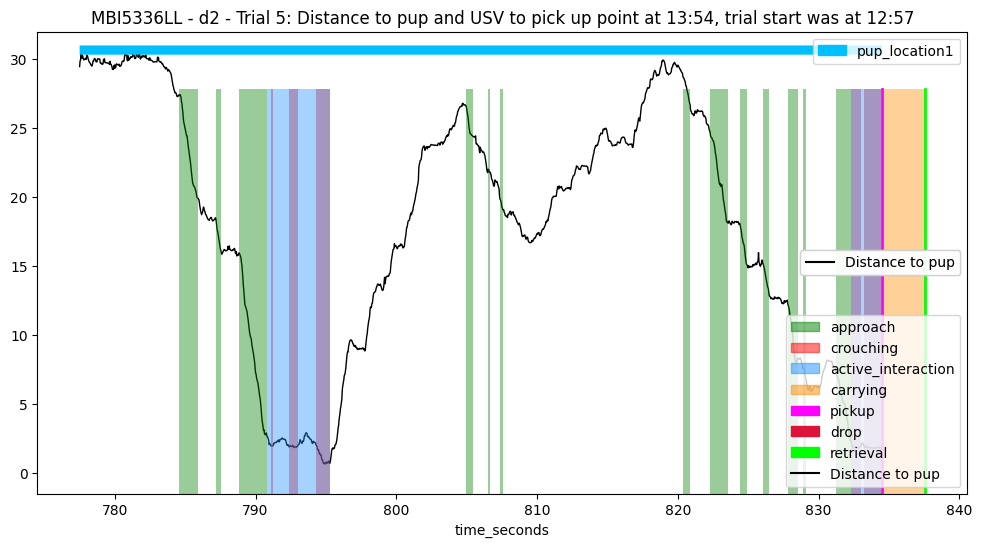

 ==== Example: MBI5336LL - d2 - 6 ==== 
 ==== Example: MBI5336LL - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 853.56
* Success time: None
---> Pick up frame: 25607, Start frame: 25505, End frame: 29069
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  25607 * Pickup time:  853.56
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3565
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        32
distance_head_to_pup         32
head_angle_to_p

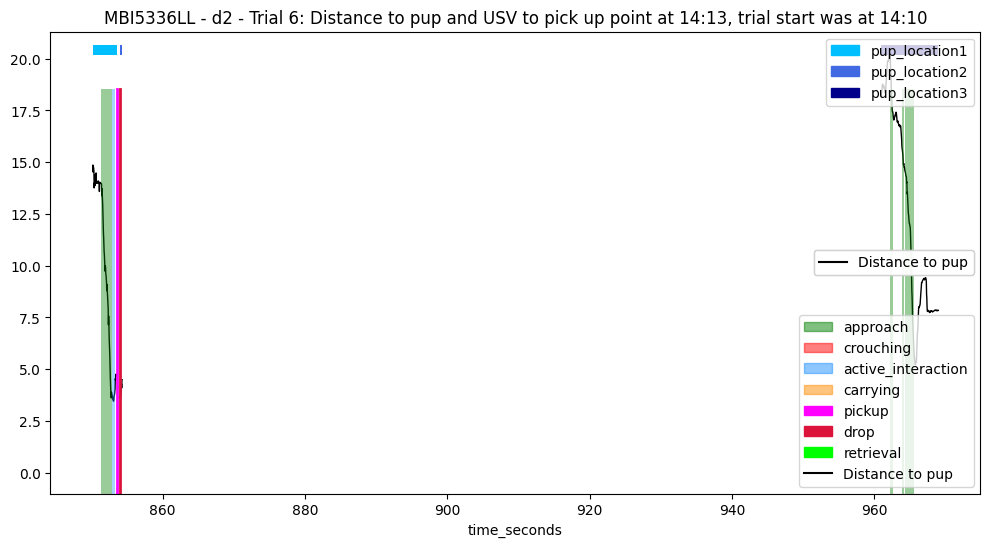

 ==== Example: MBI5336LL - d2 - 7 ==== 
 ==== Example: MBI5336LL - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4014
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_degrees    60
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        61
distance_head_to_pup         61
head_angle_to_pu

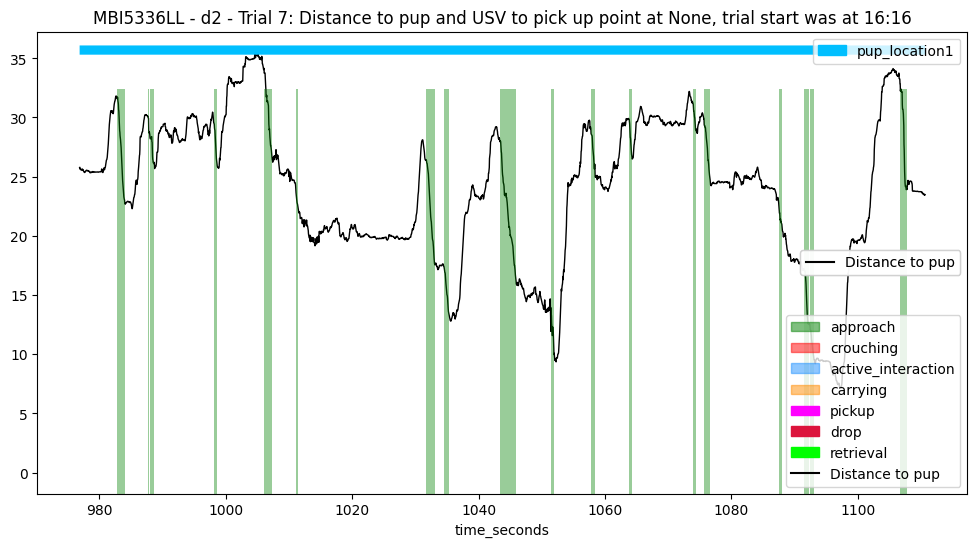

 ==== Example: MBI5336LL - d2 - 8 ==== 
 ==== Example: MBI5336LL - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1212.209
* Success time: None
---> Pick up frame: 36366, Start frame: 33544, End frame: 37150
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  36366 * Pickup time:  1212.209
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3607
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 36366, instantly drop at 36367
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head

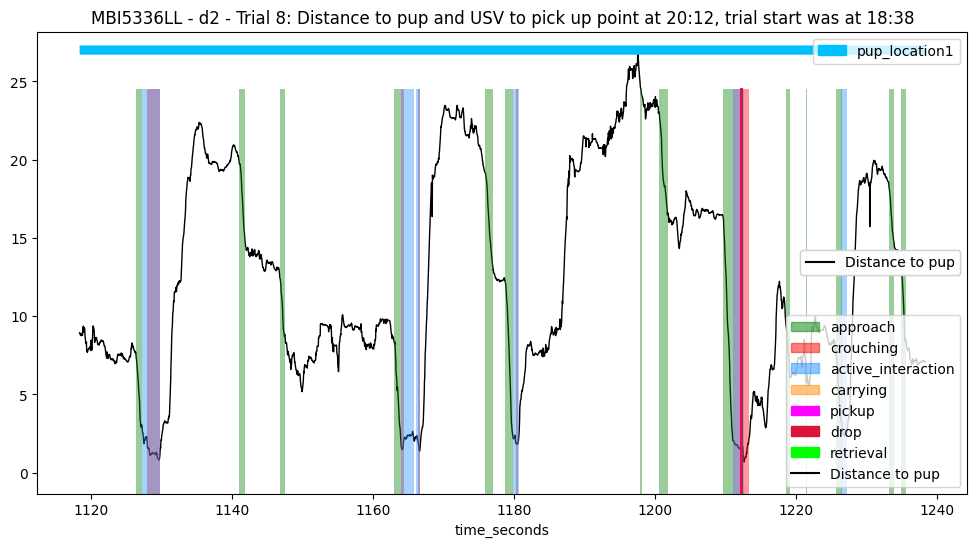

 ==== Example: MBI5336LL - d2 - 9 ==== 
 ==== Example: MBI5336LL - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1258.424
* Success time: None
---> Pick up frame: 37753, Start frame: 37369, End frame: 37836
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  37753 * Pickup time:  1258.424
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 468
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_head_to_pup         39
head_angle_to_pup_degrees    39
dtype: int64
---Overall NaN counts:  distanc

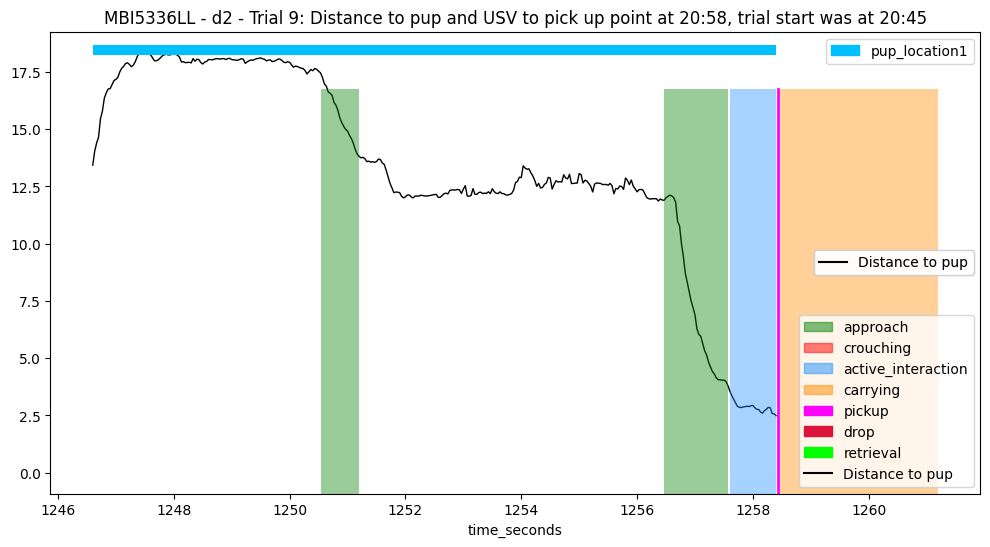

 ==== Example: MBI5336LL - d3 - 1 ==== 
 ==== Example: MBI5336LL - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 395.72
* Success time: 398.416
---> Pick up frame: 11872, Start frame: 11445, End frame: 11952
---> Retrieval frame: 11952; Start frame: 11445; End frame: 11952
---> Final frame: 11952
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  11872 * Pickup time:  395.72
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 508
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        80
distance_head_to

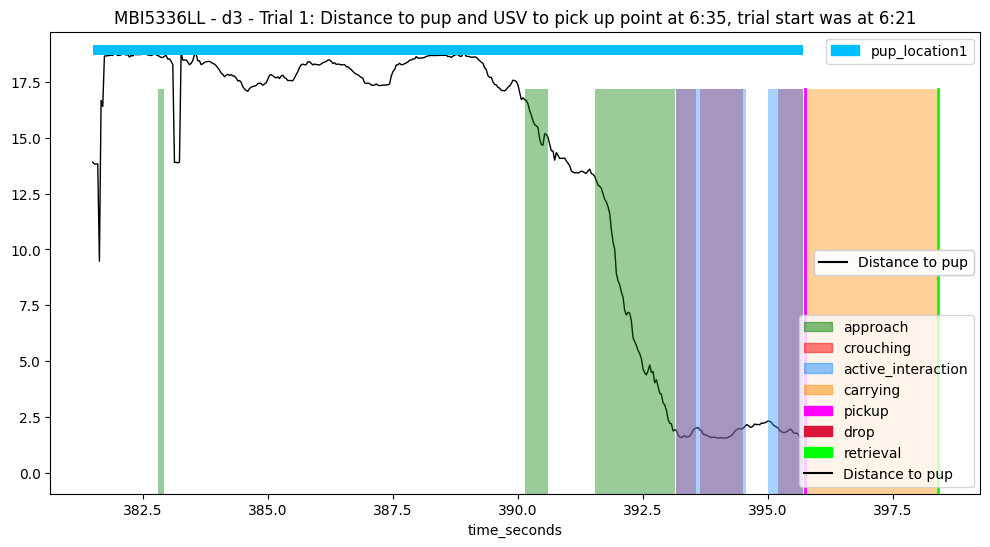

 ==== Example: MBI5336LL - d3 - 2 ==== 
 ==== Example: MBI5336LL - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: 440.584
---> Retrieval frame: 13218; Start frame: 12284; End frame: 13217
---> Final frame: 13217
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 934
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'retrieval' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        499
               True      False        433


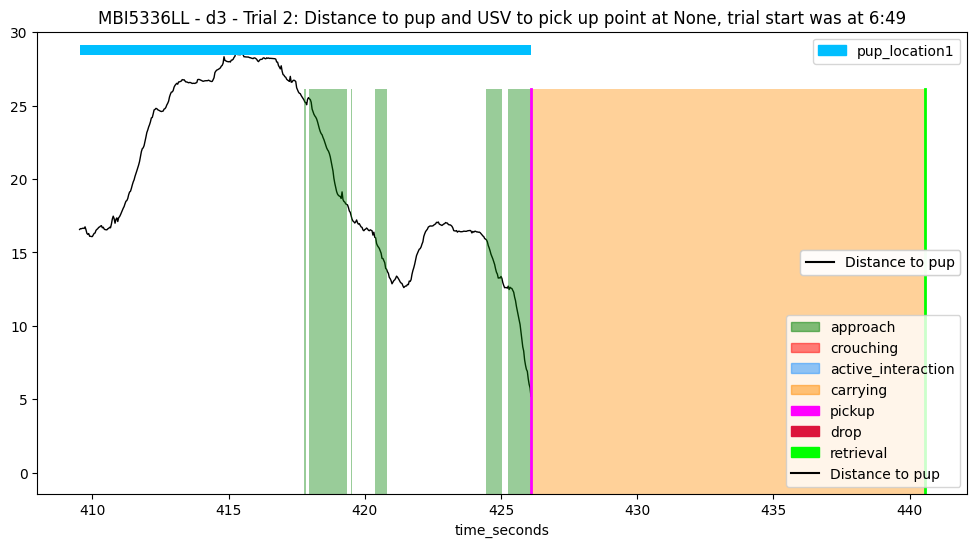

 ==== Example: MBI5336LL - d3 - 3 ==== 
 ==== Example: MBI5336LL - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 540.888
* Success time: None
---> Pick up frame: 16227, Start frame: 13824, End frame: 17615
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16227 * Pickup time:  540.888
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3792
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 16227, instantly drop at 16228
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        402
distance_head_

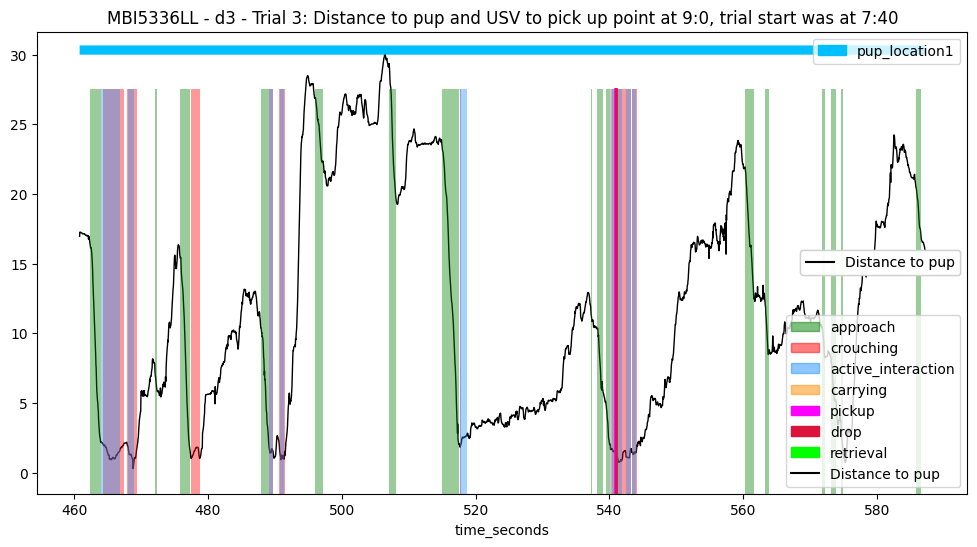

 ==== Example: MBI5336LL - d3 - 4 ==== 
 ==== Example: MBI5336LL - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 614.08
* Success time: 616.416
---> Pick up frame: 18422, Start frame: 17808, End frame: 18492
---> Retrieval frame: 18492; Start frame: 17808; End frame: 18492
---> Final frame: 18492
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18422 * Pickup time:  614.08
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 685
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        24
distance_head_to

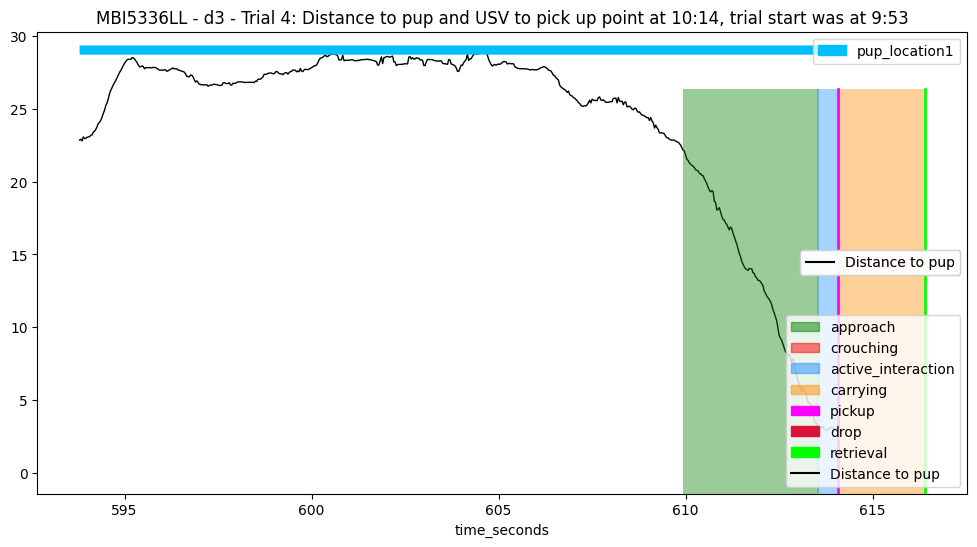

 ==== Example: MBI5336LL - d3 - 5 ==== 
 ==== Example: MBI5336LL - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 642.896
* Success time: 647.216
---> Pick up frame: 19287, Start frame: 18977, End frame: 19416
---> Retrieval frame: 19416; Start frame: 18977; End frame: 19416
---> Final frame: 19416
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19287 * Pickup time:  642.896
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 440
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        88
distance_head_

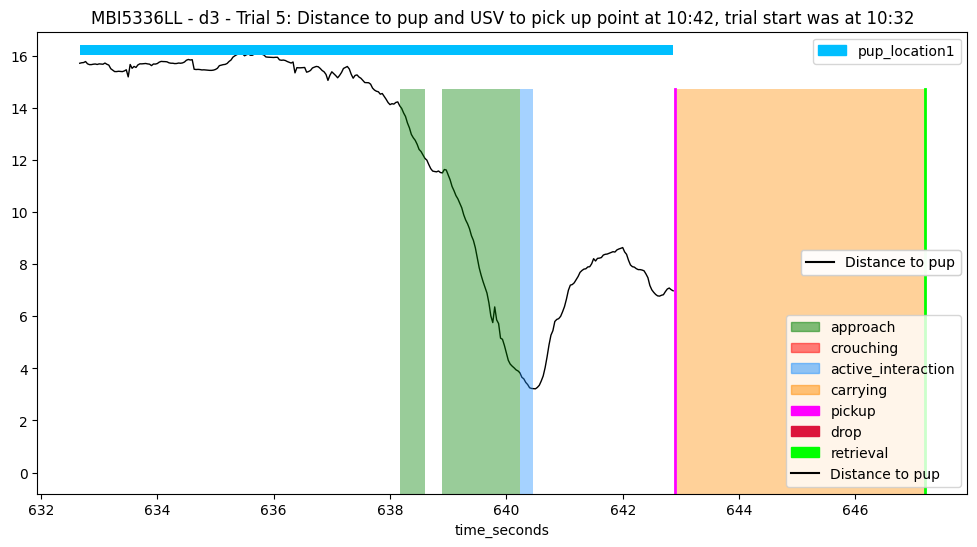

 ==== Example: MBI5336LL - d3 - 6 ==== 
 ==== Example: MBI5336LL - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 699.256
* Success time: 704.104
---> Pick up frame: 20978, Start frame: 19772, End frame: 21123
---> Retrieval frame: 21123; Start frame: 19772; End frame: 21123
---> Final frame: 21123
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20978 * Pickup time:  699.256
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1352
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        13
distance_head

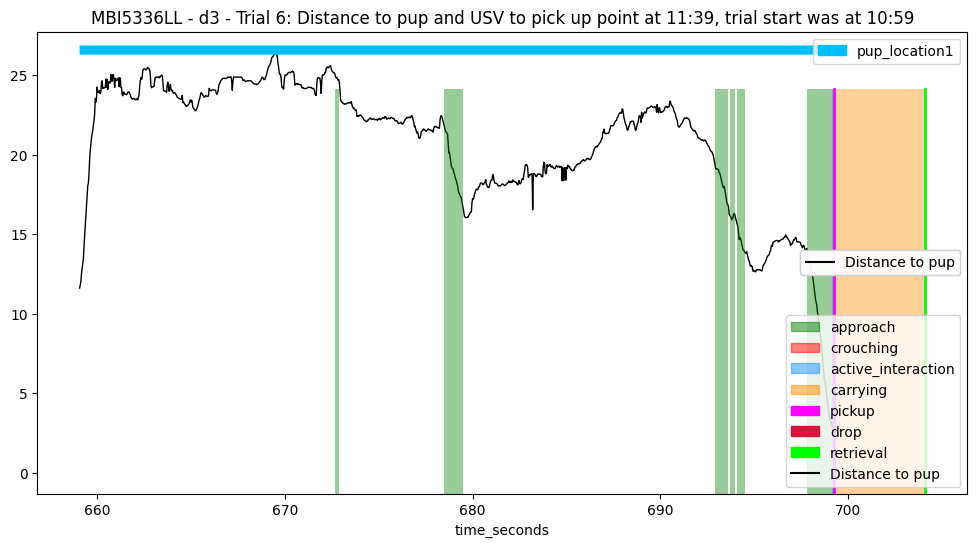

 ==== Example: MBI5336LL - d3 - 7 ==== 
 ==== Example: MBI5336LL - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 745.744
* Success time: None
---> Pick up frame: 22372, Start frame: 21498, End frame: 25323
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22372 * Pickup time:  745.744
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3826
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 22372, instantly drop at 22373
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        59
distance_head_t

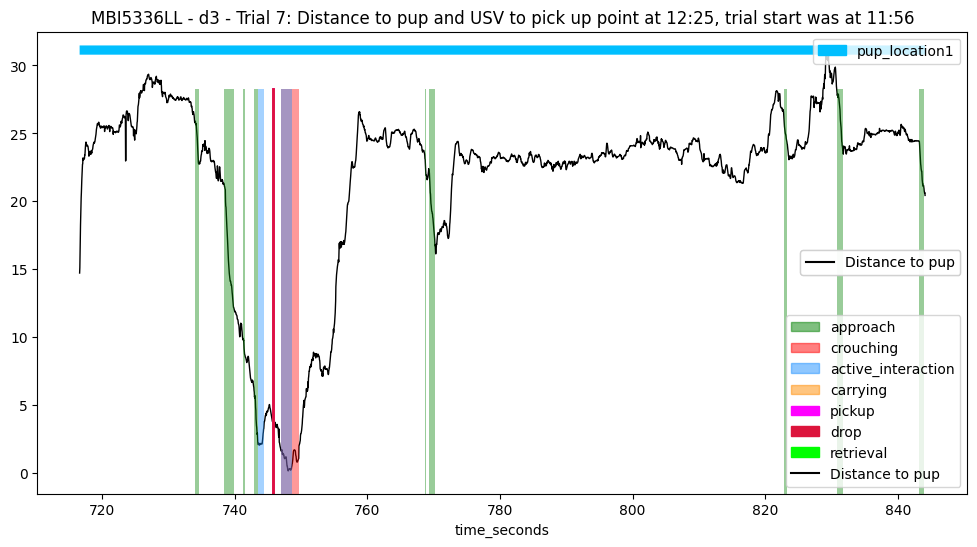

 ==== Example: MBI5336LL - d3 - 8 ==== 
 ==== Example: MBI5336LL - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 899.305
* Success time: None
---> Pick up frame: 26979, Start frame: 25578, End frame: 29357
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  26979 * Pickup time:  899.305
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3780
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_to_pup         30
head_angle_to_pup_degrees    30
dtype: int64
--

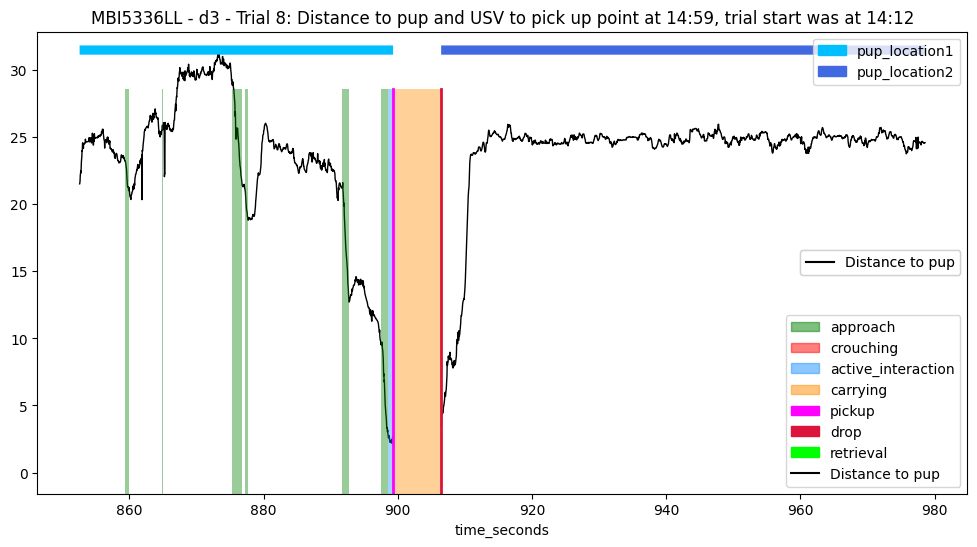

 ==== Example: MBI5336LL - d3 - 9 ==== 
 ==== Example: MBI5336LL - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1031.865
* Success time: 1034.16
---> Pick up frame: 30956, Start frame: 29509, End frame: 31024
---> Retrieval frame: 31025; Start frame: 29509; End frame: 31024
---> Final frame: 31024
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  30956 * Pickup time:  1031.865
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1516
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_he

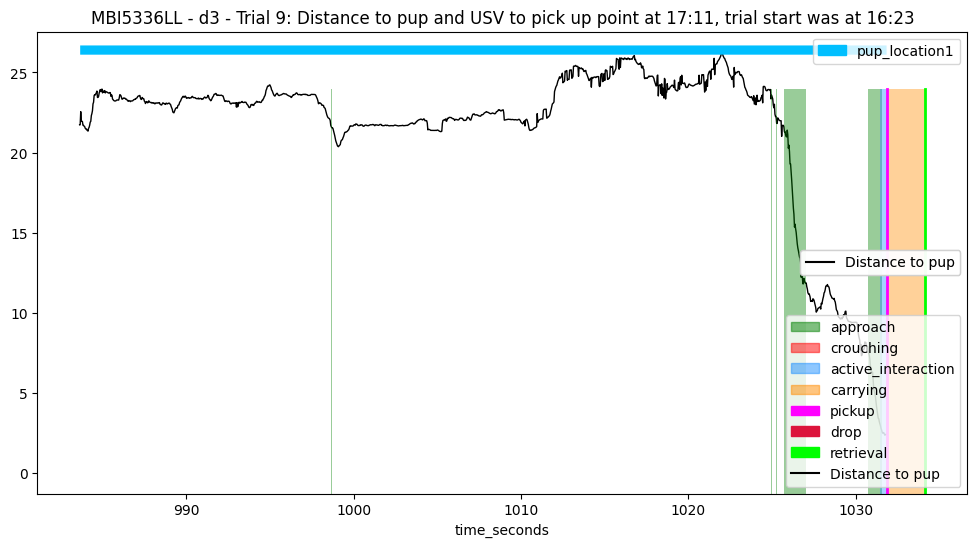

 ==== Example: MBI5336LL - d4 - 1 ==== 
 ==== Example: MBI5336LL - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 471.013
* Success time: 474.045
---> Pick up frame: 14130, Start frame: 13204, End frame: 14221
---> Retrieval frame: 14221; Start frame: 13204; End frame: 14221
---> Final frame: 14221
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14130 * Pickup time:  471.013
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1018
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_head

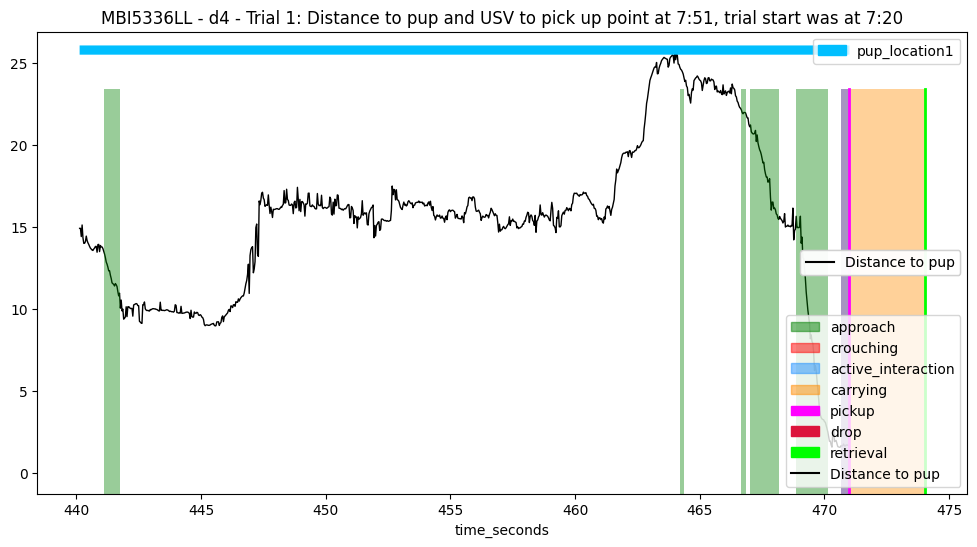

 ==== Example: MBI5336LL - d4 - 2 ==== 
 ==== Example: MBI5336LL - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 494.773
* Success time: 496.749
---> Pick up frame: 14843, Start frame: 14643, End frame: 14902
---> Retrieval frame: 14902; Start frame: 14643; End frame: 14902
---> Final frame: 14902
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14843 * Pickup time:  494.773
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 260
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_

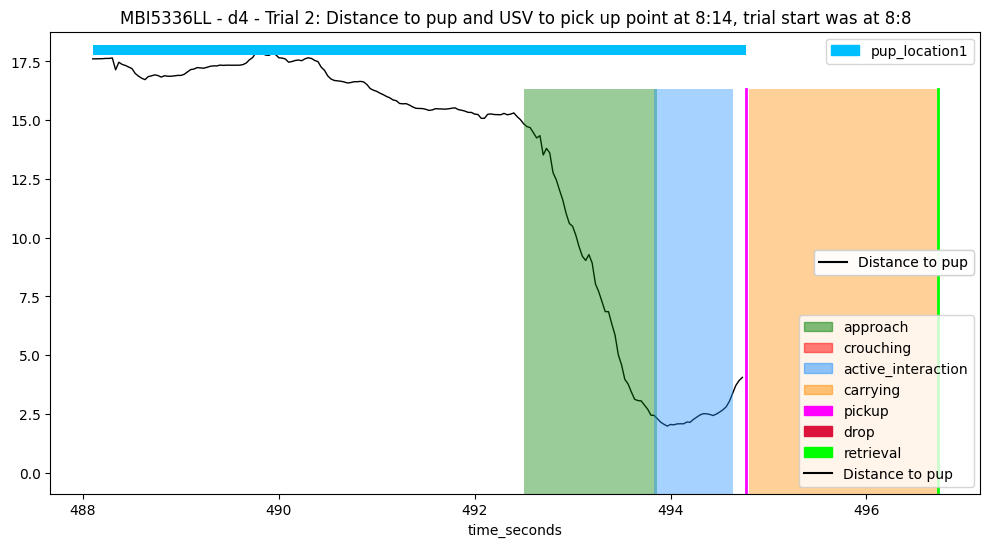

 ==== Example: MBI5336LL - d4 - 3 ==== 
 ==== Example: MBI5336LL - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 561.821
* Success time: None
---> Pick up frame: 16855, Start frame: 15173, End frame: 18887
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16855 * Pickup time:  561.821
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3715
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 16855, instantly drop at 16856
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        77
distance_head_t

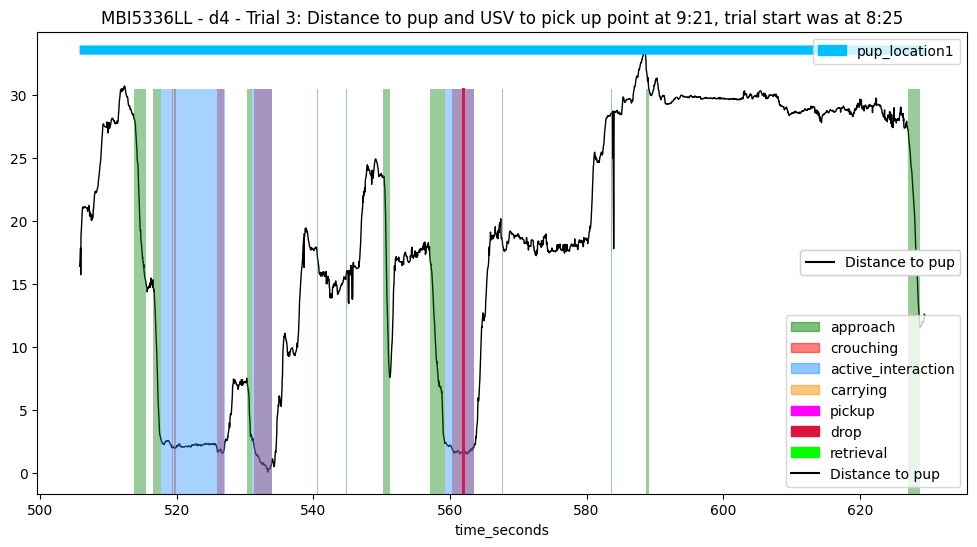

 ==== Example: MBI5336LL - d4 - 4 ==== 
 ==== Example: MBI5336LL - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 668.501
* Success time: None
---> Pick up frame: 20055, Start frame: 19185, End frame: 22988
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20055 * Pickup time:  668.501
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3804
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 20055, instantly drop at 20056
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_t

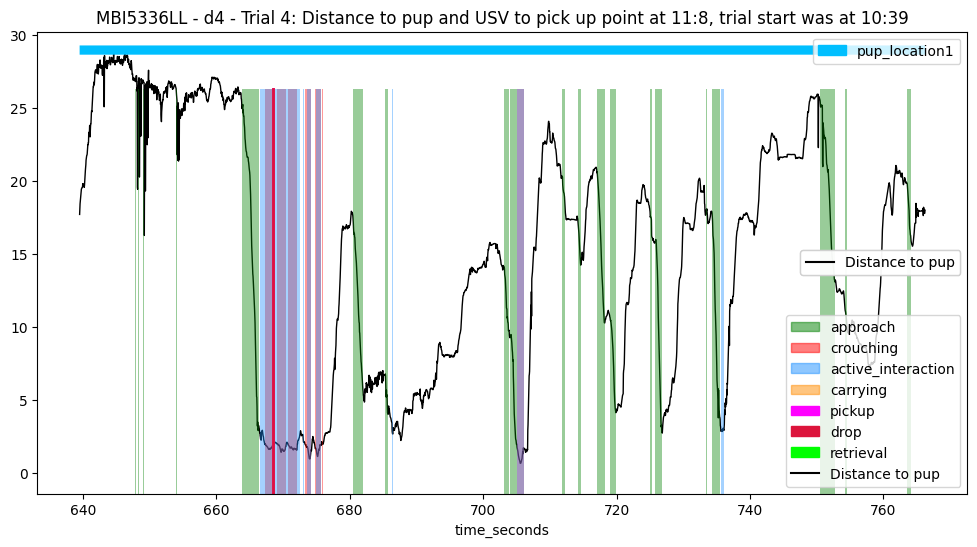

 ==== Example: MBI5336LL - d4 - 5 ==== 
 ==== Example: MBI5336LL - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: 783.341
---> Retrieval frame: 23500; Start frame: 23099; End frame: 23500
---> Final frame: 23500
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 402
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'retrieval' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        253
               True      False        147


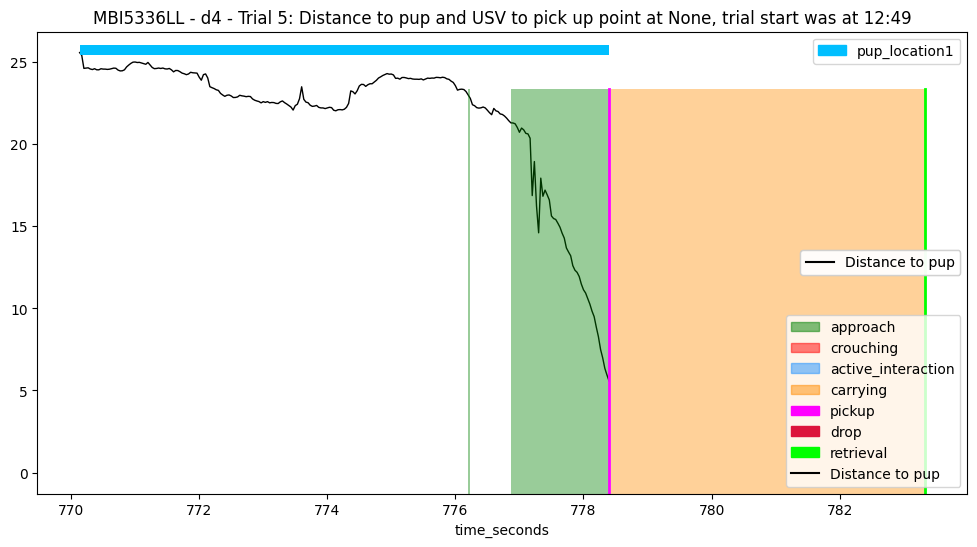

 ==== Example: MBI5336LL - d4 - 6 ==== 
 ==== Example: MBI5336LL - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 813.405
* Success time: None
---> Pick up frame: 24402, Start frame: 23962, End frame: 27841
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24402 * Pickup time:  813.405
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3880
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 24402, instantly drop at 24403
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_head_t

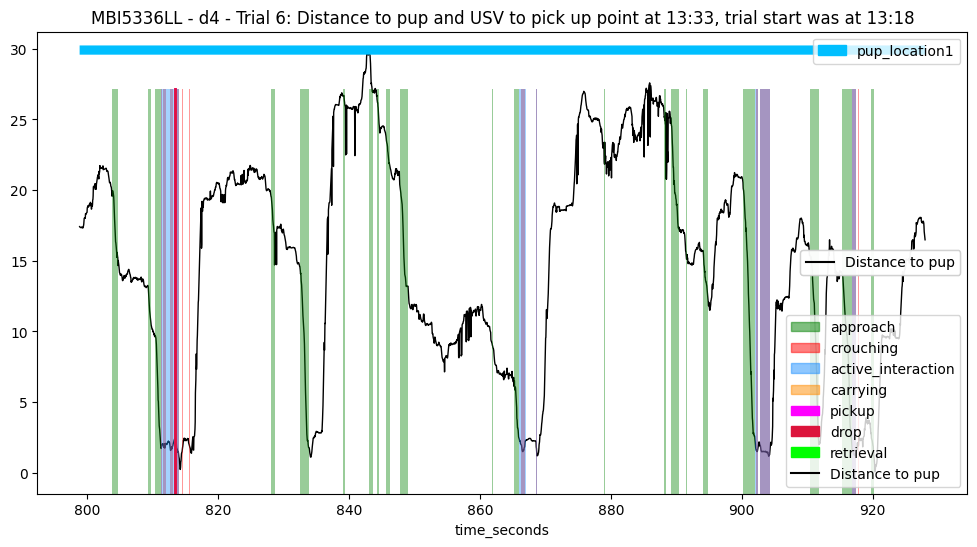

 ==== Example: MBI5336LL - d4 - 7 ==== 
 ==== Example: MBI5336LL - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3820
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_to_pup         22
head_angle_to_pup_degrees    22
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        22
distance_head_to_pup         22
head_angle_to_pu

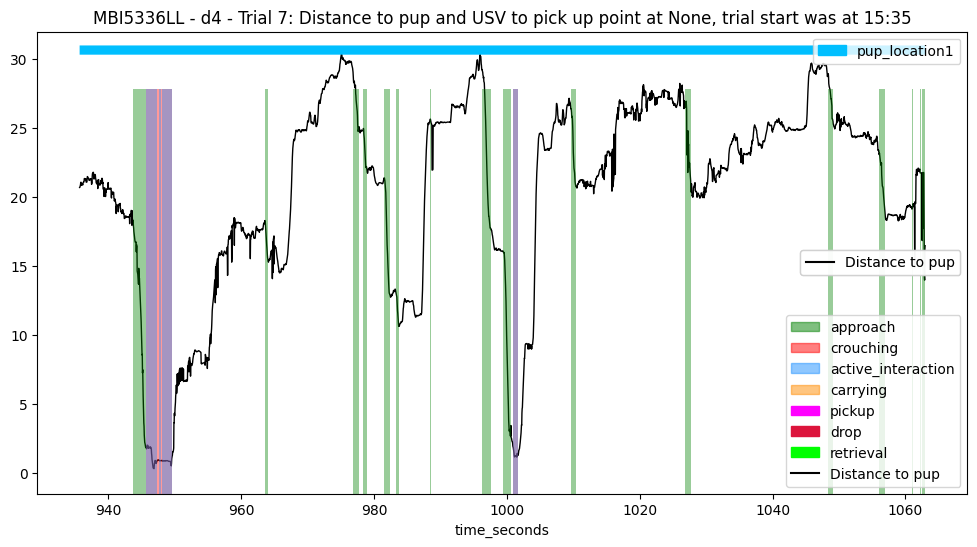

 ==== Example: MBI5336LL - d4 - 8 ==== 
 ==== Example: MBI5336LL - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3926
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_to_pup         36
head_angle_to_pup_degrees    36
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pu

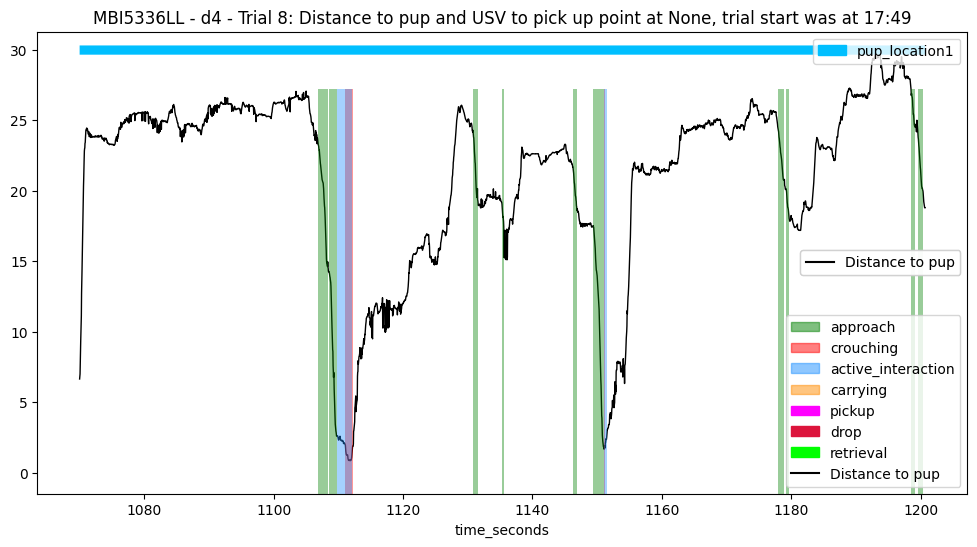

 ==== Example: MBI5336LL - d4 - 9 ==== 
 ==== Example: MBI5336LL - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3870
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        34
distance_head_to_pup         34
head_angle_to_pup_degrees    34
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pu

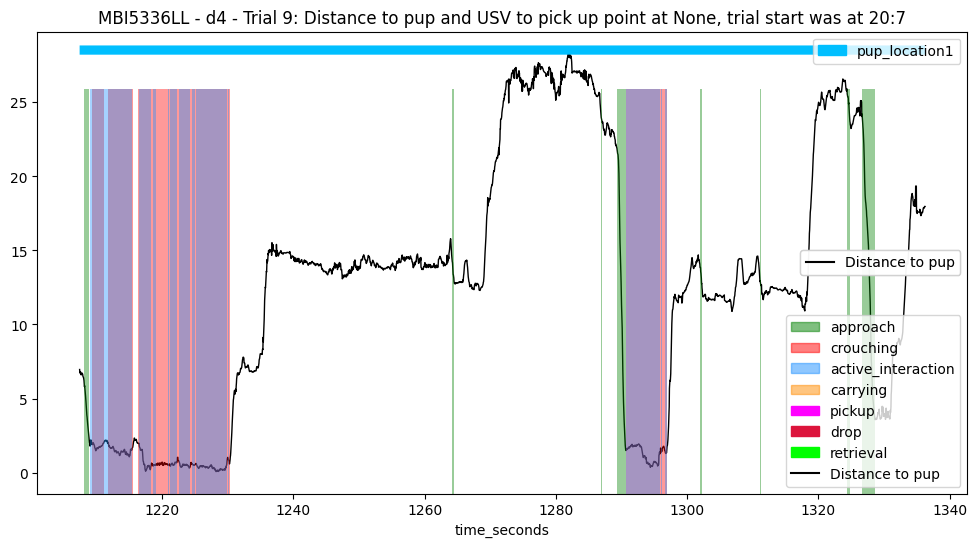

 ==== Example: MBI5336LL - d5 - 1 ==== 
 ==== Example: MBI5336LL - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1012
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pup_degrees    47
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pu

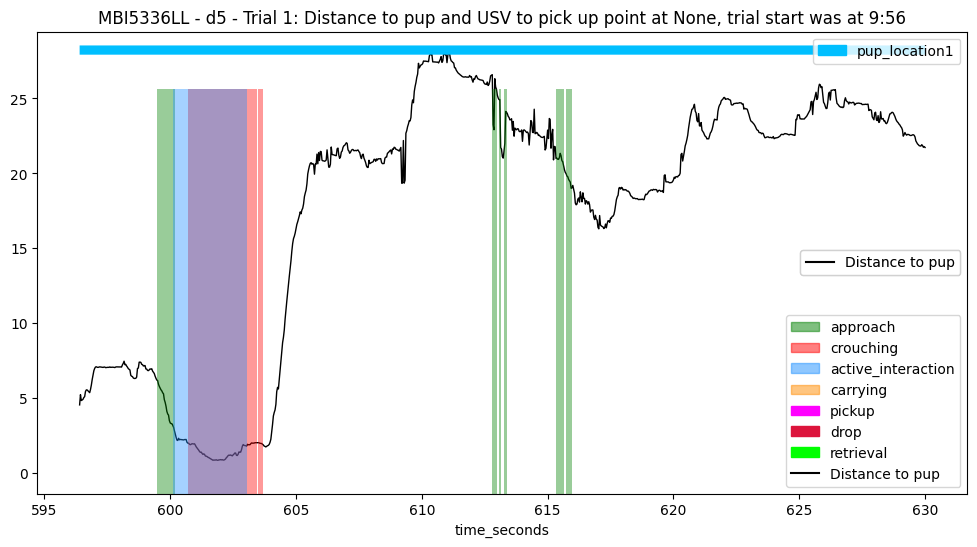

 ==== Example: MBI5336LL - d5 - 2 ==== 
 ==== Example: MBI5336LL - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 665.086
* Success time: 668.269
---> Pick up frame: 19953, Start frame: 19763, End frame: 20048
---> Retrieval frame: 20048; Start frame: 19763; End frame: 20048
---> Final frame: 20048
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19953 * Pickup time:  665.086
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 286
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_

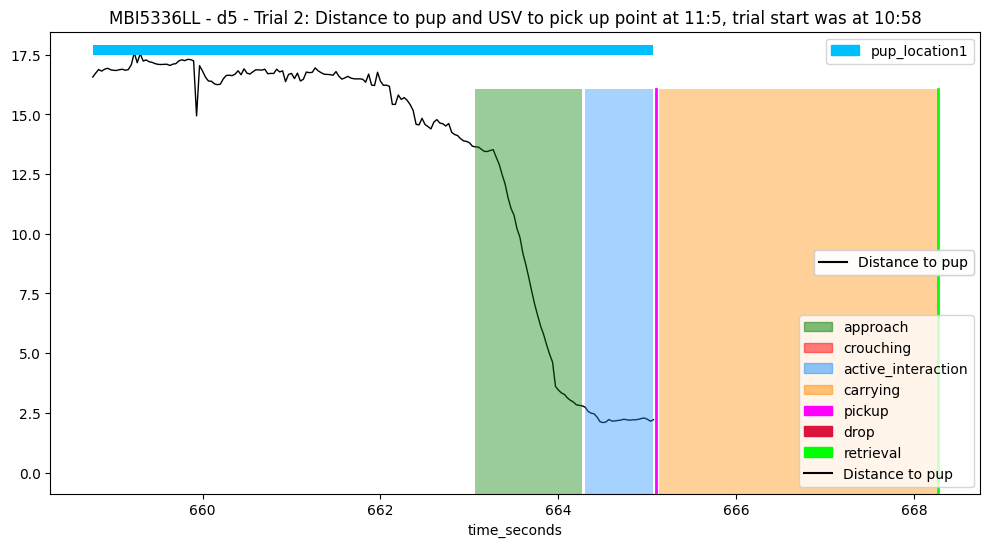

 ==== Example: MBI5336LL - d5 - 3 ==== 
 ==== Example: MBI5336LL - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 701.029
* Success time: 704.821
---> Pick up frame: 21031, Start frame: 20377, End frame: 21144
---> Retrieval frame: 21145; Start frame: 20377; End frame: 21144
---> Final frame: 21144
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21031 * Pickup time:  701.029
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 768
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 21031, instantly drop at 21032
---> Processing last pup location:

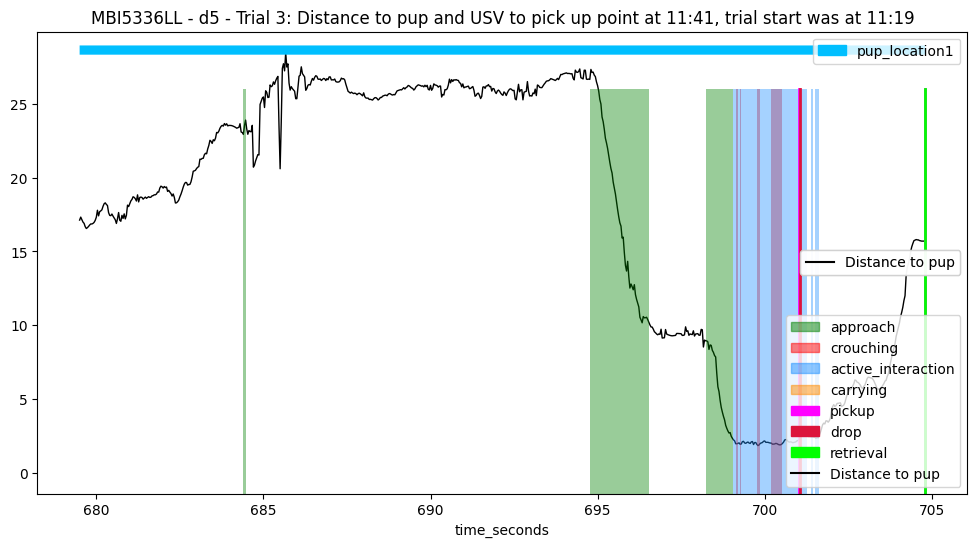

 ==== Example: MBI5336LL - d5 - 4 ==== 
 ==== Example: MBI5336LL - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 723.749
* Success time: None
---> Pick up frame: 21712, Start frame: 21645, End frame: 25967
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21712 * Pickup time:  723.749
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4323
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 21712, instantly drop at 21713
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head_t

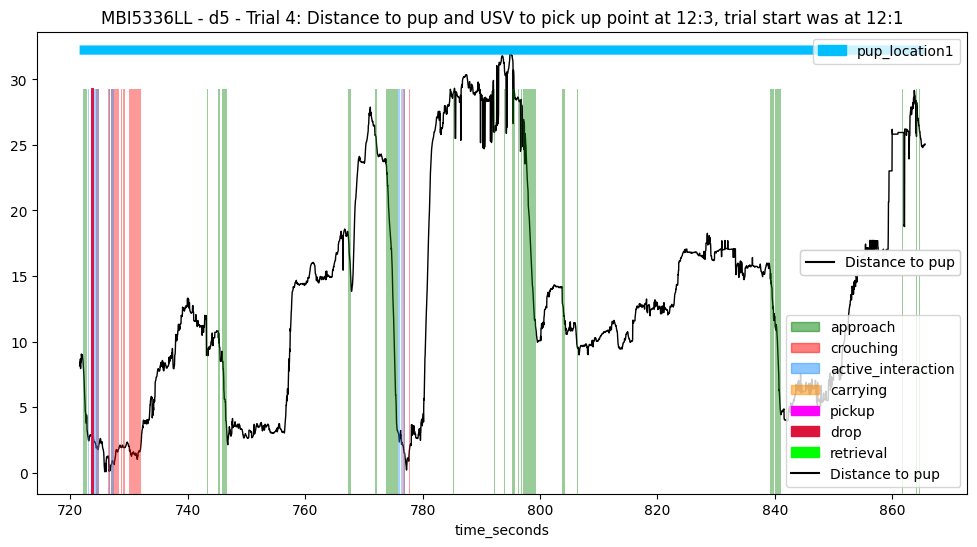

 ==== Example: MBI5336LL - d5 - 5 ==== 
 ==== Example: MBI5336LL - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3651
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_degrees    0
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        3
distance_head_to_pup         3
head_angle_to_pup_deg

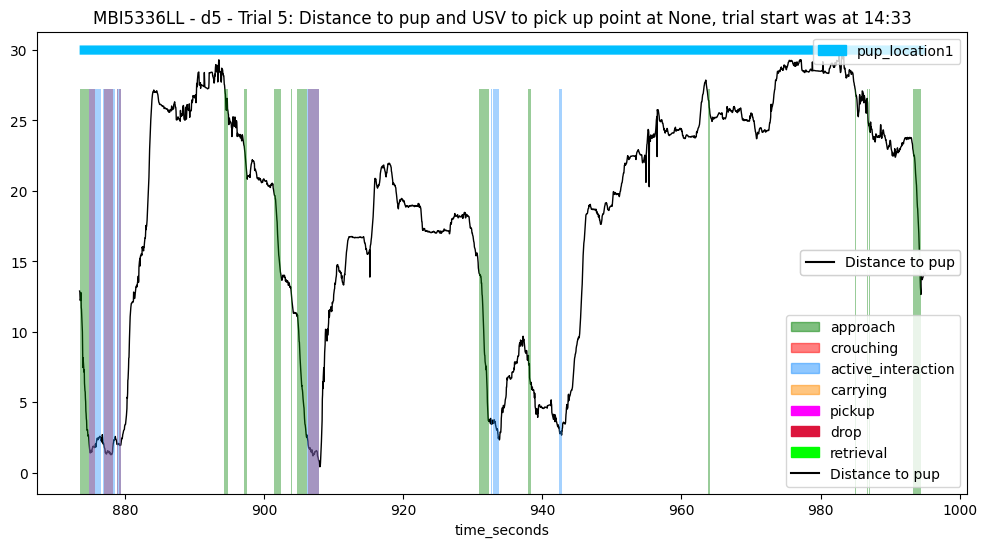

 ==== Example: MBI5336LL - d5 - 6 ==== 
 ==== Example: MBI5336LL - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3897
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pup_degrees    48
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        54
distance_head_to_pup         54
head_angle_to_pu

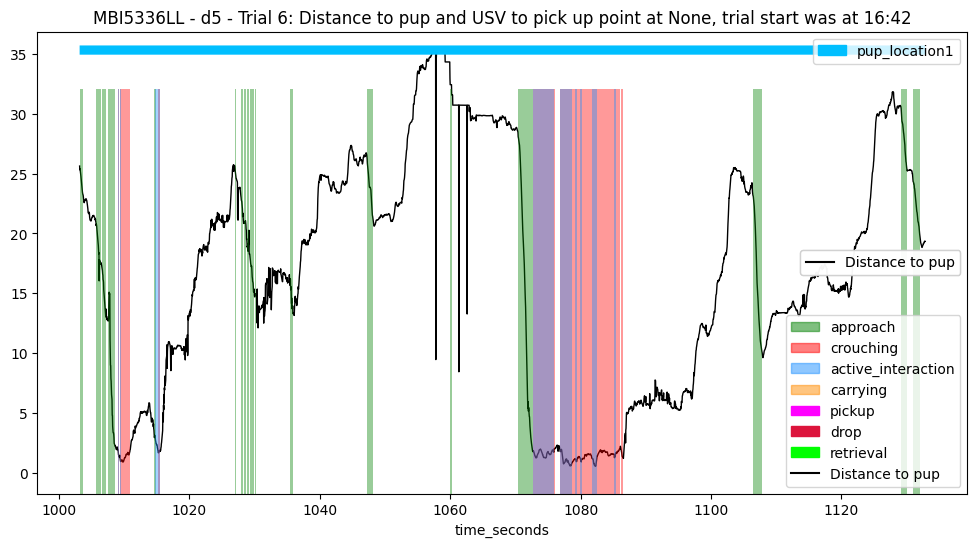

 ==== Example: MBI5336LL - d5 - 7 ==== 
 ==== Example: MBI5336LL - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2605
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  5.421308955608633

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        2547
               True      False          56
       

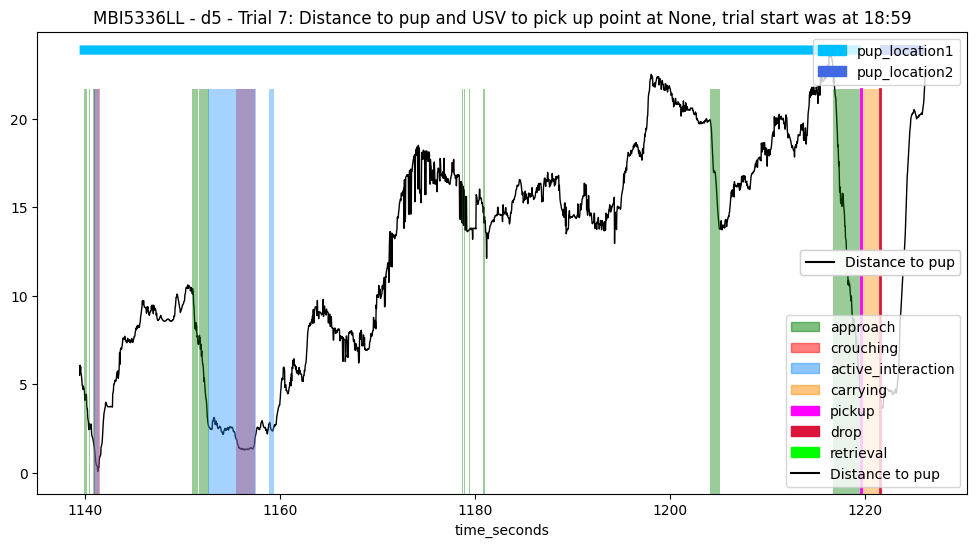

 ==== Example: MBI5336LL - d5 - 8 ==== 
 ==== Example: MBI5336LL - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: 1367.637
---> Retrieval frame: 41029; Start frame: 37272; End frame: 41029
---> Final frame: 41029
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3758
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'retrieval' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3706
               True      False         

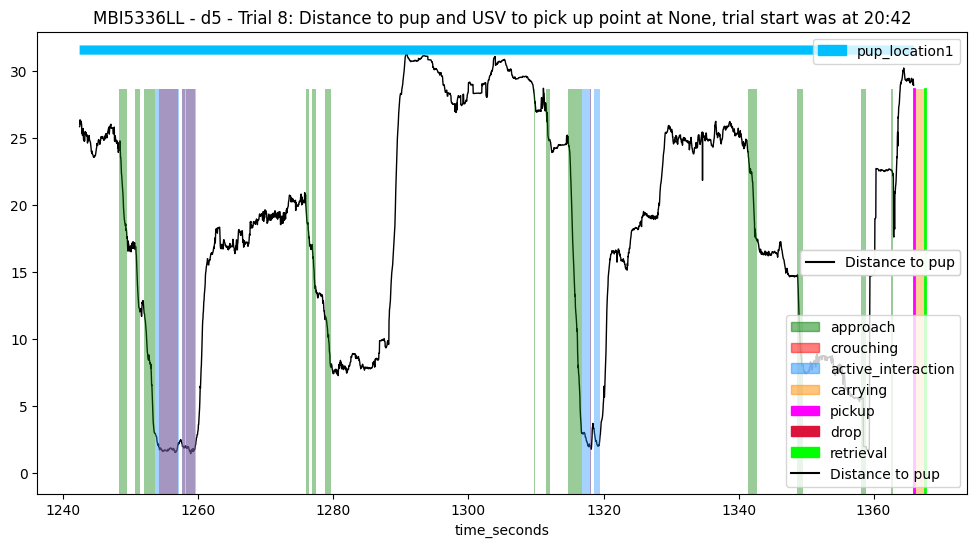

 ==== Example: MBI5336LL - d5 - 9 ==== 
 ==== Example: MBI5336LL - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1507.742
* Success time: None
---> Pick up frame: 45232, Start frame: 41380, End frame: 45382
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  45232 * Pickup time:  1507.742
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4003
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 45232, instantly drop at 45233
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        31
distance_head

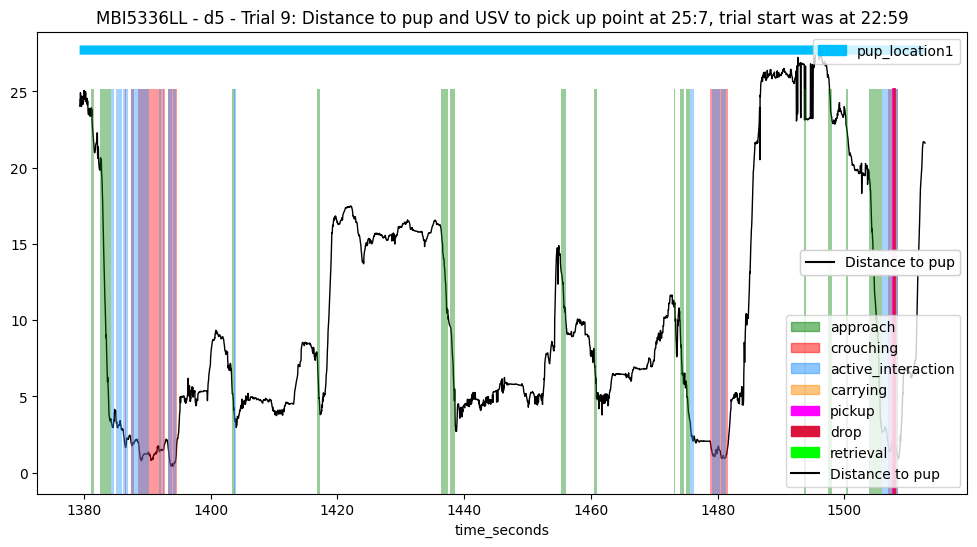

 ==== Example: MBI5336LL - d6 - 1 ==== 
 ==== Example: MBI5336LL - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 630.09
* Success time: 632.15
---> Pick up frame: 18903, Start frame: 18817, End frame: 18964
---> Retrieval frame: 18964; Start frame: 18817; End frame: 18964
---> Final frame: 18964
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18903 * Pickup time:  630.09
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 148
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 18903, instantly drop at 18904
---> Processing last pup location: pu

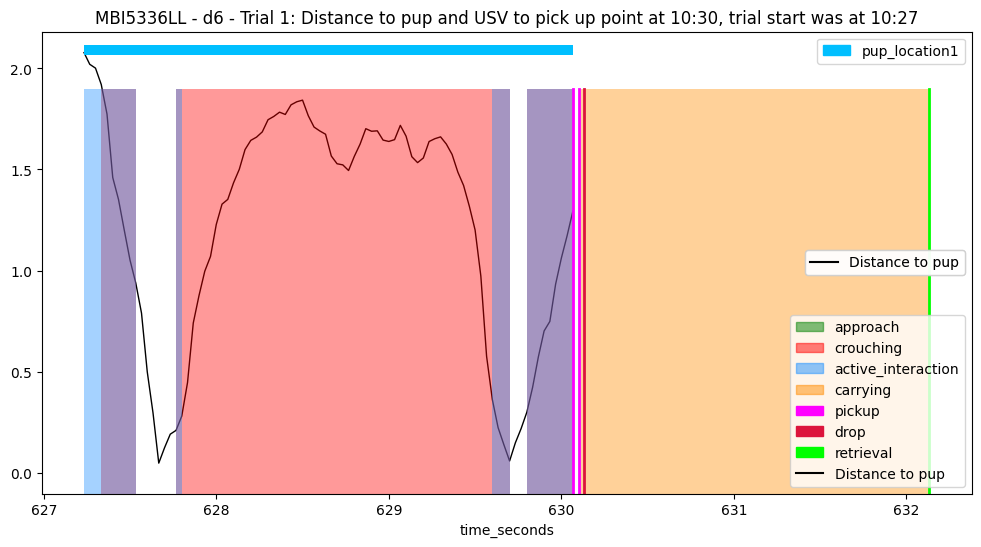

 ==== Example: MBI5336LL - d6 - 2 ==== 
 ==== Example: MBI5336LL - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 665.167
* Success time: None
---> Pick up frame: 19955, Start frame: 19326, End frame: 22992
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19955 * Pickup time:  665.167
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3667
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 19955, instantly drop at 19956
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        23
distance_head_t

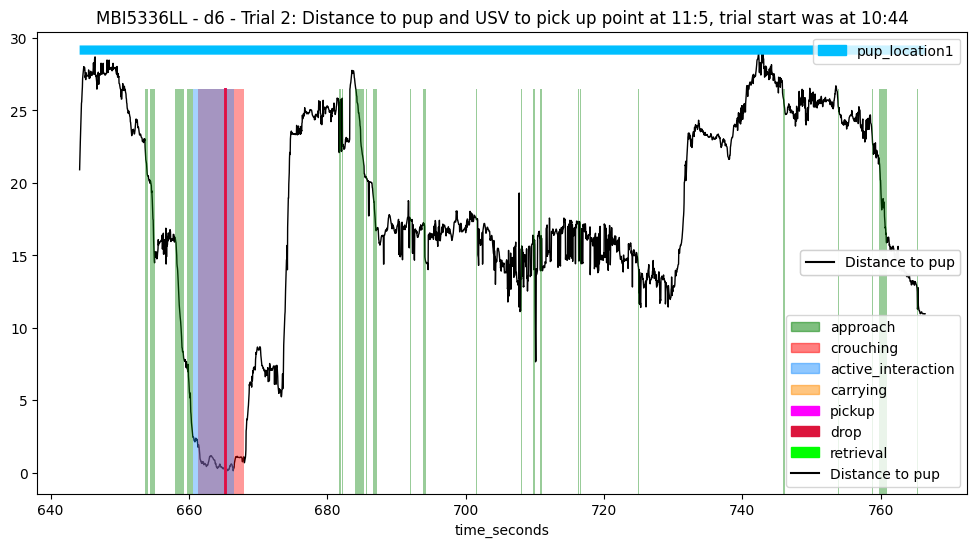

 ==== Example: MBI5336LL - d6 - 3 ==== 
 ==== Example: MBI5336LL - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 864.839
* Success time: None
---> Pick up frame: 25945, Start frame: 23234, End frame: 27039
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25945 * Pickup time:  864.839
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3806
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 25945, instantly drop at 25946
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        31
distance_head_t

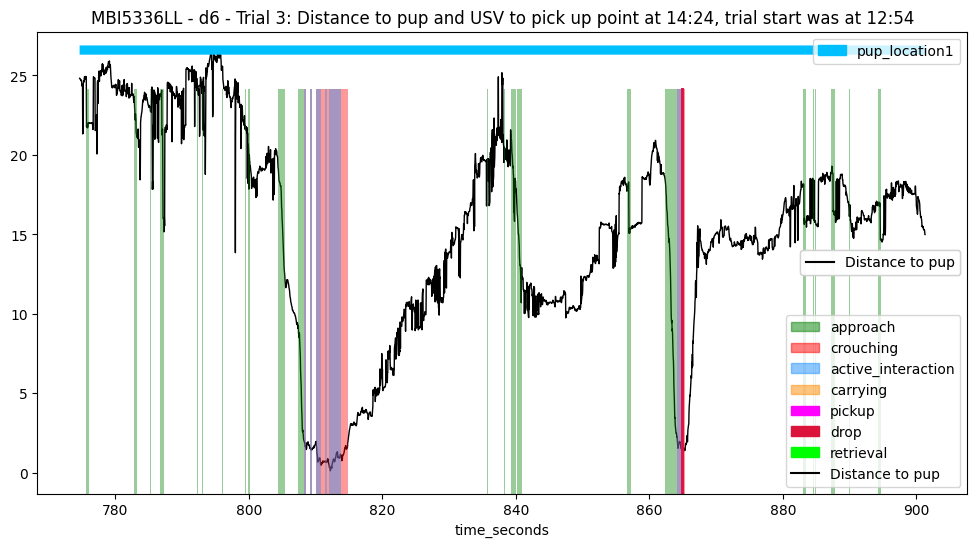

 ==== Example: MBI5336LL - d6 - 4 ==== 
 ==== Example: MBI5336LL - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3735
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        33
distance_head_to_pup         33
head_angle_to_pup_degrees    33
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        121
distance_head_to_pup         121
head_angle_to_

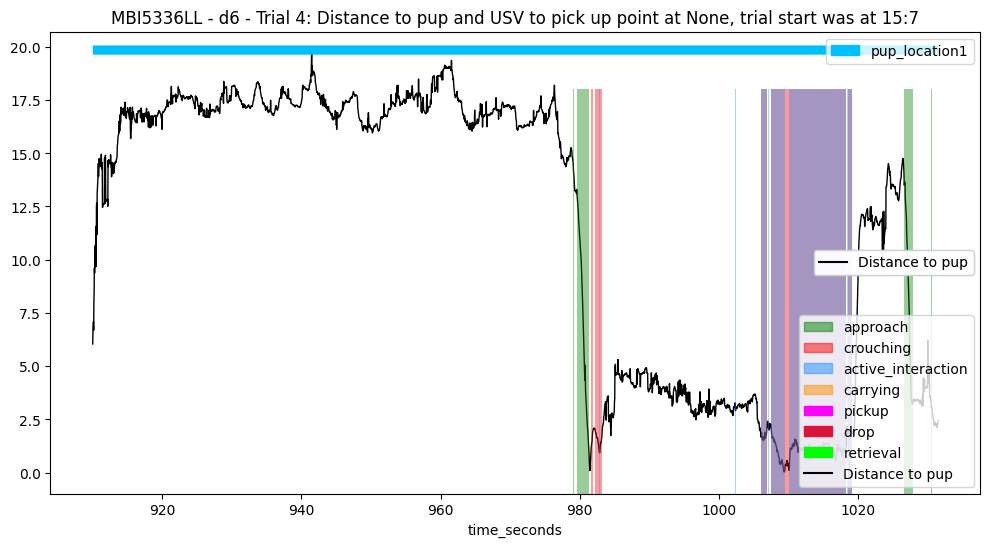

 ==== Example: MBI5336LL - d6 - 5 ==== 
 ==== Example: MBI5336LL - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1082.2
* Success time: 1084.9
---> Pick up frame: 32466, Start frame: 31143, End frame: 32547
---> Retrieval frame: 32547; Start frame: 31143; End frame: 32547
---> Final frame: 32547
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  32466 * Pickup time:  1082.2
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1405
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        112
distance_head_t

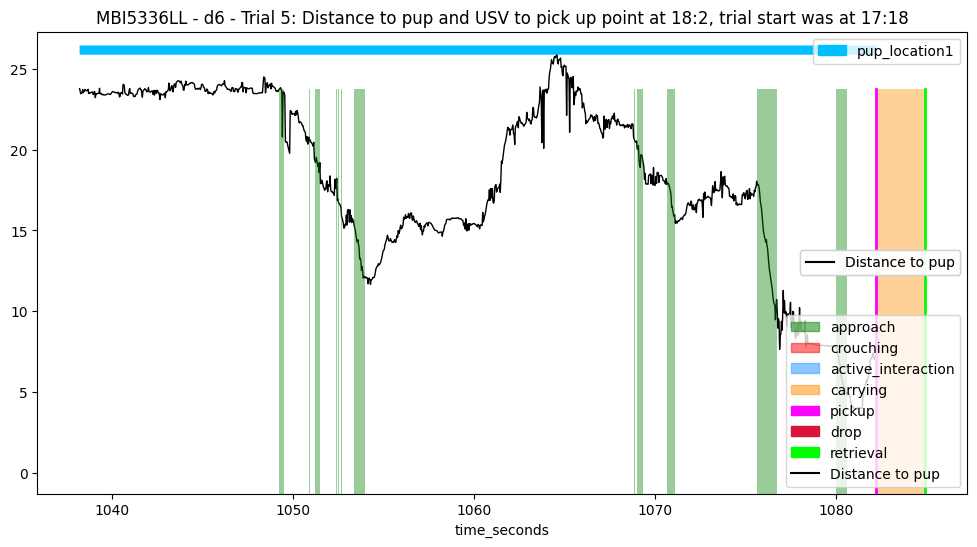

 ==== Example: MBI5336LL - d6 - 6 ==== 
 ==== Example: MBI5336LL - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1185.8
* Success time: 1188.13
---> Pick up frame: 35574, Start frame: 33213, End frame: 35643
---> Retrieval frame: 35644; Start frame: 33213; End frame: 35643
---> Final frame: 35643
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  35574 * Pickup time:  1185.8
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2431
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_head_t

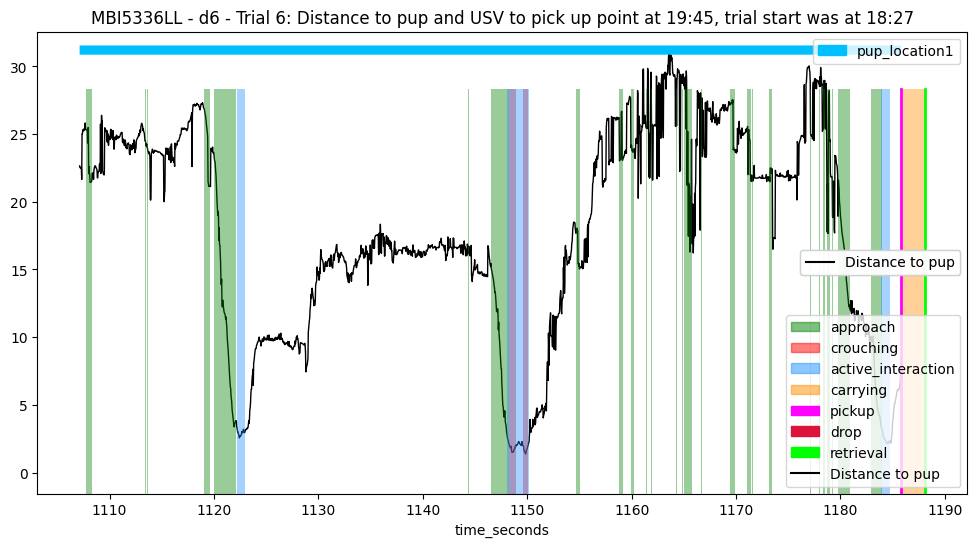

 ==== Example: MBI5336LL - d6 - 7 ==== 
 ==== Example: MBI5336LL - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1215.271
* Success time: 1217.303
---> Pick up frame: 36458, Start frame: 36234, End frame: 36519
---> Retrieval frame: 36519; Start frame: 36234; End frame: 36519
---> Final frame: 36519
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  36458 * Pickup time:  1215.271
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 286
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        34
distance_he

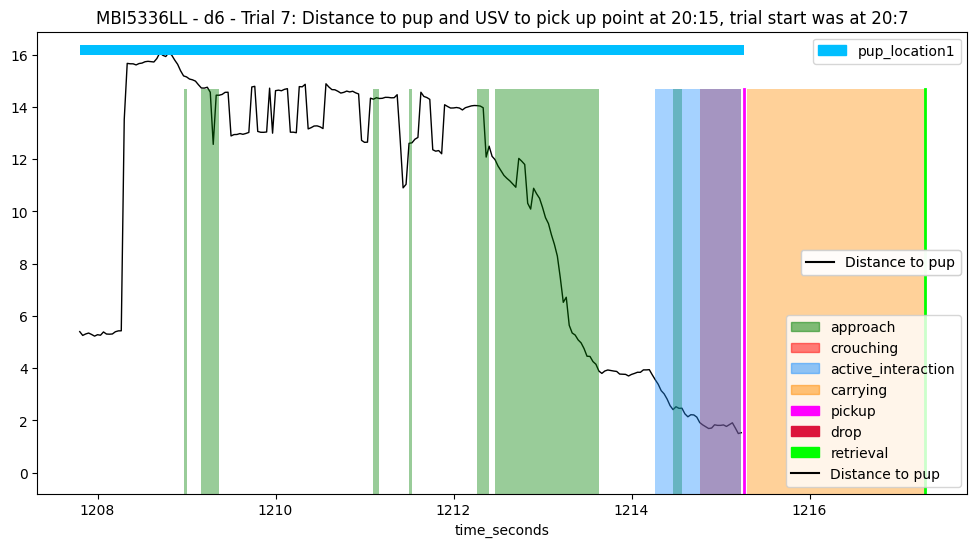

 ==== Example: MBI5336LL - d6 - 8 ==== 
 ==== Example: MBI5336LL - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1249.543
* Success time: None
---> Pick up frame: 37486, Start frame: 36922, End frame: 40948
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  37486 * Pickup time:  1249.543
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4027
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 37486, instantly drop at 37487
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head

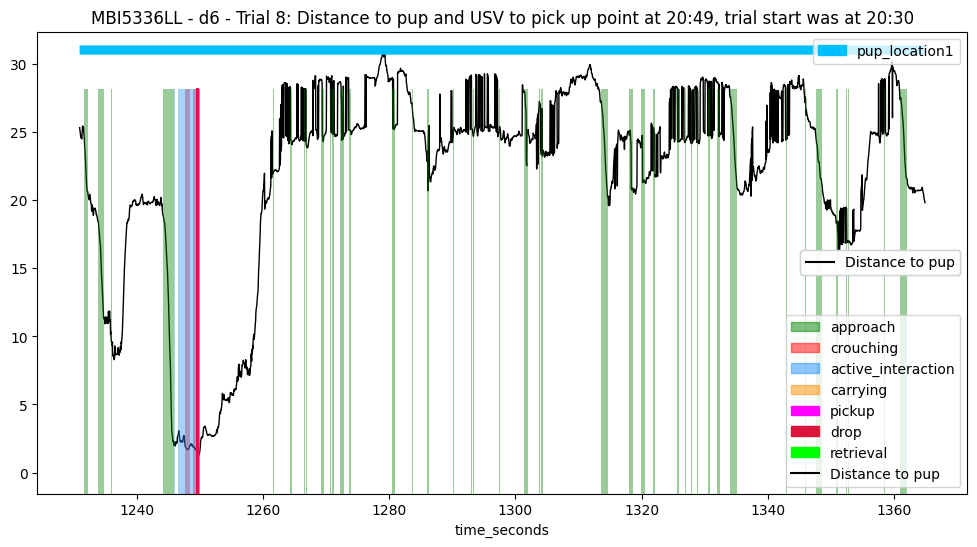

 ==== Example: MBI5336LL - d6 - 9 ==== 
 ==== Example: MBI5336LL - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1372.183
* Success time: 1375.24
---> Pick up frame: 41165, Start frame: 41077, End frame: 41257
---> Retrieval frame: 41257; Start frame: 41077; End frame: 41257
---> Final frame: 41257
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41165 * Pickup time:  1372.183
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 181
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        35
distance_hea

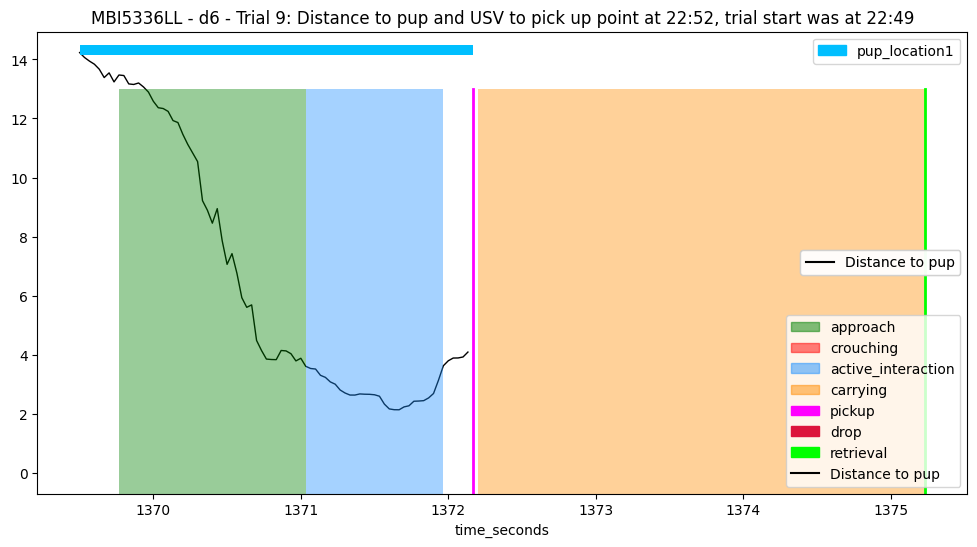

 ==== Example: MBQ0012RR - d1 - 1 ==== 
 ==== Example: MBQ0012RR - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4307
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_to_pup         29
head_angle_to_pup_degrees    29
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        29
distance_head_to_pup         29
head_angle_to_pu

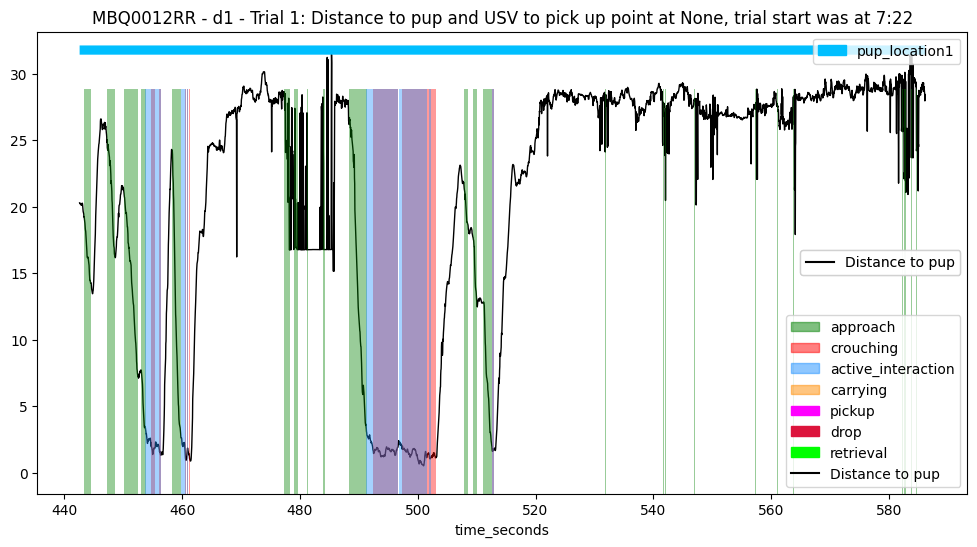

 ==== Example: MBQ0012RR - d1 - 2 ==== 
 ==== Example: MBQ0012RR - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3789
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pup_degrees    52
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pu

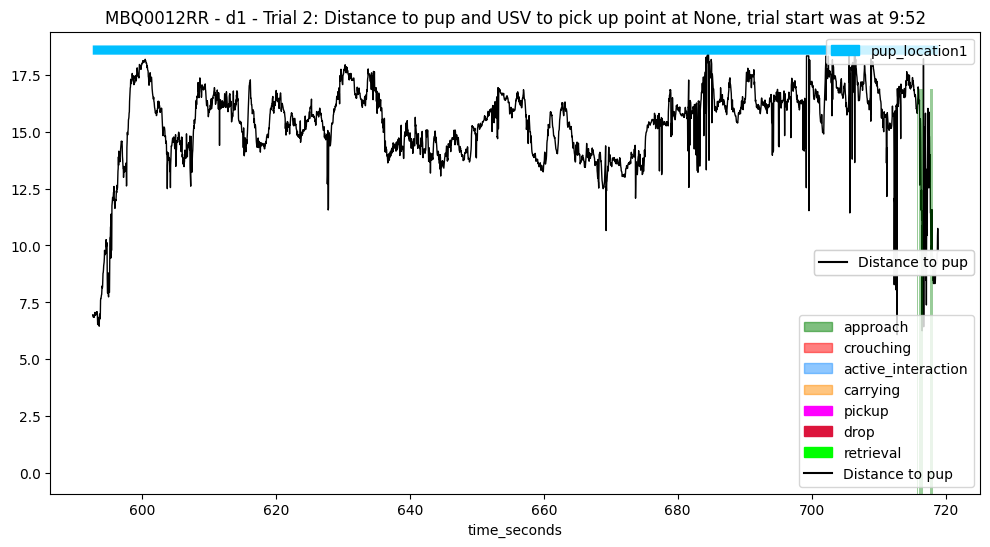

 ==== Example: MBQ0012RR - d1 - 3 ==== 
 ==== Example: MBQ0012RR - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 763.261
* Success time: 764.549
---> Pick up frame: 22898, Start frame: 21704, End frame: 22936
---> Retrieval frame: 22936; Start frame: 21704; End frame: 22936
---> Final frame: 22936
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22898 * Pickup time:  763.261
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1233
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        218
distance_hea

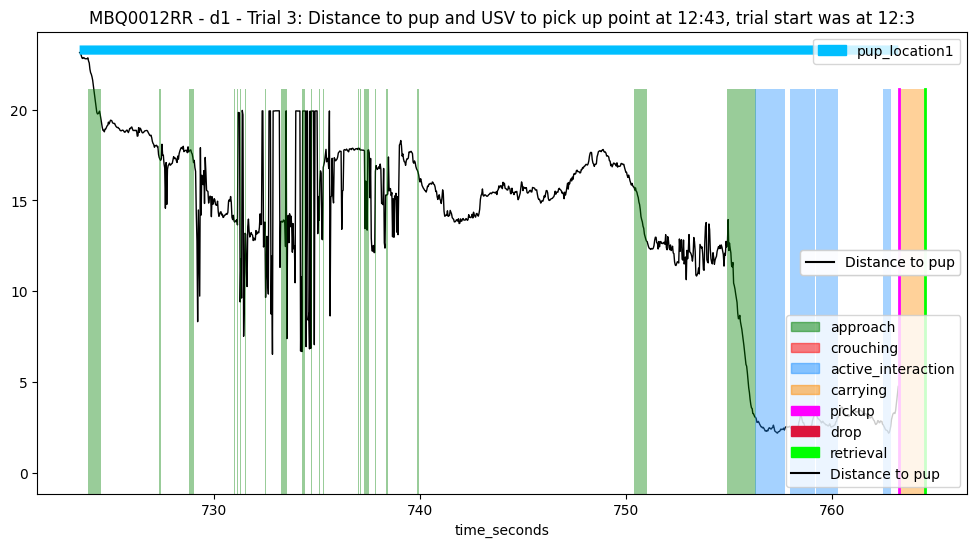

 ==== Example: MBQ0012RR - d1 - 4 ==== 
 ==== Example: MBQ0012RR - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 803.093
* Success time: 806.877
---> Pick up frame: 24093, Start frame: 23356, End frame: 24206
---> Retrieval frame: 24206; Start frame: 23356; End frame: 24206
---> Final frame: 24206
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24093 * Pickup time:  803.093
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 851
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_

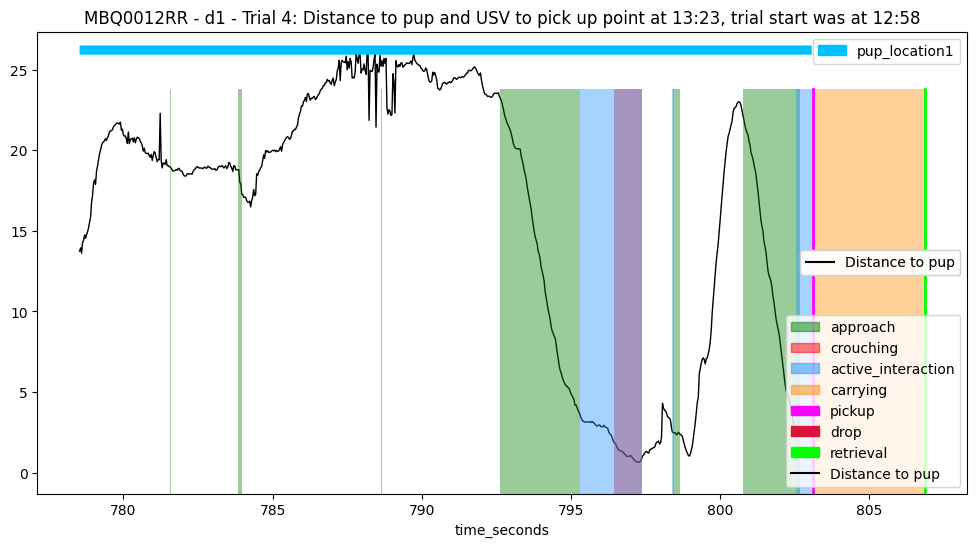

 ==== Example: MBQ0012RR - d1 - 5 ==== 
 ==== Example: MBQ0012RR - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 831.957
* Success time: 833.597
---> Pick up frame: 24959, Start frame: 24759, End frame: 25007
---> Retrieval frame: 25008; Start frame: 24759; End frame: 25007
---> Final frame: 25007
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24959 * Pickup time:  831.957
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 249
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head_

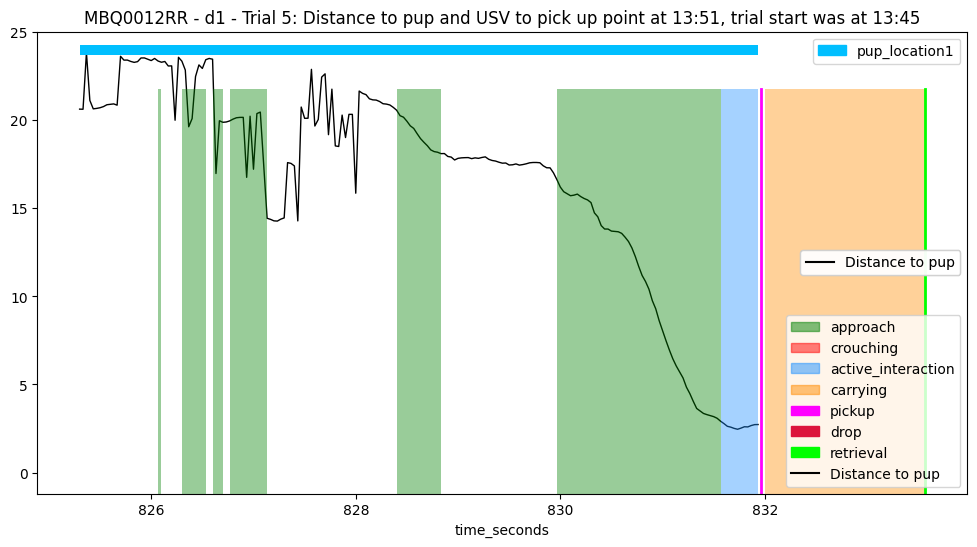

 ==== Example: MBQ0012RR - d1 - 6 ==== 
 ==== Example: MBQ0012RR - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 865.837
* Success time: 867.989
---> Pick up frame: 25975, Start frame: 25412, End frame: 26039
---> Retrieval frame: 26040; Start frame: 25412; End frame: 26039
---> Final frame: 26039
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25975 * Pickup time:  865.837
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 628
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        86
distance_head_

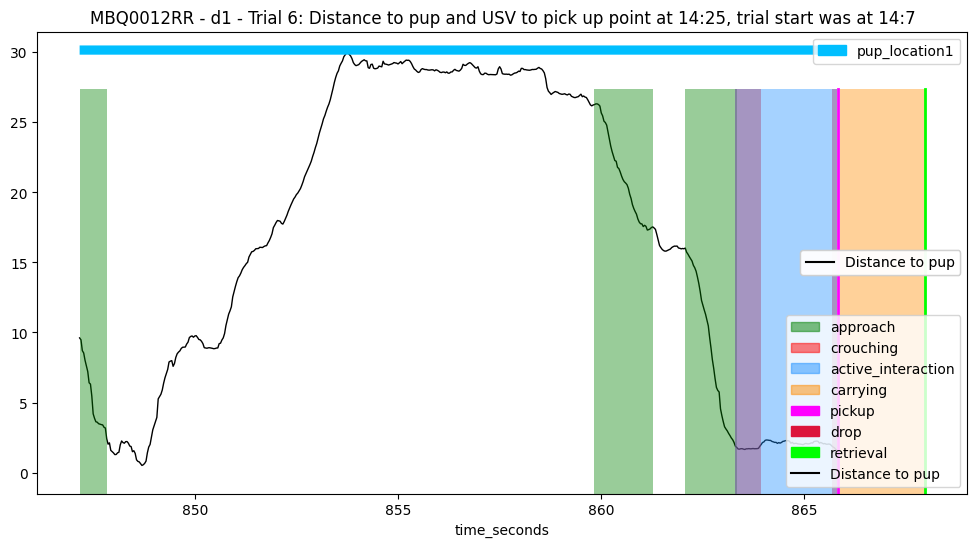

 ==== Example: MBQ0012RR - d1 - 7 ==== 
 ==== Example: MBQ0012RR - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 892.149
* Success time: None
---> Pick up frame: 26764, Start frame: 26395, End frame: 30553
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  26764 * Pickup time:  892.149
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4159
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        13
distance_head_to_pup         13
head_angle_to_pup_degrees    13
dtype: int64
--

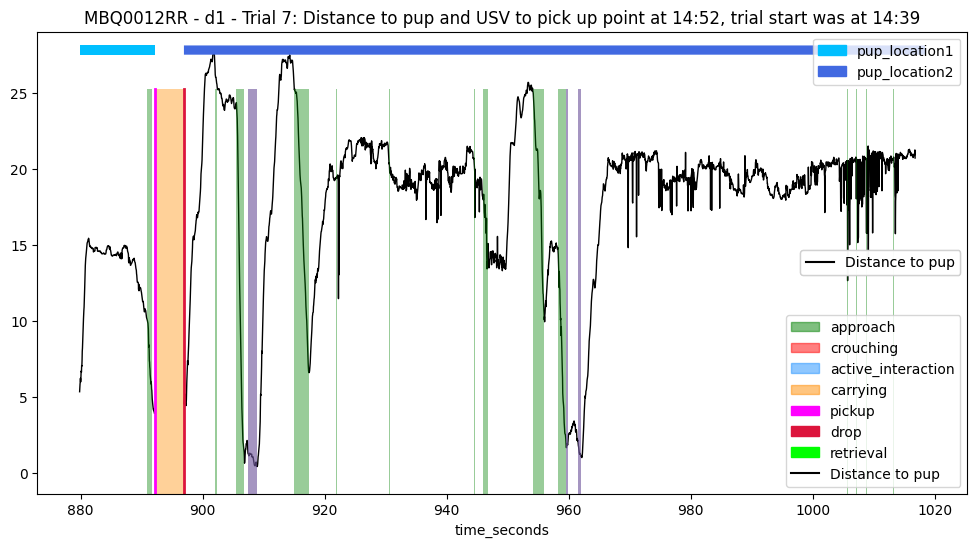

 ==== Example: MBQ0012RR - d1 - 8 ==== 
 ==== Example: MBQ0012RR - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1034.885
* Success time: None
---> Pick up frame: 31047, Start frame: 30768, End frame: 34808
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  31047 * Pickup time:  1034.885
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4041
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 31047, instantly drop at 31048
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        1
distance_head_

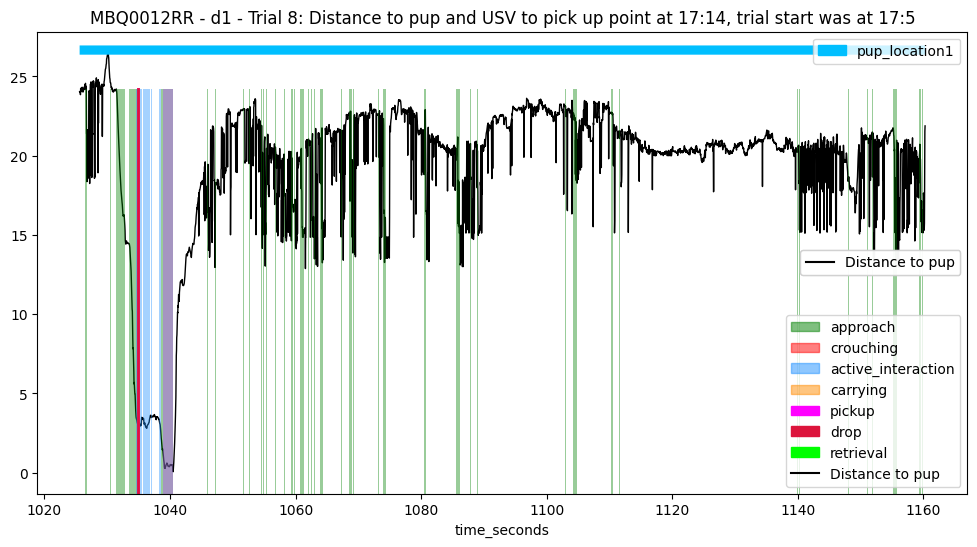

 ==== Example: MBQ0012RR - d1 - 9 ==== 
 ==== Example: MBQ0012RR - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1293.797
* Success time: 1295.189
---> Pick up frame: 38814, Start frame: 35080, End frame: 38855
---> Retrieval frame: 38856; Start frame: 35080; End frame: 38855
---> Final frame: 38855
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  38814 * Pickup time:  1293.797
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3776
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  ca

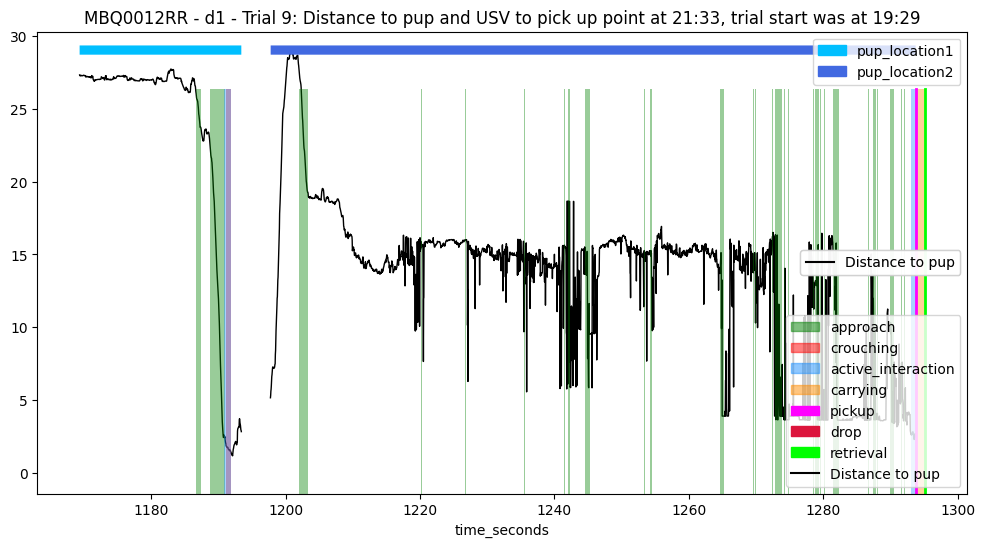

 ==== Example: MBQ0012RR - d2 - 1 ==== 
 ==== Example: MBQ0012RR - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 568.145
* Success time: None
---> Pick up frame: 17044, Start frame: 14105, End frame: 18453
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17044 * Pickup time:  568.145
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4349
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 17044, instantly drop at 17045
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        64
distance_head_t

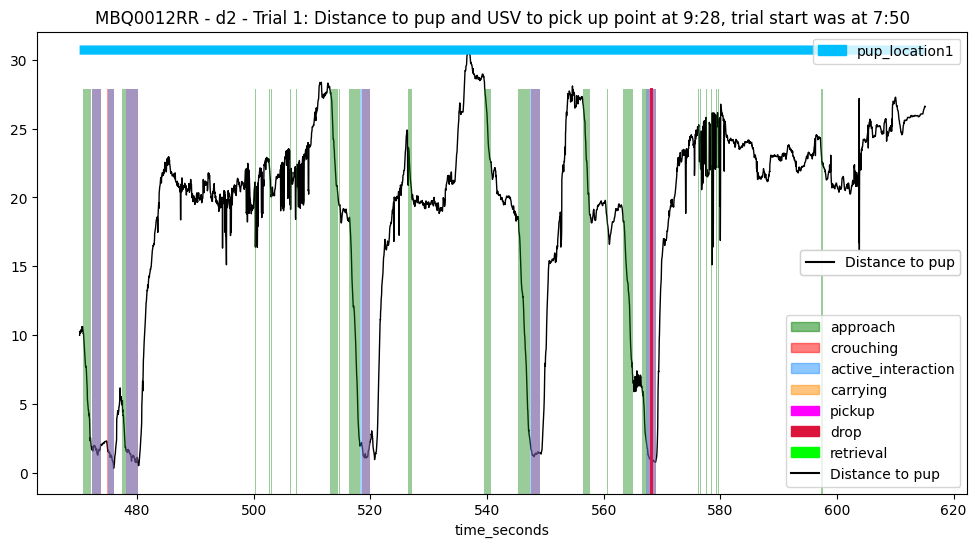

 ==== Example: MBQ0012RR - d2 - 2 ==== 
 ==== Example: MBQ0012RR - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4234
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        68
distance_head_to_pup         68
head_angle_to_pup_degrees    68
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        73
distance_head_to_pup         73
head_angle_to_pu

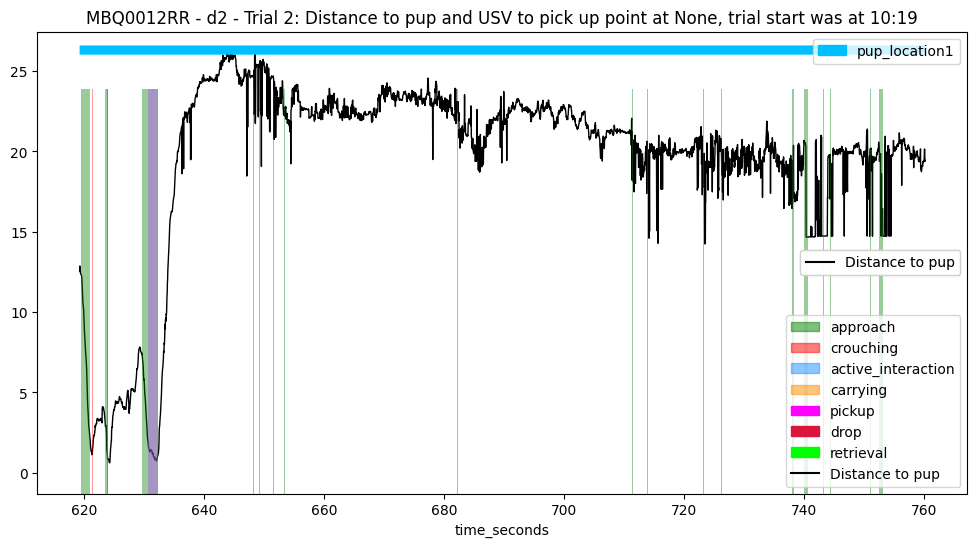

 ==== Example: MBQ0012RR - d2 - 3 ==== 
 ==== Example: MBQ0012RR - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 868.505
* Success time: 870.129
---> Pick up frame: 26055, Start frame: 23024, End frame: 26103
---> Retrieval frame: 26104; Start frame: 23024; End frame: 26103
---> Final frame: 26103
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  26055 * Pickup time:  868.505
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3080
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  20.07414808472

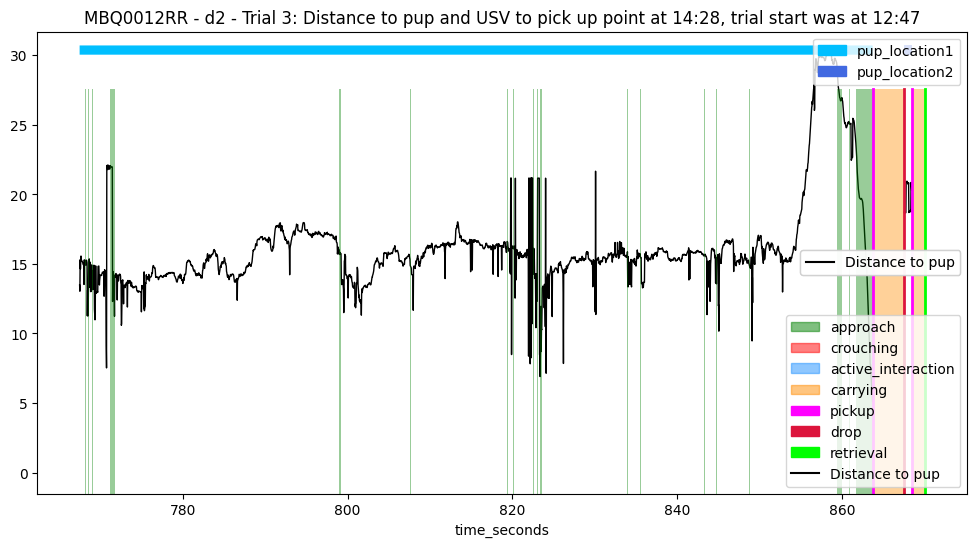

 ==== Example: MBQ0012RR - d2 - 4 ==== 
 ==== Example: MBQ0012RR - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 919.473
* Success time: 926.305
---> Pick up frame: 27584, Start frame: 26599, End frame: 27789
---> Retrieval frame: 27789; Start frame: 26599; End frame: 27789
---> Final frame: 27789
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27584 * Pickup time:  919.473
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1191
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head

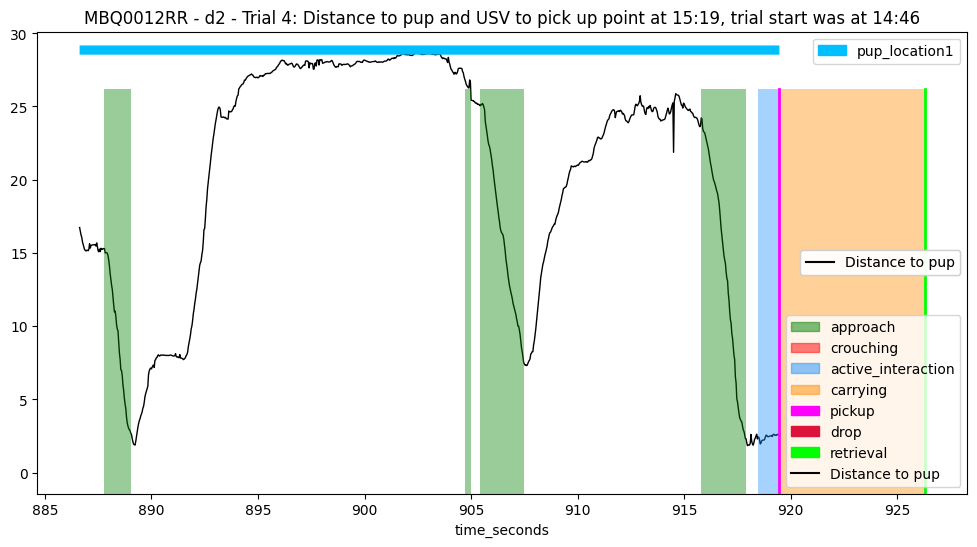

 ==== Example: MBQ0012RR - d2 - 5 ==== 
 ==== Example: MBQ0012RR - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 957.505
* Success time: 962.641
---> Pick up frame: 28725, Start frame: 28135, End frame: 28879
---> Retrieval frame: 28879; Start frame: 28135; End frame: 28879
---> Final frame: 28879
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28725 * Pickup time:  957.505
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 745
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        45
distance_head_

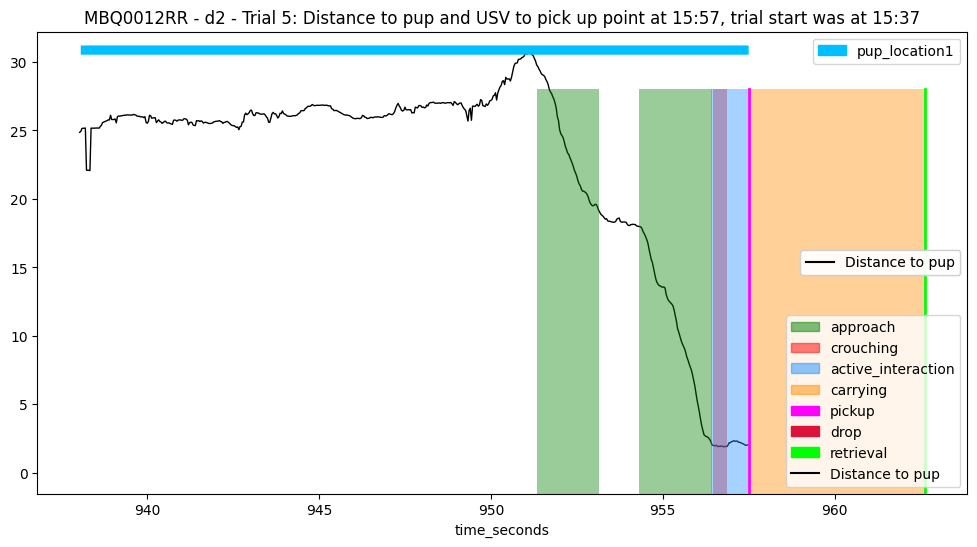

 ==== Example: MBQ0012RR - d2 - 6 ==== 
 ==== Example: MBQ0012RR - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 987.617
* Success time: None
---> Pick up frame: 29629, Start frame: 29298, End frame: 33083
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  29629 * Pickup time:  987.617
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3786
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_to_pup         30
head_angle_to

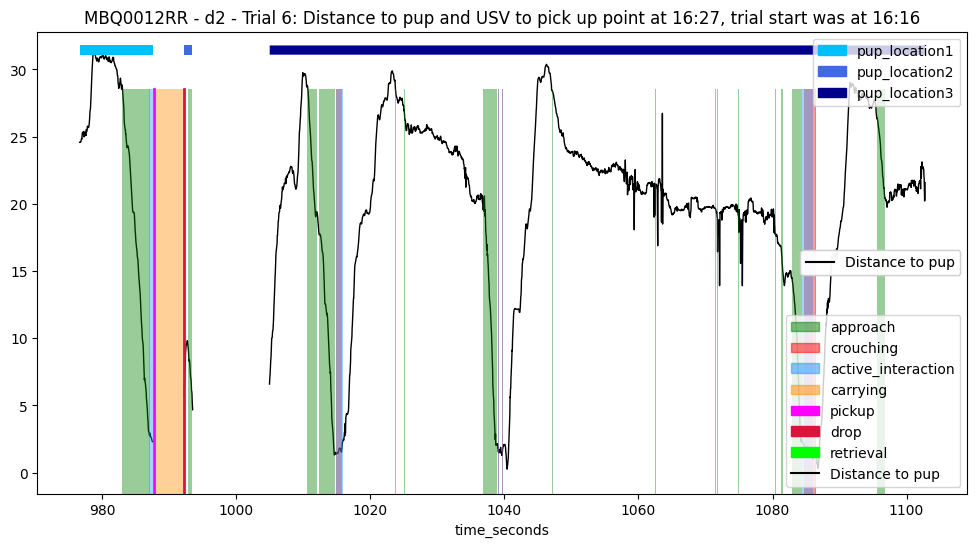

 ==== Example: MBQ0012RR - d2 - 7 ==== 
 ==== Example: MBQ0012RR - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1238.105
* Success time: None
---> Pick up frame: 37143, Start frame: 33431, End frame: 37425
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  37143 * Pickup time:  1238.105
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3995
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  15.813502907612177

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   Fals

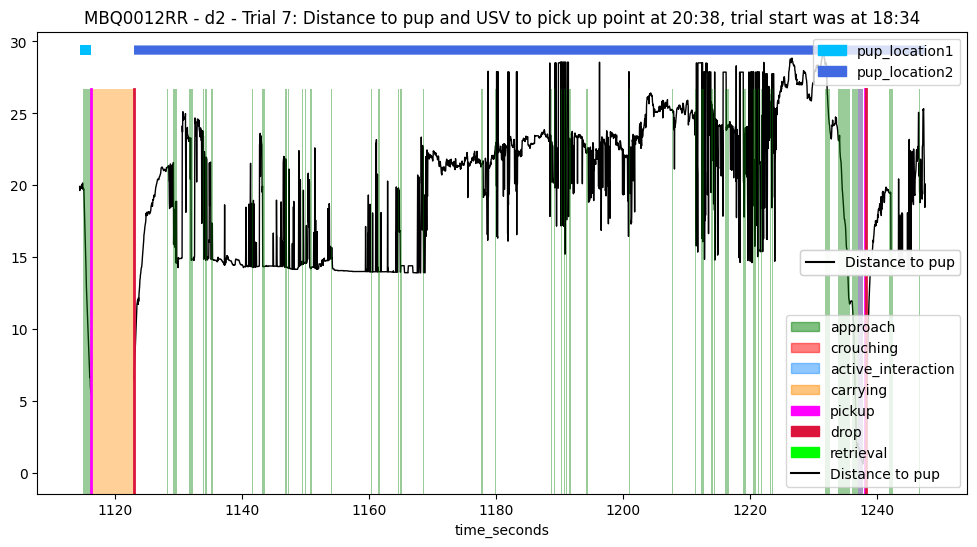

 ==== Example: MBQ0012RR - d2 - 8 ==== 
 ==== Example: MBQ0012RR - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1269.529
* Success time: 1271.073
---> Pick up frame: 38086, Start frame: 37802, End frame: 38132
---> Retrieval frame: 38132; Start frame: 37802; End frame: 38132
---> Final frame: 38132
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38086 * Pickup time:  1269.529
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 331
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_he

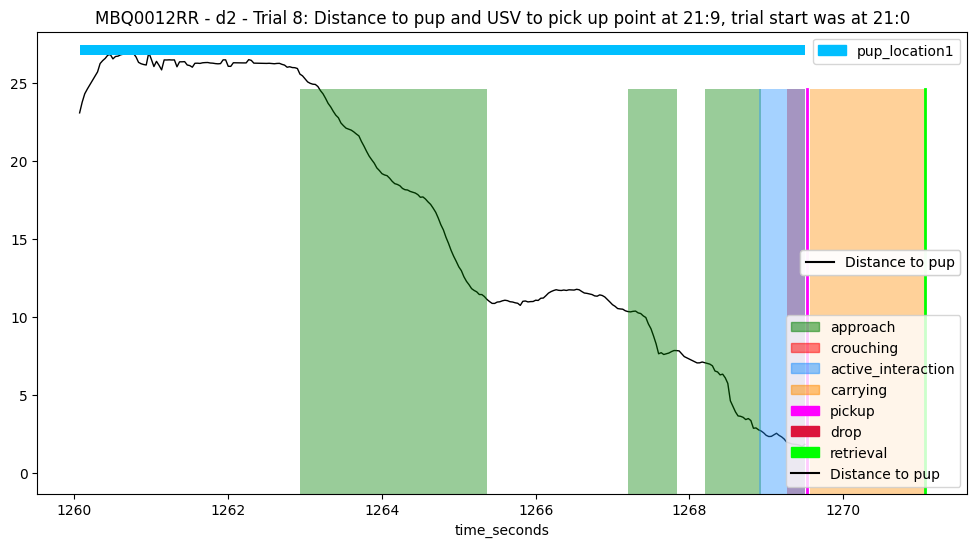

 ==== Example: MBQ0012RR - d2 - 9 ==== 
 ==== Example: MBQ0012RR - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1325.161
* Success time: 1332.753
---> Pick up frame: 39755, Start frame: 38606, End frame: 39982
---> Retrieval frame: 39983; Start frame: 38606; End frame: 39982
---> Final frame: 39982
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  39755 * Pickup time:  1325.161
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1377
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_

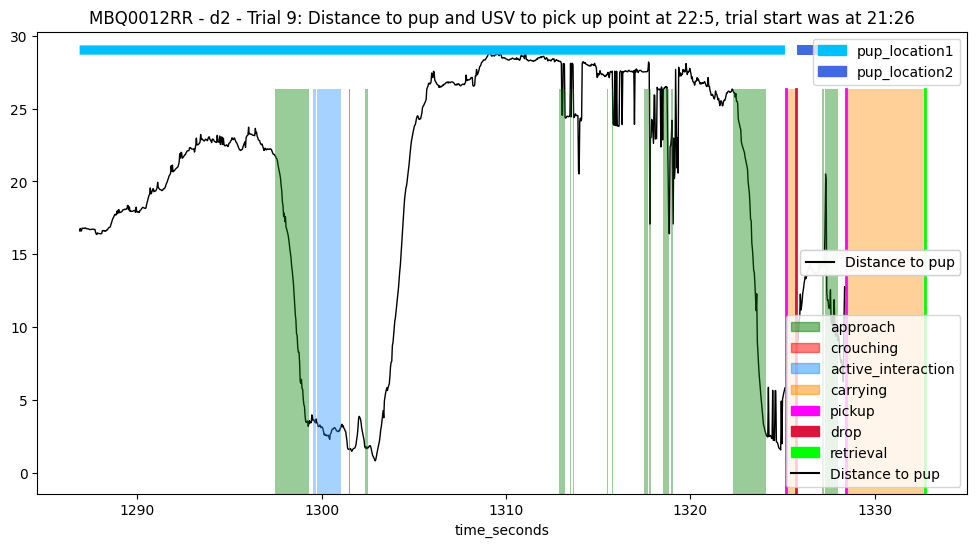

 ==== Example: MBQ0012RR - d3 - 1 ==== 
 ==== Example: MBQ0012RR - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 441.877
* Success time: None
---> Pick up frame: 13256, Start frame: 13016, End frame: 17157
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13256 * Pickup time:  441.877
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4142
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 13256, instantly drop at 13257
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_t

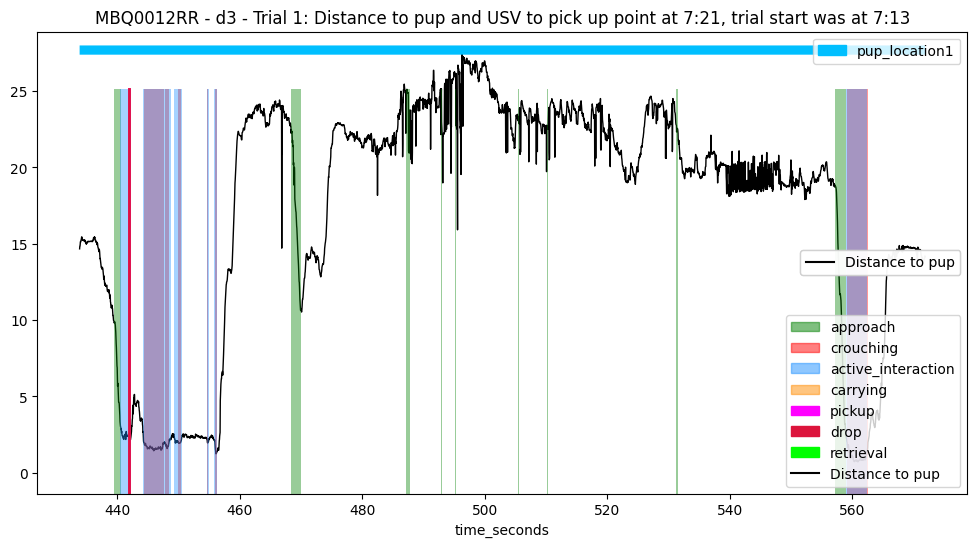

 ==== Example: MBQ0012RR - d3 - 2 ==== 
 ==== Example: MBQ0012RR - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 706.917
* Success time: None
---> Pick up frame: 21208, Start frame: 17444, End frame: 21478
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  21208 * Pickup time:  706.917
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4035
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        4034
       True    False     False     

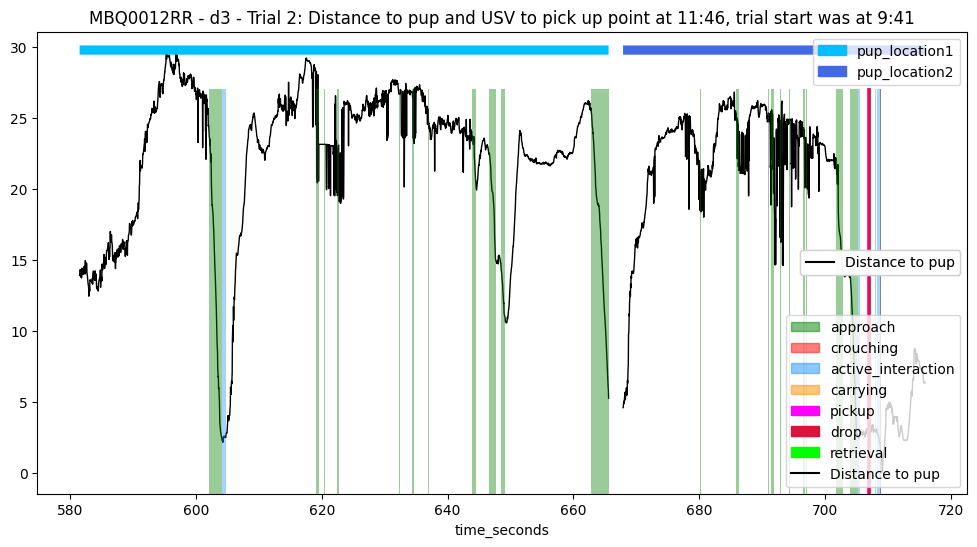

 ==== Example: MBQ0012RR - d3 - 3 ==== 
 ==== Example: MBQ0012RR - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 771.677
* Success time: 774.74
---> Pick up frame: 23150, Start frame: 21854, End frame: 23242
---> Retrieval frame: 23242; Start frame: 21854; End frame: 23242
---> Final frame: 23242
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23150 * Pickup time:  771.677
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1389
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_

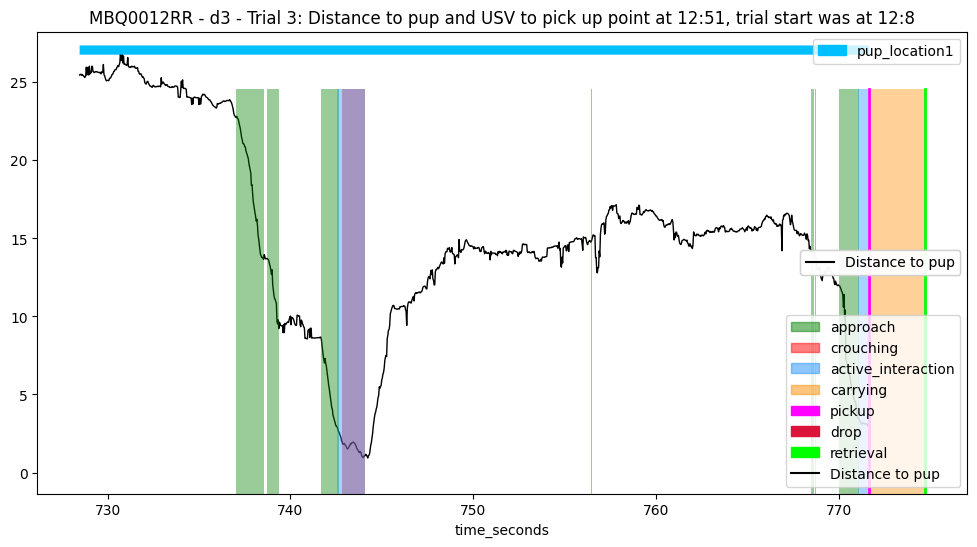

 ==== Example: MBQ0012RR - d3 - 4 ==== 
 ==== Example: MBQ0012RR - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4349
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        4349
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 786.1 to 846.066666666666

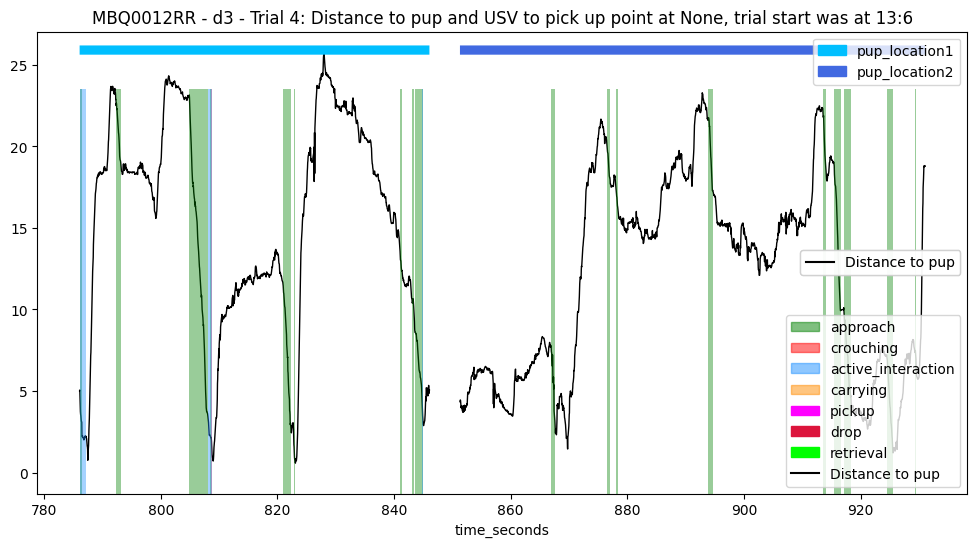

 ==== Example: MBQ0012RR - d3 - 5 ==== 
 ==== Example: MBQ0012RR - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 994.861
* Success time: None
---> Pick up frame: 29846, Start frame: 28107, End frame: 32102
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  29846 * Pickup time:  994.861
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3996
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 29846, instantly drop at 29847
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_t

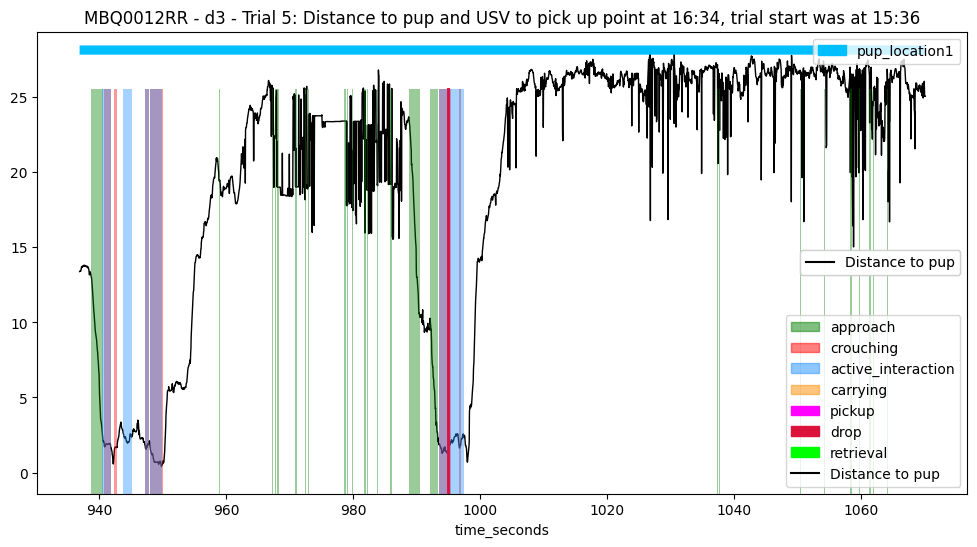

 ==== Example: MBQ0012RR - d3 - 6 ==== 
 ==== Example: MBQ0012RR - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1140.021
* Success time: 1143.661
---> Pick up frame: 34201, Start frame: 32393, End frame: 34309
---> Retrieval frame: 34310; Start frame: 32393; End frame: 34309
---> Final frame: 34309
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34201 * Pickup time:  1140.021
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1917
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        31
distance_h

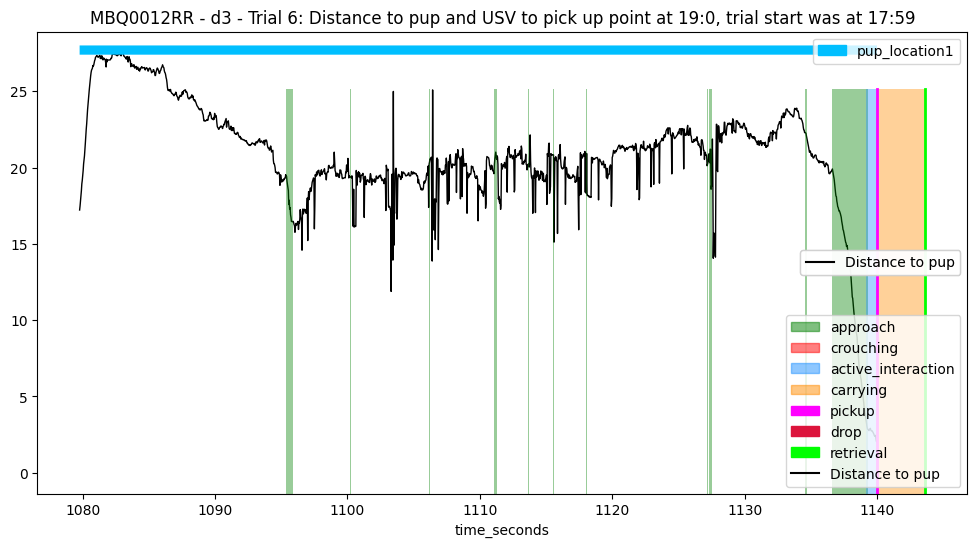

 ==== Example: MBQ0012RR - d3 - 7 ==== 
 ==== Example: MBQ0012RR - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1157.981
* Success time: 1163.221
---> Pick up frame: 34739, Start frame: 34621, End frame: 34896
---> Retrieval frame: 34897; Start frame: 34621; End frame: 34896
---> Final frame: 34896
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34739 * Pickup time:  1157.981
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 276
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        27
distance_he

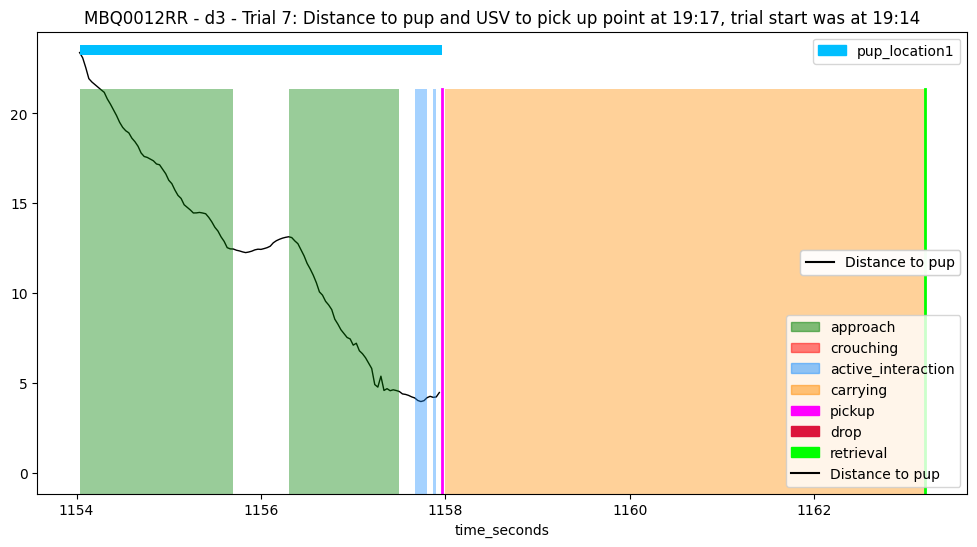

 ==== Example: MBQ0012RR - d3 - 8 ==== 
 ==== Example: MBQ0012RR - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1190.613
* Success time: 1285.109
---> Pick up frame: 35718, Start frame: 35564, End frame: 38553
---> Retrieval frame: 38553; Start frame: 35564; End frame: 38553
---> Final frame: 38553
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  35718 * Pickup time:  1190.613
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2990
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 35718, instantly drop at 35719
---> Processing last pup locat

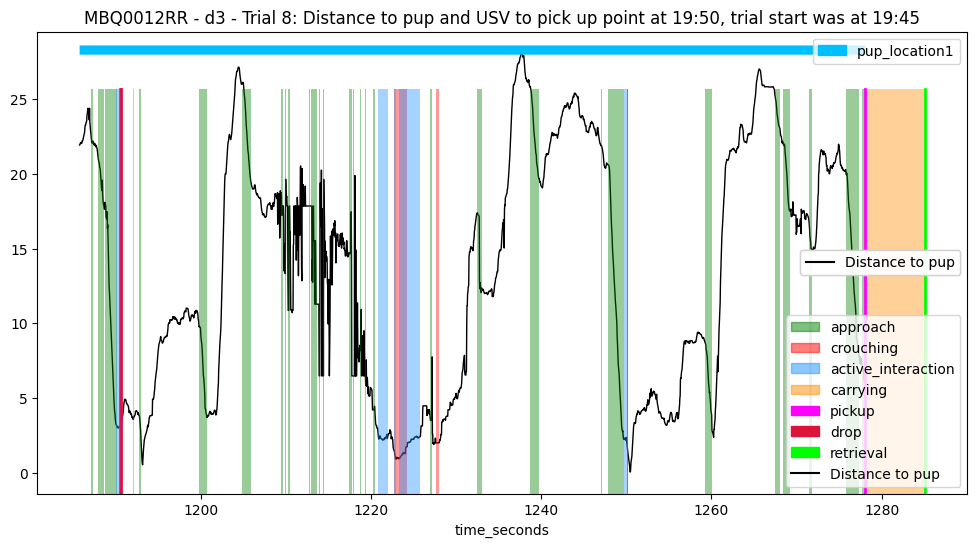

 ==== Example: MBQ0012RR - d3 - 9 ==== 
 ==== Example: MBQ0012RR - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1305.997
* Success time: 1310.821
---> Pick up frame: 39180, Start frame: 38932, End frame: 39324
---> Retrieval frame: 39325; Start frame: 38932; End frame: 39324
---> Final frame: 39324
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  39180 * Pickup time:  1305.997
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 393
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        34
distance_he

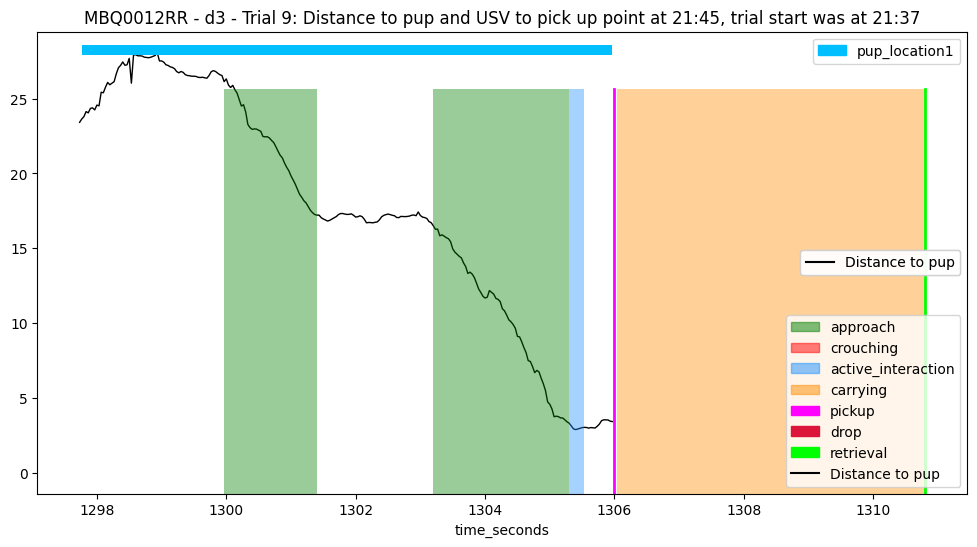

 ==== Example: MBQ0012RR - d4 - 1 ==== 
 ==== Example: MBQ0012RR - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4117
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        730
distance_head_to_pup         730
head_angle_to_pup_degrees    730
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        730
distance_head_to_pup         730
head_angle_

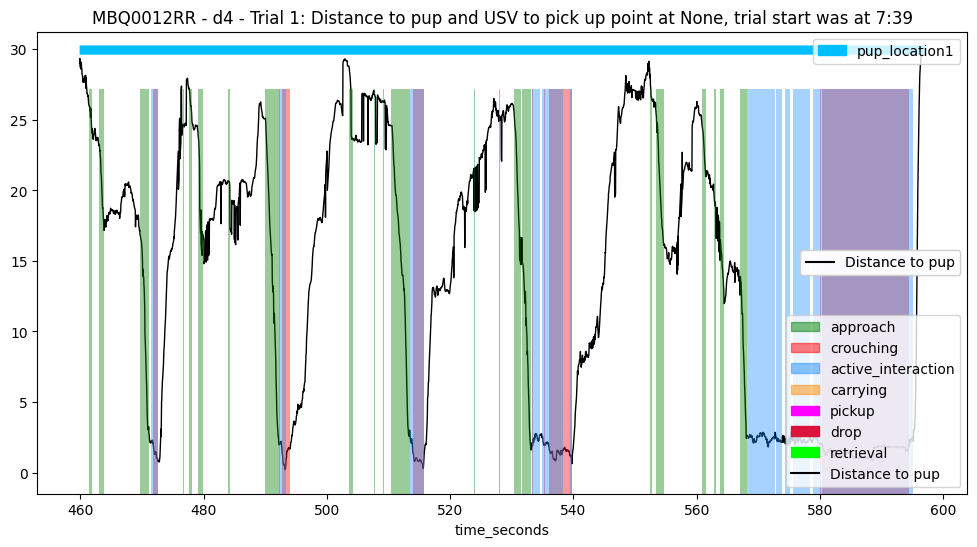

 ==== Example: MBQ0012RR - d4 - 2 ==== 
 ==== Example: MBQ0012RR - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3746
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_degrees    60
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pu

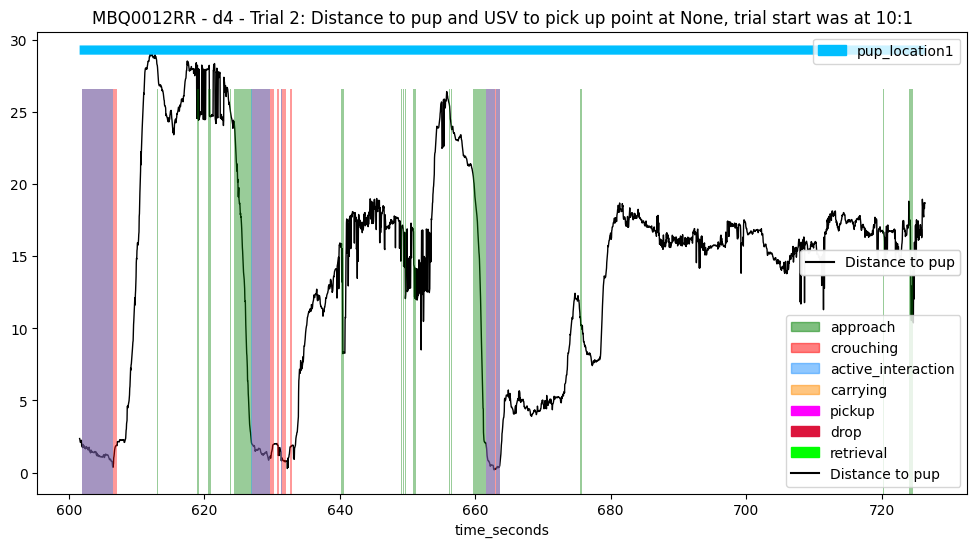

 ==== Example: MBQ0012RR - d4 - 3 ==== 
 ==== Example: MBQ0012RR - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 742.0
* Success time: 745.962
---> Pick up frame: 22260, Start frame: 22123, End frame: 22378
---> Retrieval frame: 22379; Start frame: 22123; End frame: 22378
---> Final frame: 22378
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22260 * Pickup time:  742.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 256
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        5
distance_head_to_pu

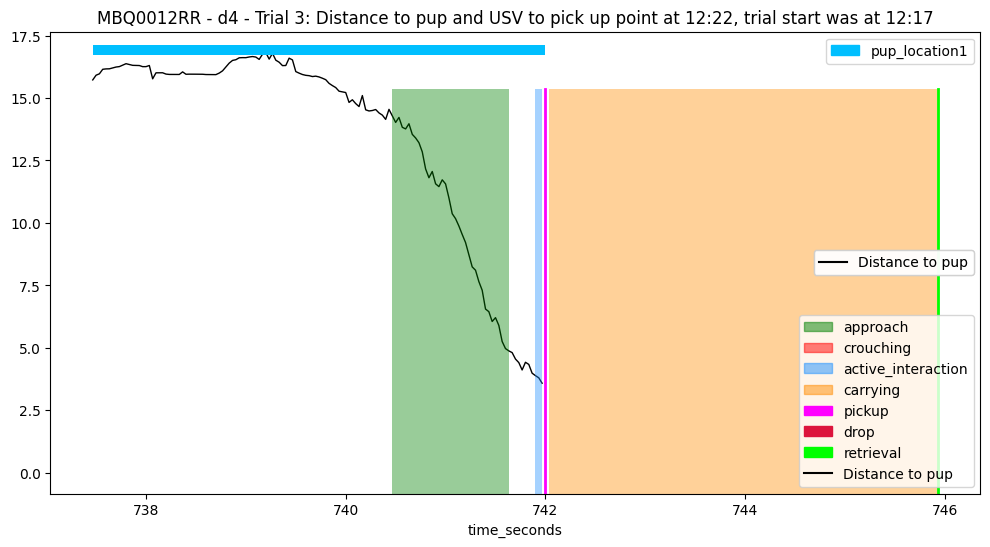

 ==== Example: MBQ0012RR - d4 - 4 ==== 
 ==== Example: MBQ0012RR - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 845.154
* Success time: 847.138
---> Pick up frame: 25355, Start frame: 23215, End frame: 25414
---> Retrieval frame: 25414; Start frame: 23215; End frame: 25414
---> Final frame: 25414
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25355 * Pickup time:  845.154
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2200
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        54
distance_head

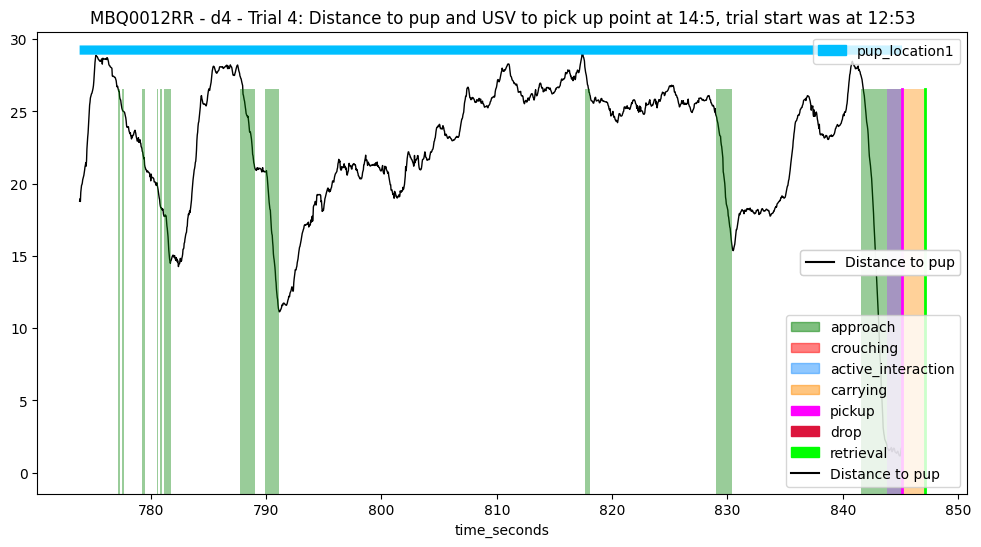

 ==== Example: MBQ0012RR - d4 - 5 ==== 
 ==== Example: MBQ0012RR - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 865.819
* Success time: 870.202
---> Pick up frame: 25975, Start frame: 25809, End frame: 26106
---> Retrieval frame: 26106; Start frame: 25809; End frame: 26106
---> Final frame: 26106
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25975 * Pickup time:  865.819
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 298
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_head_

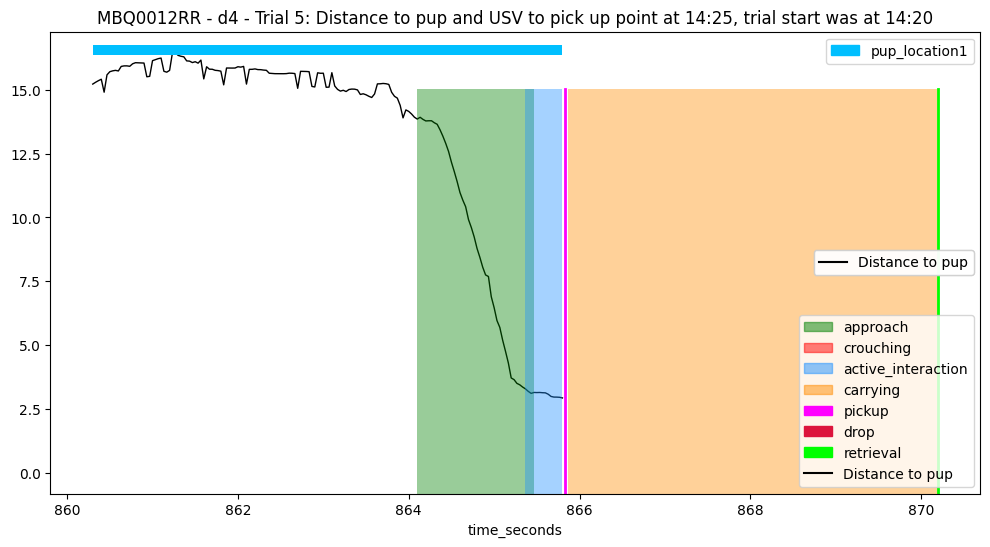

 ==== Example: MBQ0012RR - d4 - 6 ==== 
 ==== Example: MBQ0012RR - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 885.186
* Success time: 888.163
---> Pick up frame: 26556, Start frame: 26482, End frame: 26644
---> Retrieval frame: 26645; Start frame: 26482; End frame: 26644
---> Final frame: 26644
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26556 * Pickup time:  885.186
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 163
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        44
distance_head_

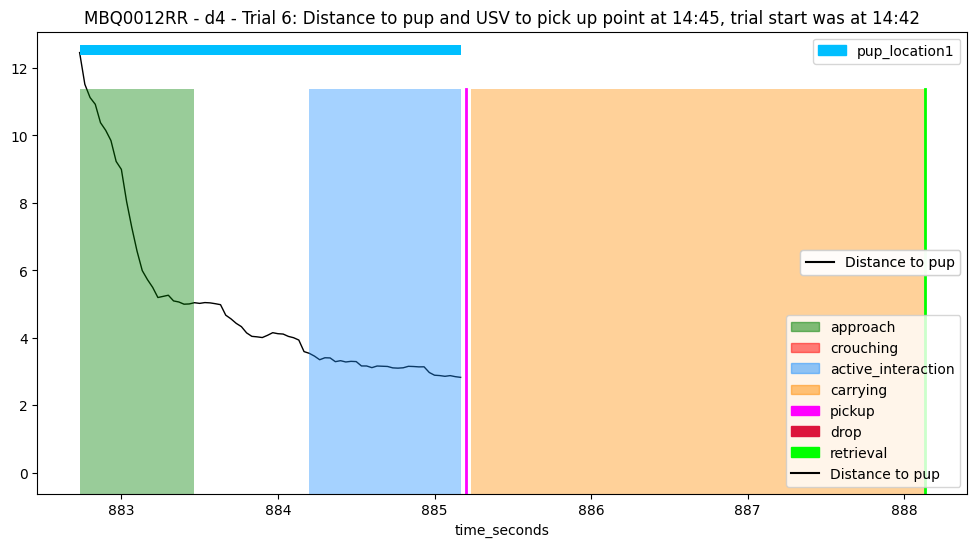

 ==== Example: MBQ0012RR - d4 - 7 ==== 
 ==== Example: MBQ0012RR - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 904.65
* Success time: 907.771
---> Pick up frame: 27140, Start frame: 27010, End frame: 27233
---> Retrieval frame: 27233; Start frame: 27010; End frame: 27233
---> Final frame: 27233
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27140 * Pickup time:  904.65
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 224
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_to

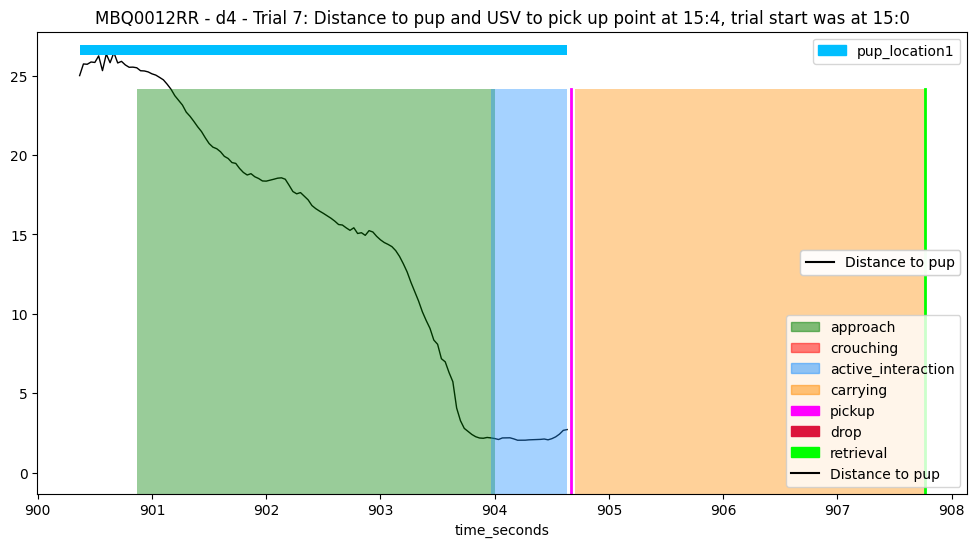

 ==== Example: MBQ0012RR - d4 - 8 ==== 
 ==== Example: MBQ0012RR - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 930.995
* Success time: None
---> Pick up frame: 27930, Start frame: 27556, End frame: 31331
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  27930 * Pickup time:  930.995
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3776
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_to_pup         29
head_angle_to_pup_degrees    29
dtype: int64
--

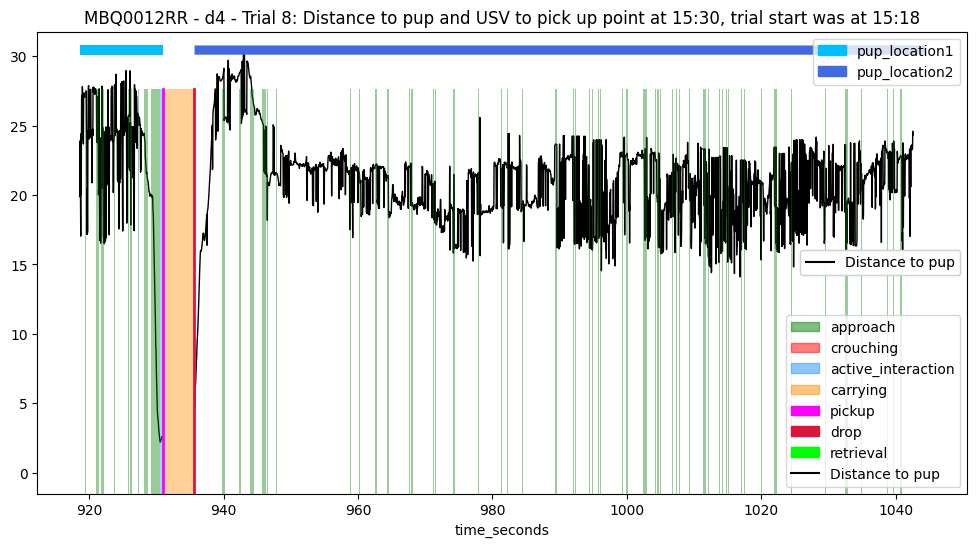

 ==== Example: MBQ0012RR - d4 - 9 ==== 
 ==== Example: MBQ0012RR - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1081.563
* Success time: 1083.803
---> Pick up frame: 32447, Start frame: 31543, End frame: 32514
---> Retrieval frame: 32514; Start frame: 31543; End frame: 32514
---> Final frame: 32514
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  32447 * Pickup time:  1081.563
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 972
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        20
distance_he

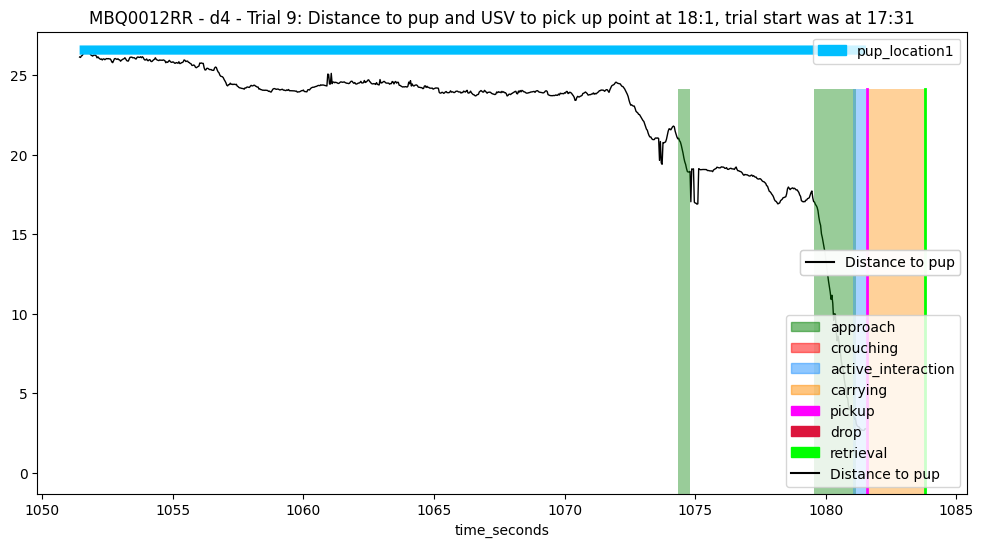

 ==== Example: MBQ0012RR - d5 - 1 ==== 
 ==== Example: MBQ0012RR - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3714
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        49
distance_head_to_pup         49
head_angle_to_pup_degrees    49
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        49
distance_head_to_pup         49
head_angle_to_pu

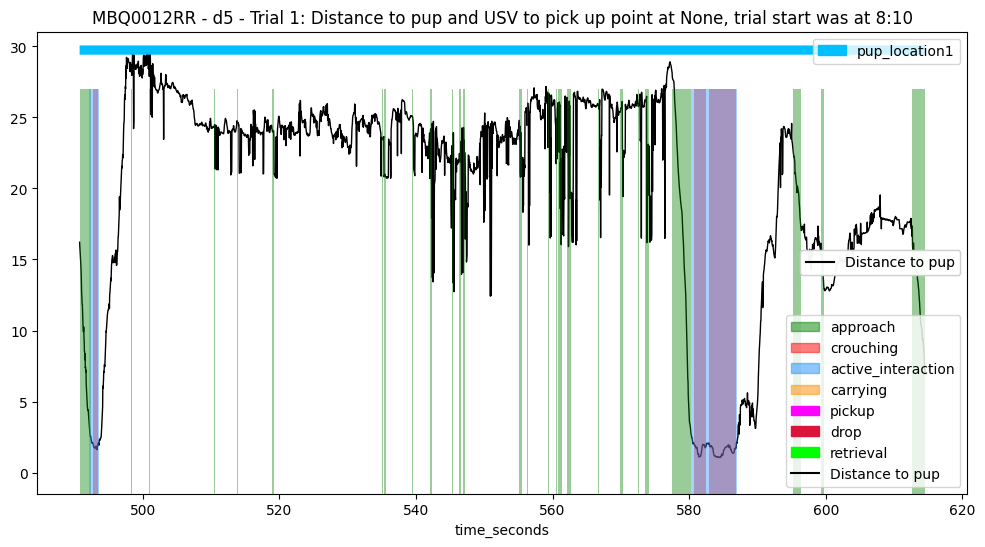

 ==== Example: MBQ0012RR - d5 - 2 ==== 
 ==== Example: MBQ0012RR - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4019
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to_pup         25
head_angle_to_pup_degrees    25
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        25
distance_head_to_pup         25
head_angle_to_pu

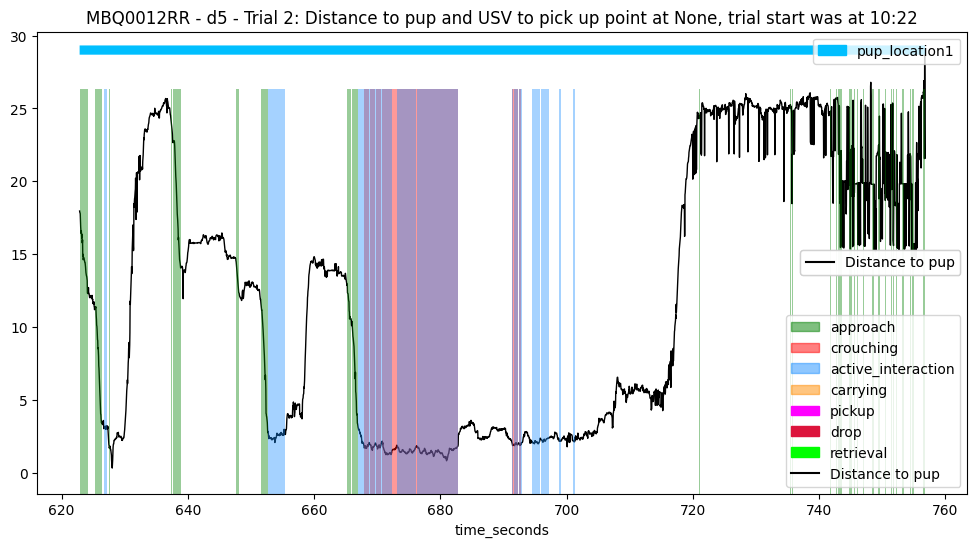

 ==== Example: MBQ0012RR - d5 - 3 ==== 
 ==== Example: MBQ0012RR - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 798.563
* Success time: None
---> Pick up frame: 23957, Start frame: 22968, End frame: 26756
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23957 * Pickup time:  798.563
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3789
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 23957, instantly drop at 23958
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        23
distance_head_t

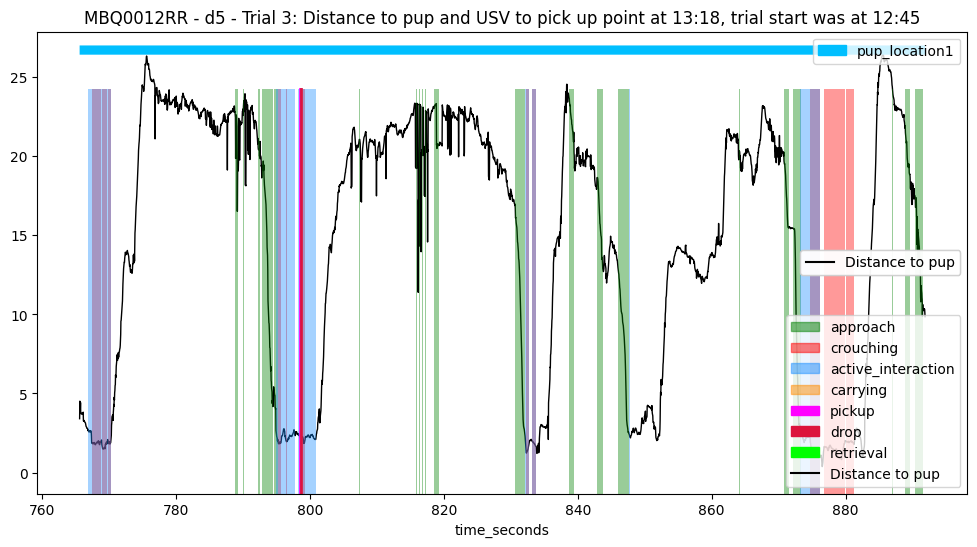

 ==== Example: MBQ0012RR - d5 - 4 ==== 
 ==== Example: MBQ0012RR - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 944.443
* Success time: 946.243
---> Pick up frame: 28333, Start frame: 27088, End frame: 28387
---> Retrieval frame: 28387; Start frame: 27088; End frame: 28387
---> Final frame: 28387
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28333 * Pickup time:  944.443
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1300
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        59
distance_head

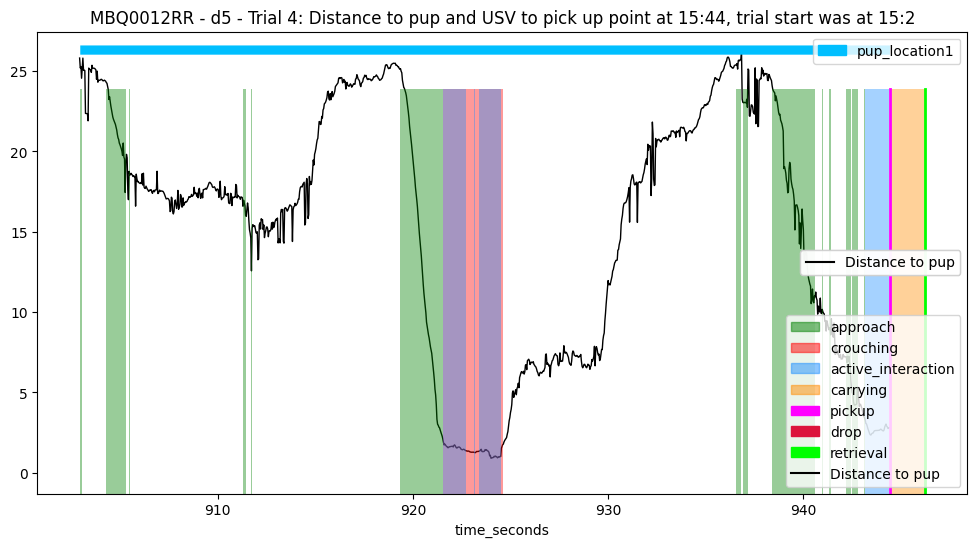

 ==== Example: MBQ0012RR - d5 - 5 ==== 
 ==== Example: MBQ0012RR - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 962.963
* Success time: None
---> Pick up frame: 28889, Start frame: 28760, End frame: 32675
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28889 * Pickup time:  962.963
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3916
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 28889, instantly drop at 28890
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        20
distance_head_t

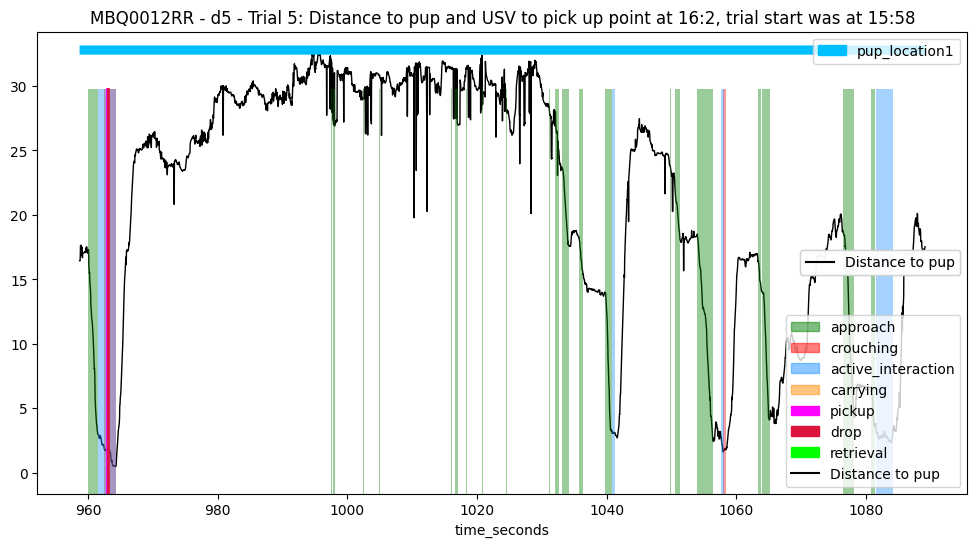

 ==== Example: MBQ0012RR - d5 - 6 ==== 
 ==== Example: MBQ0012RR - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1123.067
* Success time: None
---> Pick up frame: 33692, Start frame: 32872, End frame: 37289
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  33692 * Pickup time:  1123.067
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4418
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 33692, instantly drop at 33693
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        54
distance_head

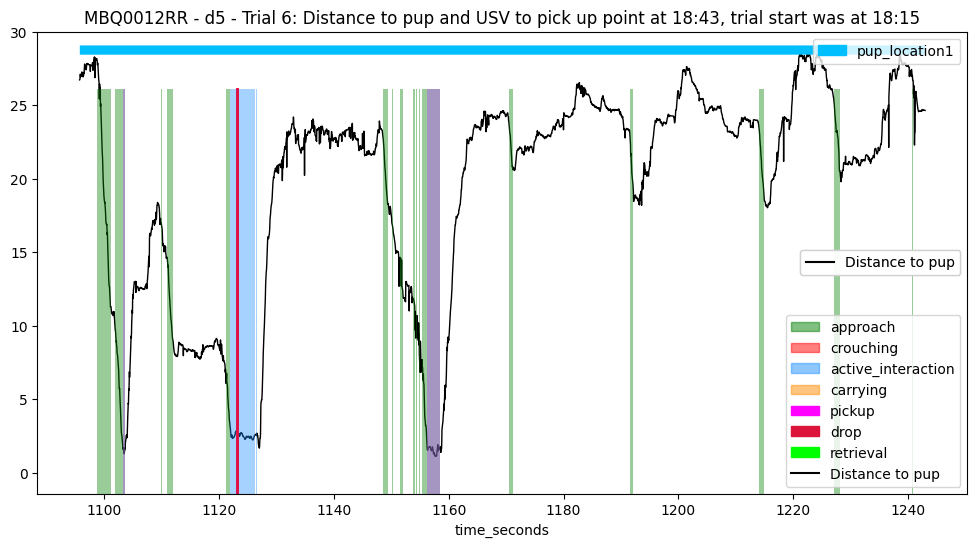

 ==== Example: MBQ0012RR - d5 - 7 ==== 
 ==== Example: MBQ0012RR - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4047
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_to_pup         38
head_angle_to_pup_degrees    38
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        38
distance_head_to_pup         38
head_angle_to_pu

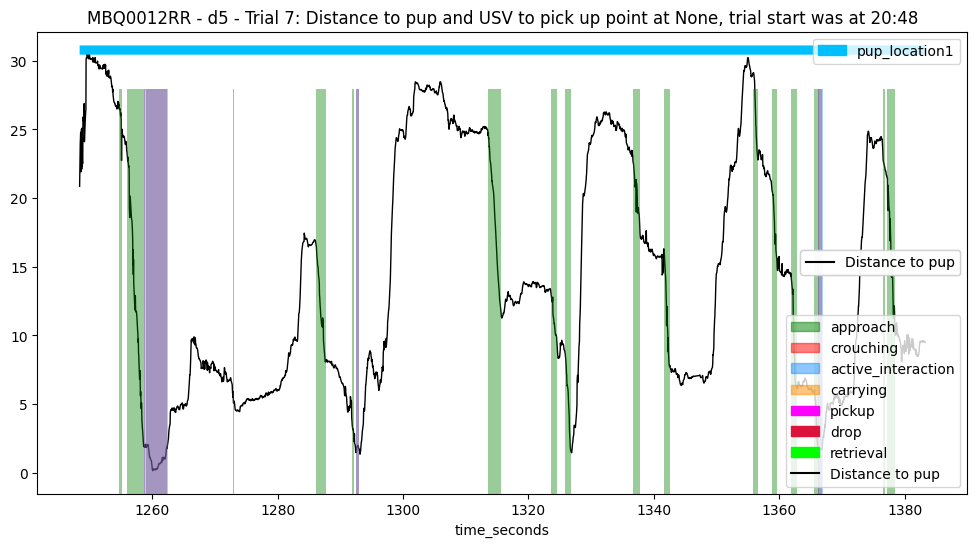

 ==== Example: MBQ0012RR - d5 - 8 ==== 
 ==== Example: MBQ0012RR - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1407.956
* Success time: 1410.524
---> Pick up frame: 42239, Start frame: 41675, End frame: 42315
---> Retrieval frame: 42316; Start frame: 41675; End frame: 42315
---> Final frame: 42315
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  42239 * Pickup time:  1407.956
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 641
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_he

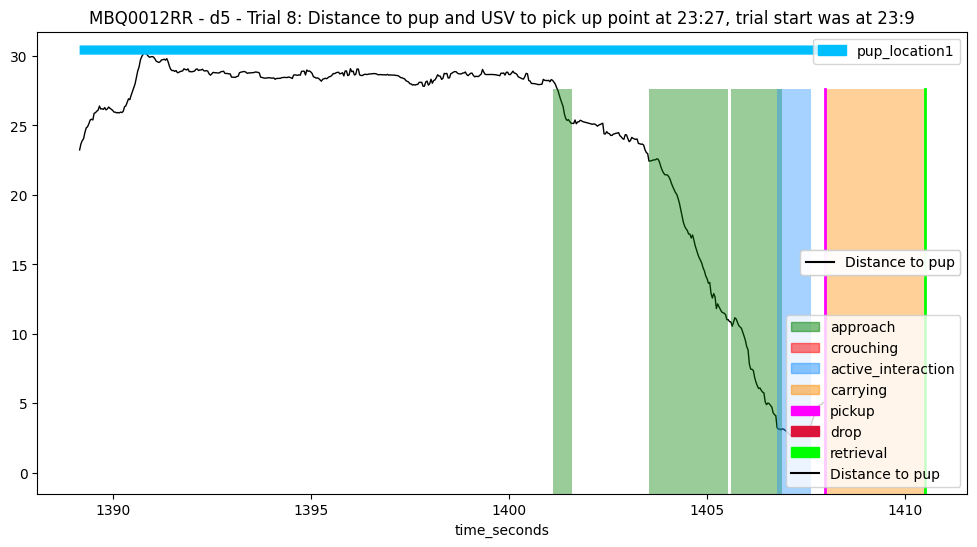

 ==== Example: MBQ0012RR - d5 - 9 ==== 
 ==== Example: MBQ0012RR - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1442.212
* Success time: None
---> Pick up frame: 43266, Start frame: 42579, End frame: 46779
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  43266 * Pickup time:  1442.212
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4201
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_to_pup         30
head_angle_to_pup_degrees    30
dtype: int64


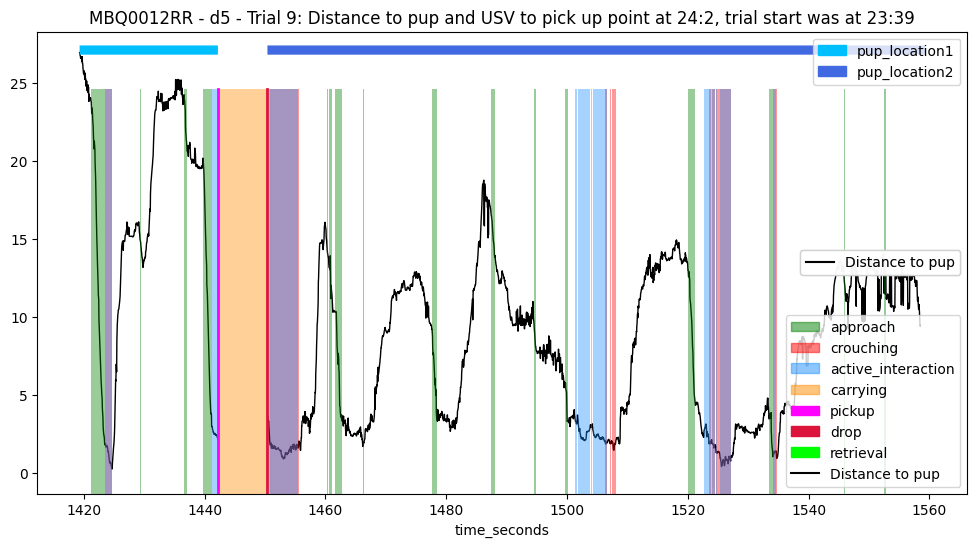

 ==== Example: MBQ0012RR - d6 - 1 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 1) ==== 
 ==== Example: MBQ0012RR - d6 - 2 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 2) ==== 
 ==== Example: MBQ0012RR - d6 - 3 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 3) ==== 
 ==== Example: MBQ0012RR - d6 - 4 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 4) ==== 
 ==== Example: MBQ0012RR - d6 - 5 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 5) ==== 
 ==== Example: MBQ0012RR - d6 - 6 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 6) ==== 
 ==== Example: MBQ0012RR - d6 - 7 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 7) ==== 
 ==== Example: MBQ0012RR - d6 - 8 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 8) ==== 
 ==== Example: MBQ0012RR - d6 - 9 ==== 
 ==== Skipping example: ('MBQ0012RR', 'd6', 9) ==== 
 ==== Example: MBI5335RR - d1 - 1 ==== 
 ==== Example: MBI5335RR - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 382.266
* Succe

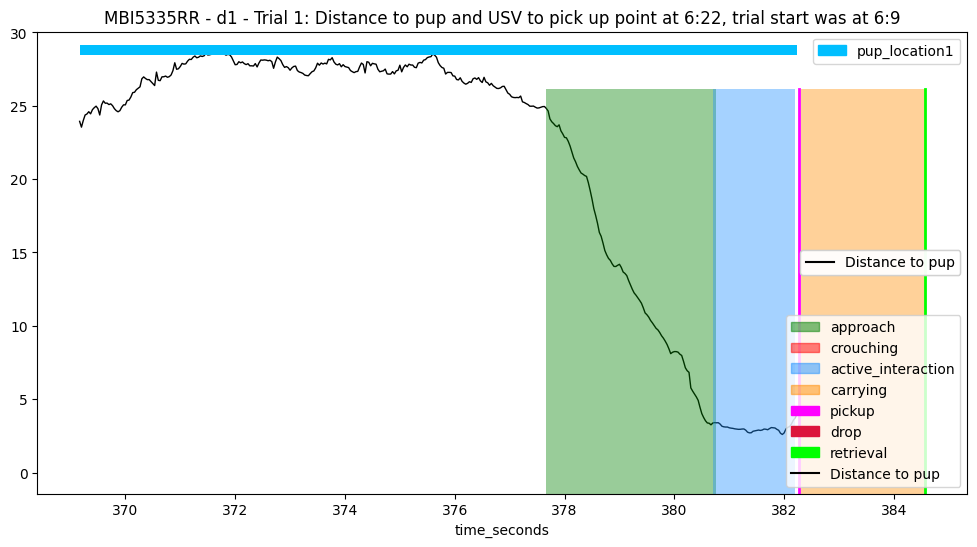

 ==== Example: MBI5335RR - d1 - 2 ==== 
 ==== Example: MBI5335RR - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 399.682
* Success time: 402.842
---> Pick up frame: 11990, Start frame: 11901, End frame: 12085
---> Retrieval frame: 12085; Start frame: 11901; End frame: 12085
---> Final frame: 12085
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  11990 * Pickup time:  399.682
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 185
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_

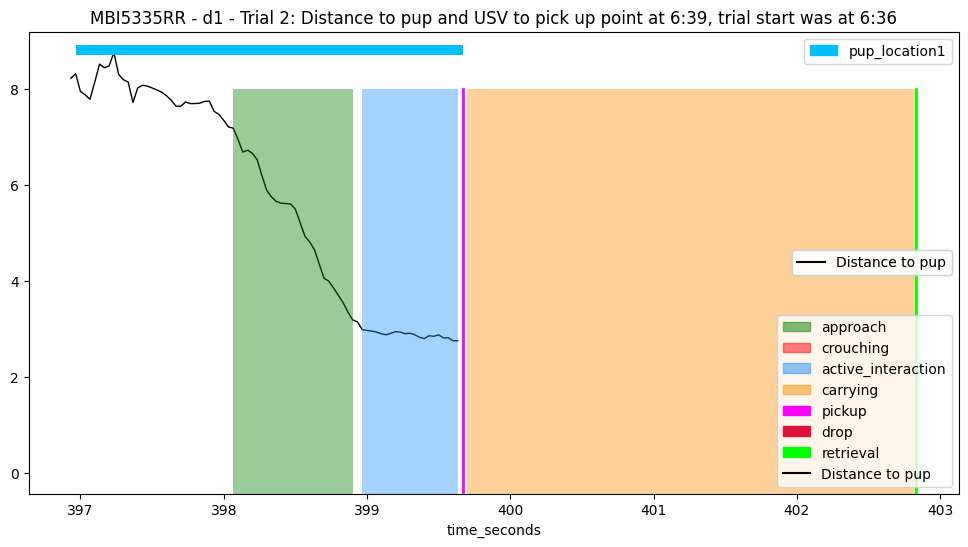

 ==== Example: MBI5335RR - d1 - 3 ==== 
 ==== Example: MBI5335RR - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 491.418
* Success time: 494.93
---> Pick up frame: 14743, Start frame: 12456, End frame: 14847
---> Retrieval frame: 14848; Start frame: 12456; End frame: 14847
---> Final frame: 14847
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14743 * Pickup time:  491.418
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2392
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        67
distance_head_

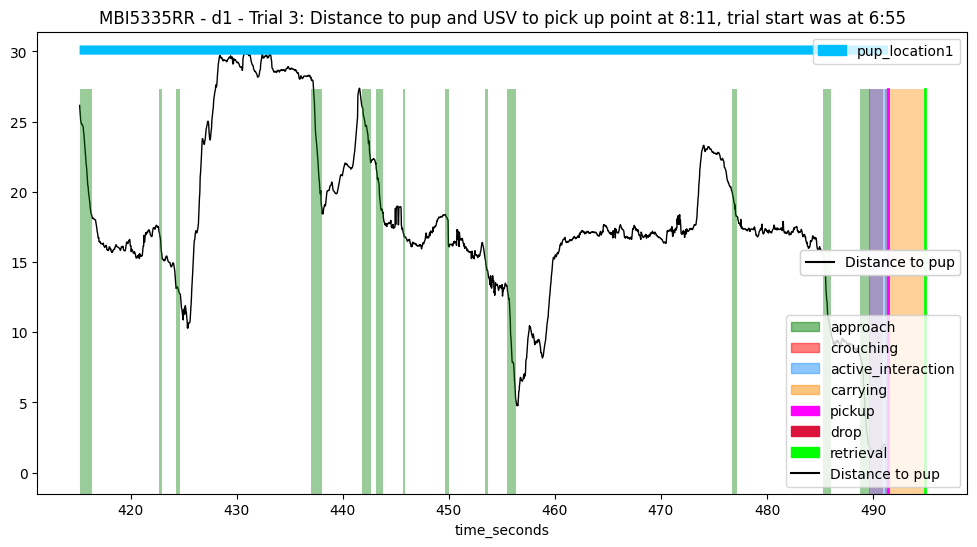

 ==== Example: MBI5335RR - d1 - 4 ==== 
 ==== Example: MBI5335RR - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 527.066
* Success time: 531.348
---> Pick up frame: 15812, Start frame: 15232, End frame: 15940
---> Retrieval frame: 15940; Start frame: 15232; End frame: 15940
---> Final frame: 15940
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15812 * Pickup time:  527.066
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 709
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_

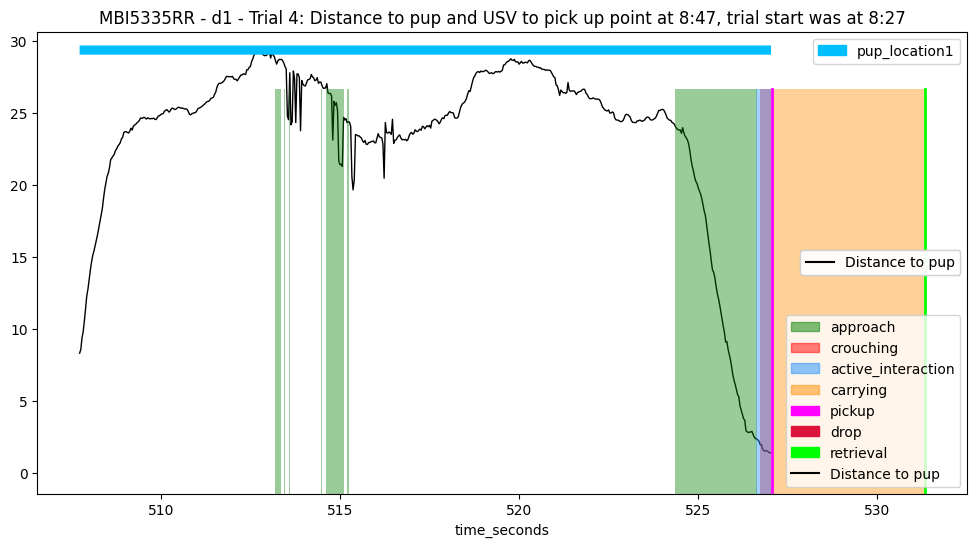

 ==== Example: MBI5335RR - d1 - 5 ==== 
 ==== Example: MBI5335RR - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 654.562
* Success time: 656.083
---> Pick up frame: 19637, Start frame: 16418, End frame: 19682
---> Retrieval frame: 19682; Start frame: 16418; End frame: 19682
---> Final frame: 19682
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19637 * Pickup time:  654.562
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3265
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head

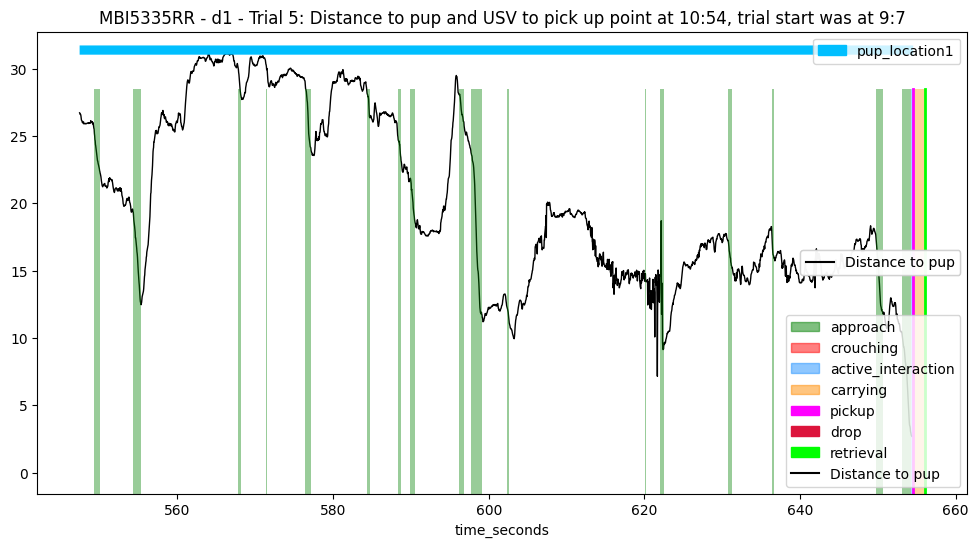

 ==== Example: MBI5335RR - d1 - 6 ==== 
 ==== Example: MBI5335RR - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 673.33
* Success time: 675.674
---> Pick up frame: 20200, Start frame: 19973, End frame: 20270
---> Retrieval frame: 20270; Start frame: 19973; End frame: 20270
---> Final frame: 20270
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20200 * Pickup time:  673.33
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 298
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        85
distance_head_to

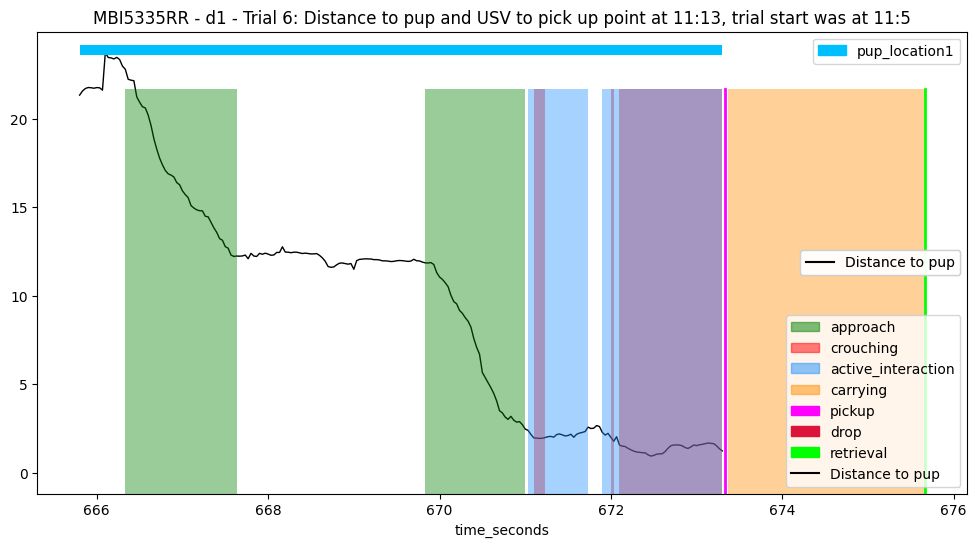

 ==== Example: MBI5335RR - d1 - 7 ==== 
 ==== Example: MBI5335RR - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 694.33
* Success time: 697.442
---> Pick up frame: 20830, Start frame: 20601, End frame: 20923
---> Retrieval frame: 20923; Start frame: 20601; End frame: 20923
---> Final frame: 20923
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20830 * Pickup time:  694.33
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 323
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_to

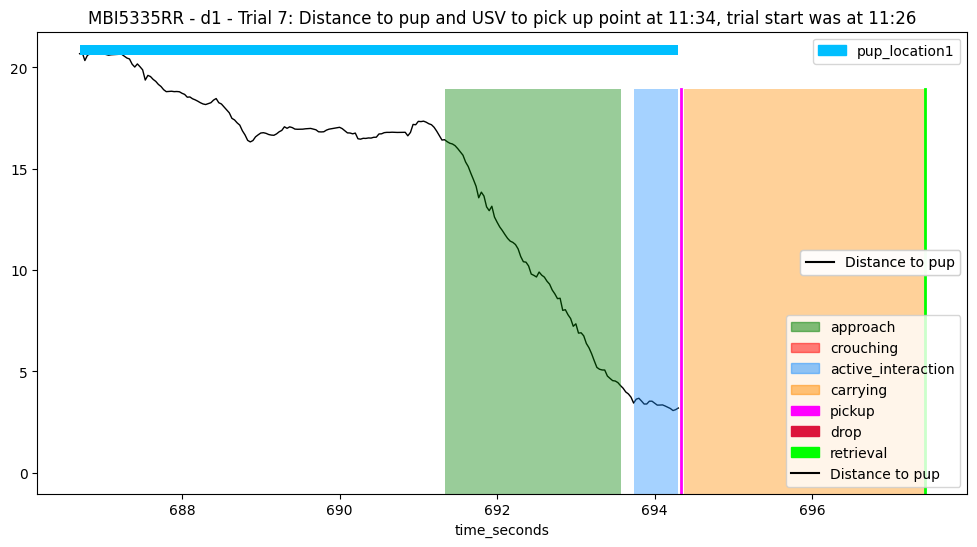

 ==== Example: MBI5335RR - d1 - 8 ==== 
 ==== Example: MBI5335RR - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 727.018
* Success time: 728.85
---> Pick up frame: 21811, Start frame: 21386, End frame: 21865
---> Retrieval frame: 21866; Start frame: 21386; End frame: 21865
---> Final frame: 21865
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21811 * Pickup time:  727.018
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 480
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        24
distance_head_t

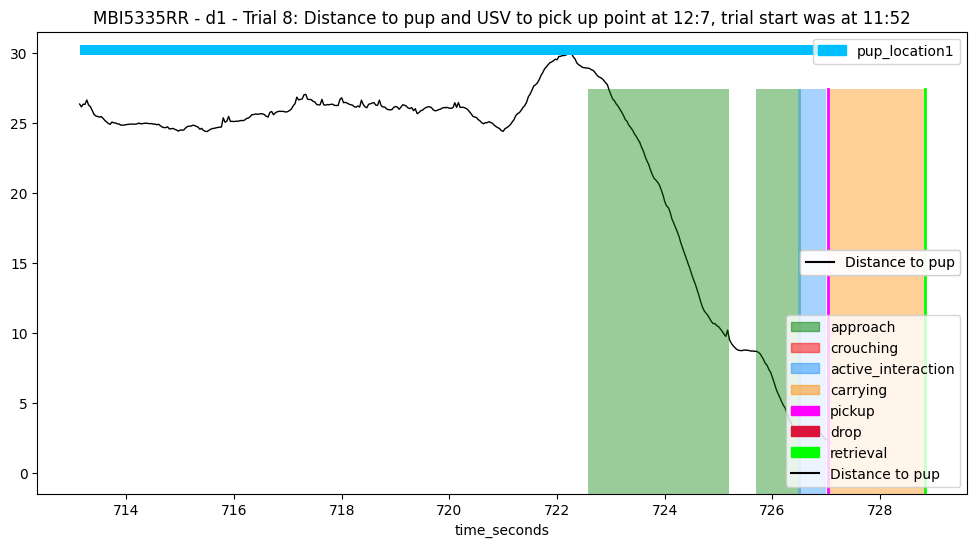

 ==== Example: MBI5335RR - d1 - 9 ==== 
 ==== Example: MBI5335RR - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 807.77
* Success time: 811.93
---> Pick up frame: 24233, Start frame: 22213, End frame: 24357
---> Retrieval frame: 24358; Start frame: 22213; End frame: 24357
---> Final frame: 24357
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24233 * Pickup time:  807.77
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2145
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to

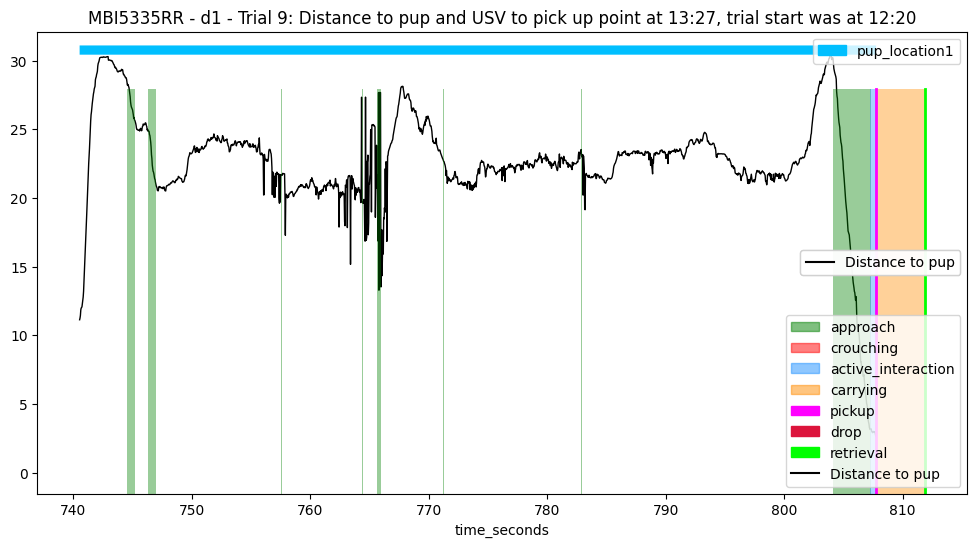

 ==== Example: MBI5335RR - d2 - 1 ==== 
 ==== Example: MBI5335RR - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 472.01
* Success time: 476.074
---> Pick up frame: 14160, Start frame: 13696, End frame: 14282
---> Retrieval frame: 14282; Start frame: 13696; End frame: 14282
---> Final frame: 14282
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14160 * Pickup time:  472.01
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 587
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to

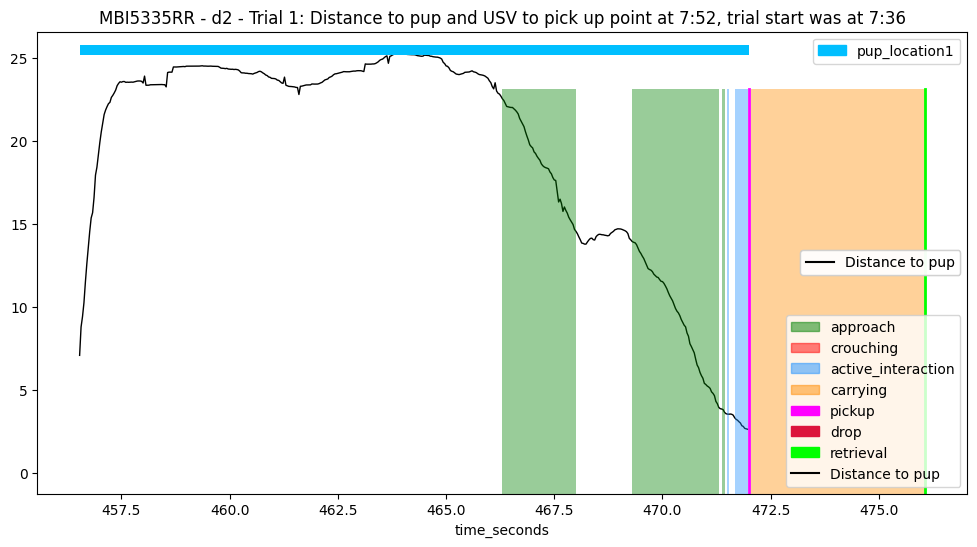

 ==== Example: MBI5335RR - d2 - 2 ==== 
 ==== Example: MBI5335RR - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 508.73800000000006
* Success time: 511.77
---> Pick up frame: 15262, Start frame: 14707, End frame: 15353
---> Retrieval frame: 15353; Start frame: 14707; End frame: 15353
---> Final frame: 15353
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15262 * Pickup time:  508.73800000000006
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 647
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup    

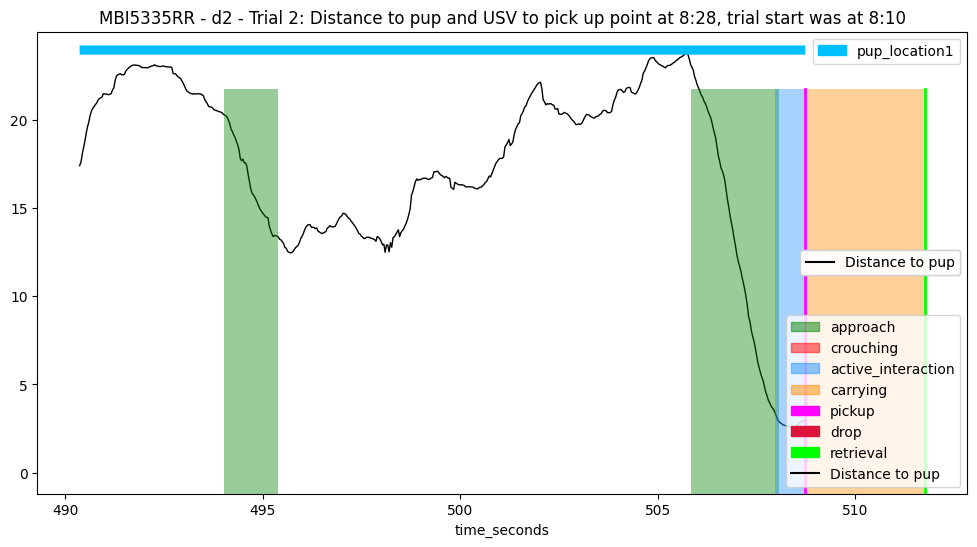

 ==== Example: MBI5335RR - d2 - 3 ==== 
 ==== Example: MBI5335RR - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 573.634
* Success time: 577.954
---> Pick up frame: 17209, Start frame: 15714, End frame: 17338
---> Retrieval frame: 17339; Start frame: 15714; End frame: 17338
---> Final frame: 17338
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17209 * Pickup time:  573.634
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1625
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 17209, instantly drop at 17210
---> Processing last pup location

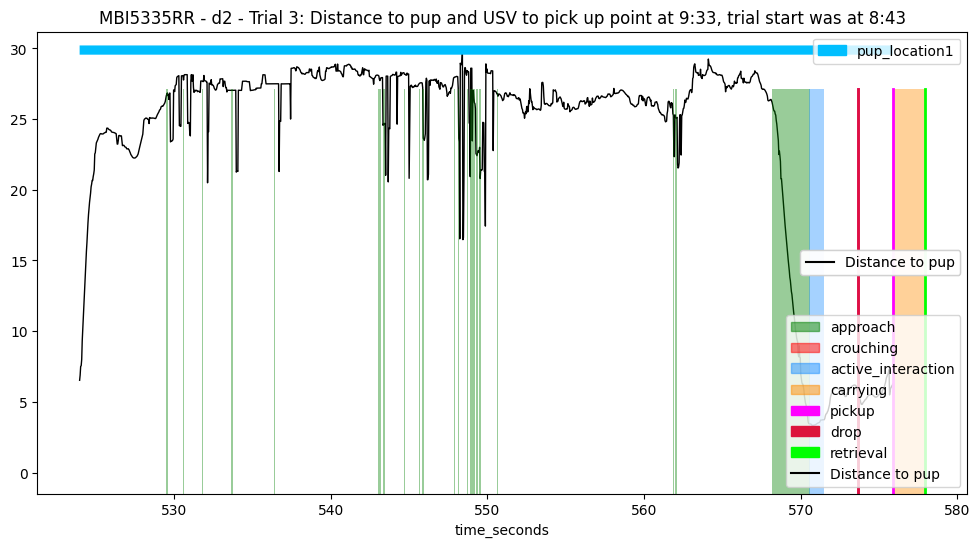

 ==== Example: MBI5335RR - d2 - 4 ==== 
 ==== Example: MBI5335RR - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 654.866
* Success time: 656.786
---> Pick up frame: 19646, Start frame: 17739, End frame: 19703
---> Retrieval frame: 19704; Start frame: 17739; End frame: 19703
---> Final frame: 19703
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19646 * Pickup time:  654.866
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1965
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        92
distance_head

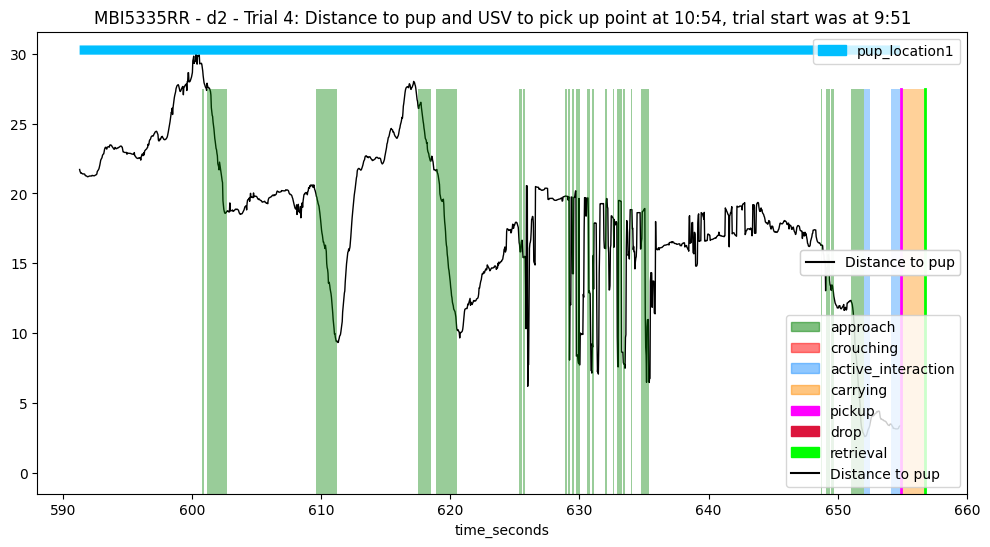

 ==== Example: MBI5335RR - d2 - 5 ==== 
 ==== Example: MBI5335RR - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 679.554
* Success time: 682.162
---> Pick up frame: 20387, Start frame: 20063, End frame: 20464
---> Retrieval frame: 20465; Start frame: 20063; End frame: 20464
---> Final frame: 20464
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20387 * Pickup time:  679.554
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 402
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_

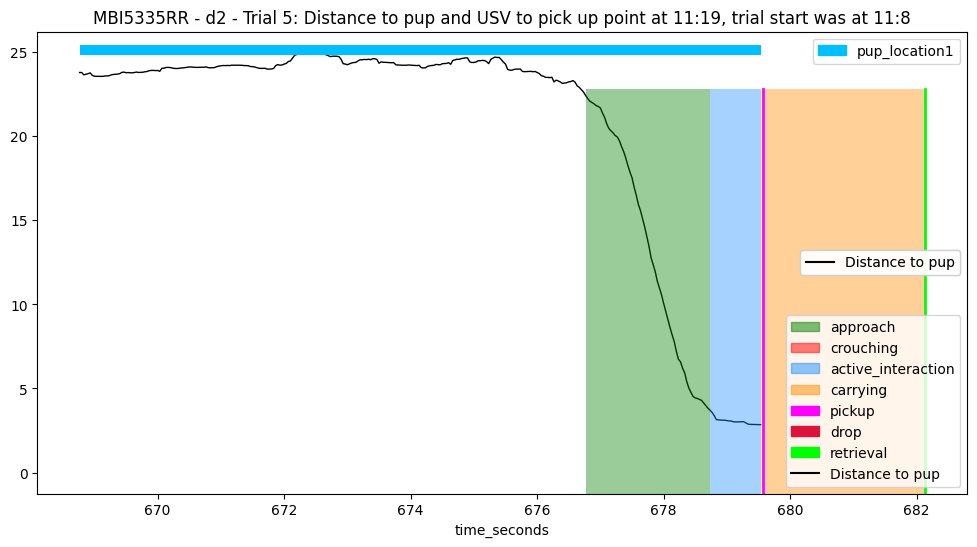

 ==== Example: MBI5335RR - d2 - 6 ==== 
 ==== Example: MBI5335RR - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 726.298
* Success time: 729.298
---> Pick up frame: 21789, Start frame: 20981, End frame: 21878
---> Retrieval frame: 21879; Start frame: 20981; End frame: 21878
---> Final frame: 21878
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21789 * Pickup time:  726.298
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 898
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_head_

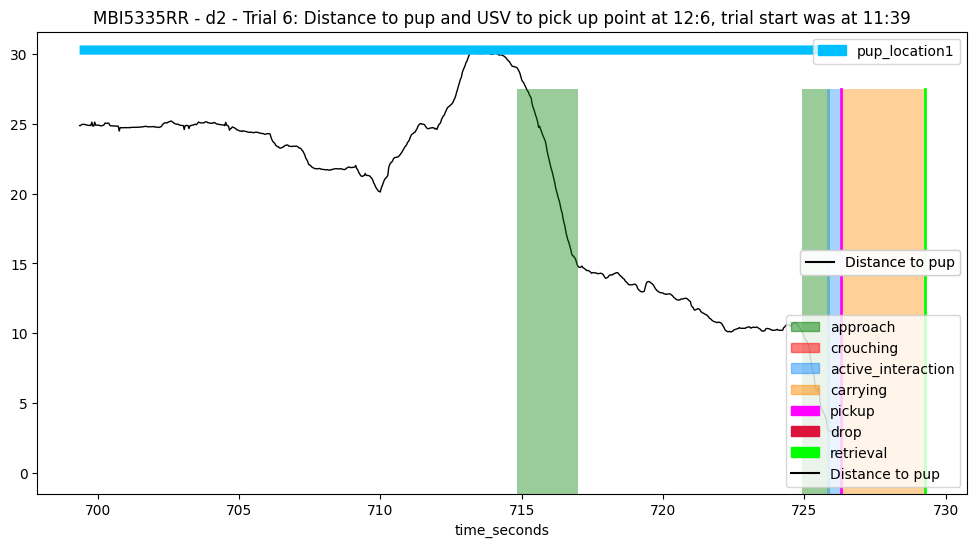

 ==== Example: MBI5335RR - d2 - 7 ==== 
 ==== Example: MBI5335RR - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 773.834
* Success time: 776.218
---> Pick up frame: 23215, Start frame: 22281, End frame: 23286
---> Retrieval frame: 23287; Start frame: 22281; End frame: 23286
---> Final frame: 23286
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23215 * Pickup time:  773.834
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1006
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        190
distance_hea

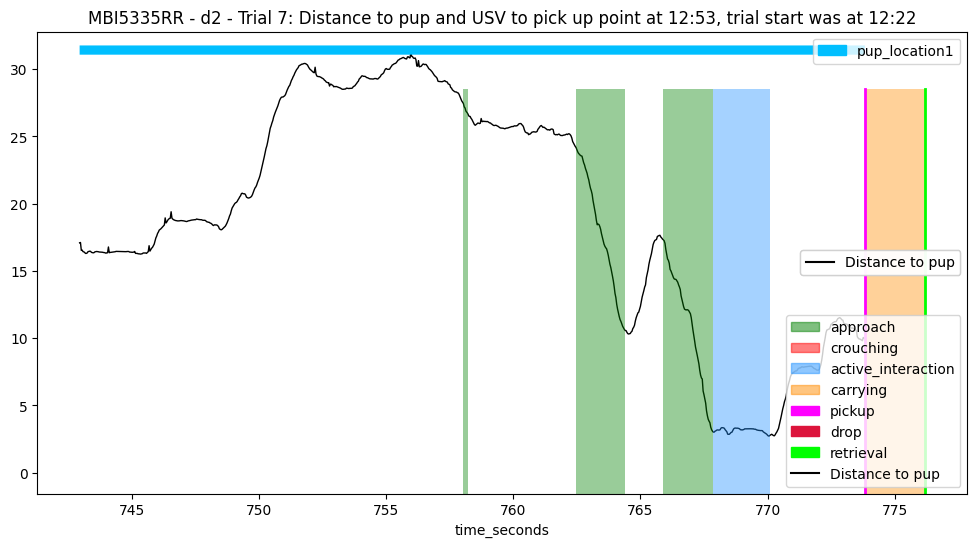

 ==== Example: MBI5335RR - d2 - 8 ==== 
 ==== Example: MBI5335RR - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 794.0
* Success time: 797.634
---> Pick up frame: 23820, Start frame: 23739, End frame: 23929
---> Retrieval frame: 23929; Start frame: 23739; End frame: 23929
---> Final frame: 23929
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23820 * Pickup time:  794.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 191
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 23820, instantly drop at 23821
---> Processing last pup location: pup

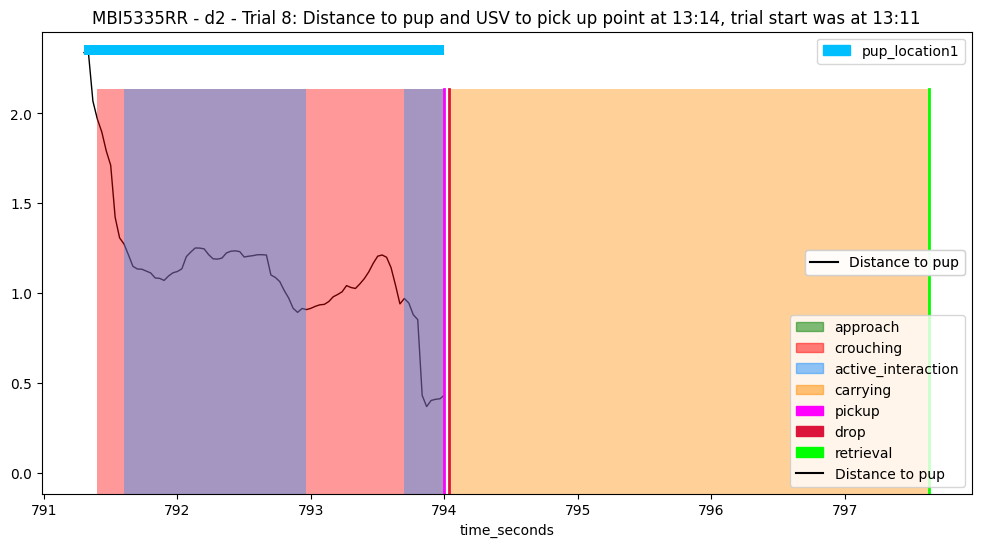

 ==== Example: MBI5335RR - d2 - 9 ==== 
 ==== Example: MBI5335RR - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 927.986
* Success time: 930.882
---> Pick up frame: 27840, Start frame: 24431, End frame: 27926
---> Retrieval frame: 27926; Start frame: 24431; End frame: 27926
---> Final frame: 27926
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27840 * Pickup time:  927.986
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3496
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head

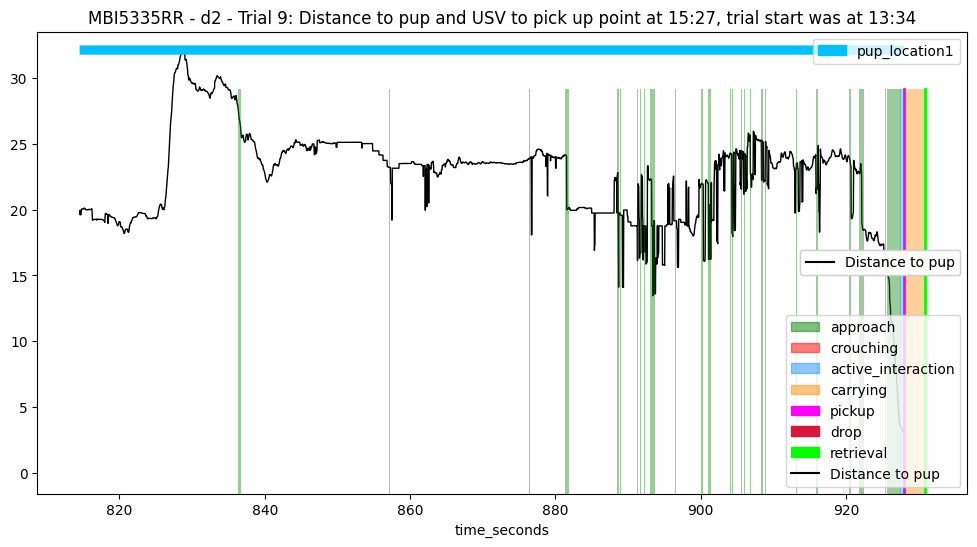

 ==== Example: MBI5335RR - d3 - 1 ==== 
 ==== Example: MBI5335RR - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 482.257
* Success time: 486.954
---> Pick up frame: 14468, Start frame: 13844, End frame: 14608
---> Retrieval frame: 14609; Start frame: 13844; End frame: 14608
---> Final frame: 14608
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14468 * Pickup time:  482.257
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 765
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        51
distance_head_

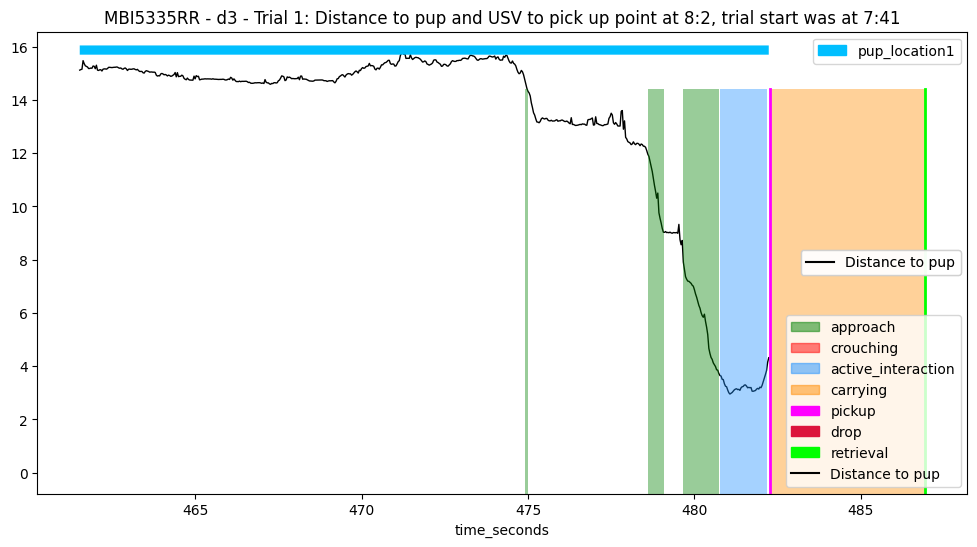

 ==== Example: MBI5335RR - d3 - 2 ==== 
 ==== Example: MBI5335RR - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 535.562
* Success time: 538.297
---> Pick up frame: 16067, Start frame: 15398, End frame: 16148
---> Retrieval frame: 16149; Start frame: 15398; End frame: 16148
---> Final frame: 16148
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16067 * Pickup time:  535.562
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 751
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_

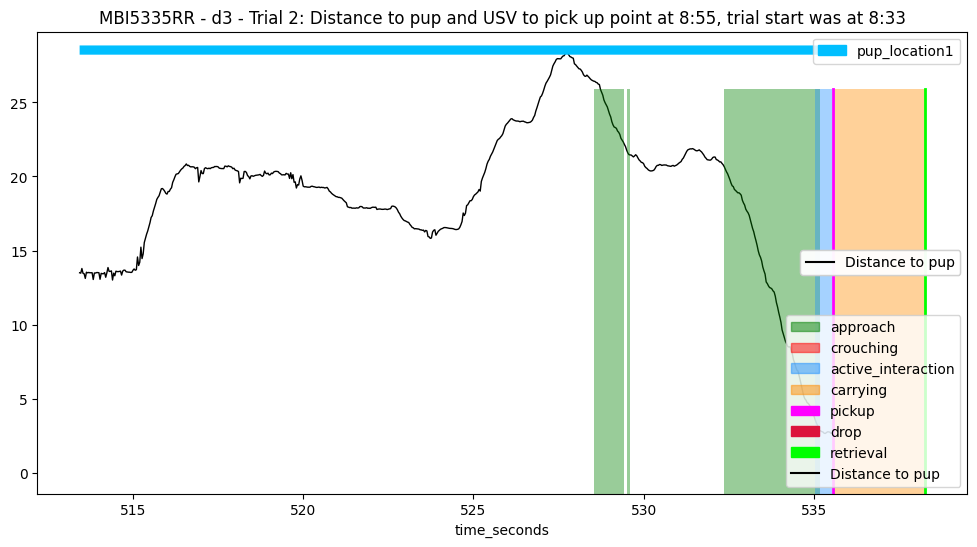

 ==== Example: MBI5335RR - d3 - 3 ==== 
 ==== Example: MBI5335RR - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 582.434
* Success time: 584.329
---> Pick up frame: 17473, Start frame: 16471, End frame: 17529
---> Retrieval frame: 17530; Start frame: 16471; End frame: 17529
---> Final frame: 17529
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17473 * Pickup time:  582.434
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1059
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        58
distance_head

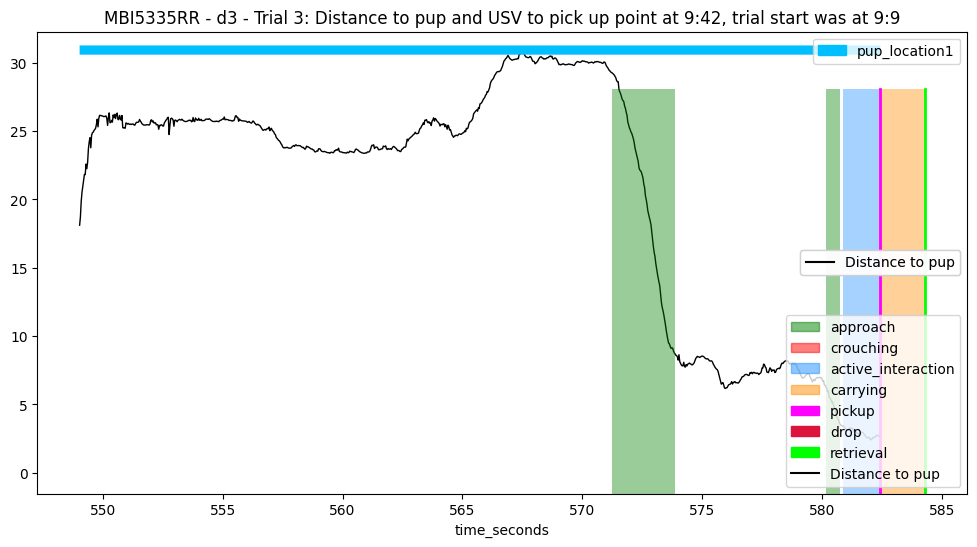

 ==== Example: MBI5335RR - d3 - 4 ==== 
 ==== Example: MBI5335RR - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 643.362
* Success time: 646.282
---> Pick up frame: 19301, Start frame: 17790, End frame: 19388
---> Retrieval frame: 19388; Start frame: 17790; End frame: 19388
---> Final frame: 19388
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19301 * Pickup time:  643.362
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1599
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head

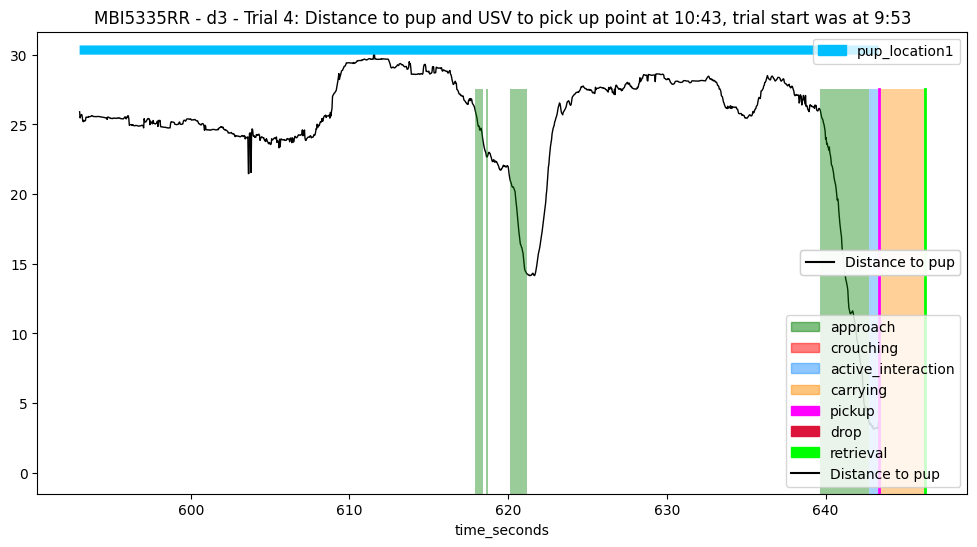

 ==== Example: MBI5335RR - d3 - 5 ==== 
 ==== Example: MBI5335RR - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 673.65
* Success time: 676.146
---> Pick up frame: 20210, Start frame: 19686, End frame: 20284
---> Retrieval frame: 20284; Start frame: 19686; End frame: 20284
---> Final frame: 20284
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20210 * Pickup time:  673.65
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 599
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_to

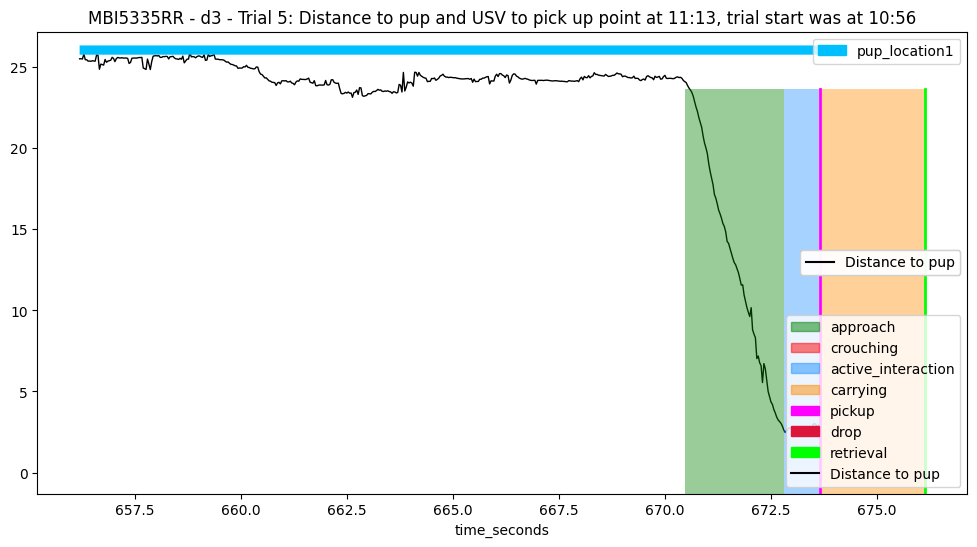

 ==== Example: MBI5335RR - d3 - 6 ==== 
 ==== Example: MBI5335RR - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3627
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        30
distance_head_to_pup         30
head_angle_to_pup_degrees    30
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        36
distance_head_to_pup         36
head_angle_to_pu

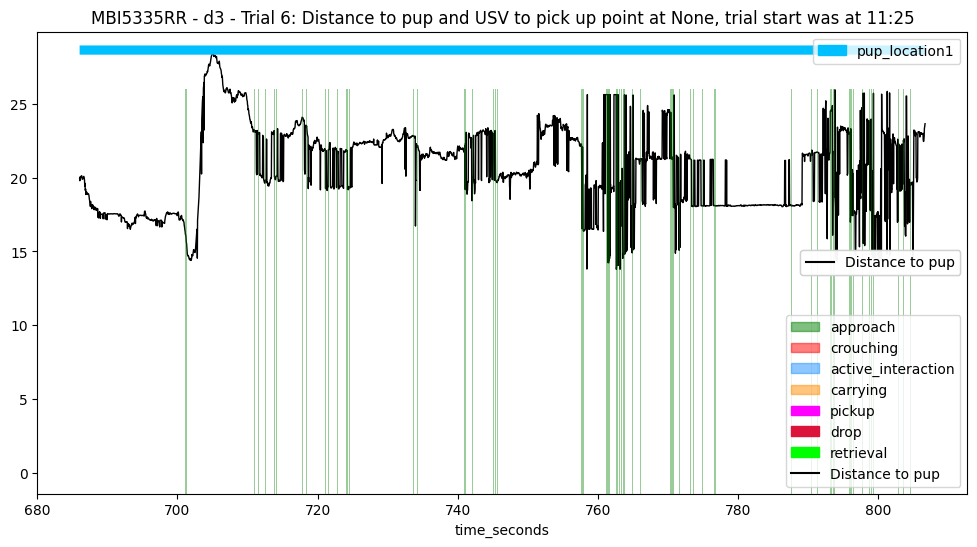

 ==== Example: MBI5335RR - d3 - 7 ==== 
 ==== Example: MBI5335RR - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 884.21
* Success time: 886.082
---> Pick up frame: 26526, Start frame: 24337, End frame: 26582
---> Retrieval frame: 26582; Start frame: 24337; End frame: 26582
---> Final frame: 26582
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26526 * Pickup time:  884.21
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2246
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        59
distance_head_t

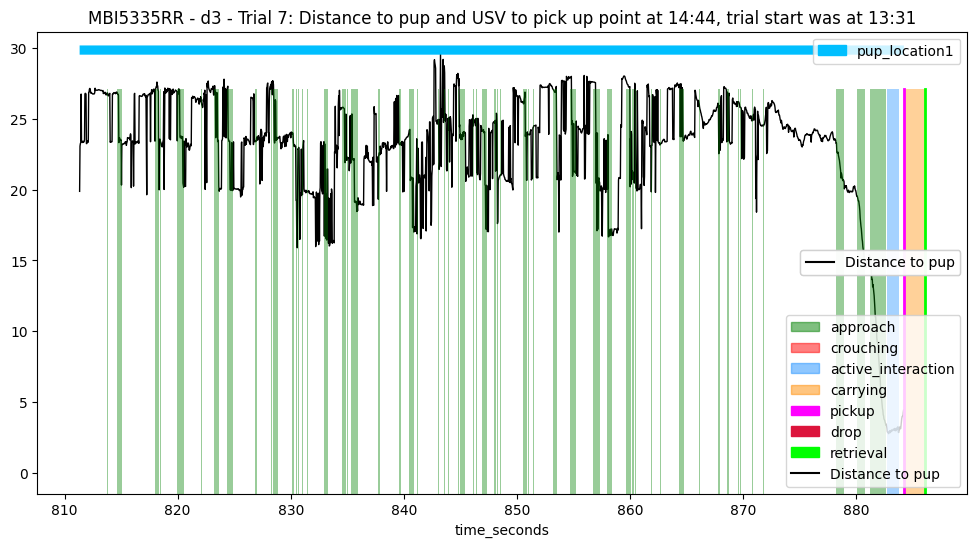

 ==== Example: MBI5335RR - d3 - 8 ==== 
 ==== Example: MBI5335RR - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3875
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        16
distance_head_to_pup         16
head_angle_to_pup_degrees    16
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        21
distance_head_to_pup         21
head_angle_to_pu

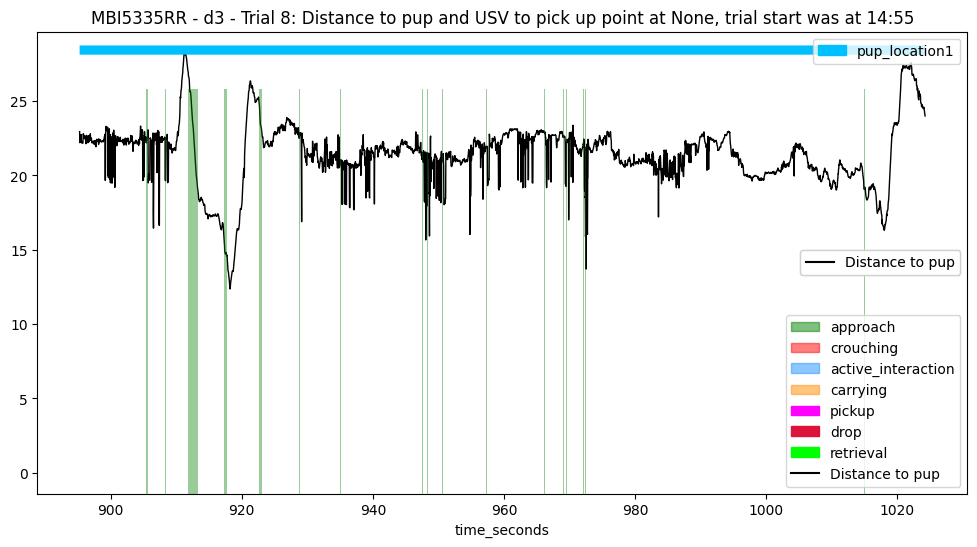

 ==== Example: MBI5335RR - d3 - 9 ==== 
 ==== Example: MBI5335RR - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1036.0
* Success time: 1037.61
---> Pick up frame: 31080, Start frame: 30882, End frame: 31128
---> Retrieval frame: 31128; Start frame: 30882; End frame: 31128
---> Final frame: 31128
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  31080 * Pickup time:  1036.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 247
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        81
distance_head_to

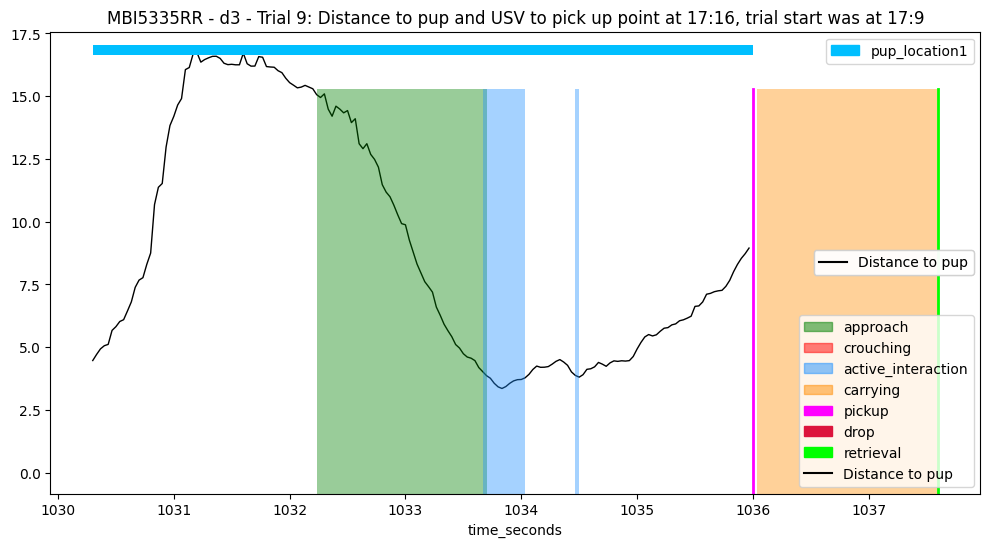

 ==== Example: MBI5335RR - d4 - 1 ==== 
 ==== Example: MBI5335RR - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 563.278
* Success time: 565.67
---> Pick up frame: 16898, Start frame: 16323, End frame: 16970
---> Retrieval frame: 16970; Start frame: 16323; End frame: 16970
---> Final frame: 16970
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16898 * Pickup time:  563.278
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 648
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        34
distance_head_t

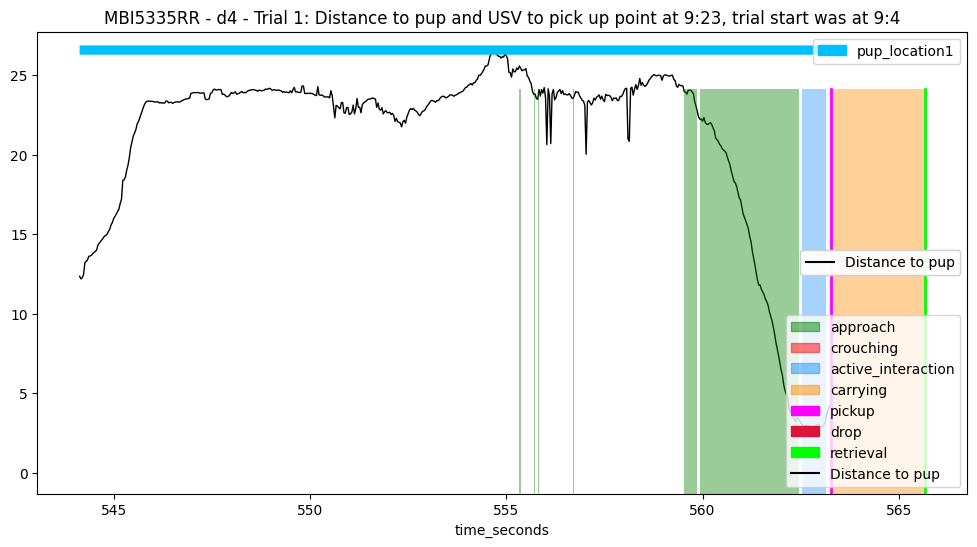

 ==== Example: MBI5335RR - d4 - 2 ==== 
 ==== Example: MBI5335RR - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 582.054
* Success time: 586.446
---> Pick up frame: 17462, Start frame: 17379, End frame: 17593
---> Retrieval frame: 17593; Start frame: 17379; End frame: 17593
---> Final frame: 17593
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17462 * Pickup time:  582.054
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 215
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_

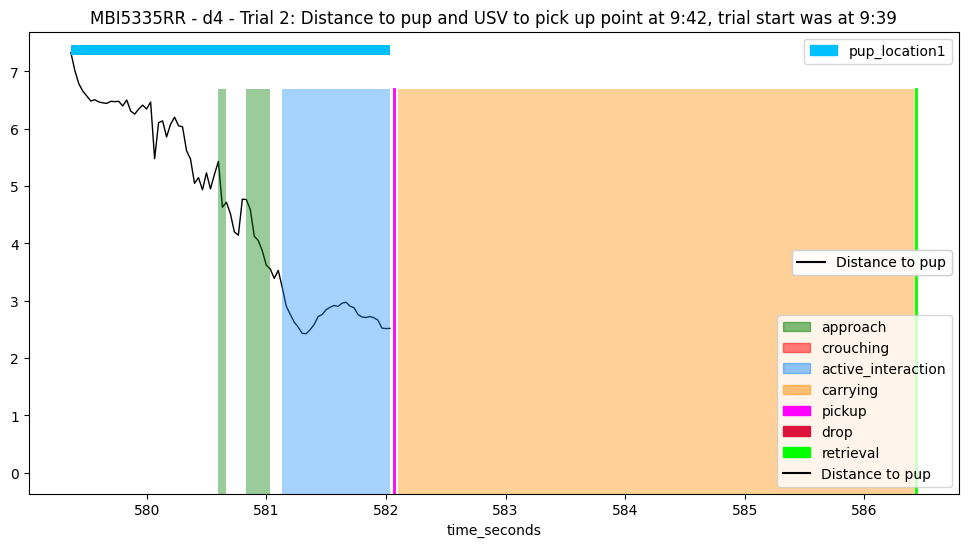

 ==== Example: MBI5335RR - d4 - 3 ==== 
 ==== Example: MBI5335RR - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 611.75
* Success time: 614.382
---> Pick up frame: 18352, Start frame: 17862, End frame: 18431
---> Retrieval frame: 18431; Start frame: 17862; End frame: 18431
---> Final frame: 18431
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18352 * Pickup time:  611.75
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 570
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        61
distance_head_to

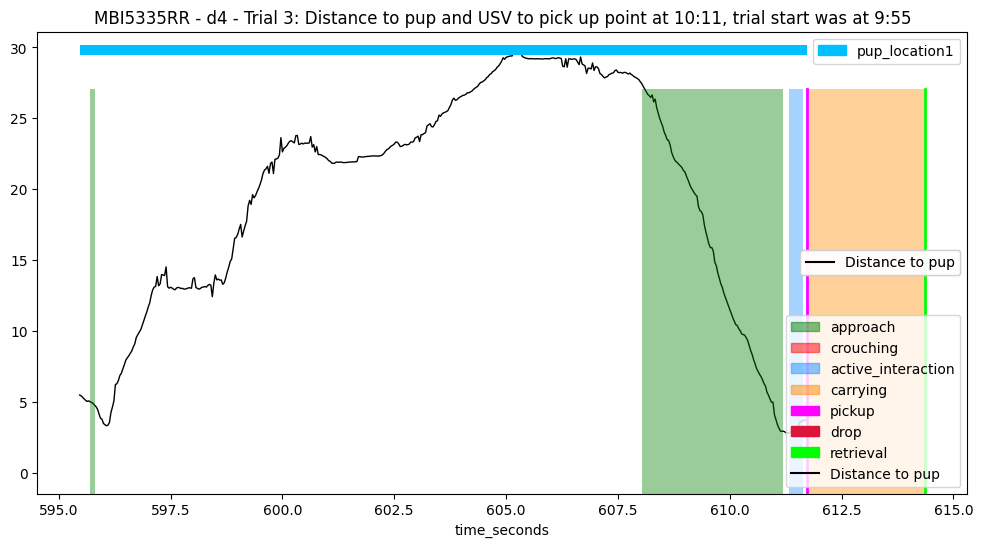

 ==== Example: MBI5335RR - d4 - 4 ==== 
 ==== Example: MBI5335RR - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 670.278
* Success time: 673.087
---> Pick up frame: 20108, Start frame: 18738, End frame: 20192
---> Retrieval frame: 20193; Start frame: 18738; End frame: 20192
---> Final frame: 20192
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20108 * Pickup time:  670.278
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1455
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head

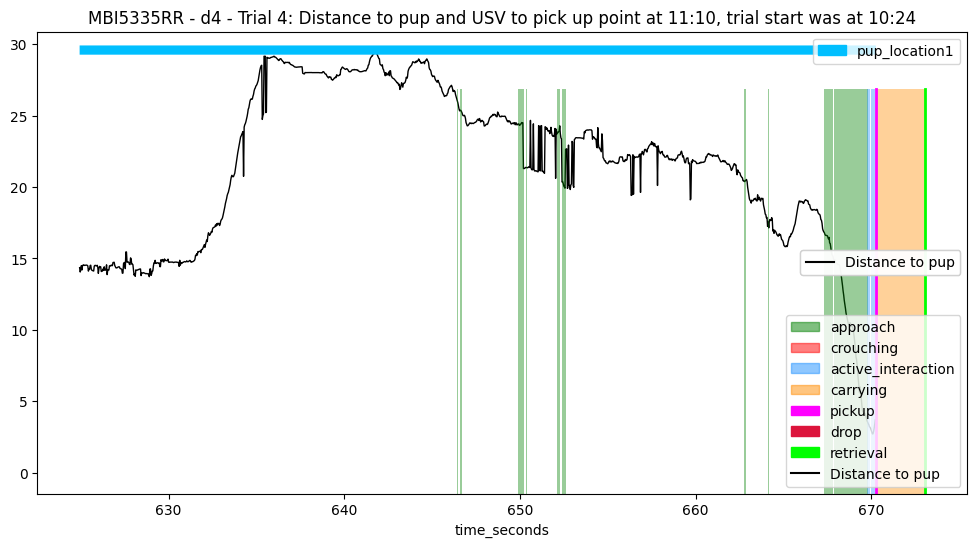

 ==== Example: MBI5335RR - d4 - 5 ==== 
 ==== Example: MBI5335RR - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 715.39
* Success time: 722.18
---> Pick up frame: 21462, Start frame: 20512, End frame: 21665
---> Retrieval frame: 21665; Start frame: 20512; End frame: 21665
---> Final frame: 21665
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  21462 * Pickup time:  715.39
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1154
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup

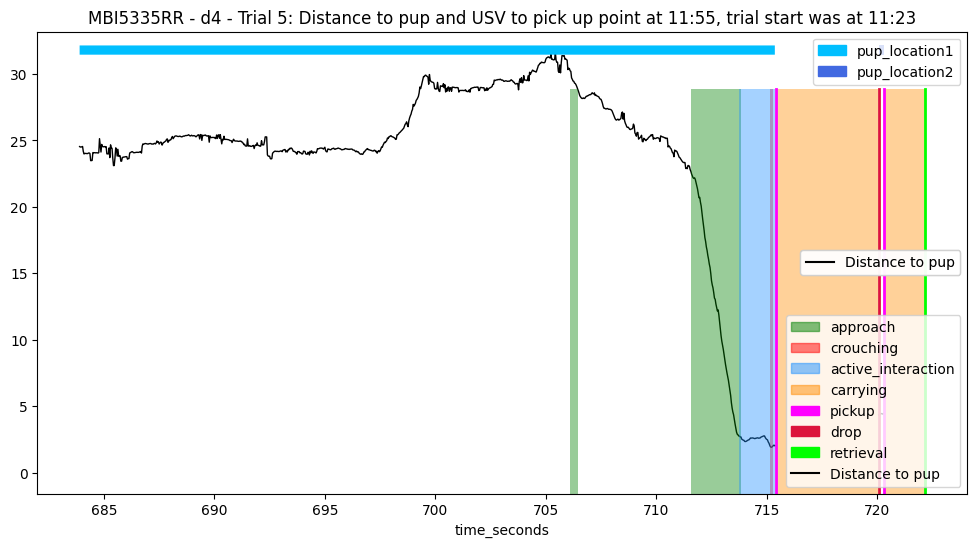

 ==== Example: MBI5335RR - d4 - 6 ==== 
 ==== Example: MBI5335RR - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 775.398
* Success time: 778.478
---> Pick up frame: 23262, Start frame: 22337, End frame: 23354
---> Retrieval frame: 23354; Start frame: 22337; End frame: 23354
---> Final frame: 23354
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  23262 * Pickup time:  775.398
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1018
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annot

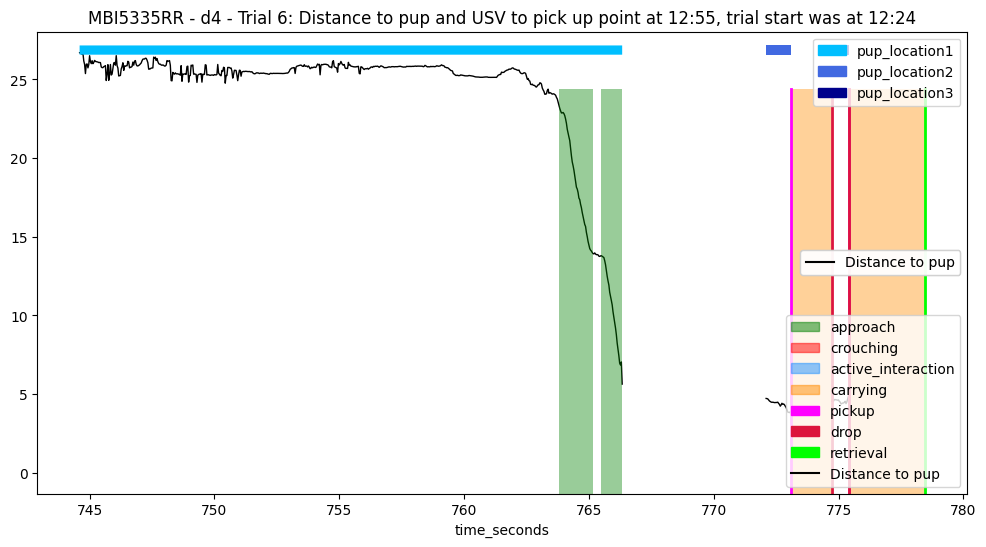

 ==== Example: MBI5335RR - d4 - 7 ==== 
 ==== Example: MBI5335RR - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 833.078
* Success time: 839.094
---> Pick up frame: 24992, Start frame: 23622, End frame: 25172
---> Retrieval frame: 25173; Start frame: 23622; End frame: 25172
---> Final frame: 25172
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24992 * Pickup time:  833.078
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1551
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        18
distance_head

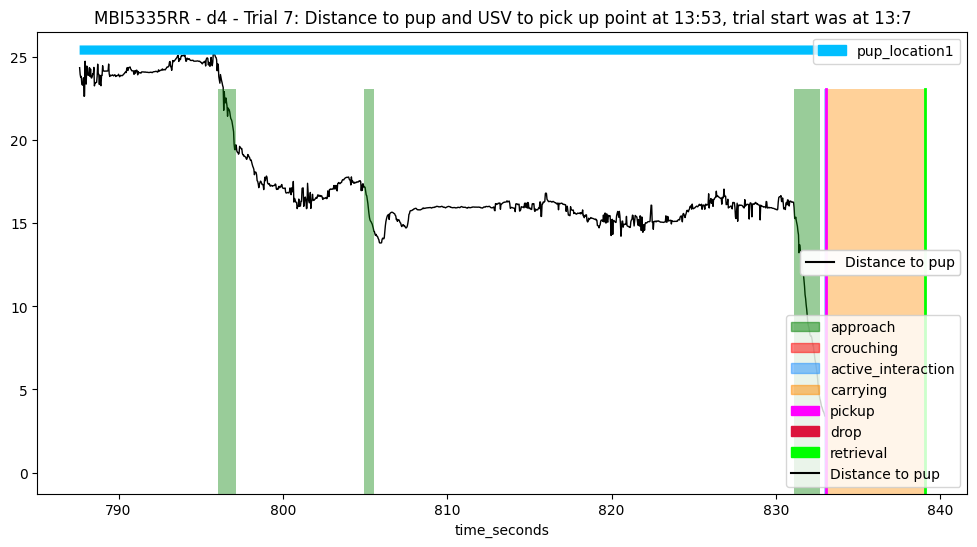

 ==== Example: MBI5335RR - d4 - 8 ==== 
 ==== Example: MBI5335RR - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 870.774
* Success time: None
---> Pick up frame: 26123, Start frame: 25560, End frame: 30345
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  26123 * Pickup time:  870.774
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4786
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        51
distance_head_to_pup         51
head_angle_to_pup_degrees    51
dtype: int64
--

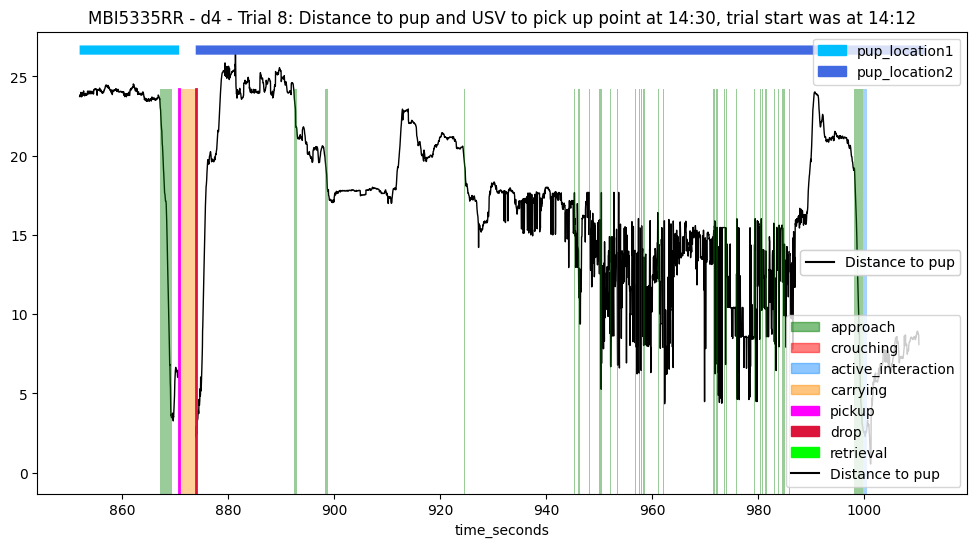

 ==== Example: MBI5335RR - d4 - 9 ==== 
 ==== Example: MBI5335RR - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1028.166
* Success time: 1032.742
---> Pick up frame: 30845, Start frame: 30567, End frame: 30982
---> Retrieval frame: 30982; Start frame: 30567; End frame: 30982
---> Final frame: 30982
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  30845 * Pickup time:  1028.166
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 416
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_he

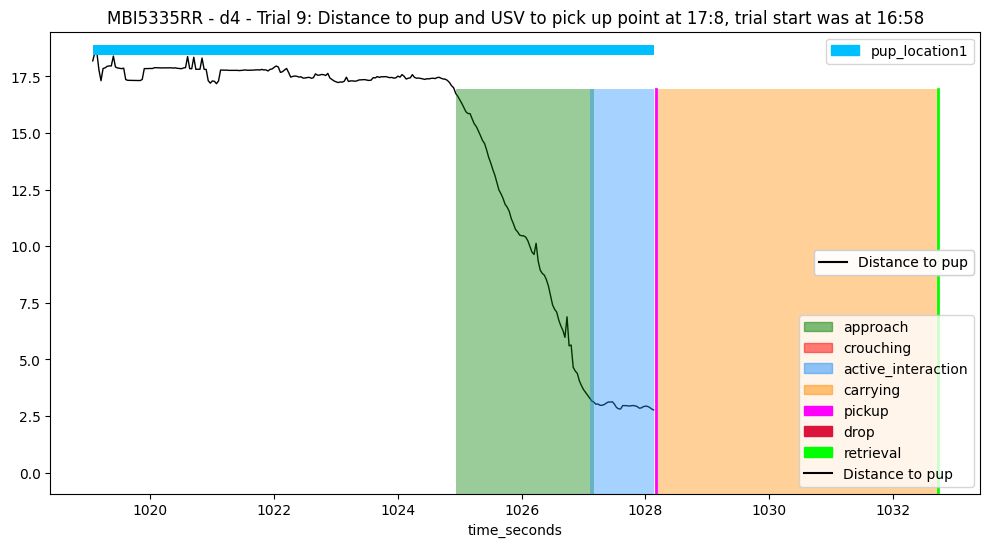

 ==== Example: MBI5335RR - d5 - 1 ==== 
 ==== Example: MBI5335RR - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 403.415
* Success time: 406.871
---> Pick up frame: 12102, Start frame: 11538, End frame: 12206
---> Retrieval frame: 12206; Start frame: 11538; End frame: 12206
---> Final frame: 12206
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12102 * Pickup time:  403.415
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 669
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 12102, instantly drop at 12103
---> Processing last pup location:

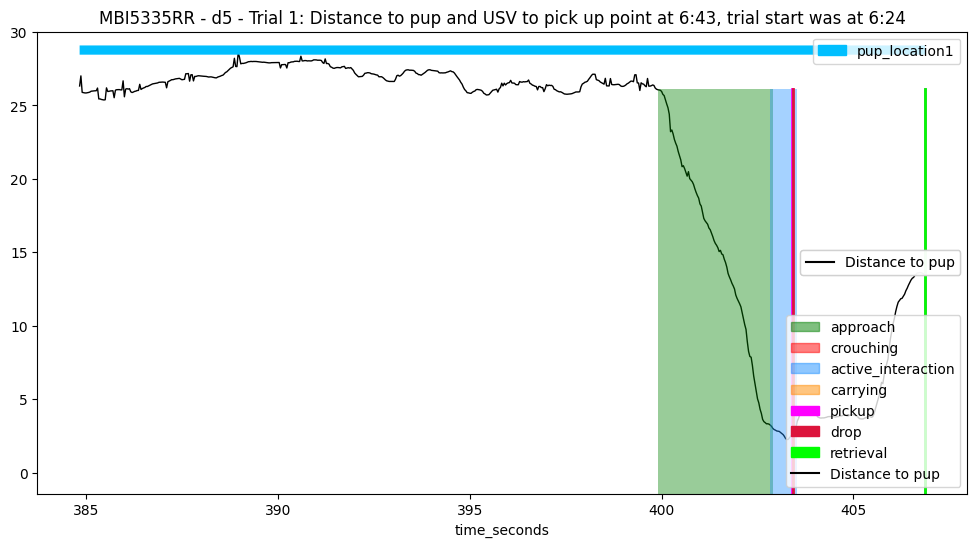

 ==== Example: MBI5335RR - d5 - 2 ==== 
 ==== Example: MBI5335RR - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 446.607
* Success time: 451.735
---> Pick up frame: 13398, Start frame: 12715, End frame: 13552
---> Retrieval frame: 13552; Start frame: 12715; End frame: 13552
---> Final frame: 13552
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13398 * Pickup time:  446.607
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 838
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        95
distance_head_

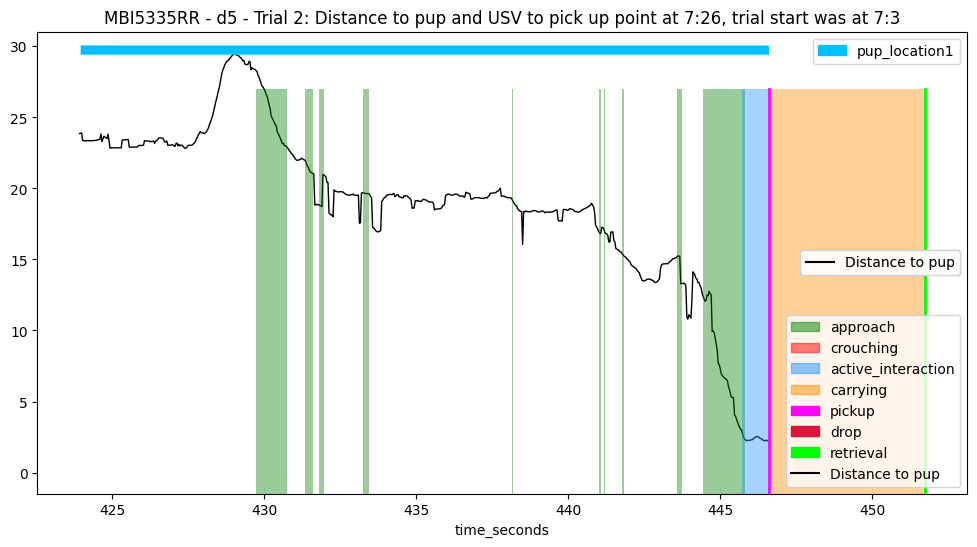

 ==== Example: MBI5335RR - d5 - 3 ==== 
 ==== Example: MBI5335RR - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 488.911
* Success time: 490.975
---> Pick up frame: 14667, Start frame: 13831, End frame: 14729
---> Retrieval frame: 14729; Start frame: 13831; End frame: 14729
---> Final frame: 14729
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14667 * Pickup time:  488.911
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 899
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        20
distance_head_

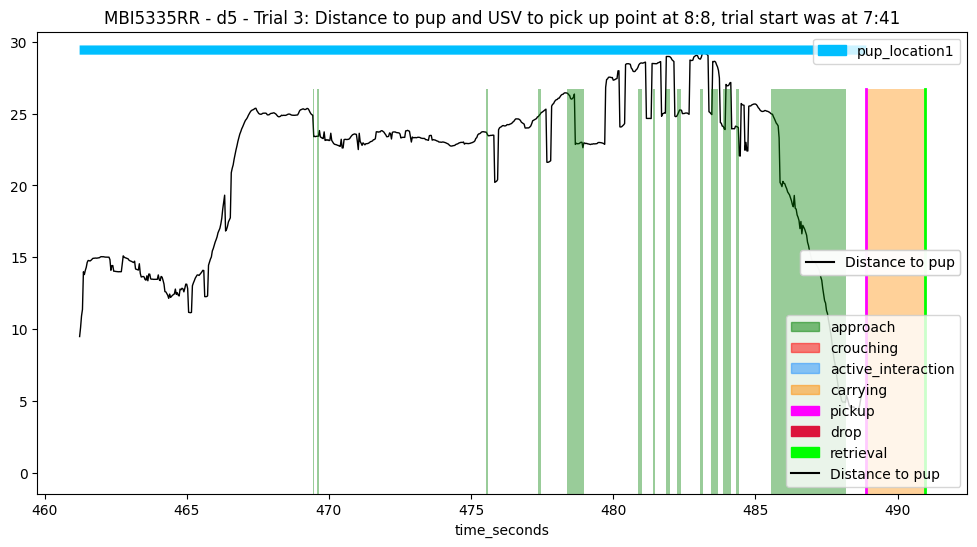

 ==== Example: MBI5335RR - d5 - 4 ==== 
 ==== Example: MBI5335RR - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 511.943
* Success time: 513.879
---> Pick up frame: 15358, Start frame: 15180, End frame: 15416
---> Retrieval frame: 15416; Start frame: 15180; End frame: 15416
---> Final frame: 15416
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15358 * Pickup time:  511.943
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 237
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        20
distance_head_

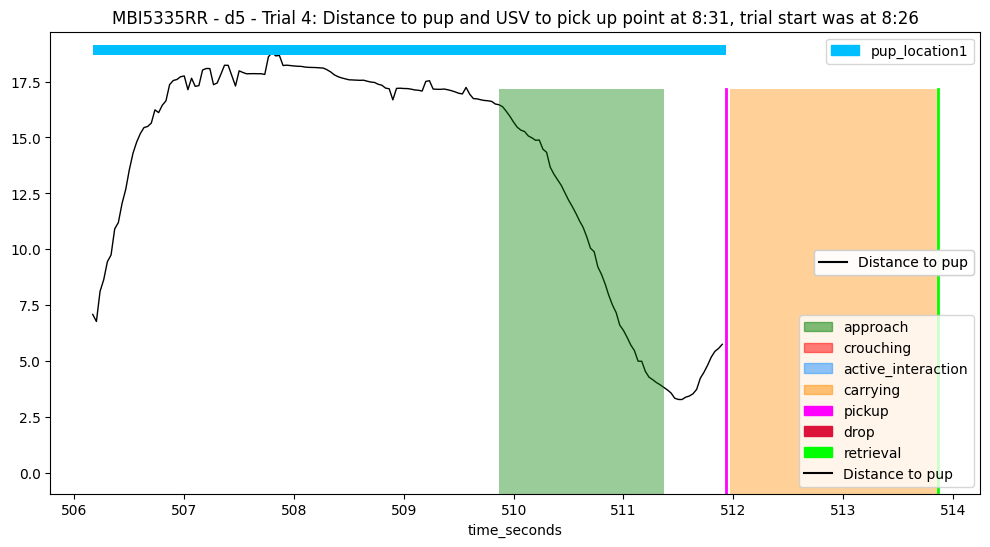

 ==== Example: MBI5335RR - d5 - 5 ==== 
 ==== Example: MBI5335RR - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 547.903
* Success time: 551.807
---> Pick up frame: 16437, Start frame: 15737, End frame: 16554
---> Retrieval frame: 16554; Start frame: 15737; End frame: 16554
---> Final frame: 16554
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16437 * Pickup time:  547.903
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 818
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_

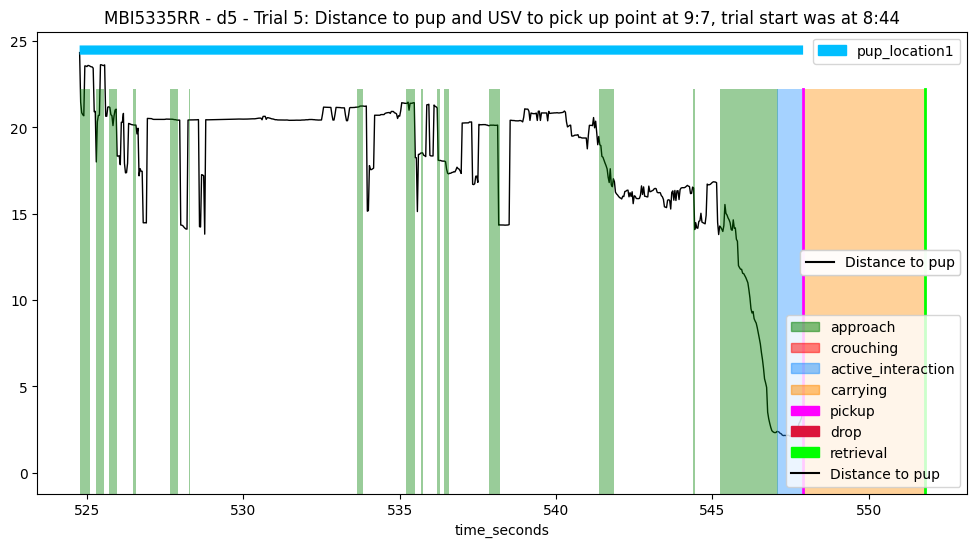

 ==== Example: MBI5335RR - d5 - 6 ==== 
 ==== Example: MBI5335RR - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 579.687
* Success time: 582.456
---> Pick up frame: 17391, Start frame: 16924, End frame: 17473
---> Retrieval frame: 17474; Start frame: 16924; End frame: 17473
---> Final frame: 17473
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17391 * Pickup time:  579.687
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 550
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        33
distance_head_

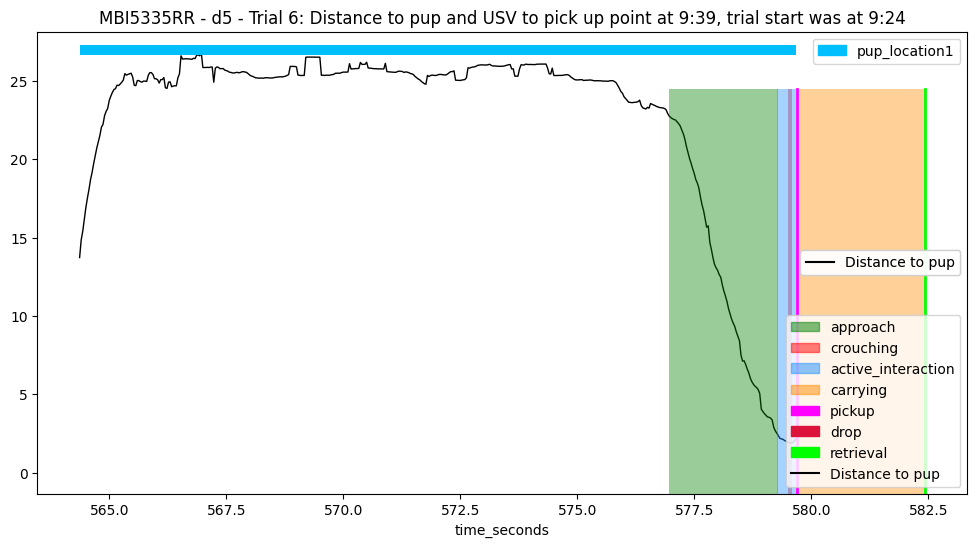

 ==== Example: MBI5335RR - d5 - 7 ==== 
 ==== Example: MBI5335RR - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 597.223
* Success time: 599.456
---> Pick up frame: 17917, Start frame: 17852, End frame: 17983
---> Retrieval frame: 17984; Start frame: 17852; End frame: 17983
---> Final frame: 17983
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17917 * Pickup time:  597.223
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 132
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head_

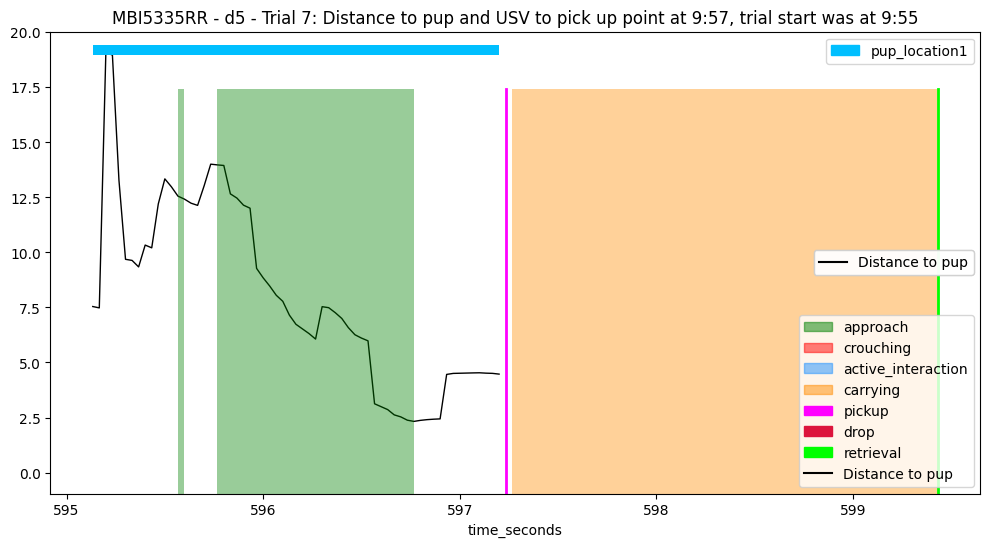

 ==== Example: MBI5335RR - d5 - 8 ==== 
 ==== Example: MBI5335RR - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 630.128
* Success time: 633.544
---> Pick up frame: 18904, Start frame: 18365, End frame: 19006
---> Retrieval frame: 19006; Start frame: 18365; End frame: 19006
---> Final frame: 19006
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18904 * Pickup time:  630.128
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 642
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        15
distance_head_

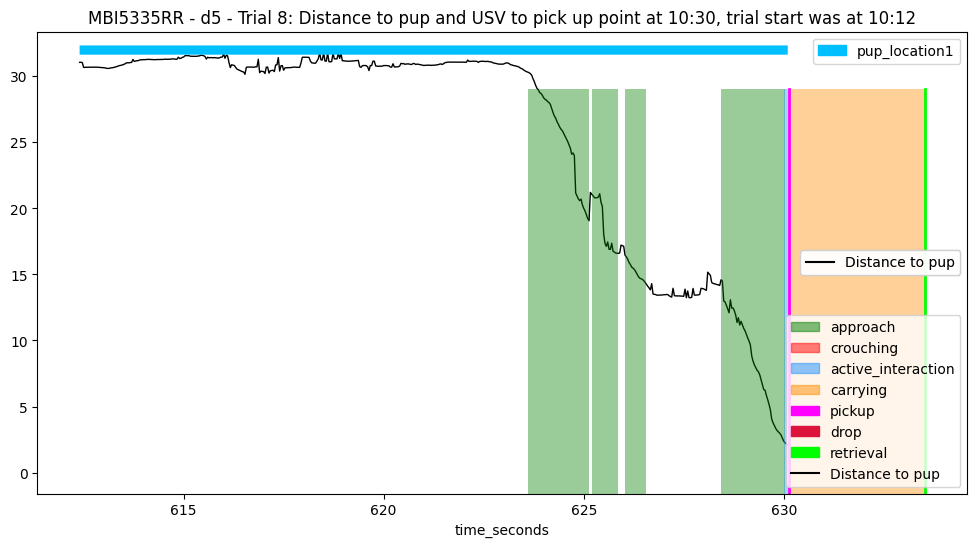

 ==== Example: MBI5335RR - d5 - 9 ==== 
 ==== Example: MBI5335RR - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 676.289
* Success time: 678.207
---> Pick up frame: 20289, Start frame: 19270, End frame: 20346
---> Retrieval frame: 20346; Start frame: 19270; End frame: 20346
---> Final frame: 20346
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  20289 * Pickup time:  676.289
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1077
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  12.35296330602

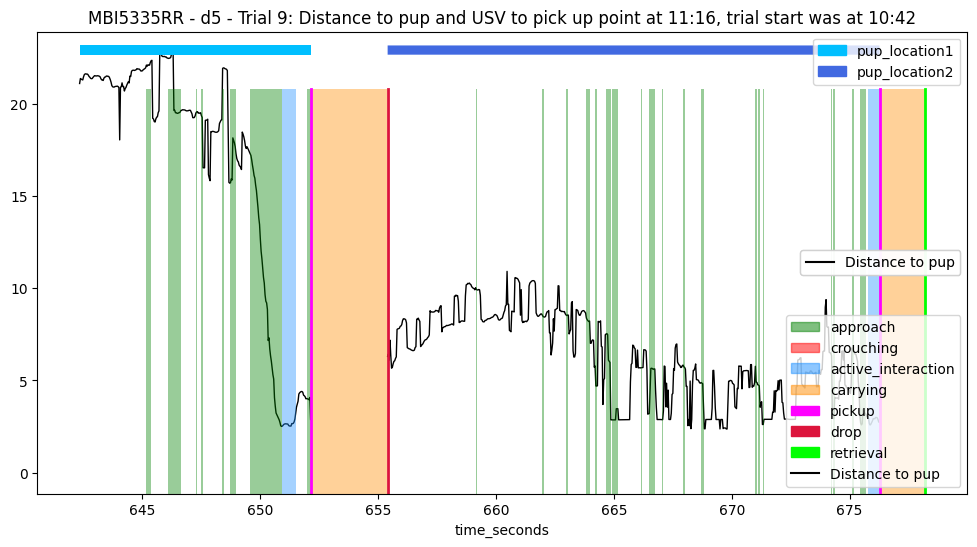

 ==== Example: MBI5335RR - d6 - 1 ==== 
 ==== Example: MBI5335RR - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 430.004
* Success time: 431.956
---> Pick up frame: 12900, Start frame: 12511, End frame: 12958
---> Retrieval frame: 12959; Start frame: 12511; End frame: 12958
---> Final frame: 12958
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12900 * Pickup time:  430.004
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 448
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_

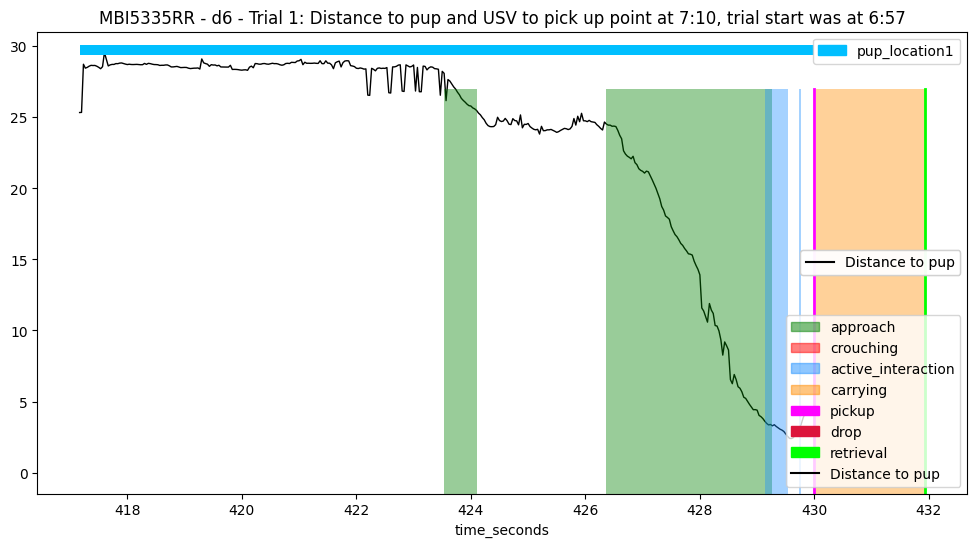

 ==== Example: MBI5335RR - d6 - 2 ==== 
 ==== Example: MBI5335RR - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 458.756
* Success time: 461.748
---> Pick up frame: 13763, Start frame: 13324, End frame: 13852
---> Retrieval frame: 13852; Start frame: 13324; End frame: 13852
---> Final frame: 13852
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13763 * Pickup time:  458.756
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 529
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_head_

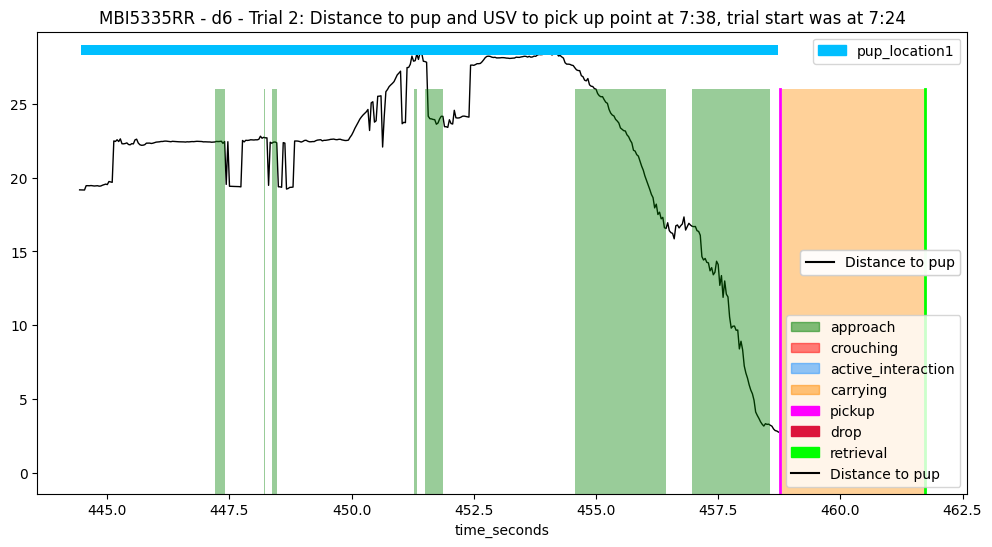

 ==== Example: MBI5335RR - d6 - 3 ==== 
 ==== Example: MBI5335RR - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 476.052
* Success time: 478.1
---> Pick up frame: 14282, Start frame: 14157, End frame: 14343
---> Retrieval frame: 14343; Start frame: 14157; End frame: 14343
---> Final frame: 14343
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14282 * Pickup time:  476.052
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 187
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to

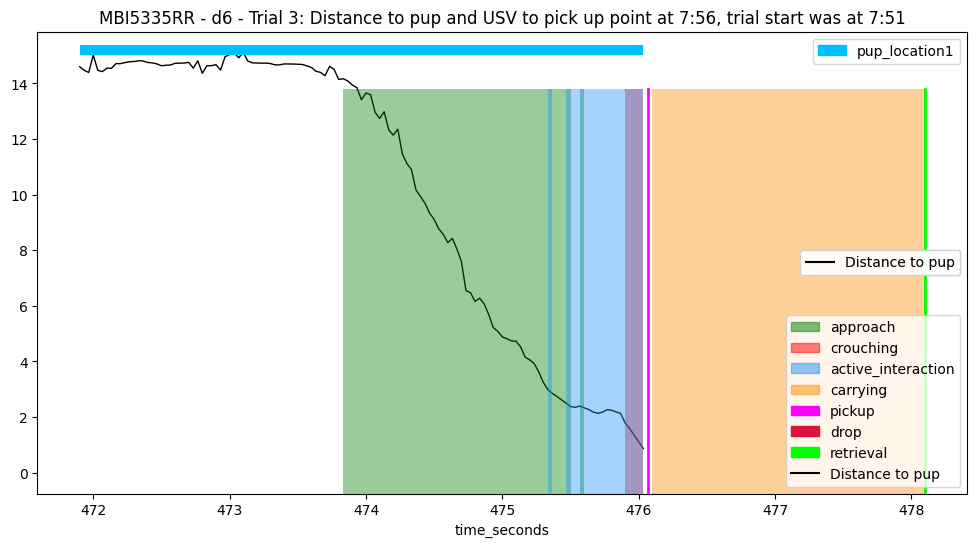

 ==== Example: MBI5335RR - d6 - 4 ==== 
 ==== Example: MBI5335RR - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4369
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        53
distance_head_to_pup         53
head_angle_to_pup_degrees    53
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        53
distance_head_to_pup         53
head_angle_to_pu

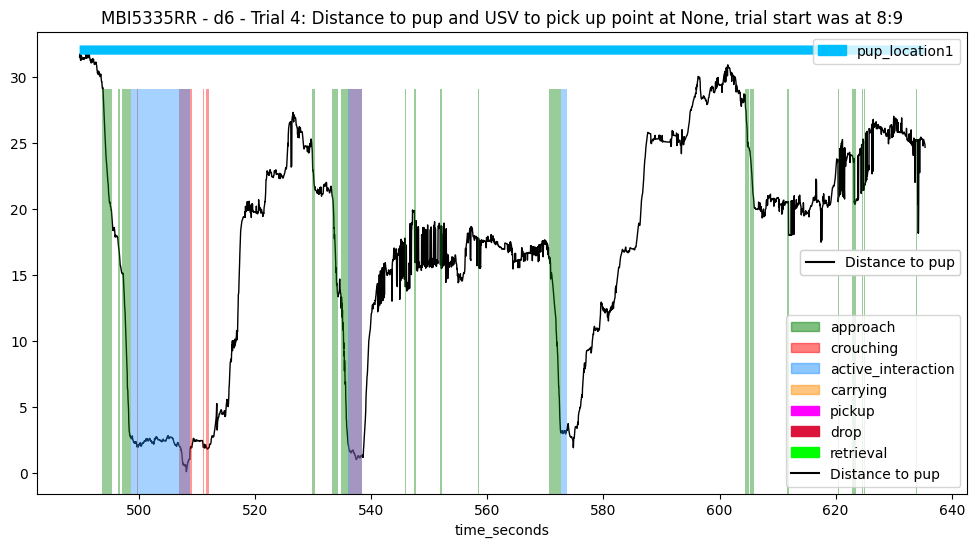

 ==== Example: MBI5335RR - d6 - 5 ==== 
 ==== Example: MBI5335RR - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 646.732
* Success time: 649.676
---> Pick up frame: 19402, Start frame: 19300, End frame: 19490
---> Retrieval frame: 19490; Start frame: 19300; End frame: 19490
---> Final frame: 19490
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19402 * Pickup time:  646.732
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 191
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_t

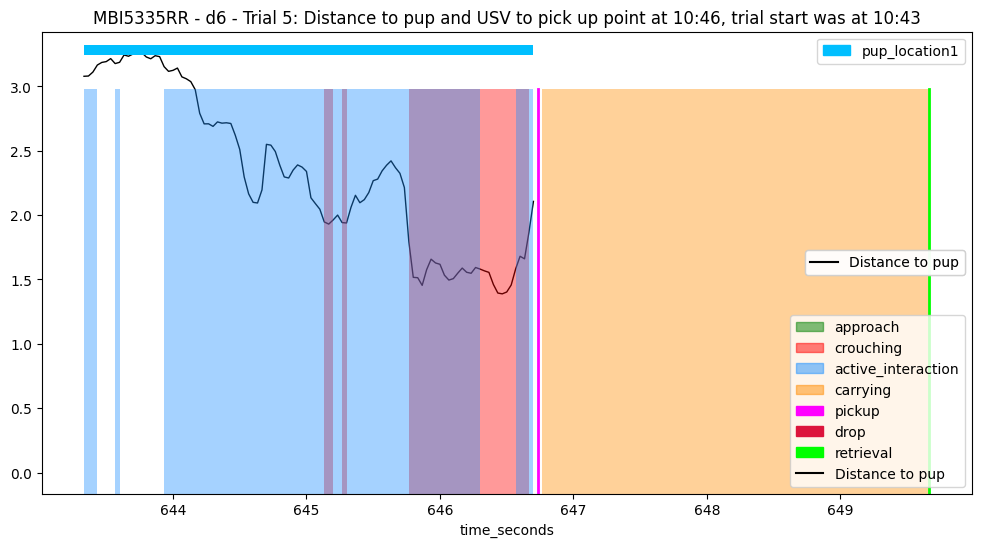

 ==== Example: MBI5335RR - d6 - 6 ==== 
 ==== Example: MBI5335RR - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 681.3
* Success time: 684.228
---> Pick up frame: 20439, Start frame: 19861, End frame: 20526
---> Retrieval frame: 20527; Start frame: 19861; End frame: 20526
---> Final frame: 20526
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20439 * Pickup time:  681.3
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 666
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        15
distance_head_to_p

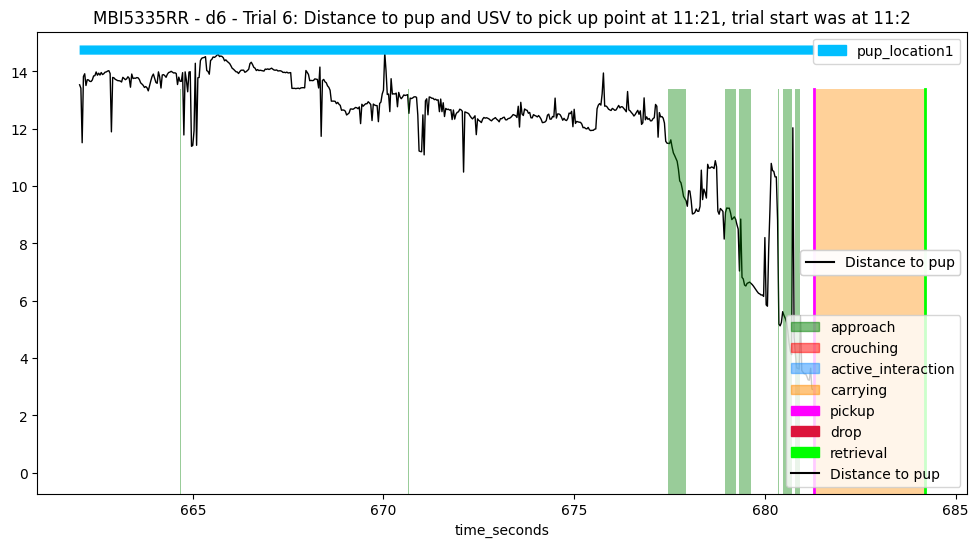

 ==== Example: MBI5335RR - d6 - 7 ==== 
 ==== Example: MBI5335RR - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 728.893
* Success time: 731.725
---> Pick up frame: 21867, Start frame: 21000, End frame: 21951
---> Retrieval frame: 21952; Start frame: 21000; End frame: 21951
---> Final frame: 21951
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21867 * Pickup time:  728.893
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 952
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        15
distance_head_

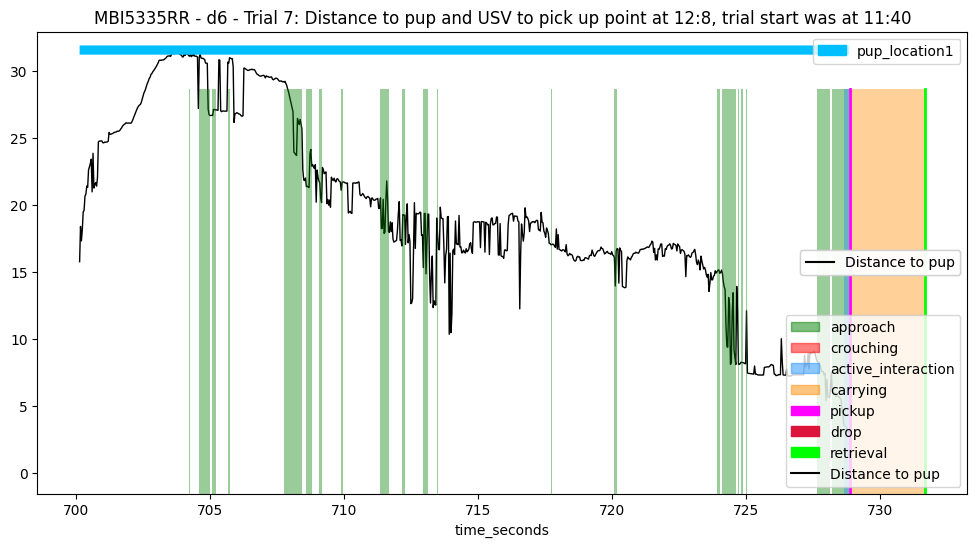

 ==== Example: MBI5335RR - d6 - 8 ==== 
 ==== Example: MBI5335RR - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 792.18
* Success time: 795.404
---> Pick up frame: 23765, Start frame: 22265, End frame: 23862
---> Retrieval frame: 23862; Start frame: 22265; End frame: 23862
---> Final frame: 23862
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23765 * Pickup time:  792.18
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1598
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        252
distance_head_

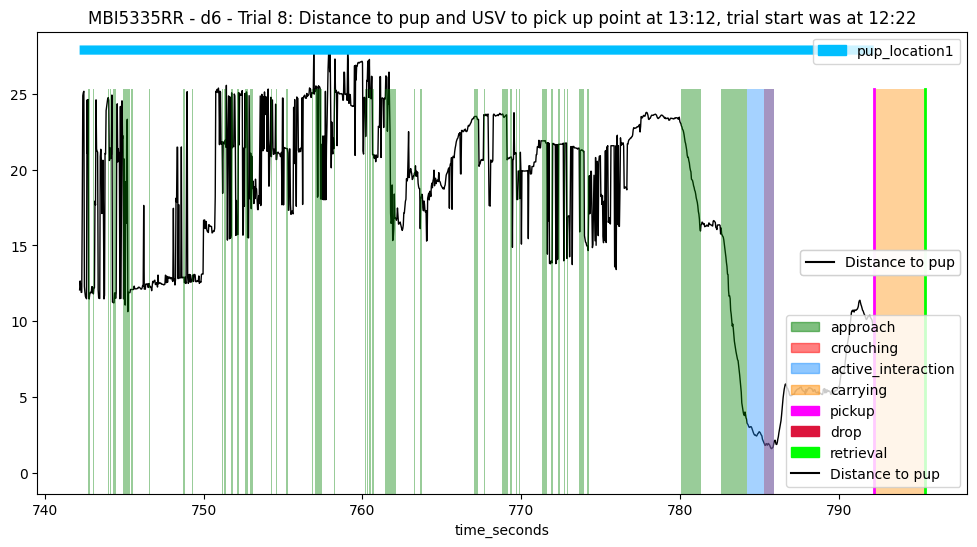

 ==== Example: MBI5335RR - d6 - 9 ==== 
 ==== Example: MBI5335RR - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 812.876
* Success time: None
---> Pick up frame: 24386, Start frame: 24195, End frame: 24450
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24386 * Pickup time:  812.876
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 256
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_to_pup         36
head_angle_to_pup_degrees    36
dtype: int64
---Overall NaN counts:  distance_

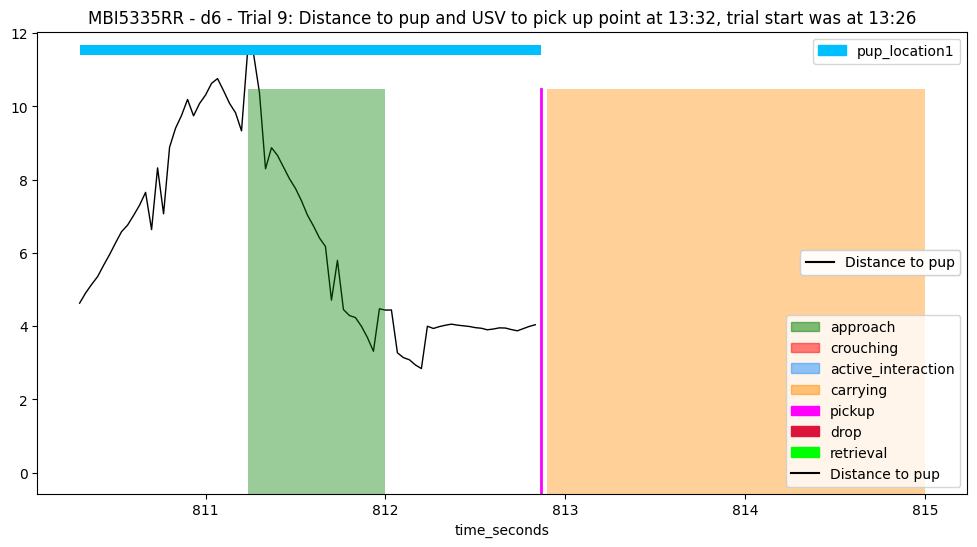

 ==== Example: VBQ0253LL - d1 - 1 ==== 
 ==== Example: VBQ0253LL - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3730
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        45
distance_head_to_pup         45
head_angle_to_pup_degrees    45
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        45
distance_head_to_pup         45
head_angle_to_pu

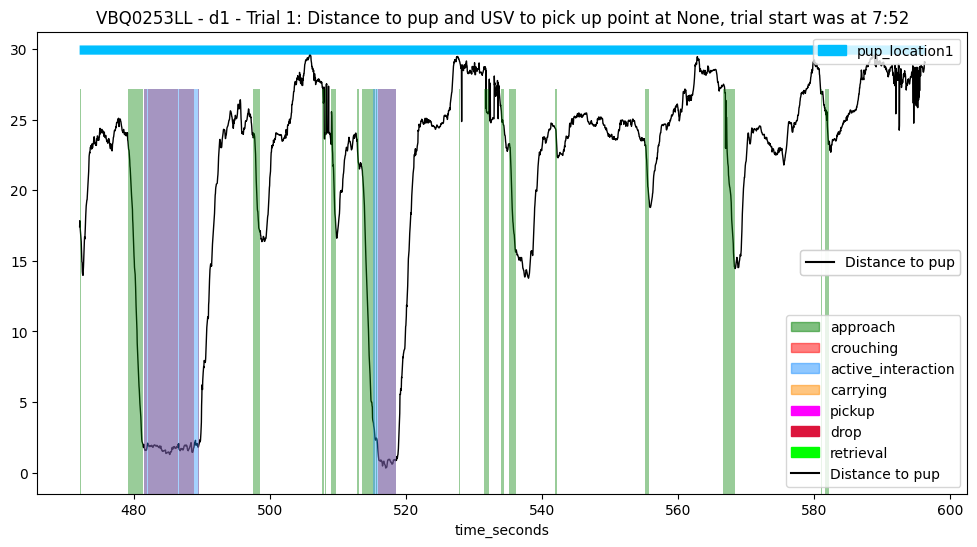

 ==== Example: VBQ0253LL - d1 - 2 ==== 
 ==== Example: VBQ0253LL - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3763
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3763
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 605.7666666666667 to 625.

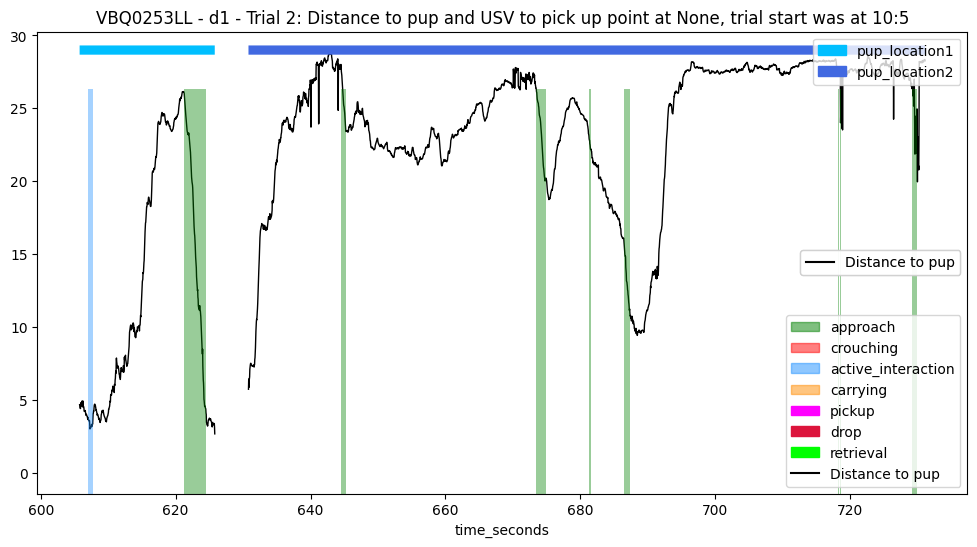

 ==== Example: VBQ0253LL - d1 - 3 ==== 
 ==== Example: VBQ0253LL - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3929
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pup_degrees    43
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pu

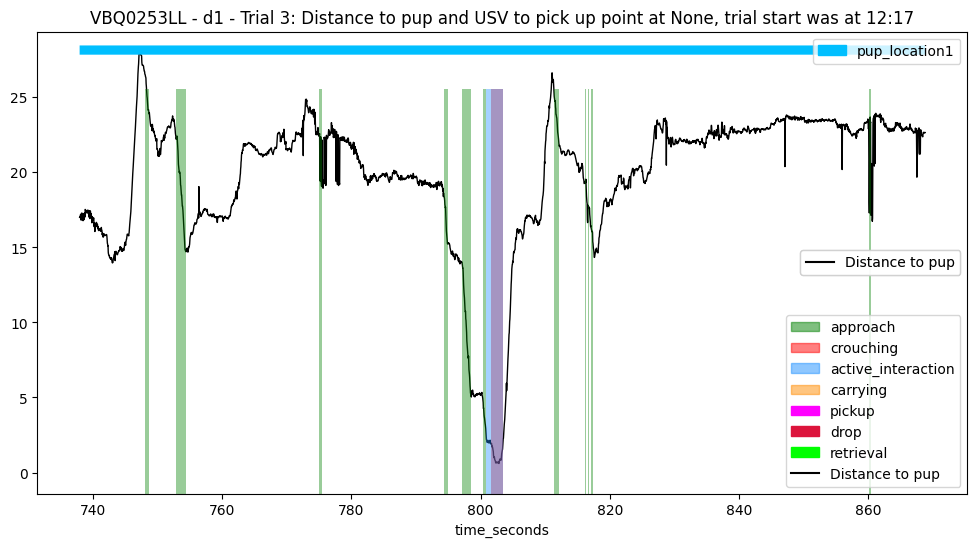

 ==== Example: VBQ0253LL - d1 - 4 ==== 
 ==== Example: VBQ0253LL - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3865
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pup_degrees    43
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pu

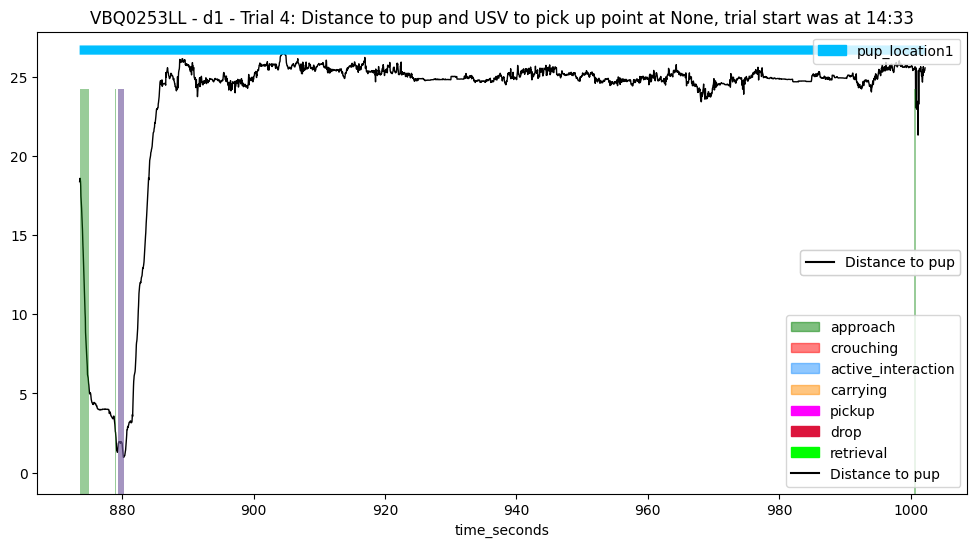

 ==== Example: VBQ0253LL - d1 - 5 ==== 
 ==== Example: VBQ0253LL - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4347
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pu

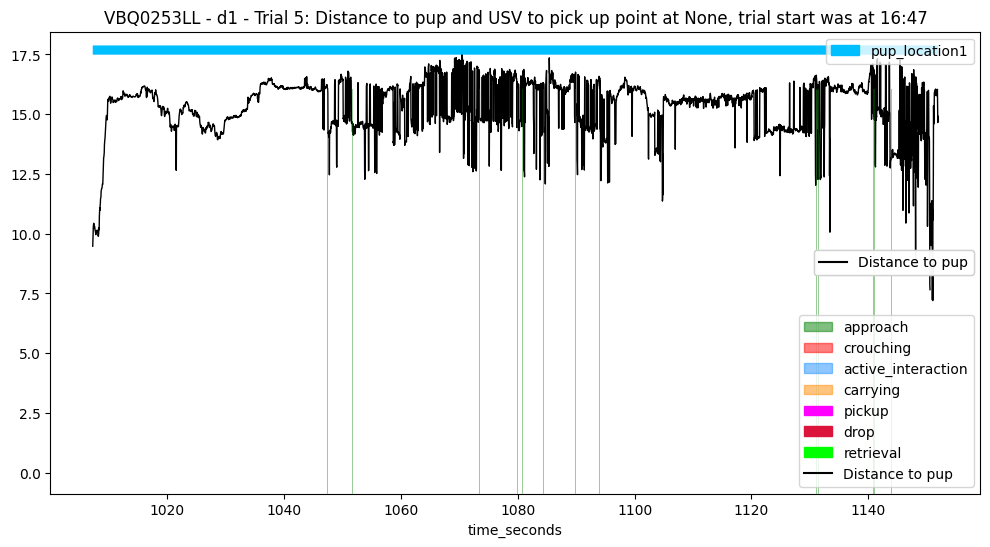

 ==== Example: VBQ0253LL - d1 - 6 ==== 
 ==== Example: VBQ0253LL - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3804
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pup_degrees    37
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pu

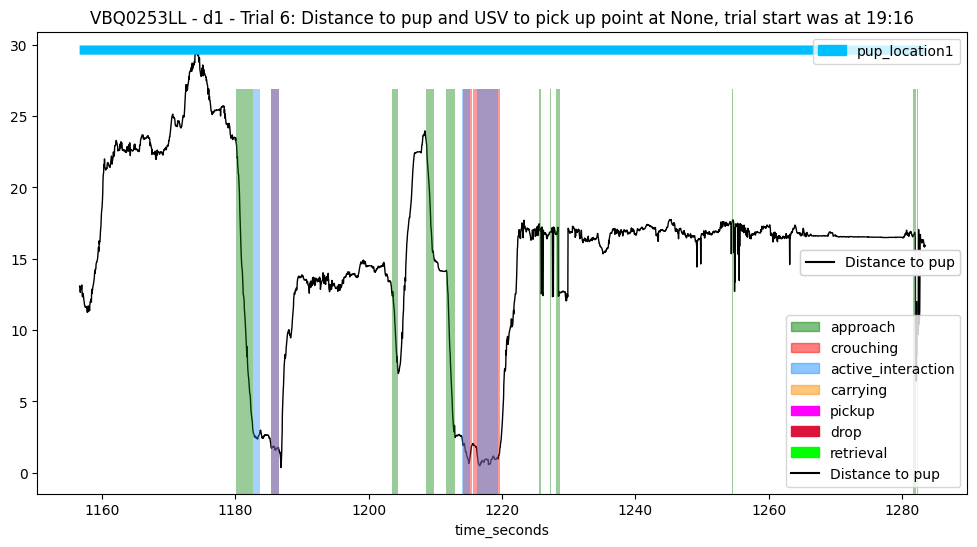

 ==== Example: VBQ0253LL - d1 - 7 ==== 
 ==== Example: VBQ0253LL - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3916
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3916
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 1290.0333333333333 to 129

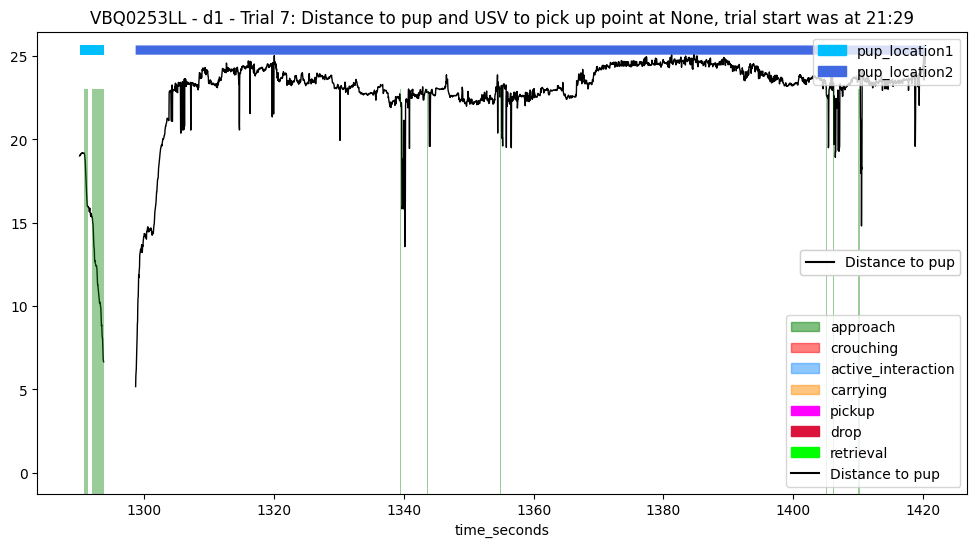

 ==== Example: VBQ0253LL - d1 - 8 ==== 
 ==== Example: VBQ0253LL - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4310
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pup_degrees    50
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pu

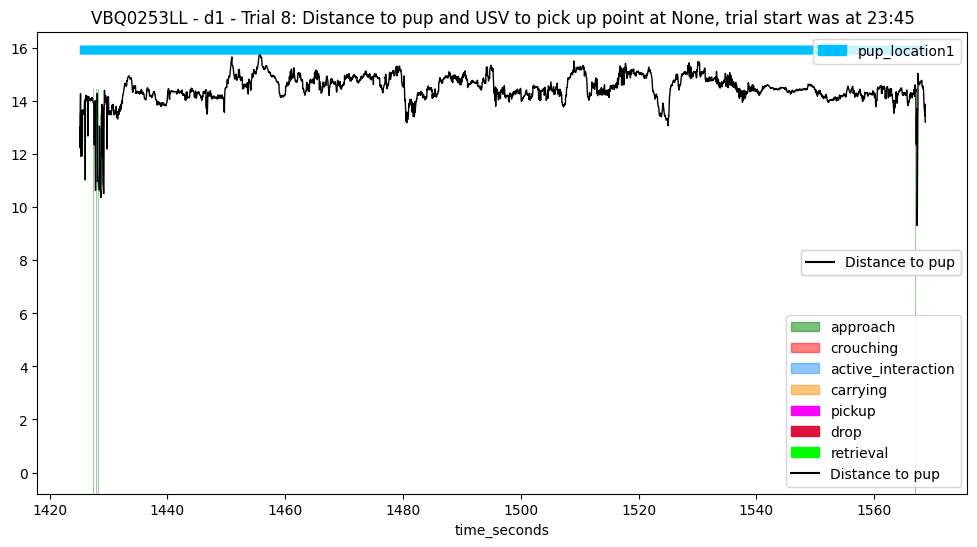

 ==== Example: VBQ0253LL - d1 - 9 ==== 
 ==== Example: VBQ0253LL - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3898
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pup_degrees    48
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        154
distance_head_to_pup         154
head_angle_to_

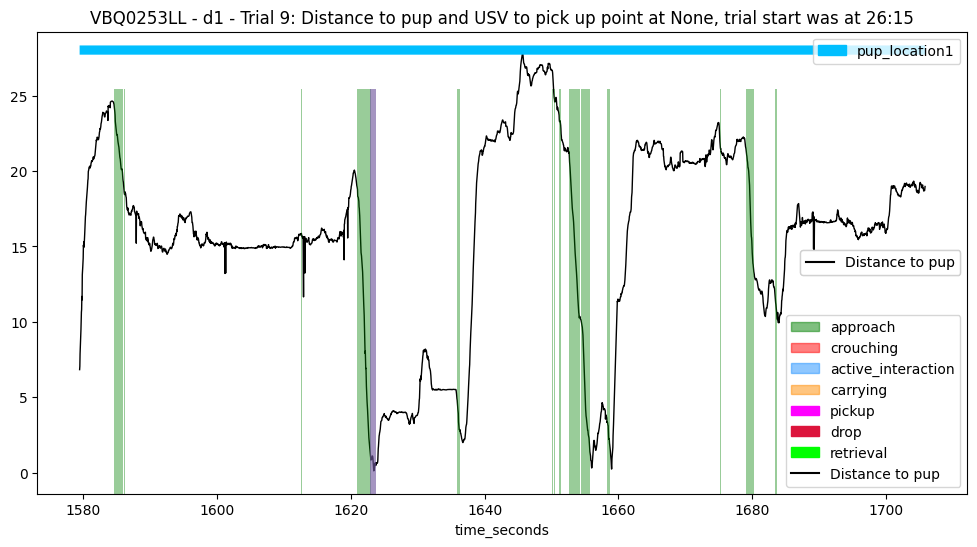

 ==== Example: VBQ0253LL - d2 - 1 ==== 
 ==== Example: VBQ0253LL - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3642
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        41
distance_head_to_pup         41
head_angle_to_pup_degrees    41
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        41
distance_head_to_pup         41
head_angle_to_pu

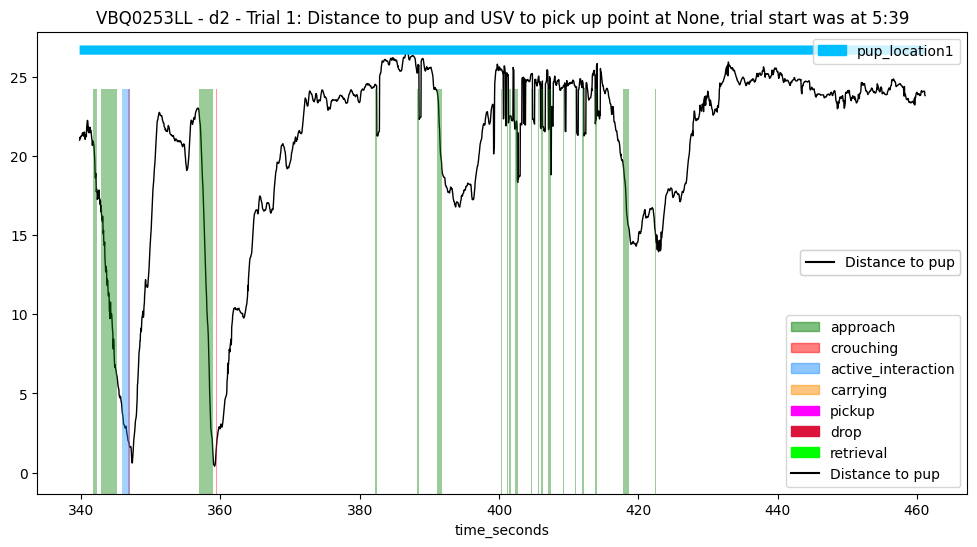

 ==== Example: VBQ0253LL - d2 - 2 ==== 
 ==== Example: VBQ0253LL - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3687
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        63
distance_head_to_pup         63
head_angle_to_pup_degrees    63
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        64
distance_head_to_pup         64
head_angle_to_pu

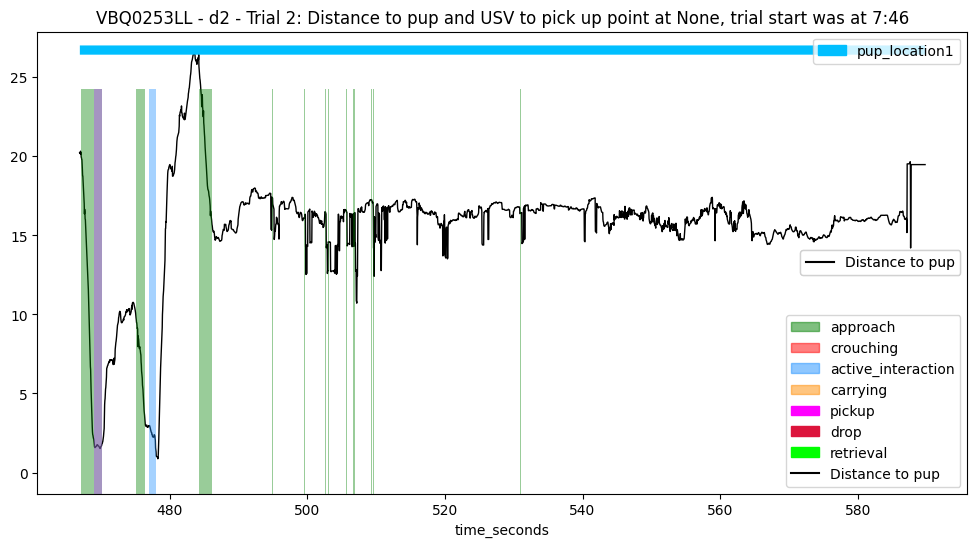

 ==== Example: VBQ0253LL - d2 - 3 ==== 
 ==== Example: VBQ0253LL - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3680
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        46
distance_head_to_pup         46
head_angle_to_pup_degrees    46
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        56
distance_head_to_pup         56
head_angle_to_pu

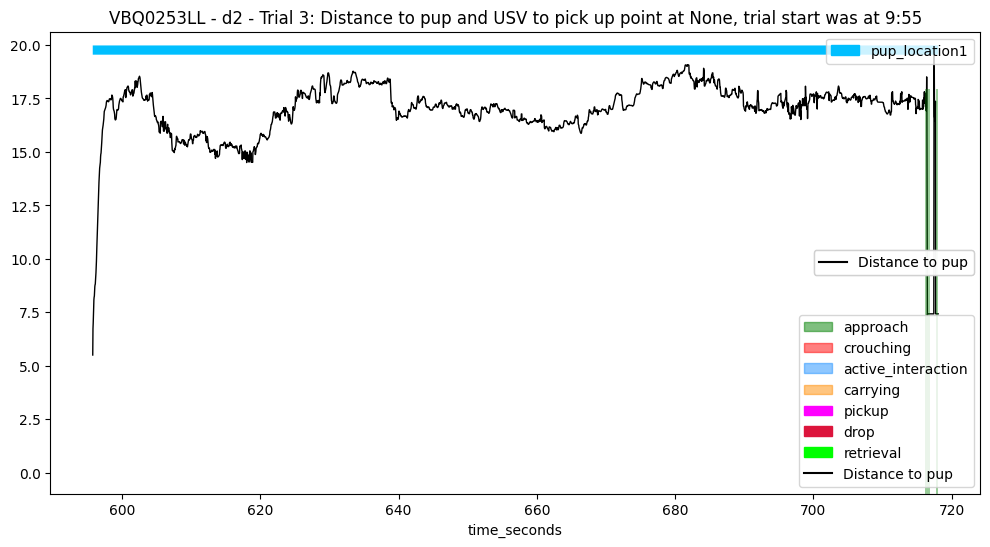

 ==== Example: VBQ0253LL - d2 - 4 ==== 
 ==== Example: VBQ0253LL - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3539
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pup_degrees    43
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        45
distance_head_to_pup         45
head_angle_to_pu

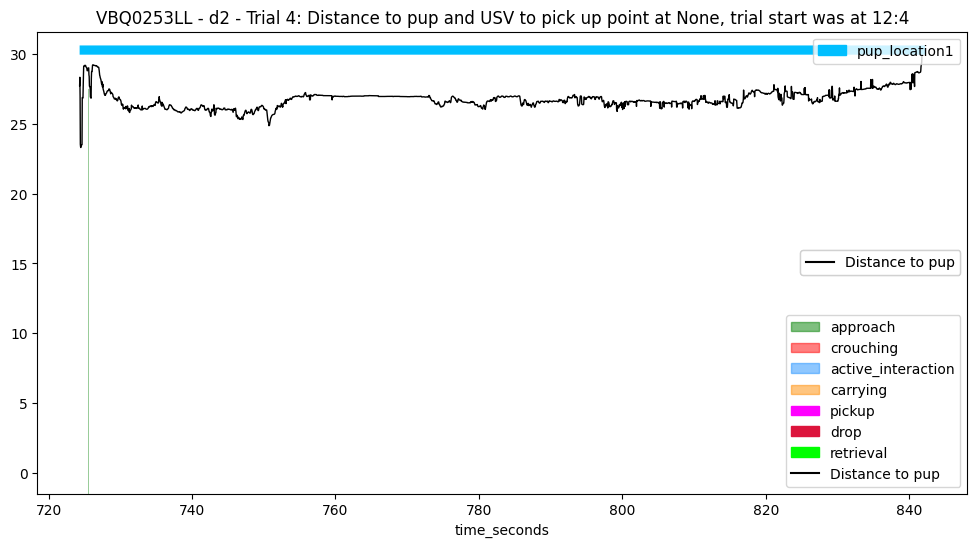

 ==== Example: VBQ0253LL - d2 - 5 ==== 
 ==== Example: VBQ0253LL - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3562
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pup_degrees    47
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        56
distance_head_to_pup         56
head_angle_to_pu

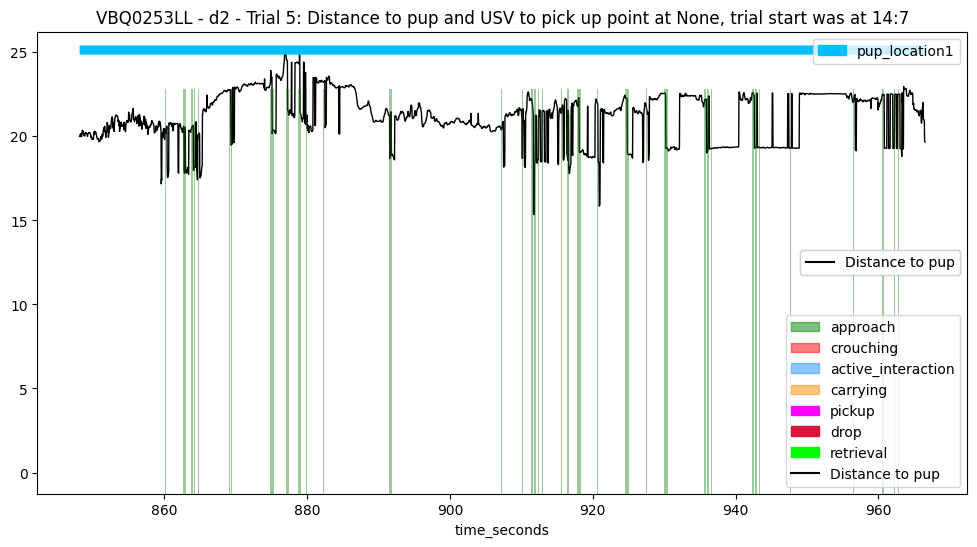

 ==== Example: VBQ0253LL - d2 - 6 ==== 
 ==== Example: VBQ0253LL - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3668
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pup_degrees    48
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pu

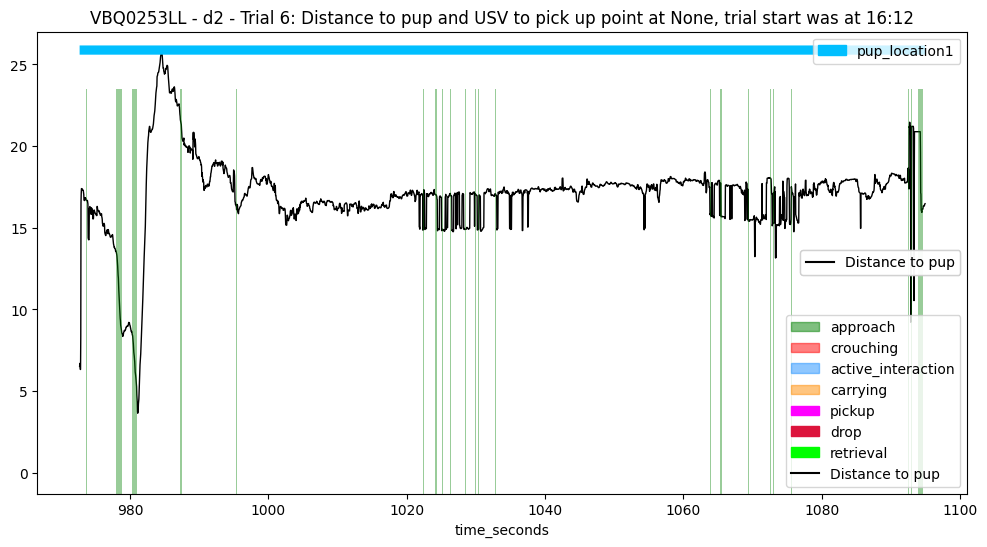

 ==== Example: VBQ0253LL - d2 - 7 ==== 
 ==== Example: VBQ0253LL - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3621
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pup_degrees    52
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pu

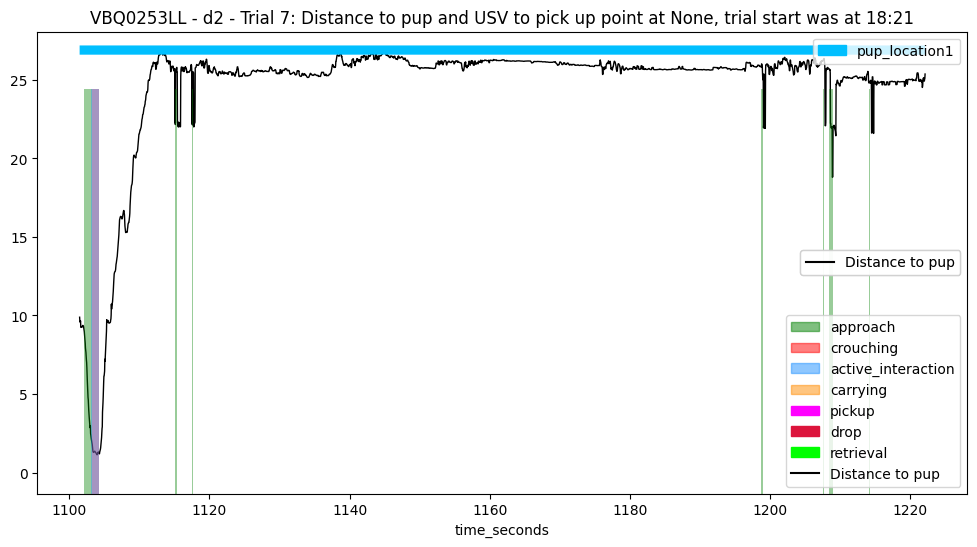

 ==== Example: VBQ0253LL - d2 - 8 ==== 
 ==== Example: VBQ0253LL - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3595
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pup_degrees    48
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pu

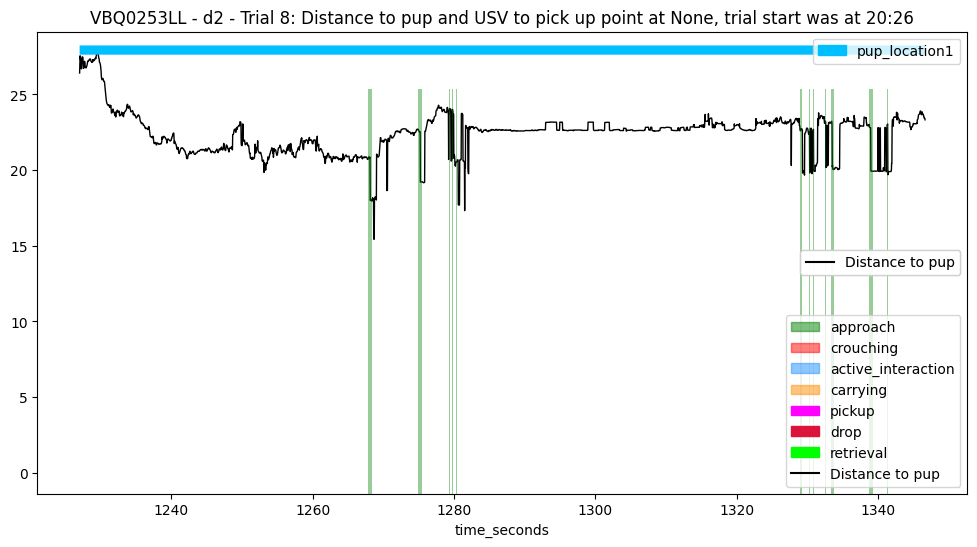

 ==== Example: VBQ0253LL - d2 - 9 ==== 
 ==== Example: VBQ0253LL - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3501
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_head_to_pup         74
head_angle_to_pup_degrees    74
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        81
distance_head_to_pup         81
head_angle_to_pu

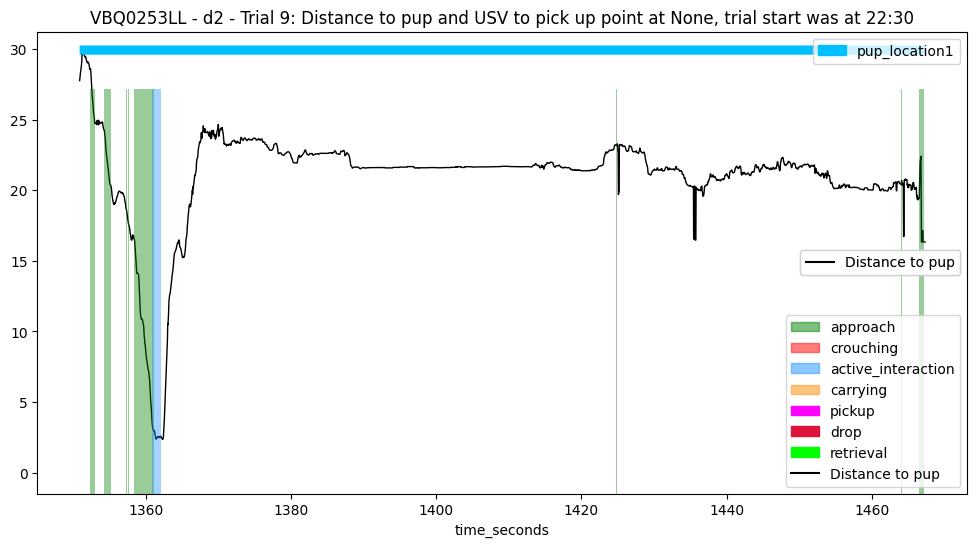

 ==== Example: VBQ0253LL - d3 - 1 ==== 
 ==== Example: VBQ0253LL - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3825
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pu

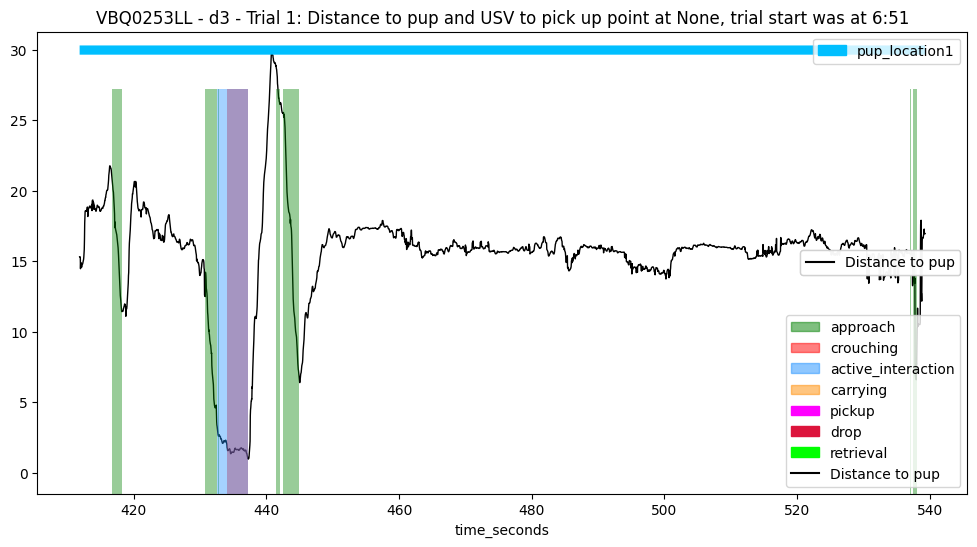

 ==== Example: VBQ0253LL - d3 - 2 ==== 
 ==== Example: VBQ0253LL - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 574.1
* Success time: 577.19
---> Pick up frame: 17223, Start frame: 16279, End frame: 17315
---> Retrieval frame: 17316; Start frame: 16279; End frame: 17315
---> Final frame: 17315
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17223 * Pickup time:  574.1
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1037
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        193
distance_head_to_

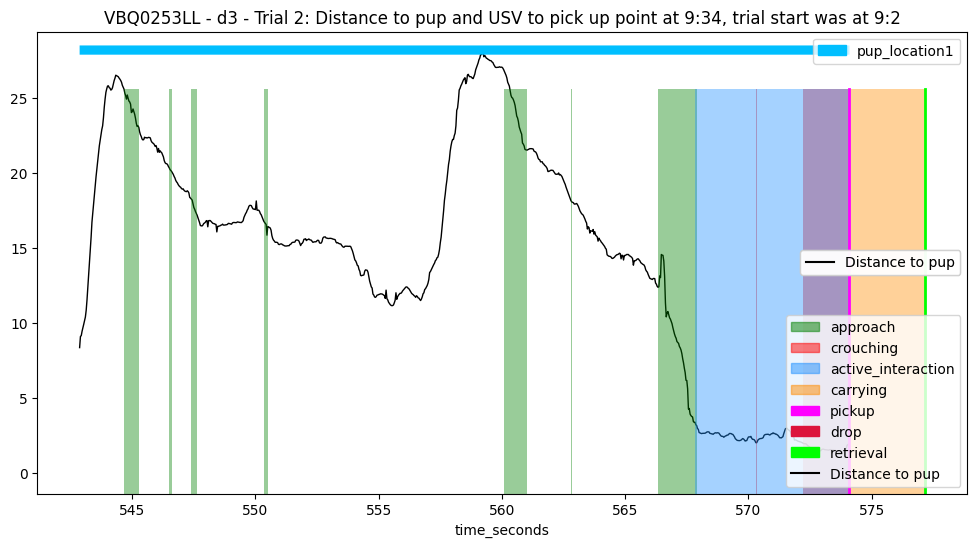

 ==== Example: VBQ0253LL - d3 - 3 ==== 
 ==== Example: VBQ0253LL - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 626.893
* Success time: 628.597
---> Pick up frame: 18807, Start frame: 18042, End frame: 18857
---> Retrieval frame: 18858; Start frame: 18042; End frame: 18857
---> Final frame: 18857
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18807 * Pickup time:  626.893
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 816
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        138
distance_head

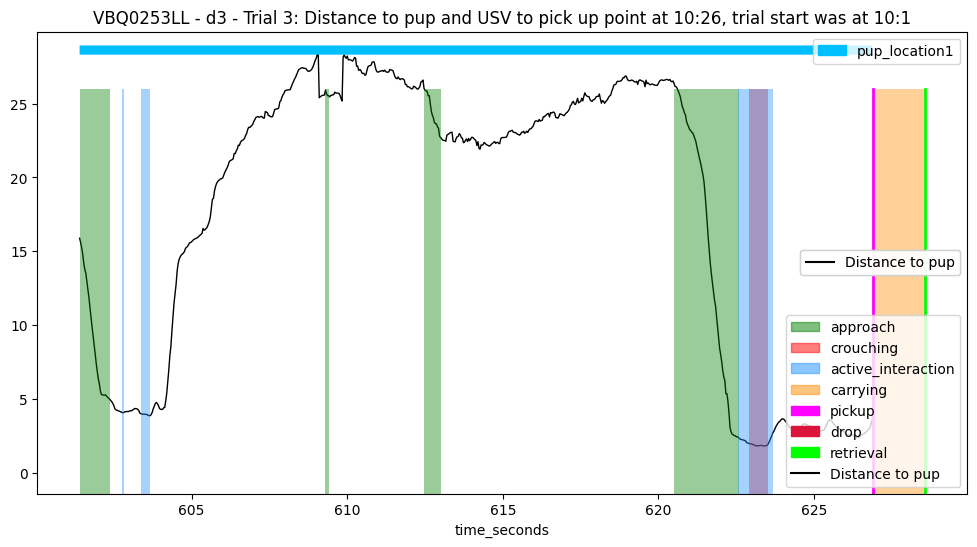

 ==== Example: VBQ0253LL - d3 - 4 ==== 
 ==== Example: VBQ0253LL - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 643.789
* Success time: None
---> Pick up frame: 19314, Start frame: 19184, End frame: 22763
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19314 * Pickup time:  643.789
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3580
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 19314, instantly drop at 19315
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_t

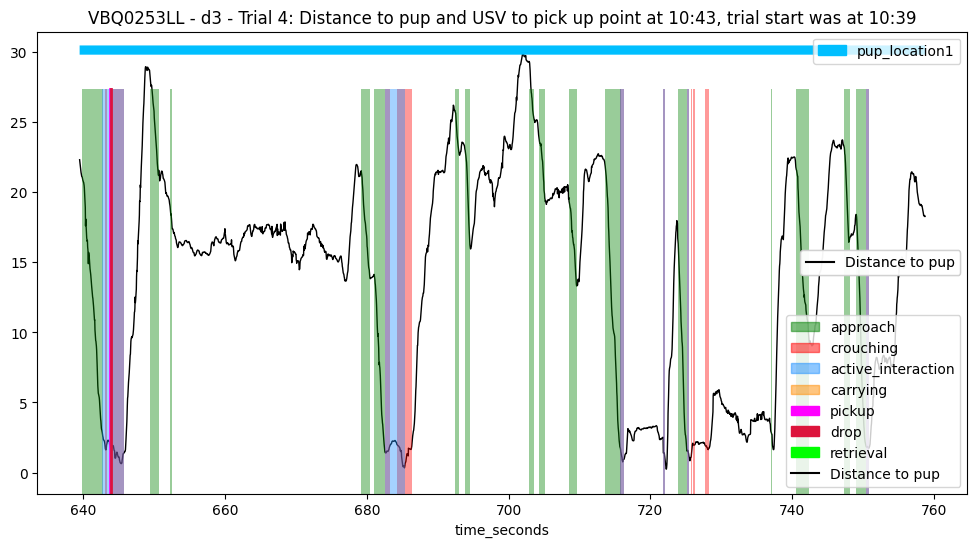

 ==== Example: VBQ0253LL - d3 - 5 ==== 
 ==== Example: VBQ0253LL - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 778.605
* Success time: 781.893
---> Pick up frame: 23358, Start frame: 22892, End frame: 23456
---> Retrieval frame: 23457; Start frame: 22892; End frame: 23456
---> Final frame: 23456
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23358 * Pickup time:  778.605
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 565
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        69
distance_head_

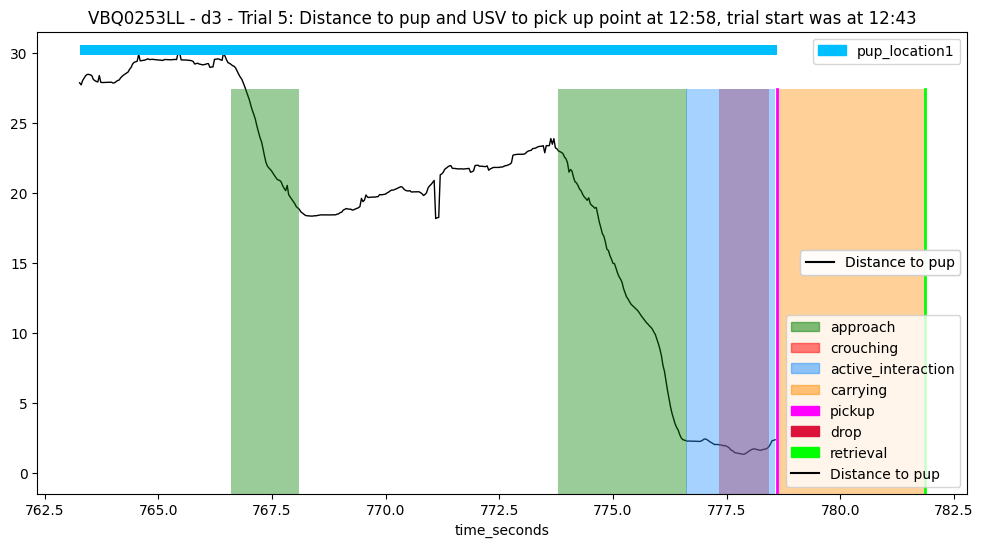

 ==== Example: VBQ0253LL - d3 - 6 ==== 
 ==== Example: VBQ0253LL - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 833.237
* Success time: 835.269
---> Pick up frame: 24997, Start frame: 23877, End frame: 25058
---> Retrieval frame: 25058; Start frame: 23877; End frame: 25058
---> Final frame: 25058
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24997 * Pickup time:  833.237
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1182
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        61
distance_head

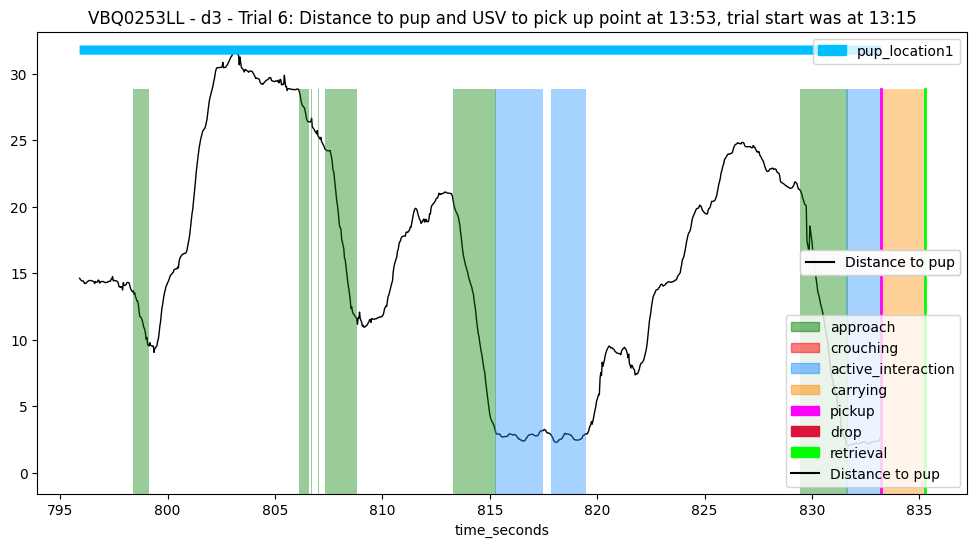

 ==== Example: VBQ0253LL - d3 - 7 ==== 
 ==== Example: VBQ0253LL - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 847.974
* Success time: 852.685
---> Pick up frame: 25439, Start frame: 25382, End frame: 25580
---> Retrieval frame: 25581; Start frame: 25382; End frame: 25580
---> Final frame: 25580
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25439 * Pickup time:  847.974
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 199
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head_

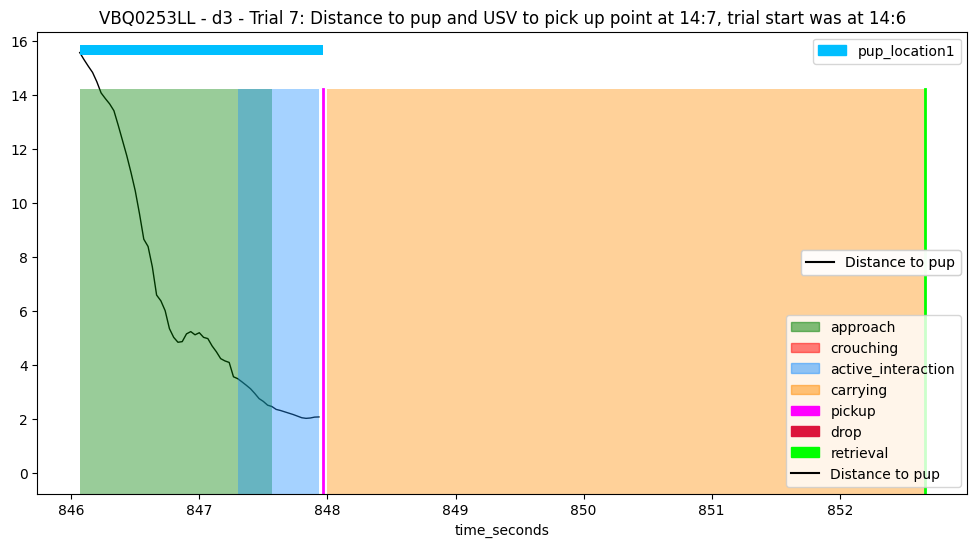

 ==== Example: VBQ0253LL - d3 - 8 ==== 
 ==== Example: VBQ0253LL - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 870.782
* Success time: 873.789
---> Pick up frame: 26123, Start frame: 25986, End frame: 26213
---> Retrieval frame: 26214; Start frame: 25986; End frame: 26213
---> Final frame: 26213
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26123 * Pickup time:  870.782
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 228
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        97
distance_head_

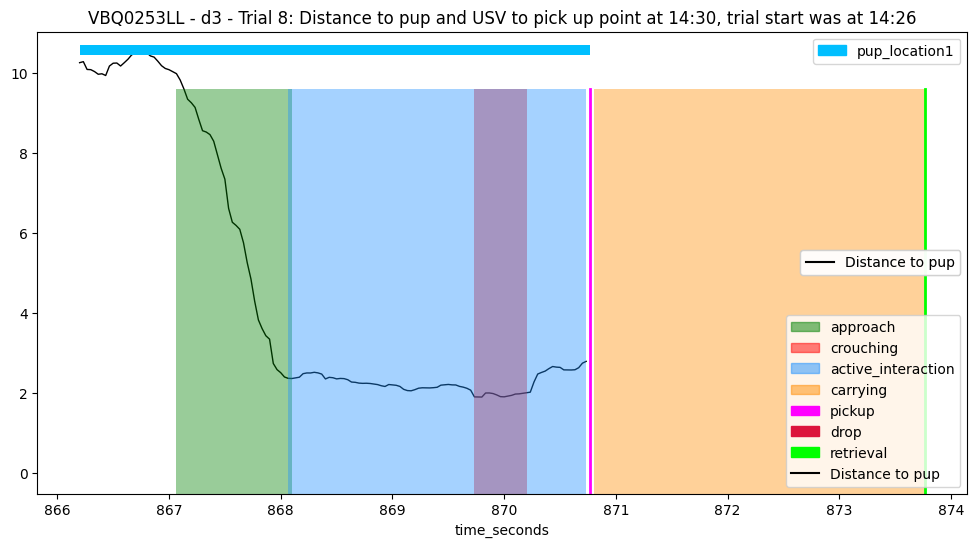

 ==== Example: VBQ0253LL - d3 - 9 ==== 
 ==== Example: VBQ0253LL - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 935.358
* Success time: None
---> Pick up frame: 28061, Start frame: 26875, End frame: 30690
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28061 * Pickup time:  935.358
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3816
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 28061, instantly drop at 28062
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_t

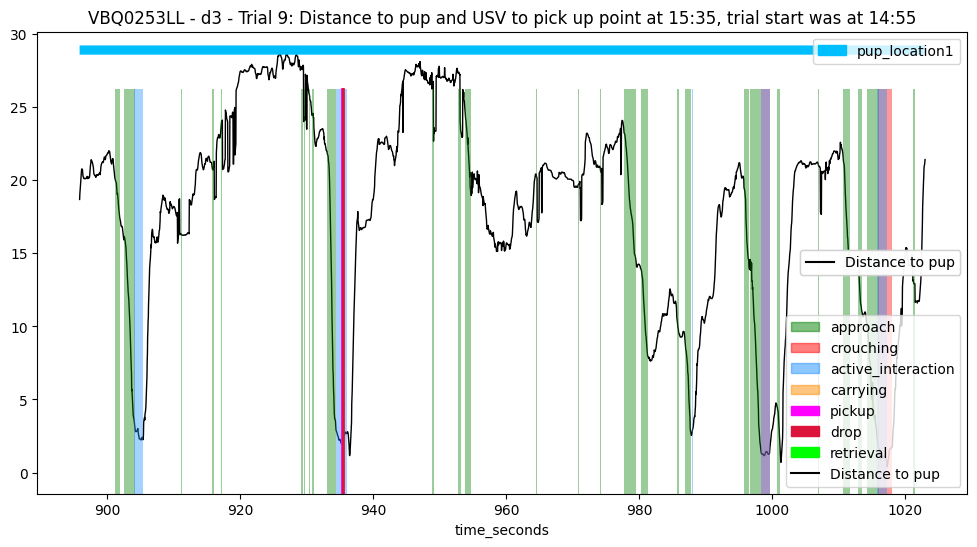

 ==== Example: VBQ0253LL - d4 - 1 ==== 
 ==== Example: VBQ0253LL - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 498.454
* Success time: 500.495
---> Pick up frame: 14954, Start frame: 14652, End frame: 15014
---> Retrieval frame: 15015; Start frame: 14652; End frame: 15014
---> Final frame: 15014
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14954 * Pickup time:  498.454
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 363
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        45
distance_head_

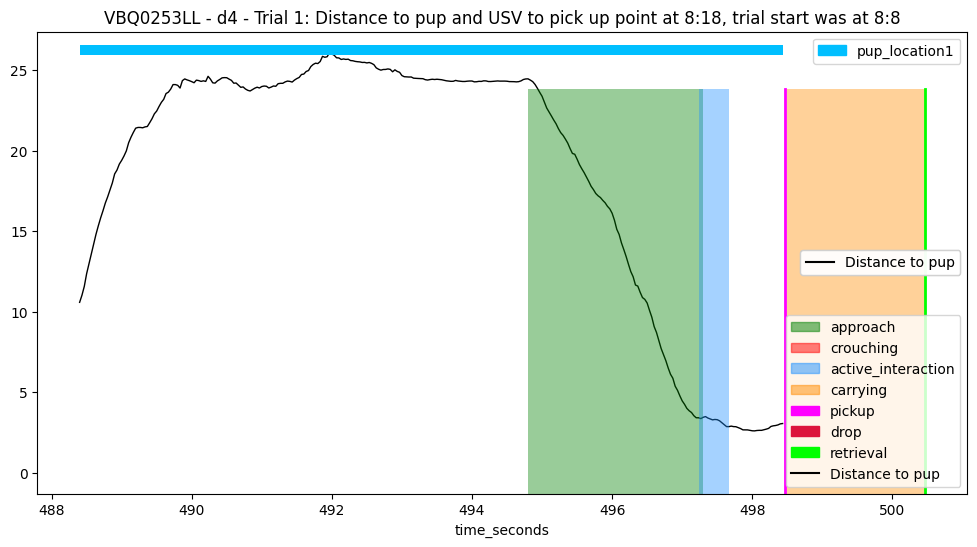

 ==== Example: VBQ0253LL - d4 - 2 ==== 
 ==== Example: VBQ0253LL - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 533.942
* Success time: 536.63
---> Pick up frame: 16018, Start frame: 15468, End frame: 16098
---> Retrieval frame: 16099; Start frame: 15468; End frame: 16098
---> Final frame: 16098
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16018 * Pickup time:  533.942
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 631
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        92
distance_head_t

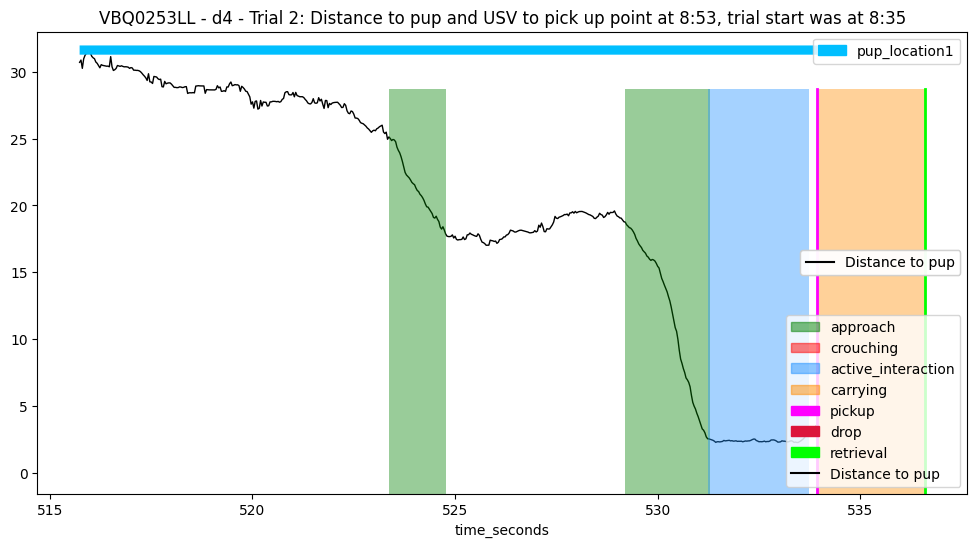

 ==== Example: VBQ0253LL - d4 - 3 ==== 
 ==== Example: VBQ0253LL - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 552.094
* Success time: 555.246
---> Pick up frame: 16563, Start frame: 16418, End frame: 16657
---> Retrieval frame: 16657; Start frame: 16418; End frame: 16657
---> Final frame: 16657
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16563 * Pickup time:  552.094
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 240
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_

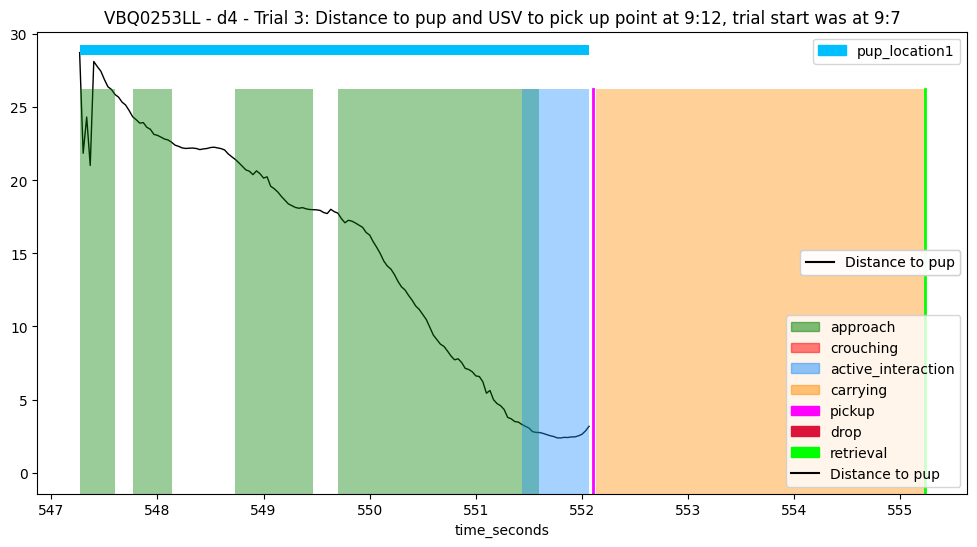

 ==== Example: VBQ0253LL - d4 - 4 ==== 
 ==== Example: VBQ0253LL - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3725
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pu

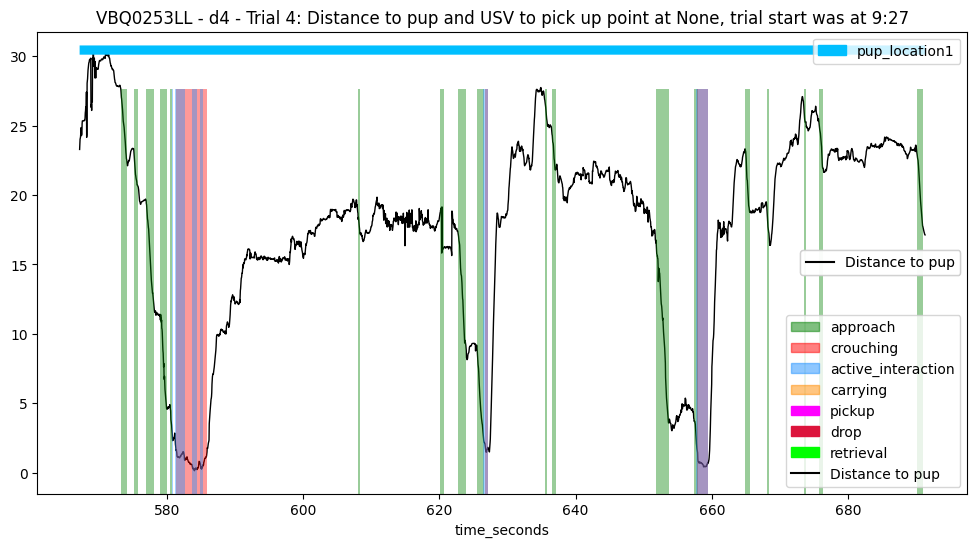

 ==== Example: VBQ0253LL - d4 - 5 ==== 
 ==== Example: VBQ0253LL - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3756
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        40
distance_head_to_pup         40
head_angle_to_pup_degrees    40
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        40
distance_head_to_pup         40
head_angle_to_pu

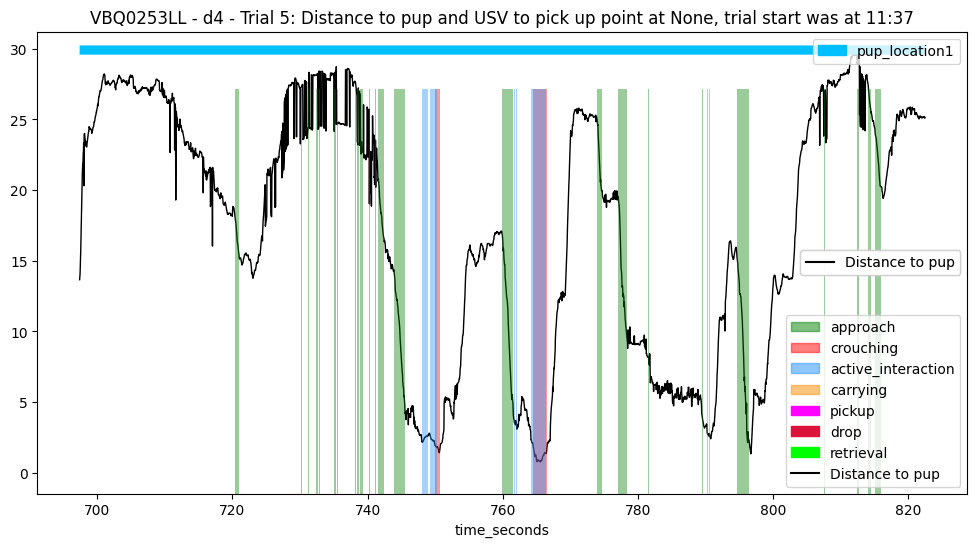

 ==== Example: VBQ0253LL - d4 - 6 ==== 
 ==== Example: VBQ0253LL - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3733
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pup_degrees    50
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        50
distance_head_to_pup         50
head_angle_to_pu

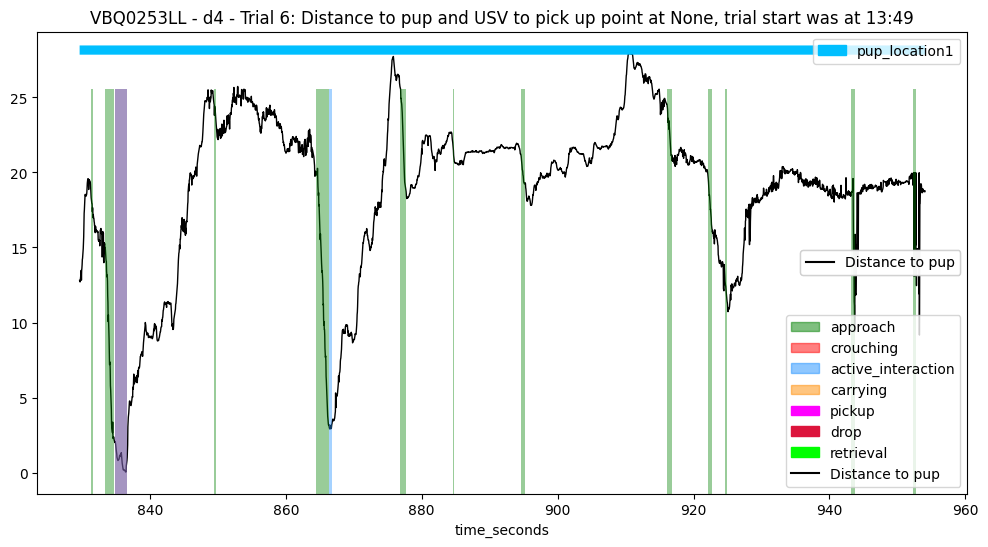

 ==== Example: VBQ0253LL - d4 - 7 ==== 
 ==== Example: VBQ0253LL - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4008
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        85
distance_head_to_pup         85
head_angle_to_pup_degrees    85
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        89
distance_head_to_pup         89
head_angle_to_pu

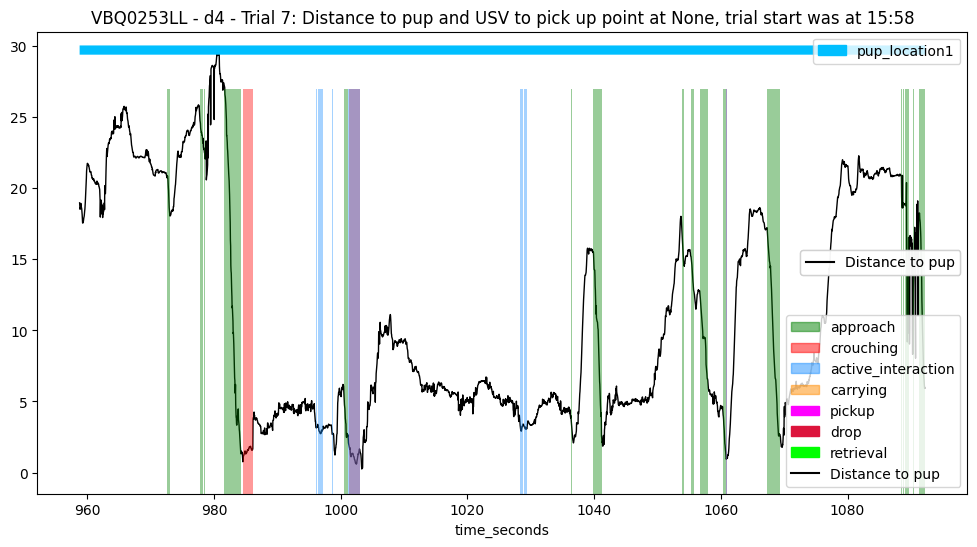

 ==== Example: VBQ0253LL - d4 - 8 ==== 
 ==== Example: VBQ0253LL - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1158.223
* Success time: 1163.536
---> Pick up frame: 34747, Start frame: 32939, End frame: 34906
---> Retrieval frame: 34906; Start frame: 32939; End frame: 34906
---> Final frame: 34906
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34747 * Pickup time:  1158.223
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1968
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        57
distance_h

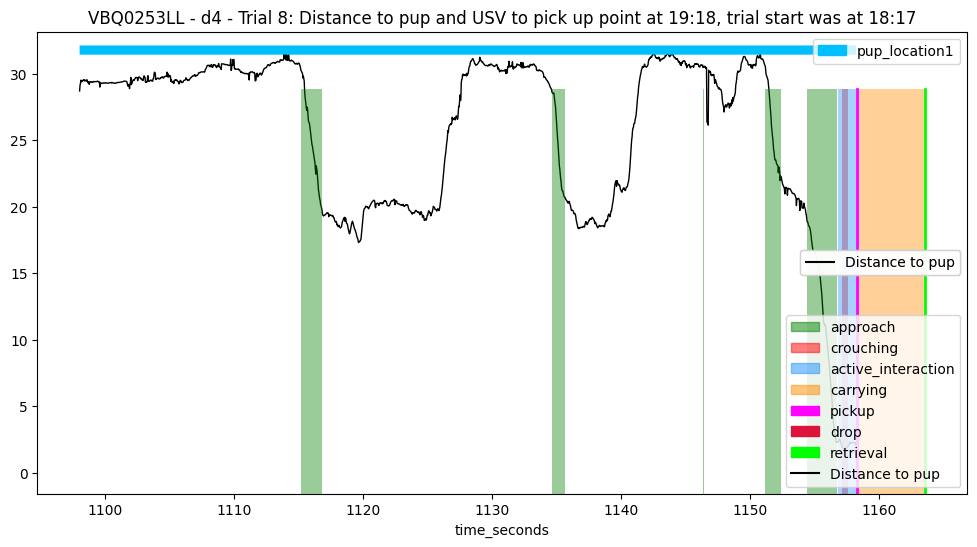

 ==== Example: VBQ0253LL - d4 - 9 ==== 
 ==== Example: VBQ0253LL - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1182.479
* Success time: 1186.359
---> Pick up frame: 35474, Start frame: 35383, End frame: 35590
---> Retrieval frame: 35591; Start frame: 35383; End frame: 35590
---> Final frame: 35590
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  35474 * Pickup time:  1182.479
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 208
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        50
distance_he

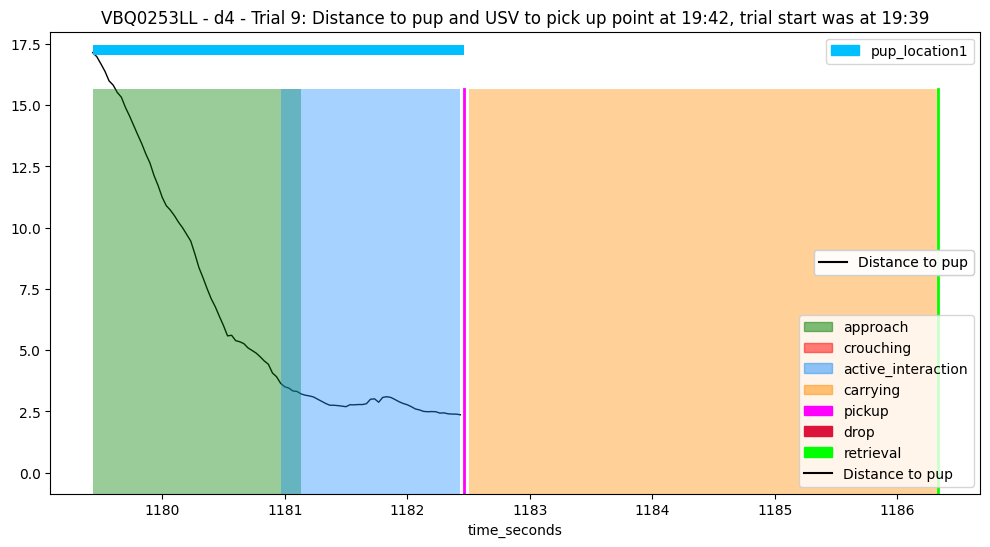

 ==== Example: VBQ0253LL - d5 - 1 ==== 
 ==== Example: VBQ0253LL - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3823
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        71
distance_head_to_pup         71
head_angle_to_pup_degrees    71
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        79
distance_head_to_pup         79
head_angle_to_pu

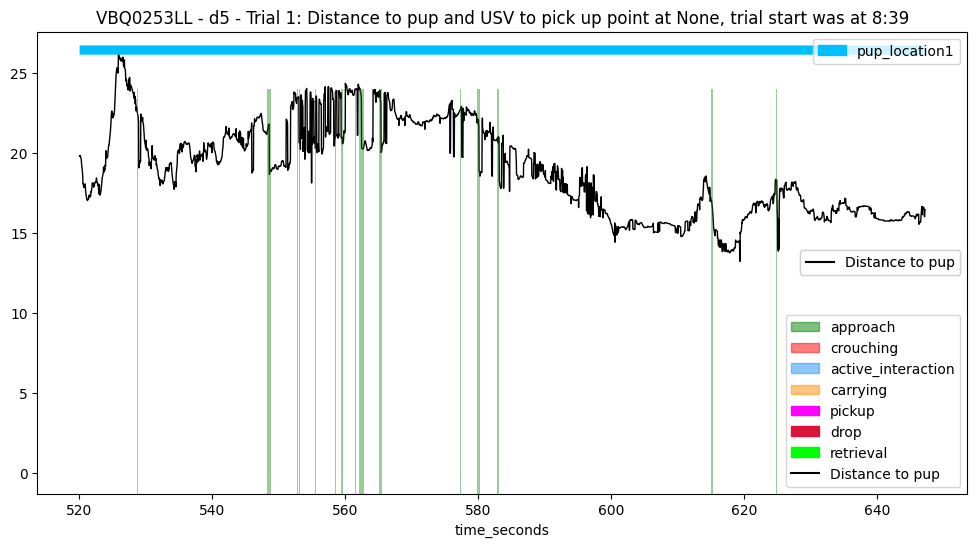

 ==== Example: VBQ0253LL - d5 - 2 ==== 
 ==== Example: VBQ0253LL - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4198
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        35
distance_head_to_pup         35
head_angle_to_pup_degrees    36
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         35
distance_head_to_pup          35
head_angle_to_

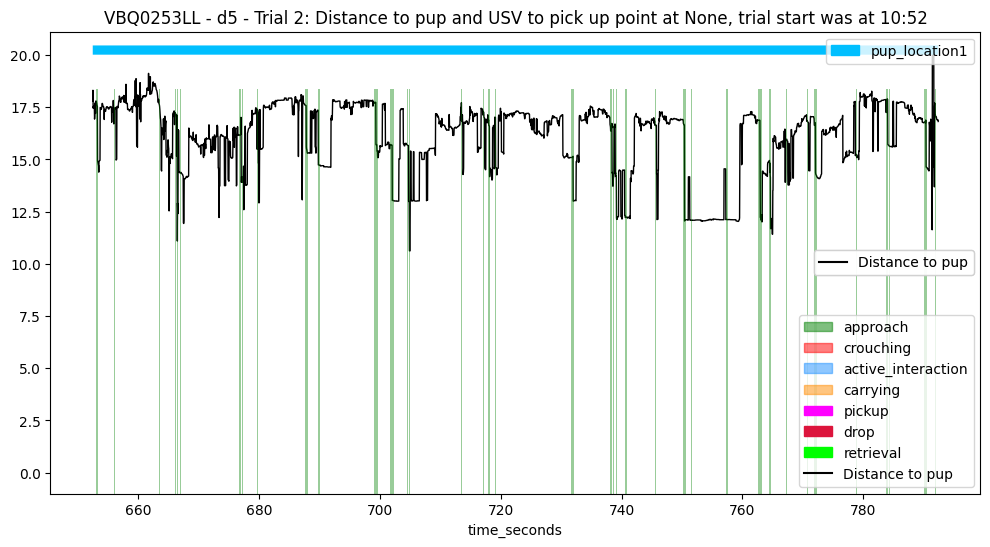

 ==== Example: VBQ0253LL - d5 - 3 ==== 
 ==== Example: VBQ0253LL - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 898.0
* Success time: 902.796
---> Pick up frame: 26940, Start frame: 23903, End frame: 27083
---> Retrieval frame: 27084; Start frame: 23903; End frame: 27083
---> Final frame: 27083
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26940 * Pickup time:  898.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3181
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        78
distance_head_to_

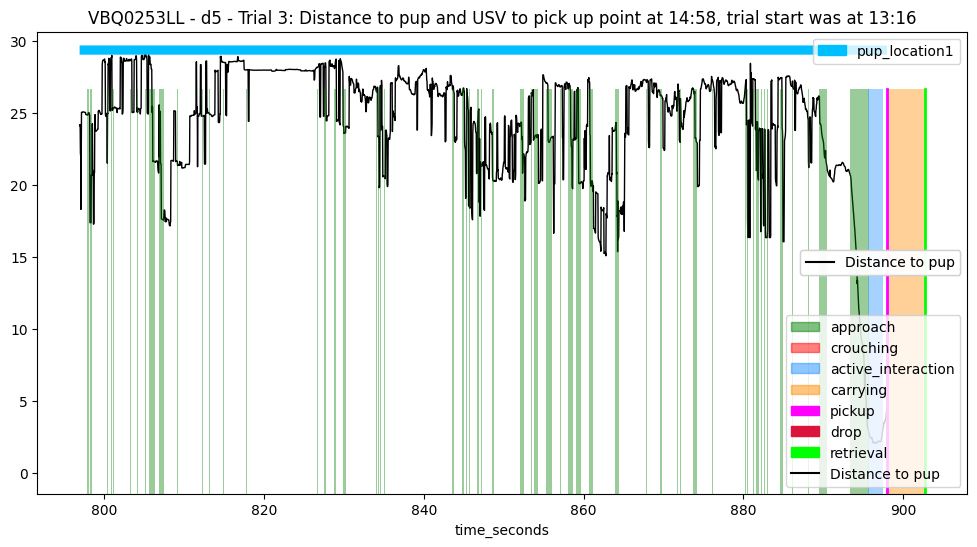

 ==== Example: VBQ0253LL - d5 - 4 ==== 
 ==== Example: VBQ0253LL - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 958.341
* Success time: 960.612
---> Pick up frame: 28750, Start frame: 27477, End frame: 28818
---> Retrieval frame: 28818; Start frame: 27477; End frame: 28818
---> Final frame: 28818
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28750 * Pickup time:  958.341
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1342
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head

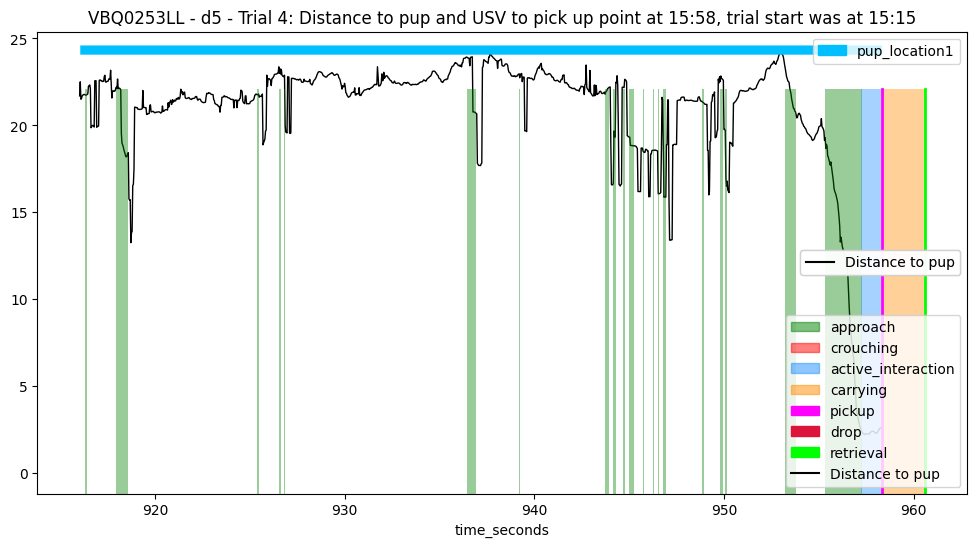

 ==== Example: VBQ0253LL - d5 - 5 ==== 
 ==== Example: VBQ0253LL - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 983.108
* Success time: 986.133
---> Pick up frame: 29493, Start frame: 29225, End frame: 29583
---> Retrieval frame: 29584; Start frame: 29225; End frame: 29583
---> Final frame: 29583
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  29493 * Pickup time:  983.108
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 359
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        20
distance_head_

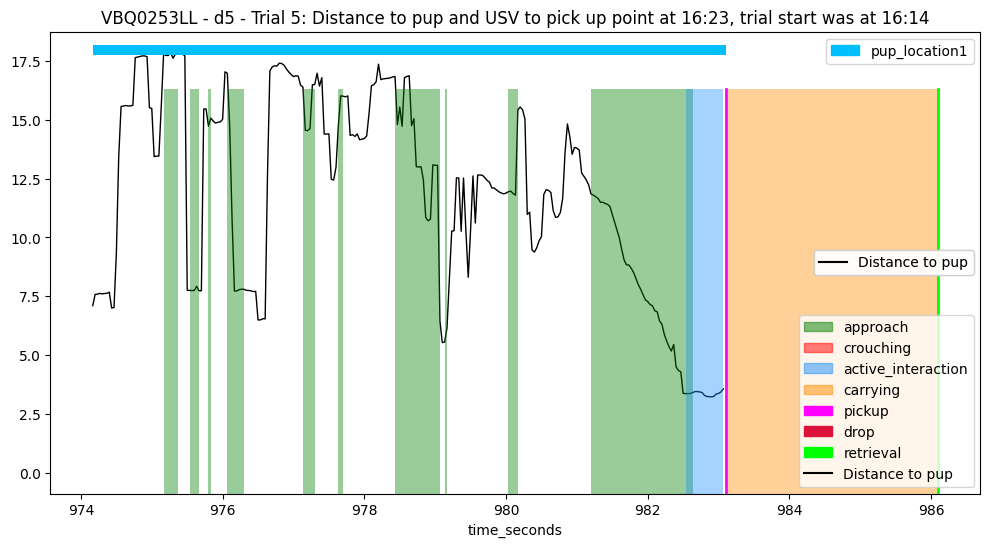

 ==== Example: VBQ0253LL - d5 - 6 ==== 
 ==== Example: VBQ0253LL - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4144
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        4144
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 1019.9 to 1044.2
Window l

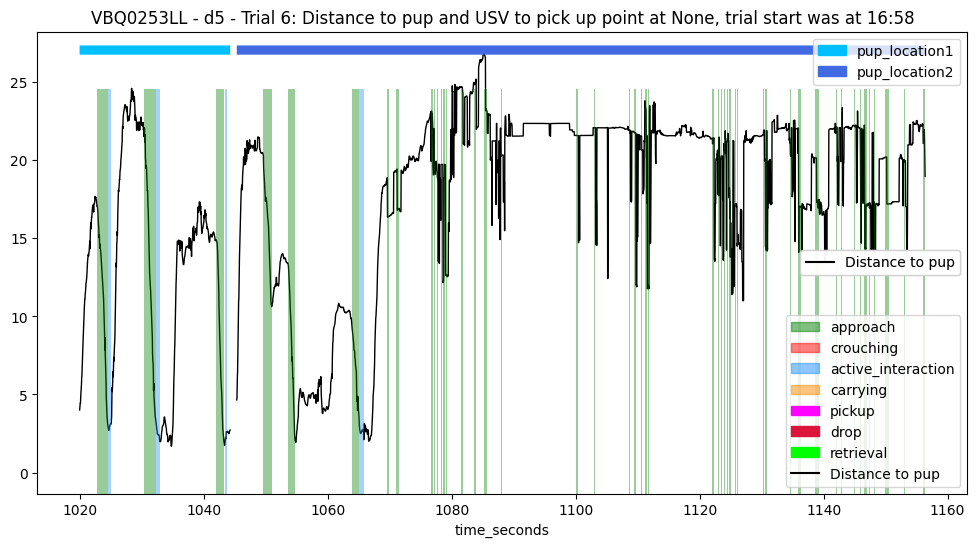

 ==== Example: VBQ0253LL - d5 - 7 ==== 
 ==== Example: VBQ0253LL - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1213.18
* Success time: 1218.09
---> Pick up frame: 36395, Start frame: 34928, End frame: 36542
---> Retrieval frame: 36543; Start frame: 34928; End frame: 36542
---> Final frame: 36542
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  36395 * Pickup time:  1213.18
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1615
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        53
distance_head

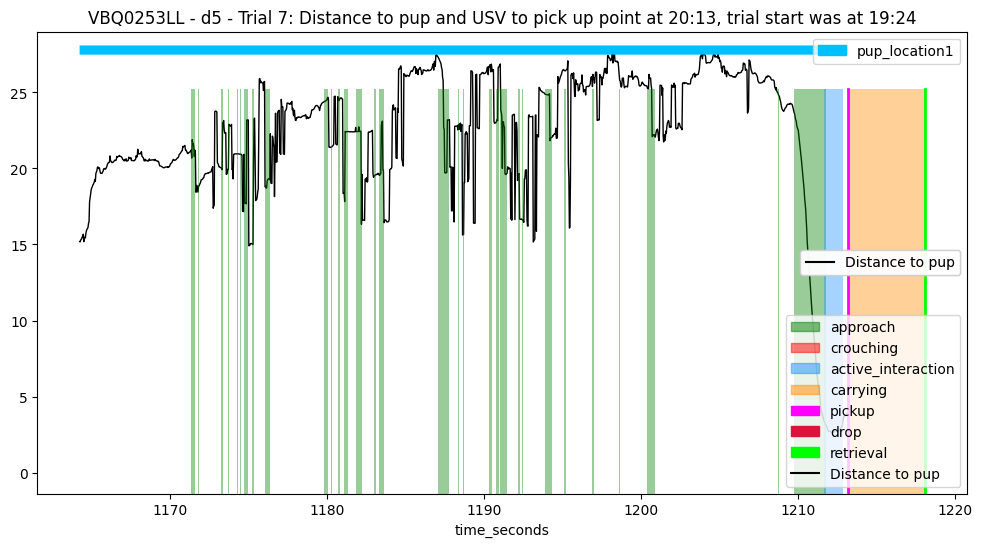

 ==== Example: VBQ0253LL - d5 - 8 ==== 
 ==== Example: VBQ0253LL - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1274.8
* Success time: None
---> Pick up frame: 38244, Start frame: 37041, End frame: 41124
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  38244 * Pickup time:  1274.8
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4084
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        2
distance_head_to_pup         2
head_angle_to_pup_degrees    2
dtype: int64
---Over

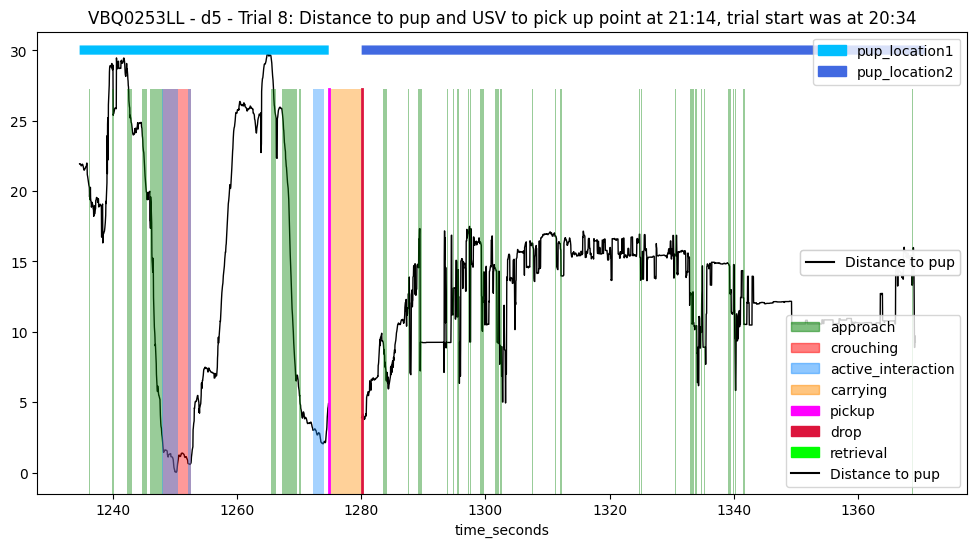

 ==== Example: VBQ0253LL - d5 - 9 ==== 
 ==== Example: VBQ0253LL - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1389.11
* Success time: 1392.405
---> Pick up frame: 41673, Start frame: 41408, End frame: 41772
---> Retrieval frame: 41772; Start frame: 41408; End frame: 41772
---> Final frame: 41772
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41673 * Pickup time:  1389.11
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 365
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        82
distance_head

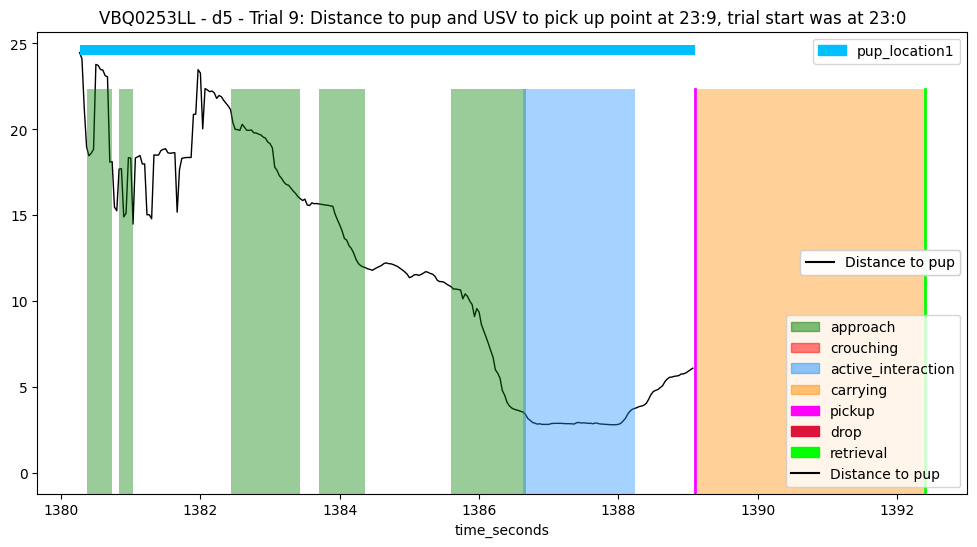

 ==== Example: VBQ0253LL - d6 - 1 ==== 
 ==== Example: VBQ0253LL - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 420.19
* Success time: 424.963
---> Pick up frame: 12606, Start frame: 12245, End frame: 12748
---> Retrieval frame: 12749; Start frame: 12245; End frame: 12748
---> Final frame: 12748
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12606 * Pickup time:  420.19
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 504
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        27
distance_head_to

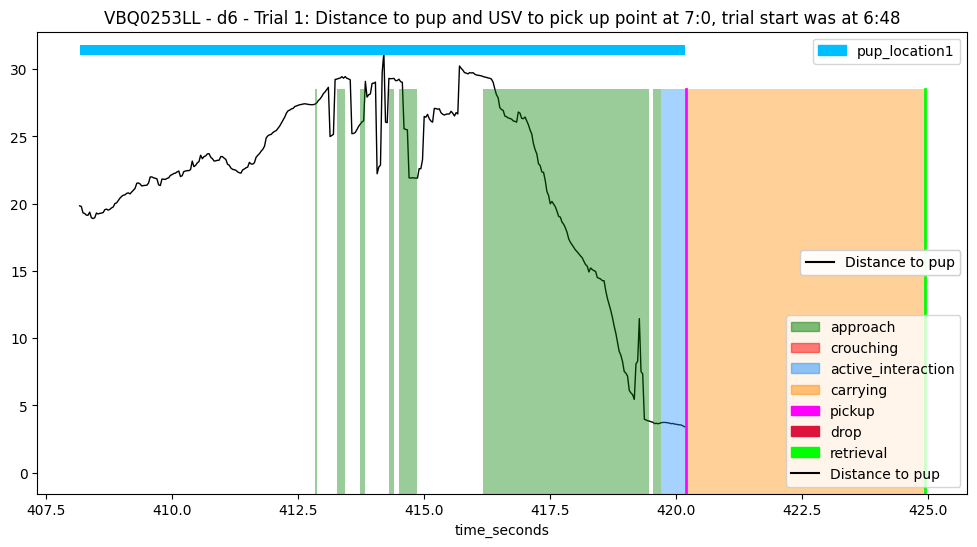

 ==== Example: VBQ0253LL - d6 - 2 ==== 
 ==== Example: VBQ0253LL - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 445.795
* Success time: None
---> Pick up frame: 13374, Start frame: 13151, End frame: 17273
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13374 * Pickup time:  445.795
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4123
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 13374, instantly drop at 13375
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_t

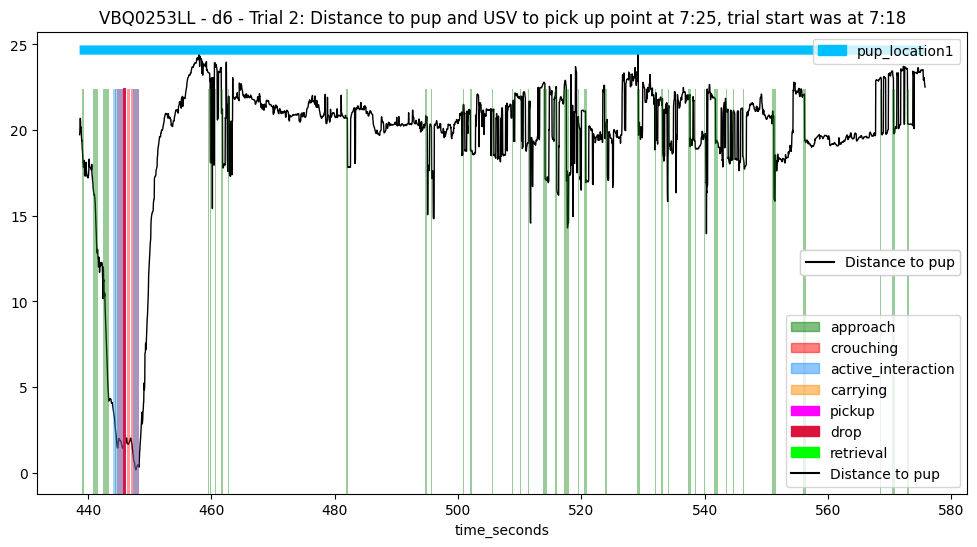

 ==== Example: VBQ0253LL - d6 - 3 ==== 
 ==== Example: VBQ0253LL - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 614.267
* Success time: 617.188
---> Pick up frame: 18428, Start frame: 17621, End frame: 18515
---> Retrieval frame: 18516; Start frame: 17621; End frame: 18515
---> Final frame: 18515
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18428 * Pickup time:  614.267
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 895
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        73
distance_head_

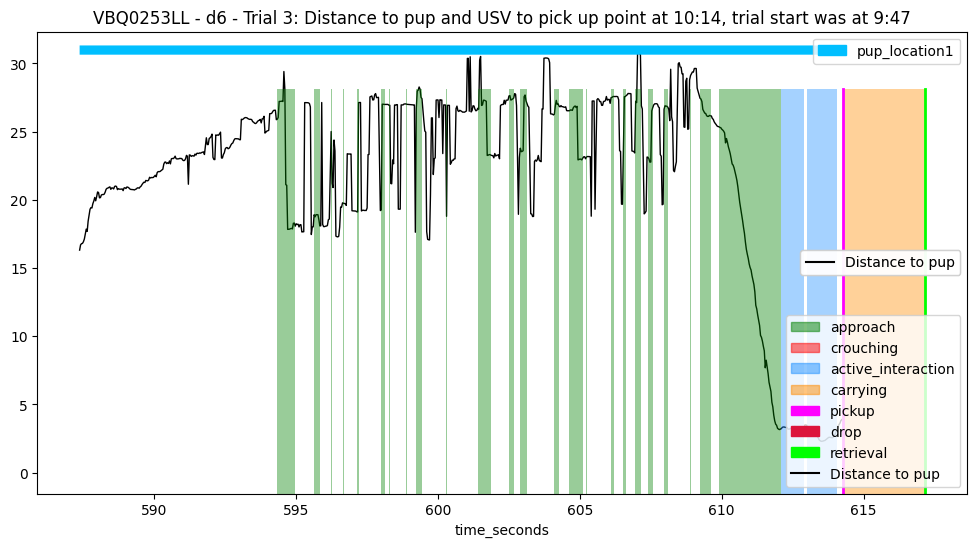

 ==== Example: VBQ0253LL - d6 - 4 ==== 
 ==== Example: VBQ0253LL - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 633.16
* Success time: 636.14
---> Pick up frame: 18995, Start frame: 18856, End frame: 19084
---> Retrieval frame: 19084; Start frame: 18856; End frame: 19084
---> Final frame: 19084
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18995 * Pickup time:  633.16
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 229
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        31
distance_head_to_

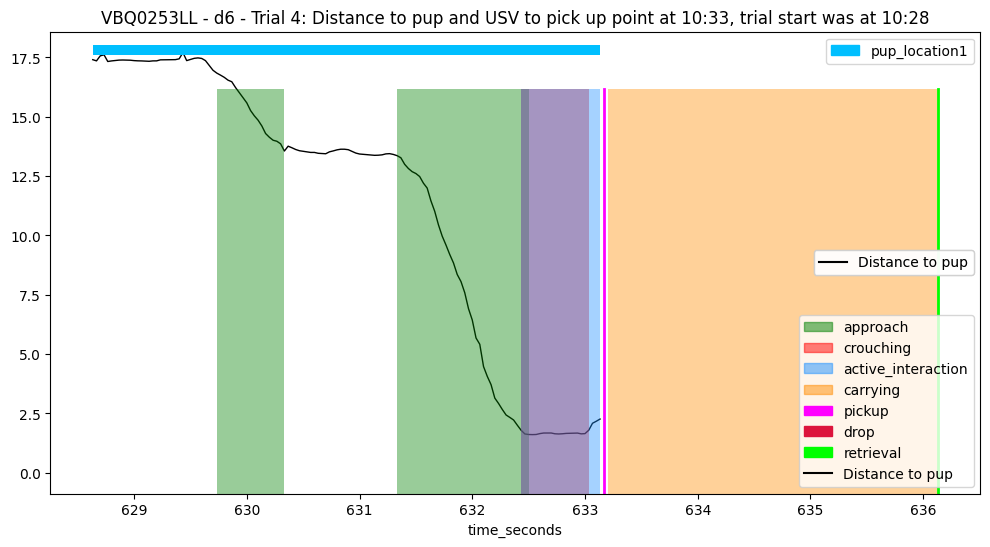

 ==== Example: VBQ0253LL - d6 - 5 ==== 
 ==== Example: VBQ0253LL - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 657.19
* Success time: 678.627
---> Pick up frame: 19716, Start frame: 19466, End frame: 20358
---> Retrieval frame: 20359; Start frame: 19466; End frame: 20358
---> Final frame: 20358
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  19716 * Pickup time:  657.19
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 893
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup

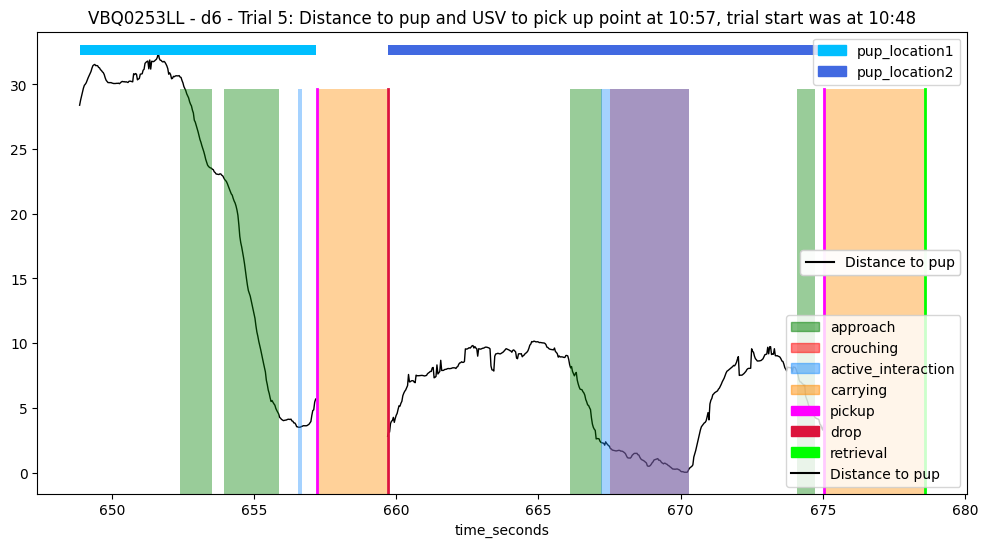

 ==== Example: VBQ0253LL - d6 - 6 ==== 
 ==== Example: VBQ0253LL - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 722.555
* Success time: 723.995
---> Pick up frame: 21677, Start frame: 20807, End frame: 21719
---> Retrieval frame: 21720; Start frame: 20807; End frame: 21719
---> Final frame: 21719
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21677 * Pickup time:  722.555
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 913
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        96
distance_head_

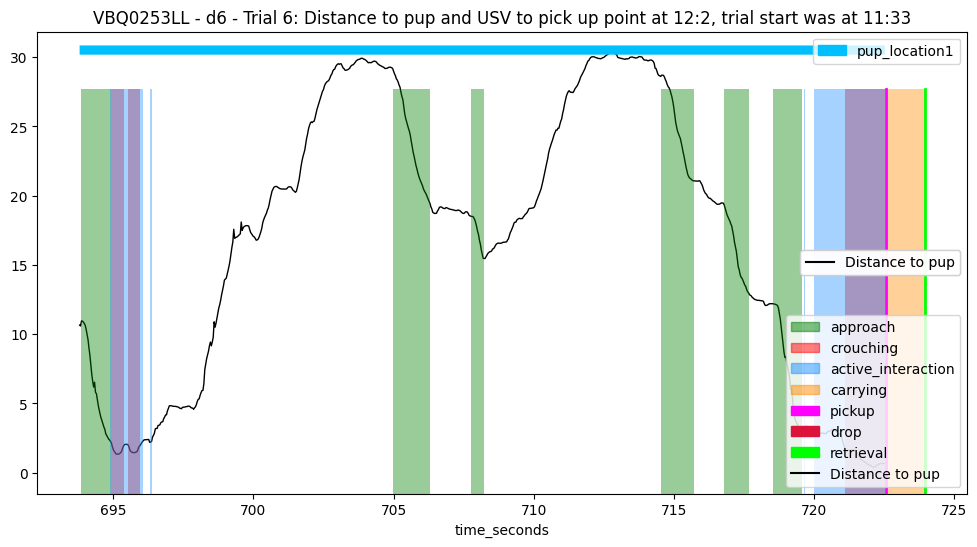

 ==== Example: VBQ0253LL - d6 - 7 ==== 
 ==== Example: VBQ0253LL - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 744.067
* Success time: 746.851
---> Pick up frame: 22322, Start frame: 22015, End frame: 22405
---> Retrieval frame: 22406; Start frame: 22015; End frame: 22405
---> Final frame: 22405
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22322 * Pickup time:  744.067
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 391
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_

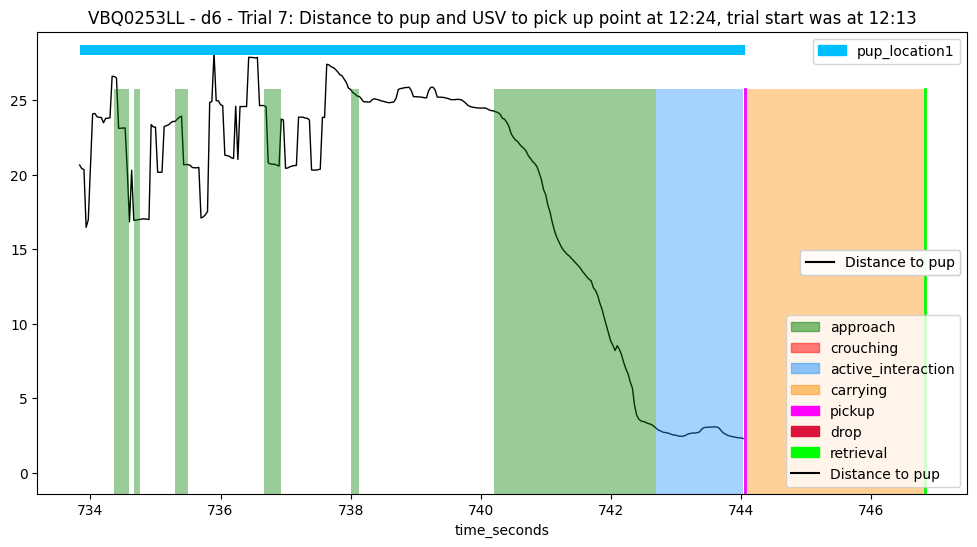

 ==== Example: VBQ0253LL - d6 - 8 ==== 
 ==== Example: VBQ0253LL - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 760.675
* Success time: 763.94
---> Pick up frame: 22820, Start frame: 22678, End frame: 22918
---> Retrieval frame: 22918; Start frame: 22678; End frame: 22918
---> Final frame: 22918
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22820 * Pickup time:  760.675
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 241
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 22820, instantly drop at 22821
---> Processing last pup location: 

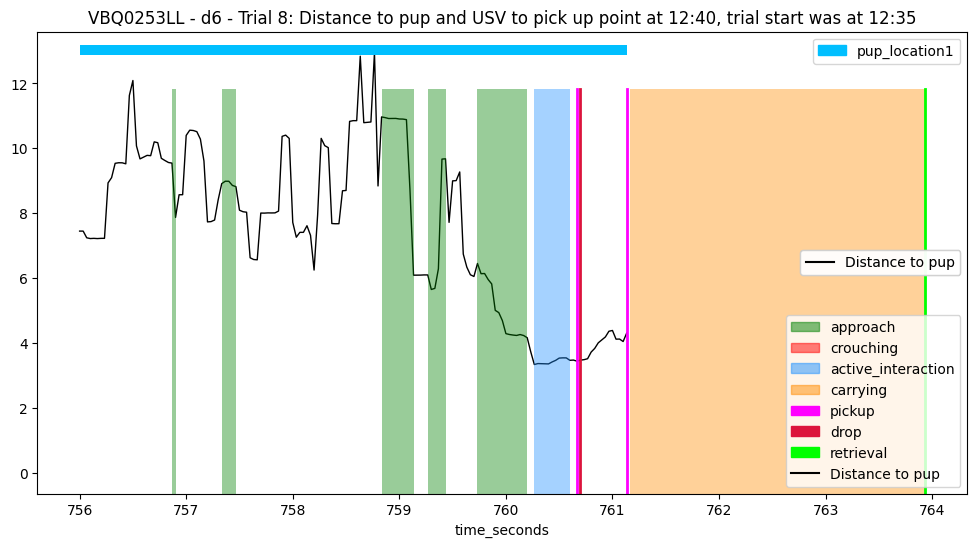

 ==== Example: VBQ0253LL - d6 - 9 ==== 
 ==== Example: VBQ0253LL - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3812
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        14
distance_head_to_pup         14
head_angle_to_pup_degrees    14
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        19
distance_head_to_pup         19
head_angle_to_pu

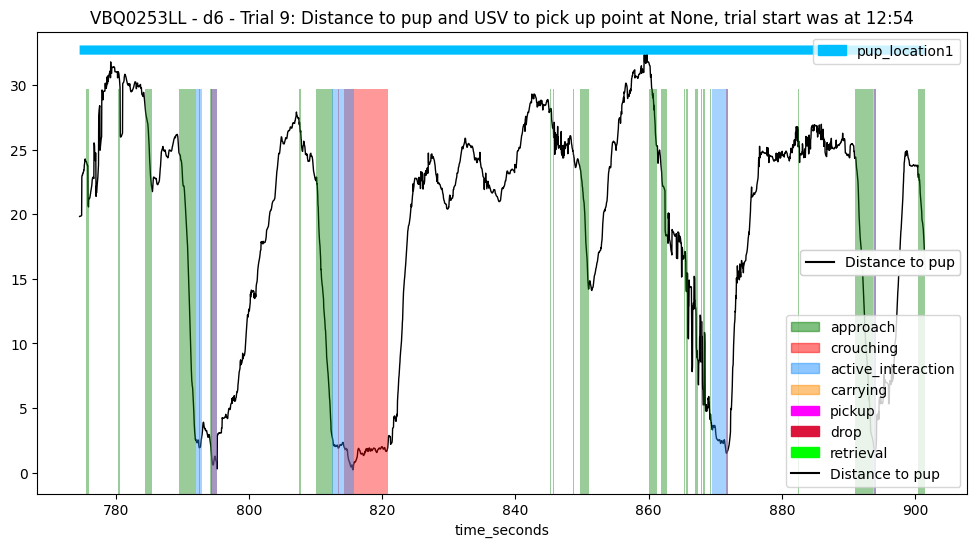

 ==== Example: VAC0143LLR - d1 - 1 ==== 
 ==== Example: VAC0143LLR - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3709
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        135
distance_head_to_pup         135
head_angle_to_pup_degrees    135
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        135
distance_head_to_pup         135
head_angl

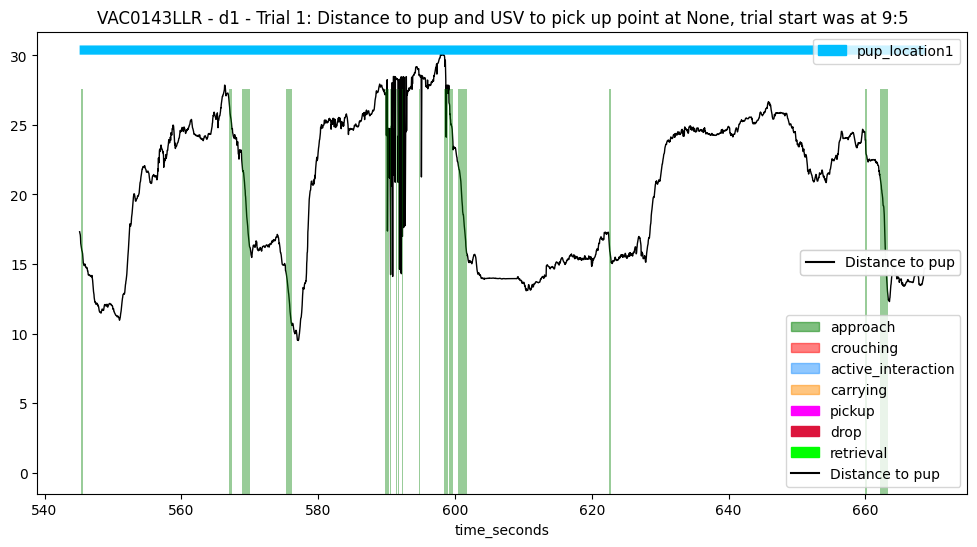

 ==== Example: VAC0143LLR - d1 - 2 ==== 
 ==== Example: VAC0143LLR - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3715
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        137
distance_head_to_pup         137
head_angle_to_pup_degrees    137
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        137
distance_head_to_pup         137
head_angl

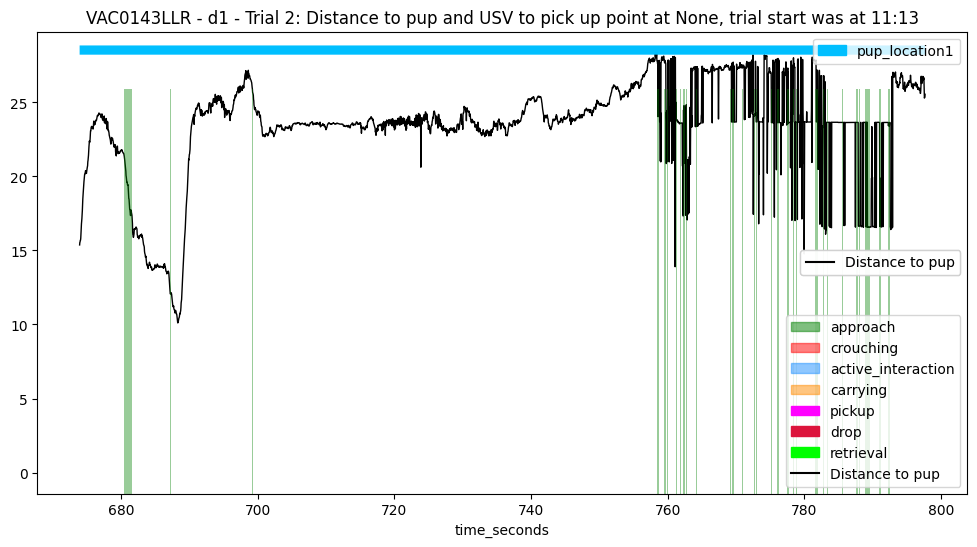

 ==== Example: VAC0143LLR - d1 - 3 ==== 
 ==== Example: VAC0143LLR - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3799
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        115
distance_head_to_pup         115
head_angle_to_pup_degrees    115
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        533
distance_head_to_pup         533
head_angl

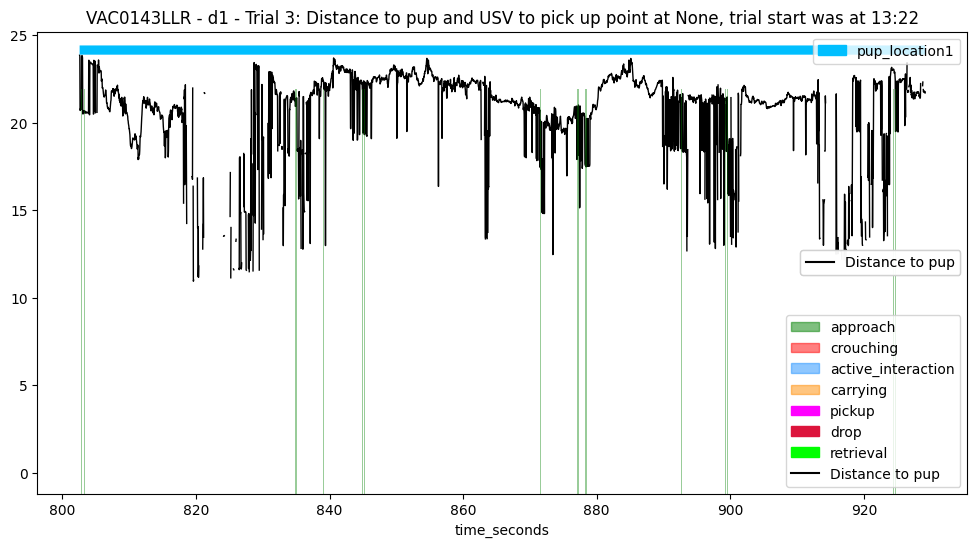

 ==== Example: VAC0143LLR - d1 - 4 ==== 
 ==== Example: VAC0143LLR - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3920
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        3851
distance_head_to_pup         3851
head_angle_to_pup_degrees    3851
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        3851
distance_head_to_pup         3851
head

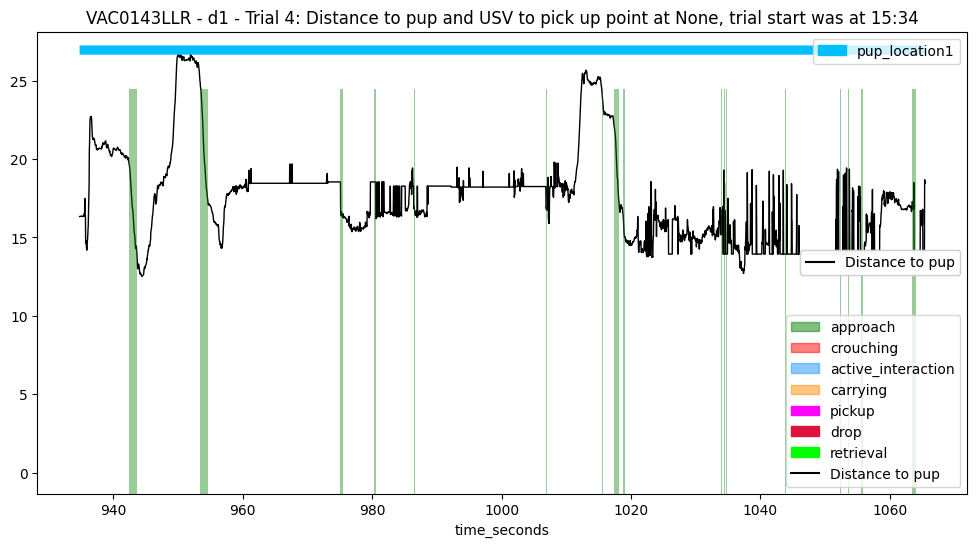

 ==== Example: VAC0143LLR - d1 - 5 ==== 
 ==== Example: VAC0143LLR - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1157.503
* Success time: None
---> Pick up frame: 34725, Start frame: 32198, End frame: 35856
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34725 * Pickup time:  1157.503
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3659
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 34725, instantly drop at 34726
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        1131
distance_

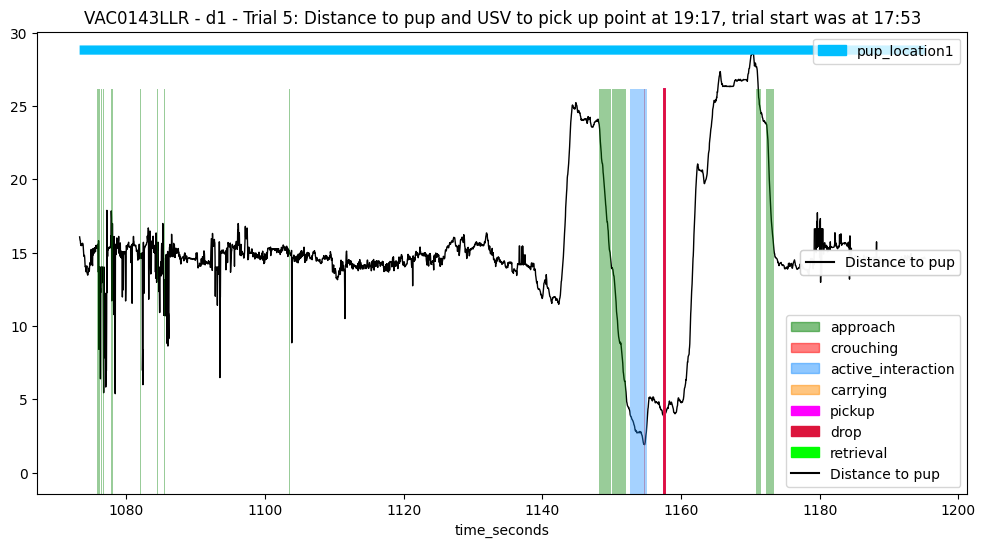

 ==== Example: VAC0143LLR - d1 - 6 ==== 
 ==== Example: VAC0143LLR - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1303.0
* Success time: None
---> Pick up frame: 39090, Start frame: 36113, End frame: 40368
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  39090 * Pickup time:  1303.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4256
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 39090, instantly drop at 39091
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        130
distance_head_

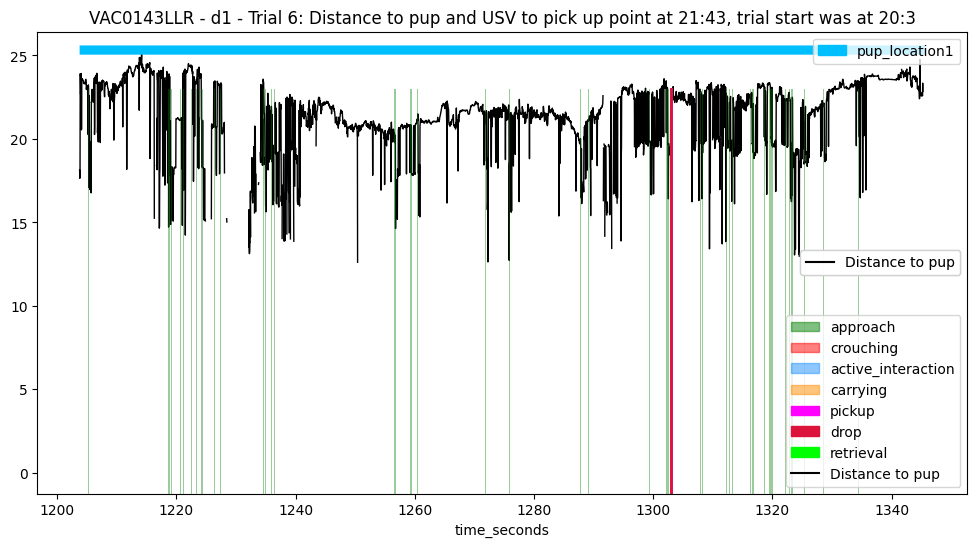

 ==== Example: VAC0143LLR - d1 - 7 ==== 
 ==== Example: VAC0143LLR - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1418.539
* Success time: 1423.539
---> Pick up frame: 42556, Start frame: 40697, End frame: 42706
---> Retrieval frame: 42706; Start frame: 40697; End frame: 42706
---> Final frame: 42706
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  42556 * Pickup time:  1418.539
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2010
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        118
distanc

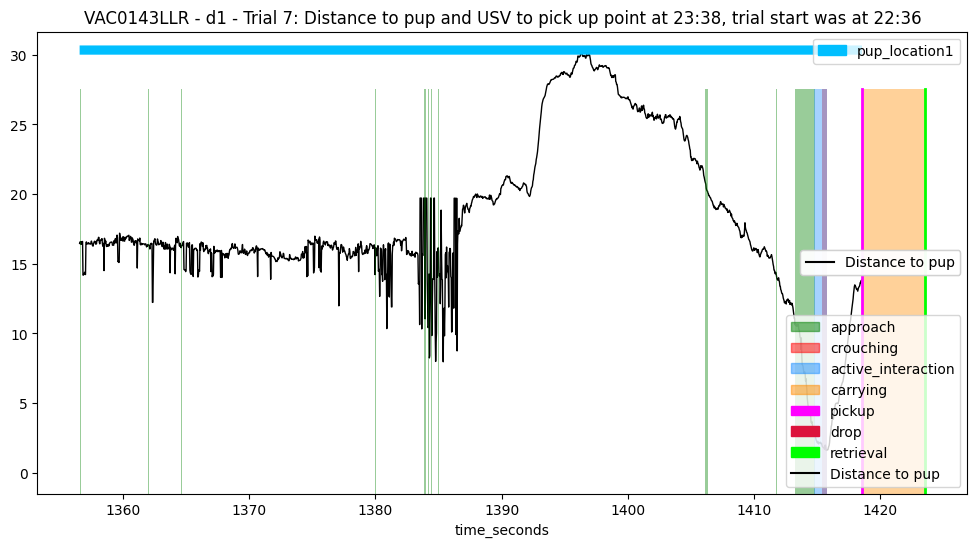

 ==== Example: VAC0143LLR - d1 - 8 ==== 
 ==== Example: VAC0143LLR - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1466.454
* Success time: 1477.639
---> Pick up frame: 43994, Start frame: 43737, End frame: 44329
---> Retrieval frame: 44329; Start frame: 43737; End frame: 44329
---> Final frame: 44329
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  43994 * Pickup time:  1466.454
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 593
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse

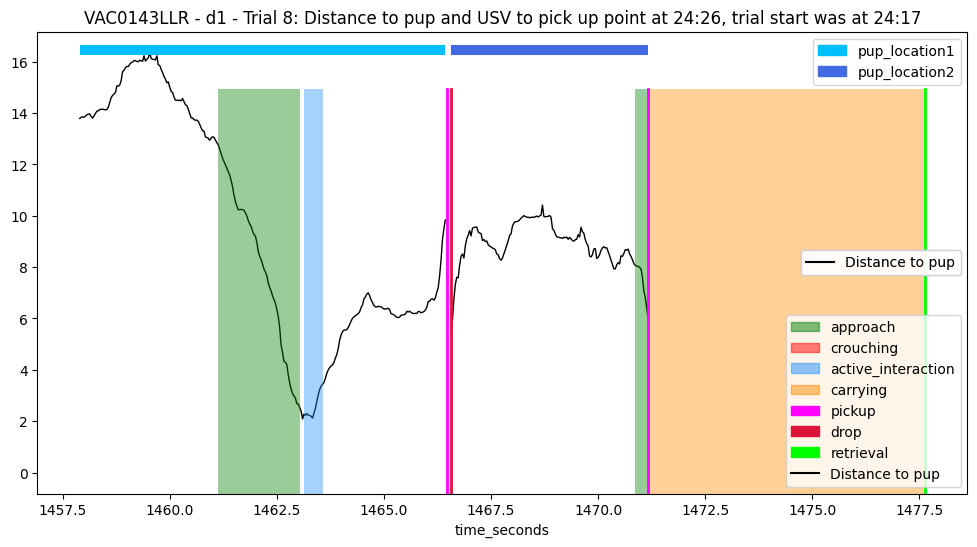

 ==== Example: VAC0143LLR - d1 - 9 ==== 
 ==== Example: VAC0143LLR - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1498.394
* Success time: 1508.459
---> Pick up frame: 44952, Start frame: 44690, End frame: 45253
---> Retrieval frame: 45254; Start frame: 44690; End frame: 45253
---> Final frame: 45253
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  44952 * Pickup time:  1498.394
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 564
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        137
distance

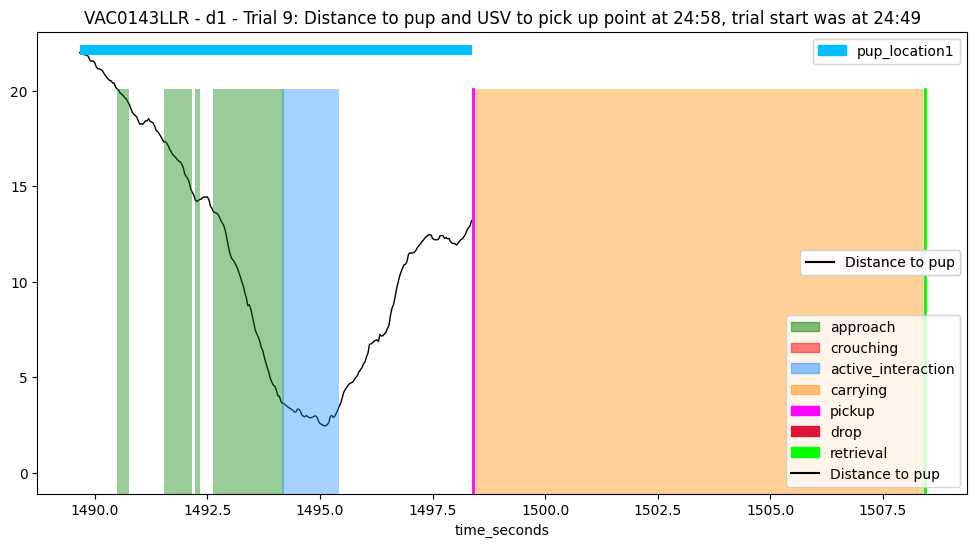

 ==== Example: VAC0143LLR - d2 - 1 ==== 
 ==== Example: VAC0143LLR - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 503.067
* Success time: 505.5
---> Pick up frame: 15092, Start frame: 14850, End frame: 15165
---> Retrieval frame: 15165; Start frame: 14850; End frame: 15165
---> Final frame: 15165
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15092 * Pickup time:  503.067
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 316
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        76
distance_head_

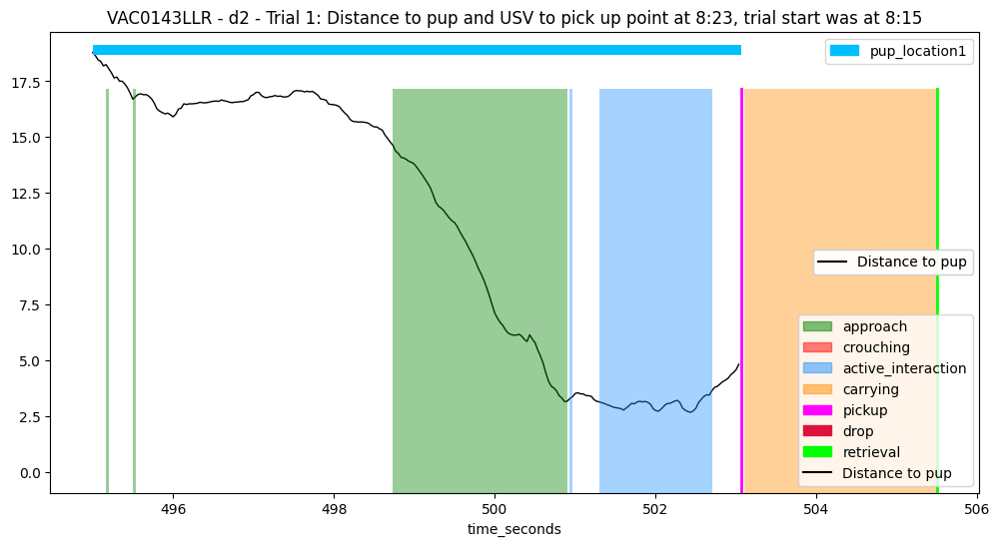

 ==== Example: VAC0143LLR - d2 - 2 ==== 
 ==== Example: VAC0143LLR - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3985
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        100
distance_head_to_pup         100
head_angle_to_pup_degrees    100
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        100
distance_head_to_pup         100
head_angl

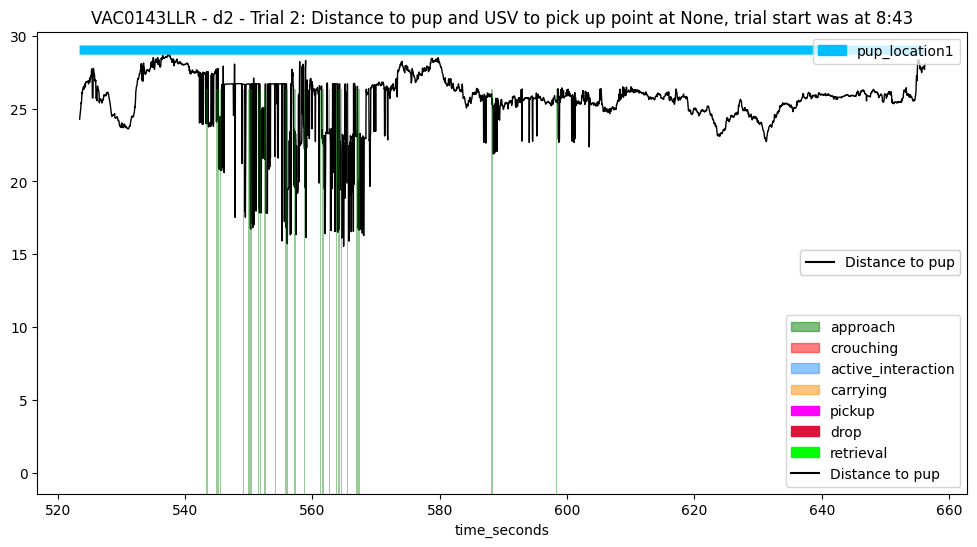

 ==== Example: VAC0143LLR - d2 - 3 ==== 
 ==== Example: VAC0143LLR - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 705.87
* Success time: None
---> Pick up frame: 21176, Start frame: 19856, End frame: 23513
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21176 * Pickup time:  705.87
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3658
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 21176, instantly drop at 21177
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        112
distance_head_

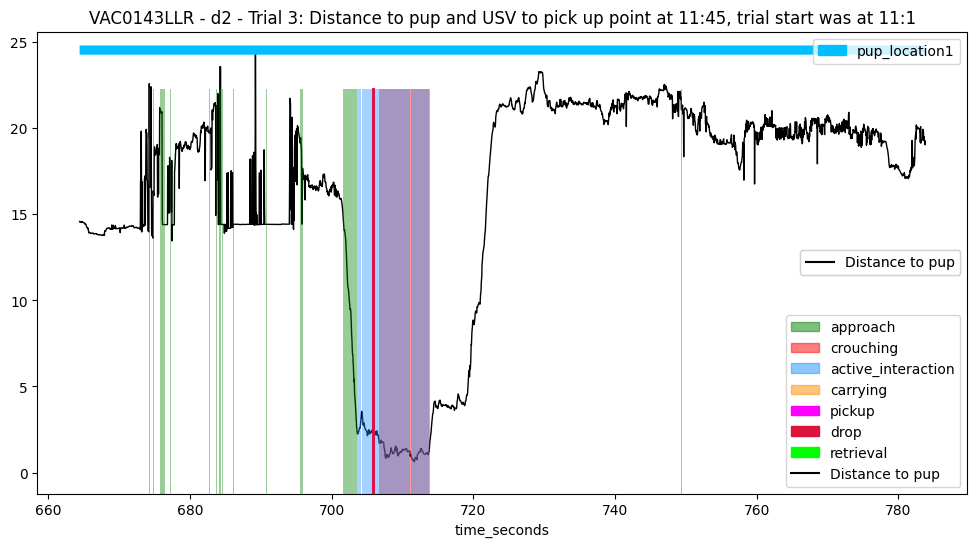

 ==== Example: VAC0143LLR - d2 - 4 ==== 
 ==== Example: VAC0143LLR - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3800
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        149
distance_head_to_pup         149
head_angle_to_pup_degrees    149
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        149
distance_head_to_pup         149
head_angl

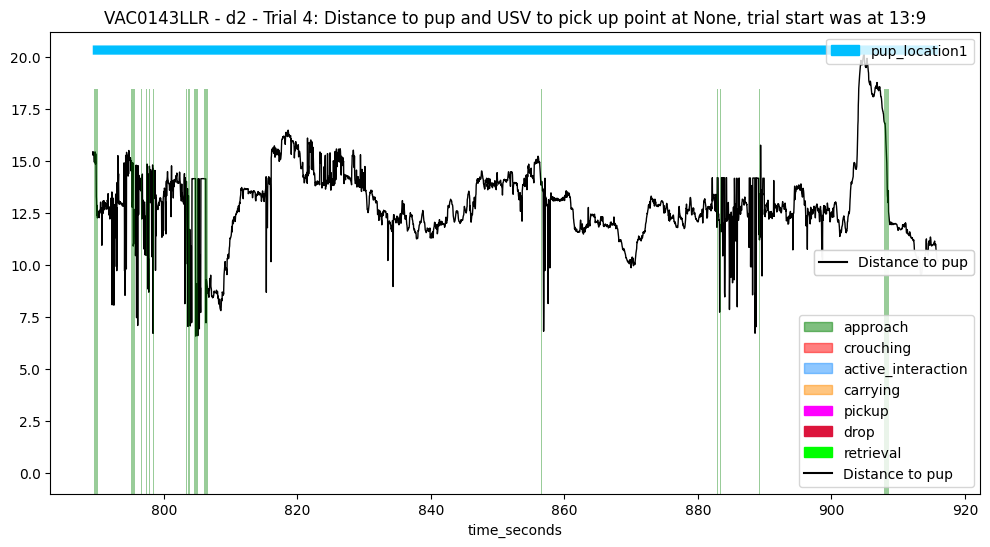

 ==== Example: VAC0143LLR - d2 - 5 ==== 
 ==== Example: VAC0143LLR - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1006.316
* Success time: 1010.213
---> Pick up frame: 30189, Start frame: 27644, End frame: 30306
---> Retrieval frame: 30306; Start frame: 27644; End frame: 30306
---> Final frame: 30306
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  30189 * Pickup time:  1006.316
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2663
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        107
distanc

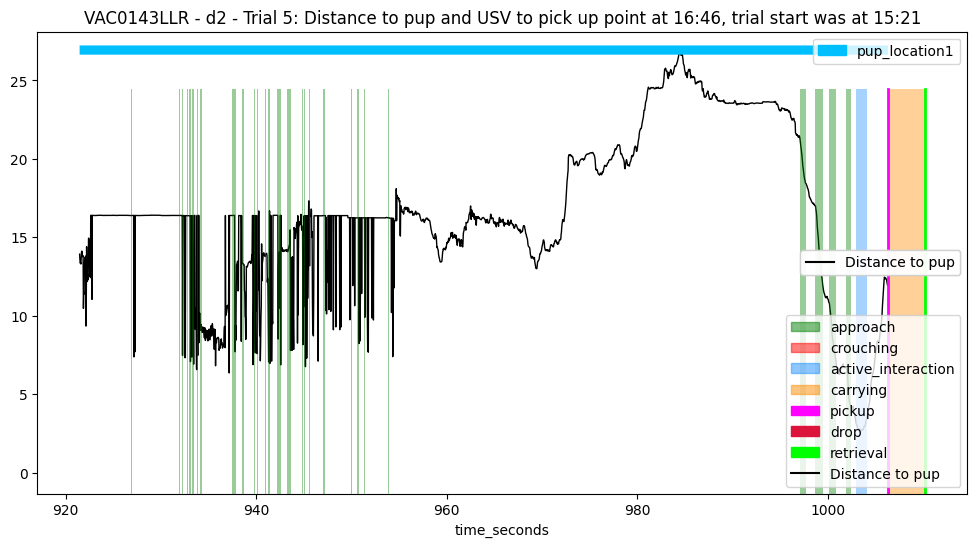

 ==== Example: VAC0143LLR - d2 - 6 ==== 
 ==== Example: VAC0143LLR - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1068.716
* Success time: 1073.284
---> Pick up frame: 32061, Start frame: 30999, End frame: 32198
---> Retrieval frame: 32199; Start frame: 30999; End frame: 32198
---> Final frame: 32198
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  32061 * Pickup time:  1068.716
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1200
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        95
distance

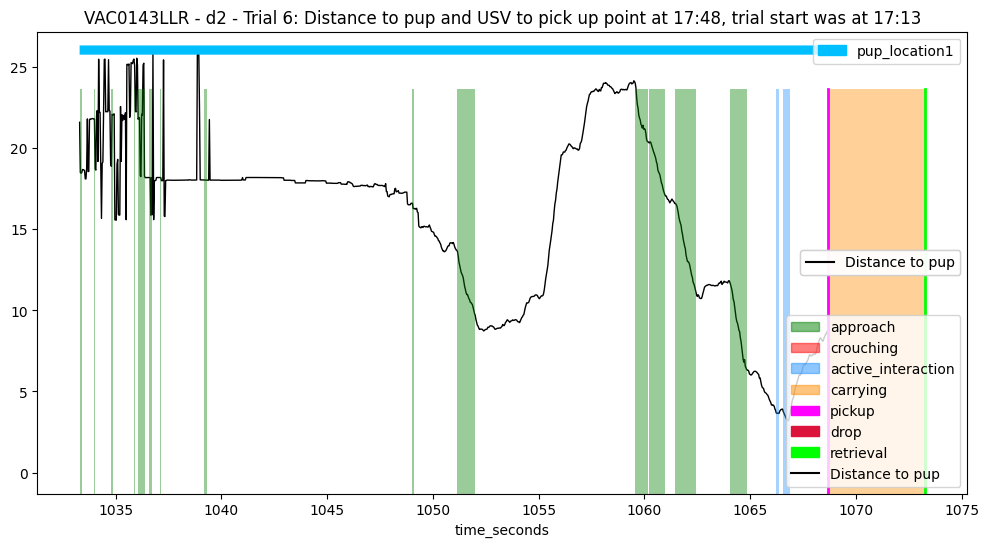

 ==== Example: VAC0143LLR - d2 - 7 ==== 
 ==== Example: VAC0143LLR - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1103.296
* Success time: 1106.104
---> Pick up frame: 33099, Start frame: 32763, End frame: 33183
---> Retrieval frame: 33183; Start frame: 32763; End frame: 33183
---> Final frame: 33183
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  33099 * Pickup time:  1103.296
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 421
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        57
distance_

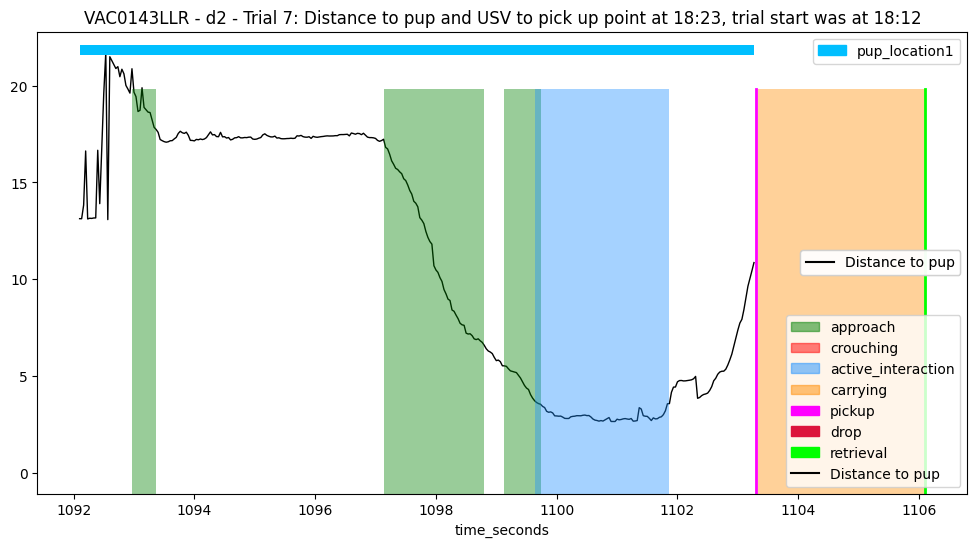

 ==== Example: VAC0143LLR - d2 - 8 ==== 
 ==== Example: VAC0143LLR - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1219.615
* Success time: 1221.767
---> Pick up frame: 36588, Start frame: 33596, End frame: 36653
---> Retrieval frame: 36653; Start frame: 33596; End frame: 36653
---> Final frame: 36653
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  36588 * Pickup time:  1219.615
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3058
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        97
distance

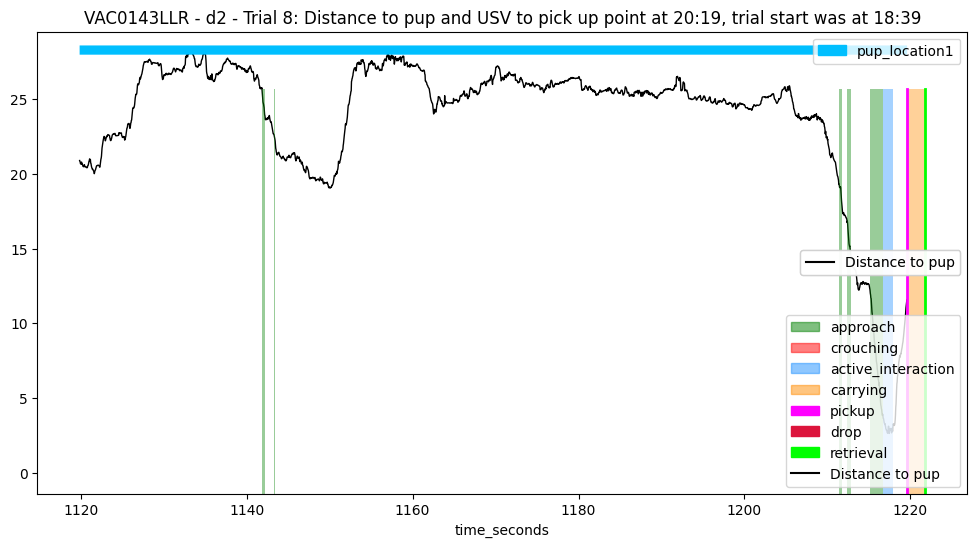

 ==== Example: VAC0143LLR - d2 - 9 ==== 
 ==== Example: VAC0143LLR - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3753
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_degrees    0
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_d

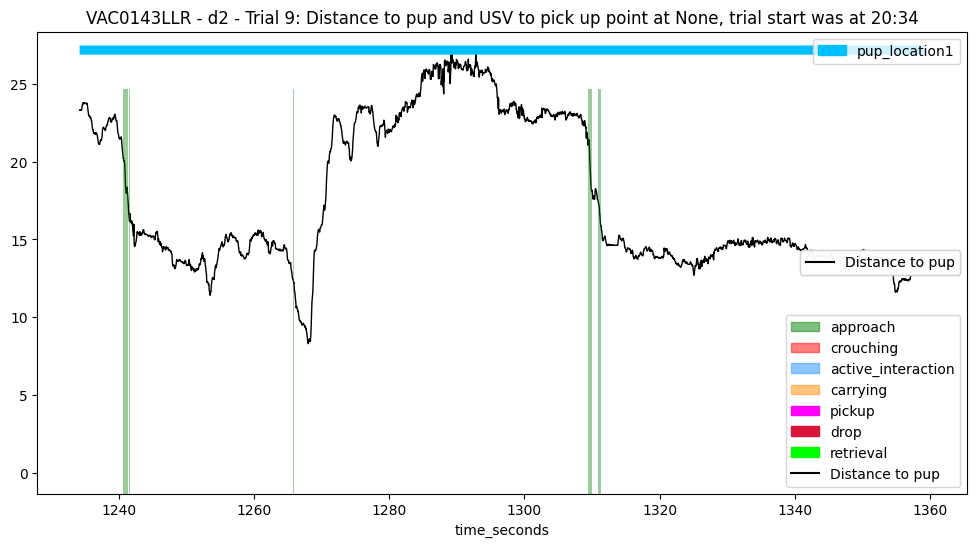

 ==== Example: VAC0143LLR - d3 - 1 ==== 
 ==== Example: VAC0143LLR - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 400.992
* Success time: None
---> Pick up frame: 12030, Start frame: 11874, End frame: 15506
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  12030 * Pickup time:  400.992
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3633
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        76
distance_head_to_pup         76
head_angle_to_pup_degrees    76
dtype: int64


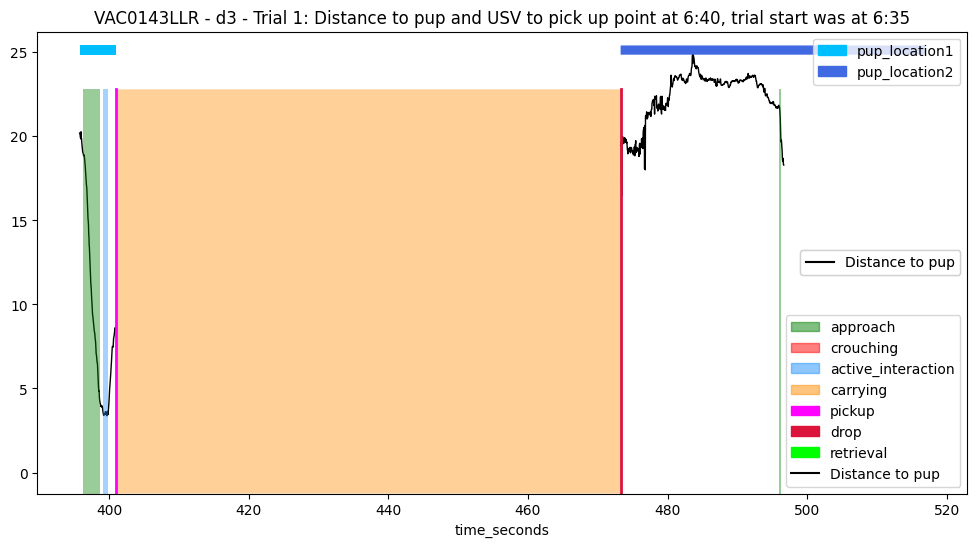

 ==== Example: VAC0143LLR - d3 - 2 ==== 
 ==== Example: VAC0143LLR - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 525.544
* Success time: 528.977
---> Pick up frame: 15766, Start frame: 15613, End frame: 15869
---> Retrieval frame: 15869; Start frame: 15613; End frame: 15869
---> Final frame: 15869
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15766 * Pickup time:  525.544
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 257
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        67
distance_hea

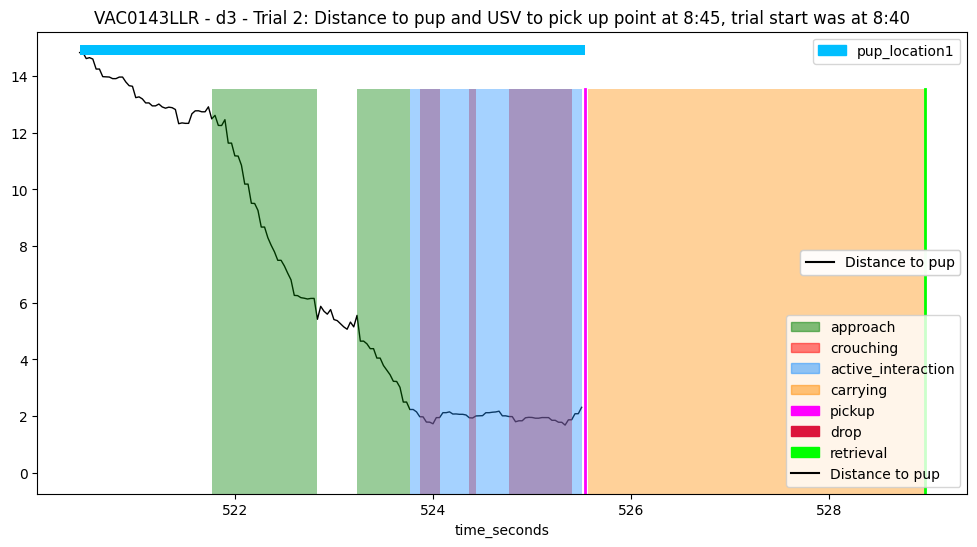

 ==== Example: VAC0143LLR - d3 - 3 ==== 
 ==== Example: VAC0143LLR - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 566.661
* Success time: 572.008
---> Pick up frame: 17000, Start frame: 16402, End frame: 17160
---> Retrieval frame: 17160; Start frame: 16402; End frame: 17160
---> Final frame: 17160
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17000 * Pickup time:  566.661
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 759
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        13
distance_hea

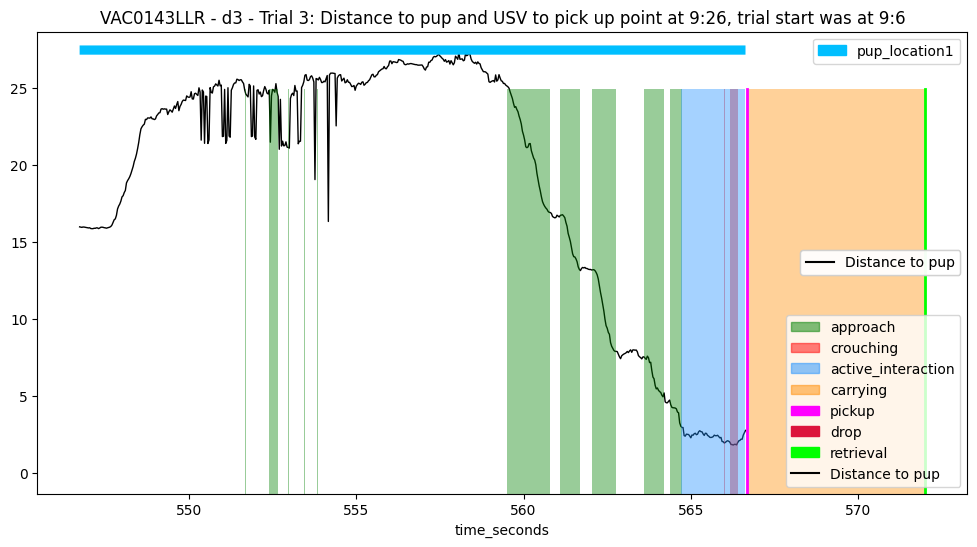

 ==== Example: VAC0143LLR - d3 - 4 ==== 
 ==== Example: VAC0143LLR - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 588.096
* Success time: 589.76
---> Pick up frame: 17643, Start frame: 17451, End frame: 17692
---> Retrieval frame: 17693; Start frame: 17451; End frame: 17692
---> Final frame: 17692
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17643 * Pickup time:  588.096
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 242
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_head

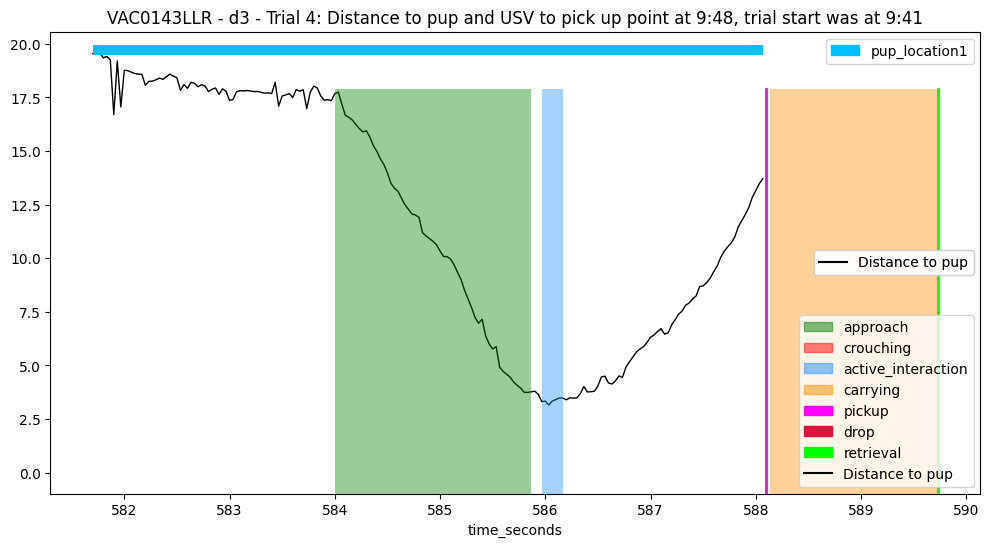

 ==== Example: VAC0143LLR - d3 - 5 ==== 
 ==== Example: VAC0143LLR - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 614.185
* Success time: 619.253
---> Pick up frame: 18426, Start frame: 17994, End frame: 18577
---> Retrieval frame: 18578; Start frame: 17994; End frame: 18577
---> Final frame: 18577
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18426 * Pickup time:  614.185
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 584
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        80
distance_hea

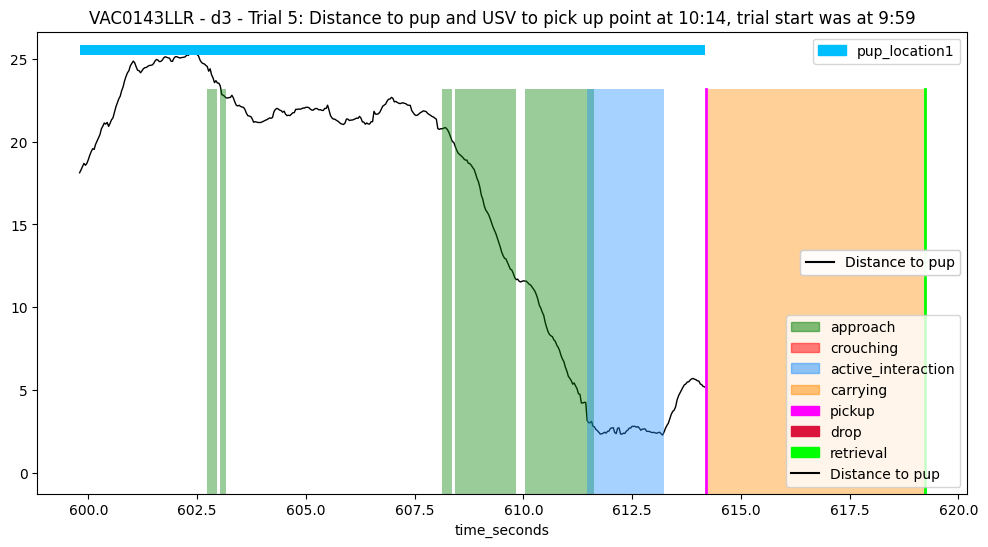

 ==== Example: VAC0143LLR - d3 - 6 ==== 
 ==== Example: VAC0143LLR - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 704.463
* Success time: 707.856
---> Pick up frame: 21134, Start frame: 19660, End frame: 21235
---> Retrieval frame: 21236; Start frame: 19660; End frame: 21235
---> Final frame: 21235
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21134 * Pickup time:  704.463
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1576
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_hea

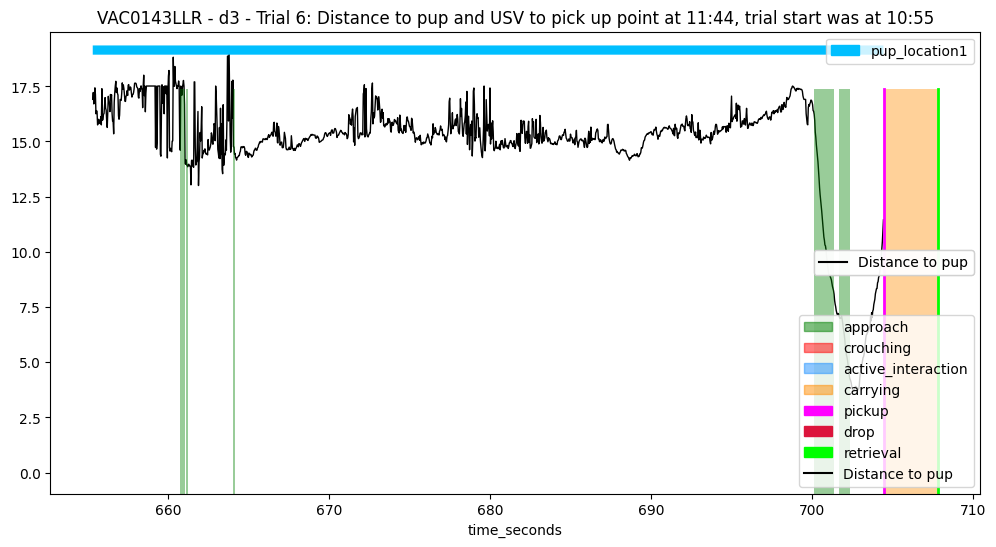

 ==== Example: VAC0143LLR - d3 - 7 ==== 
 ==== Example: VAC0143LLR - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 743.34
* Success time: 746.404
---> Pick up frame: 22300, Start frame: 21689, End frame: 22392
---> Retrieval frame: 22392; Start frame: 21689; End frame: 22392
---> Final frame: 22392
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22300 * Pickup time:  743.34
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 704
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        64
distance_head_

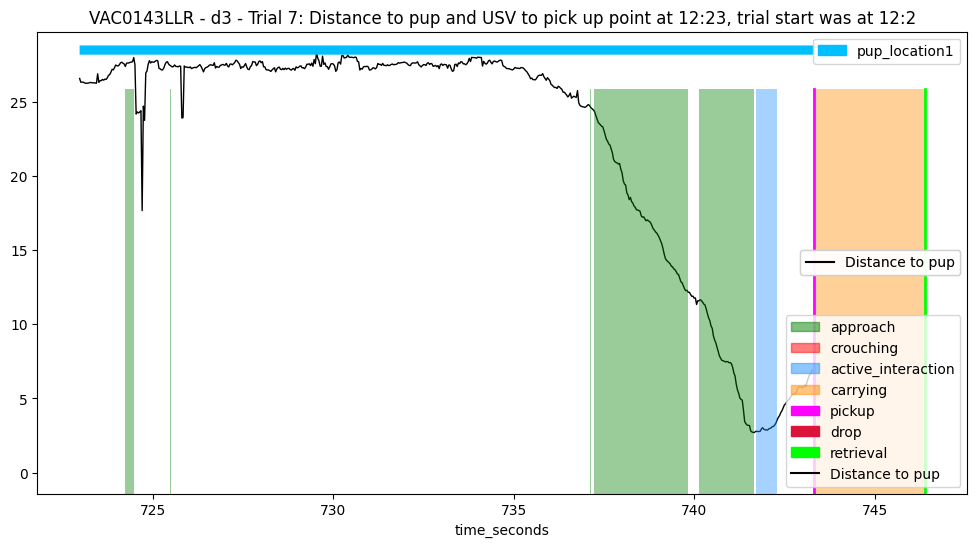

 ==== Example: VAC0143LLR - d3 - 8 ==== 
 ==== Example: VAC0143LLR - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 766.166
* Success time: 769.607
---> Pick up frame: 22985, Start frame: 22718, End frame: 23088
---> Retrieval frame: 23088; Start frame: 22718; End frame: 23088
---> Final frame: 23088
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22985 * Pickup time:  766.166
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 371
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        78
distance_hea

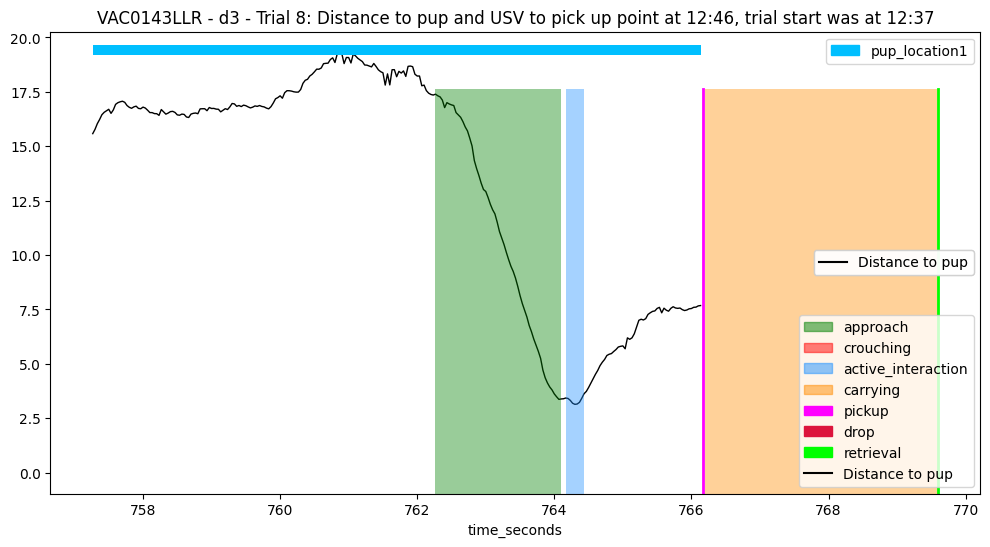

 ==== Example: VAC0143LLR - d3 - 9 ==== 
 ==== Example: VAC0143LLR - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 786.03
* Success time: 788.334
---> Pick up frame: 23581, Start frame: 23491, End frame: 23650
---> Retrieval frame: 23650; Start frame: 23491; End frame: 23650
---> Final frame: 23650
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  23581 * Pickup time:  786.03
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 160
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        81
distance_head_

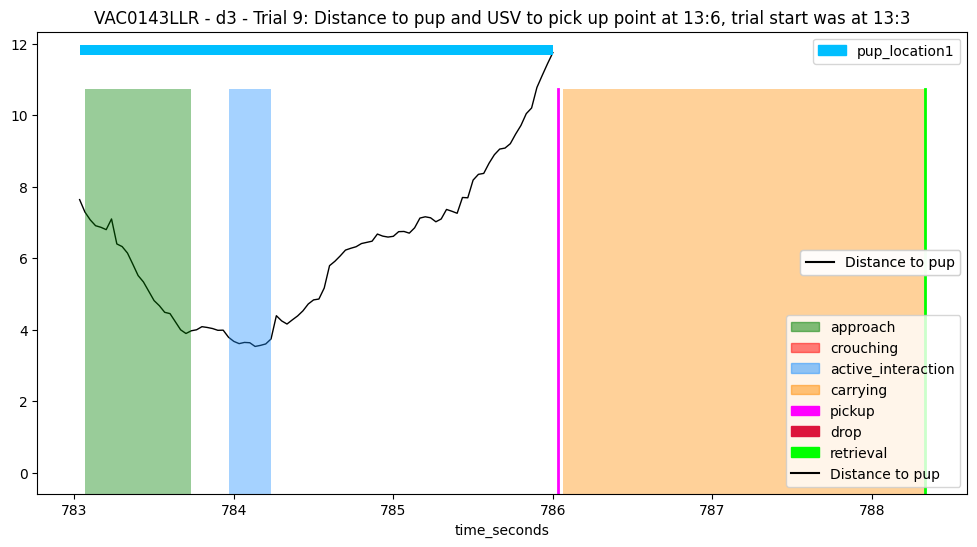

 ==== Example: VAC0143LLR - d4 - 1 ==== 
 ==== Example: VAC0143LLR - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 443.232
* Success time: 447.841
---> Pick up frame: 13297, Start frame: 12953, End frame: 13435
---> Retrieval frame: 13435; Start frame: 12953; End frame: 13435
---> Final frame: 13435
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13297 * Pickup time:  443.232
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 483
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        17
distance_hea

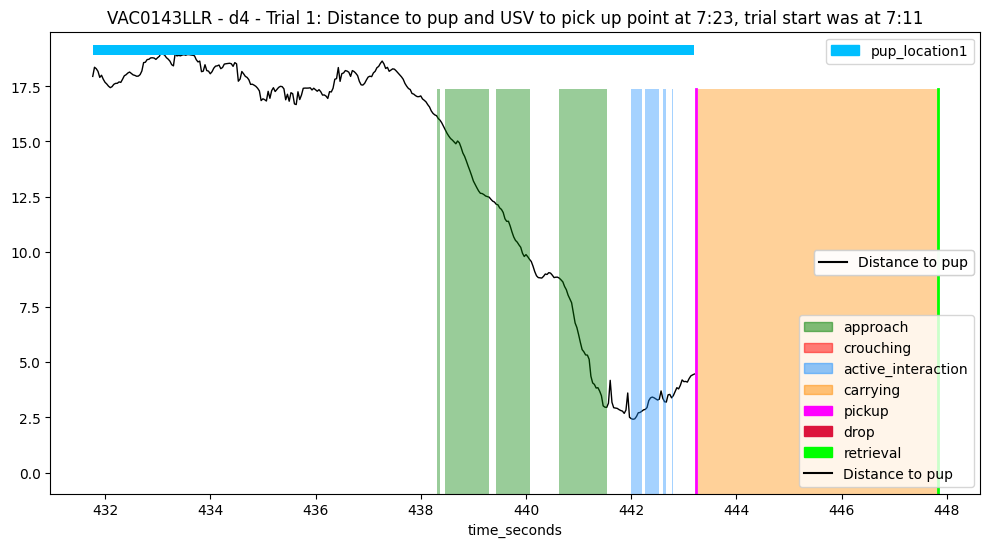

 ==== Example: VAC0143LLR - d4 - 2 ==== 
 ==== Example: VAC0143LLR - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 464.612
* Success time: 469.604
---> Pick up frame: 13938, Start frame: 13814, End frame: 14088
---> Retrieval frame: 14088; Start frame: 13814; End frame: 14088
---> Final frame: 14088
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  13938 * Pickup time:  464.612
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 275
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        61
distance_hea

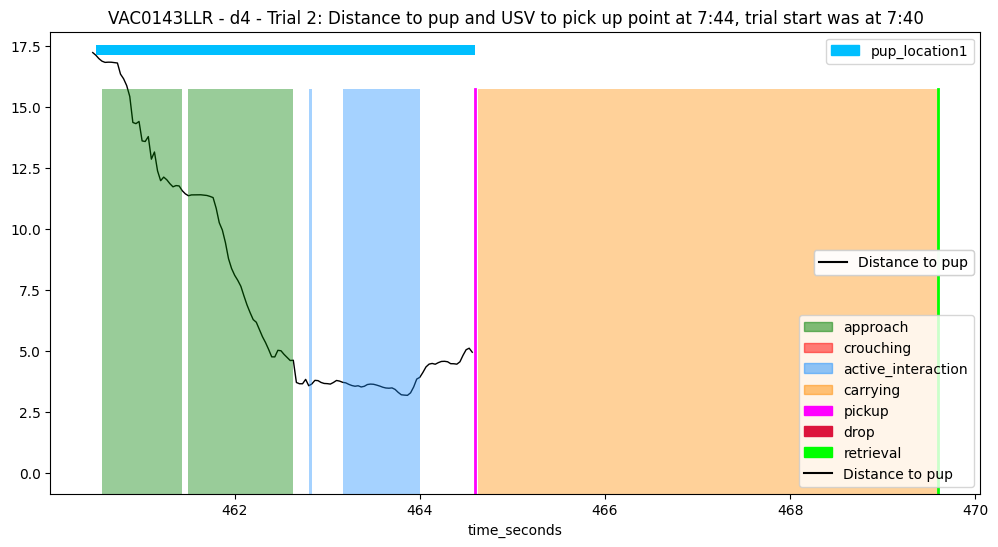

 ==== Example: VAC0143LLR - d4 - 3 ==== 
 ==== Example: VAC0143LLR - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 513.965
* Success time: None
---> Pick up frame: 15419, Start frame: 15343, End frame: 18991
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  15419 * Pickup time:  513.965
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3649
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        32
distance_head_to_pup         32
head_angle_to_pup_degrees    32
dtype: int64


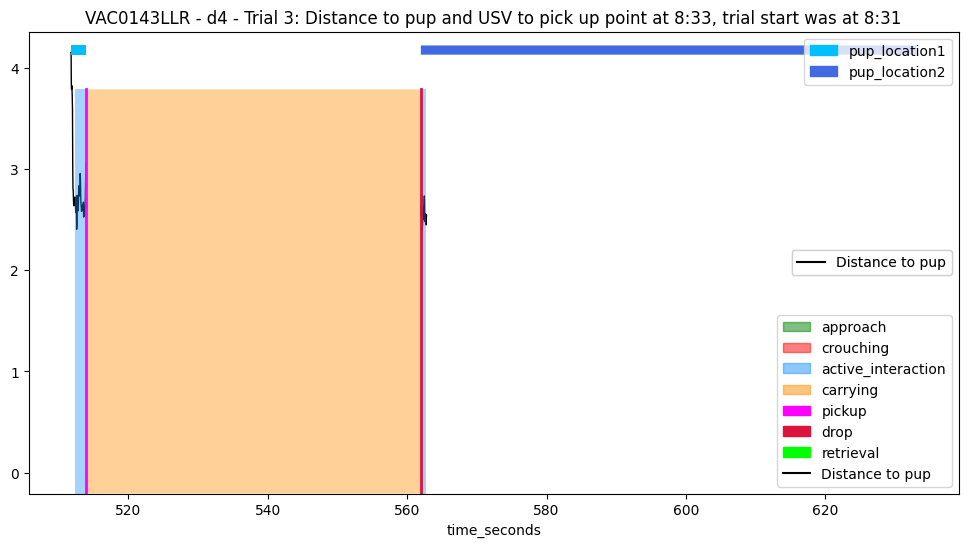

 ==== Example: VAC0143LLR - d4 - 4 ==== 
 ==== Example: VAC0143LLR - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 643.53
* Success time: 647.73
---> Pick up frame: 19306, Start frame: 19132, End frame: 19431
---> Retrieval frame: 19432; Start frame: 19132; End frame: 19431
---> Final frame: 19431
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19306 * Pickup time:  643.53
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 300
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        71
distance_head_t

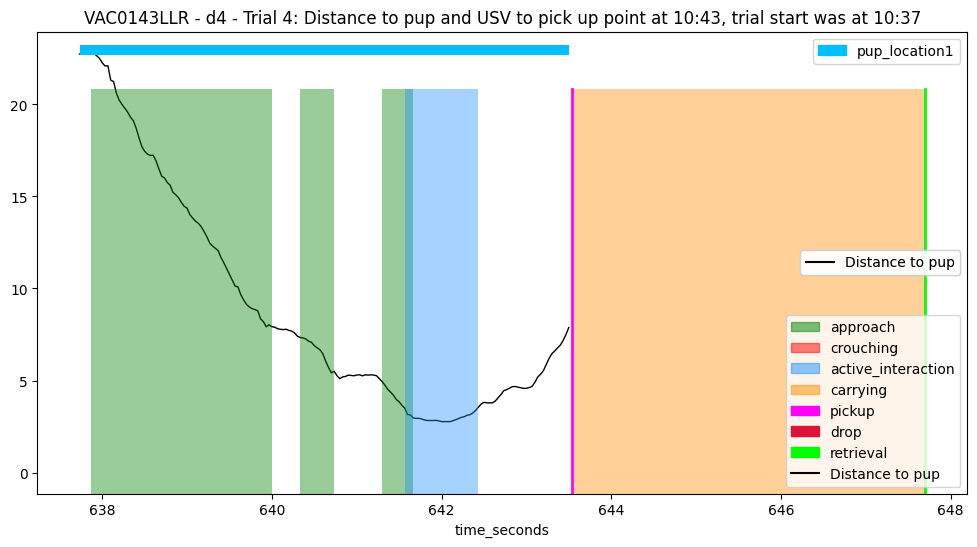

 ==== Example: VAC0143LLR - d4 - 5 ==== 
 ==== Example: VAC0143LLR - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3923
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        81
distance_head_to_pup         81
head_angle_to_pup_degrees    81
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        81
distance_head_to_pup         81
head_angle_to_

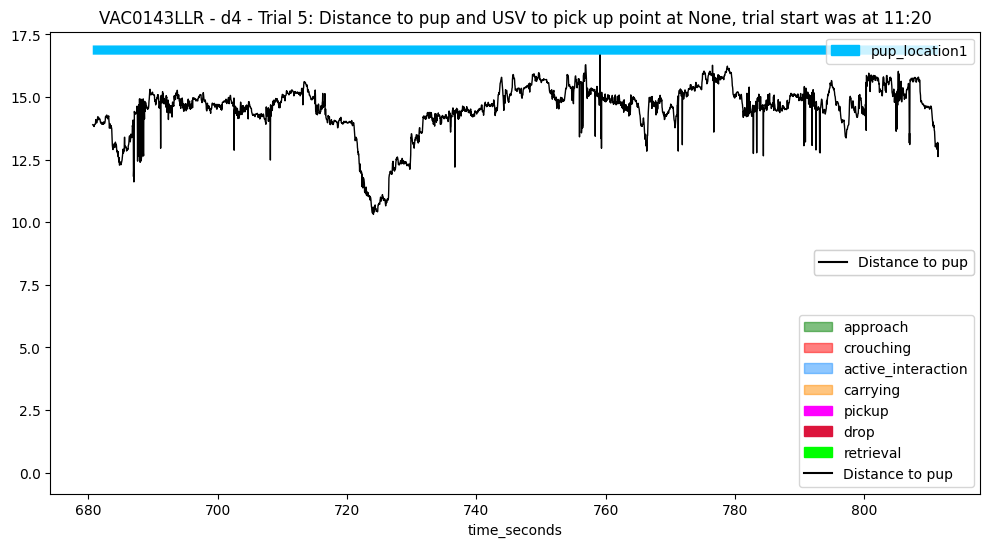

 ==== Example: VAC0143LLR - d4 - 6 ==== 
 ==== Example: VAC0143LLR - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3871
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        155
distance_head_to_pup         155
head_angle_to_pup_degrees    155
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        155
distance_head_to_pup         233
head_angl

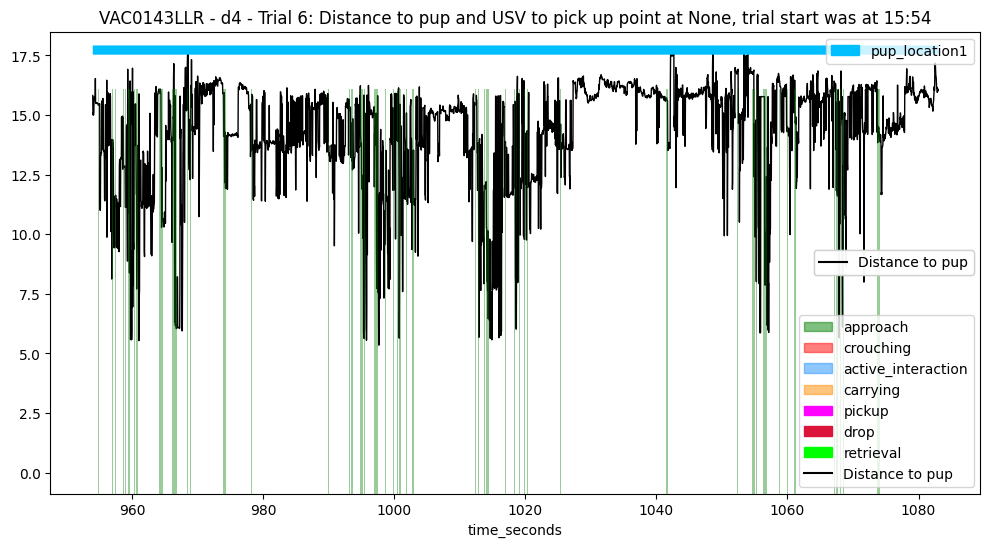

 ==== Example: VAC0143LLR - d4 - 7 ==== 
 ==== Example: VAC0143LLR - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3742
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        126
distance_head_to_pup         126
head_angle_to_pup_degrees    126
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        433
distance_head_to_pup         433
head_angl

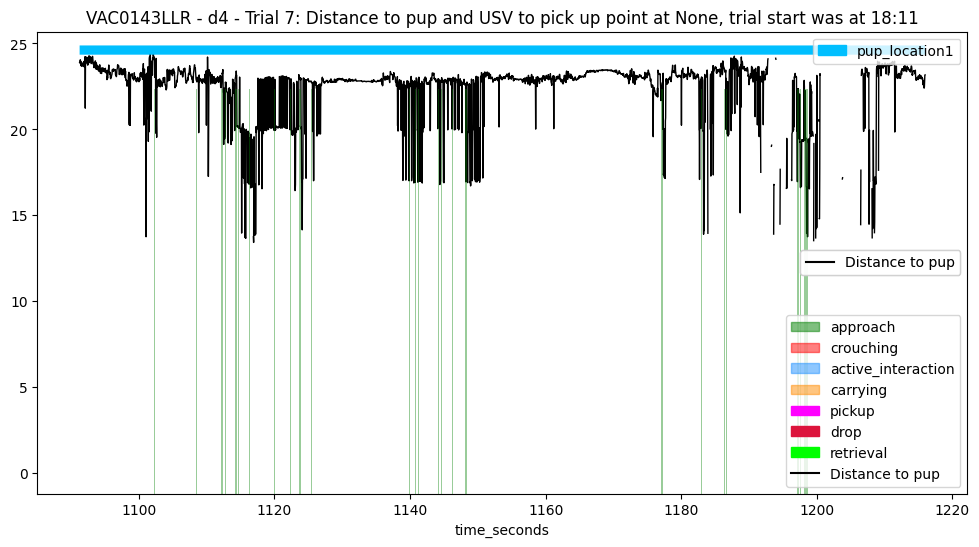

 ==== Example: VAC0143LLR - d4 - 8 ==== 
 ==== Example: VAC0143LLR - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3724
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        99
distance_head_to_pup         99
head_angle_to_pup_degrees    99
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        197
distance_head_to_pup         197
head_angle_t

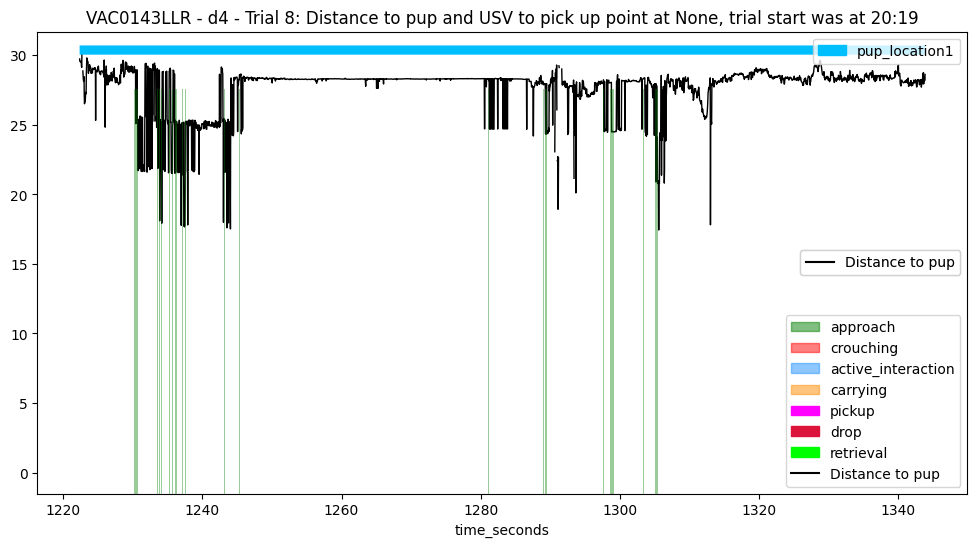

 ==== Example: VAC0143LLR - d4 - 9 ==== 
 ==== Example: VAC0143LLR - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1456.784
* Success time: 1460.825
---> Pick up frame: 43704, Start frame: 40604, End frame: 43824
---> Retrieval frame: 43825; Start frame: 40604; End frame: 43824
---> Final frame: 43824
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  43704 * Pickup time:  1456.784
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3221
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        114
distanc

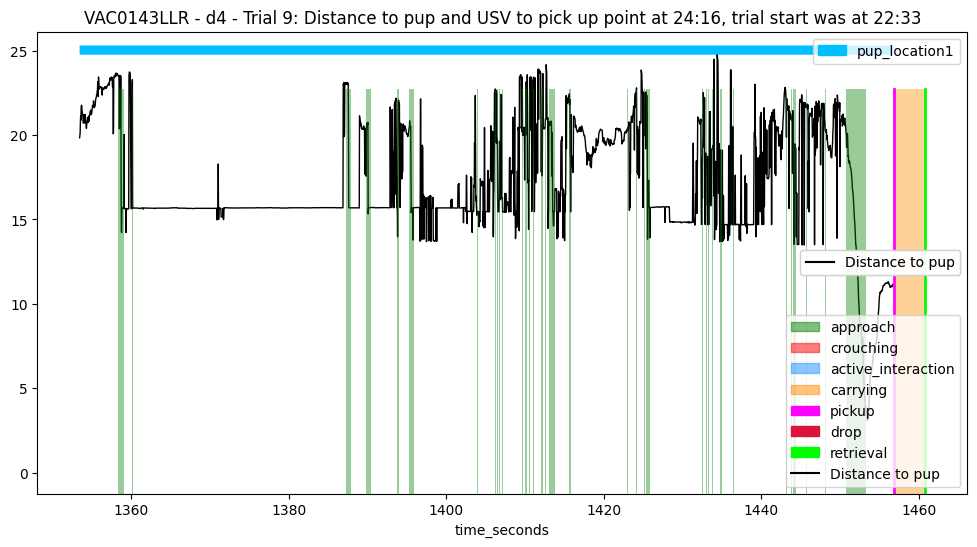

 ==== Example: VAC0143LLR - d5 - 1 ==== 
 ==== Example: VAC0143LLR - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 394.282
* Success time: None
---> Pick up frame: 11828, Start frame: 11687, End frame: 15335
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  11828 * Pickup time:  394.282
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3649
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 11828, instantly drop at 11829
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        104
distance_hea

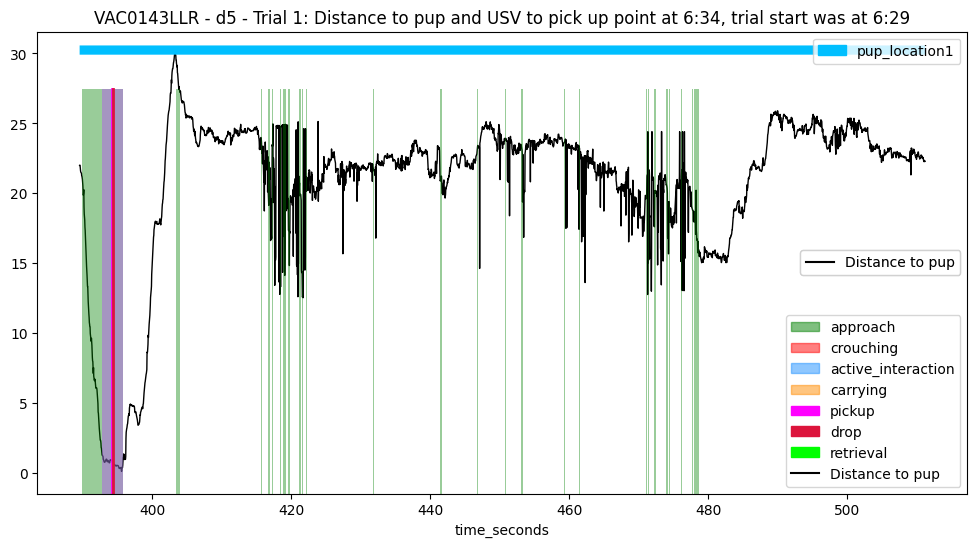

 ==== Example: VAC0143LLR - d5 - 2 ==== 
 ==== Example: VAC0143LLR - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 526.355
* Success time: 528.539
---> Pick up frame: 15791, Start frame: 15511, End frame: 15856
---> Retrieval frame: 15856; Start frame: 15511; End frame: 15856
---> Final frame: 15856
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15791 * Pickup time:  526.355
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 346
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_hea

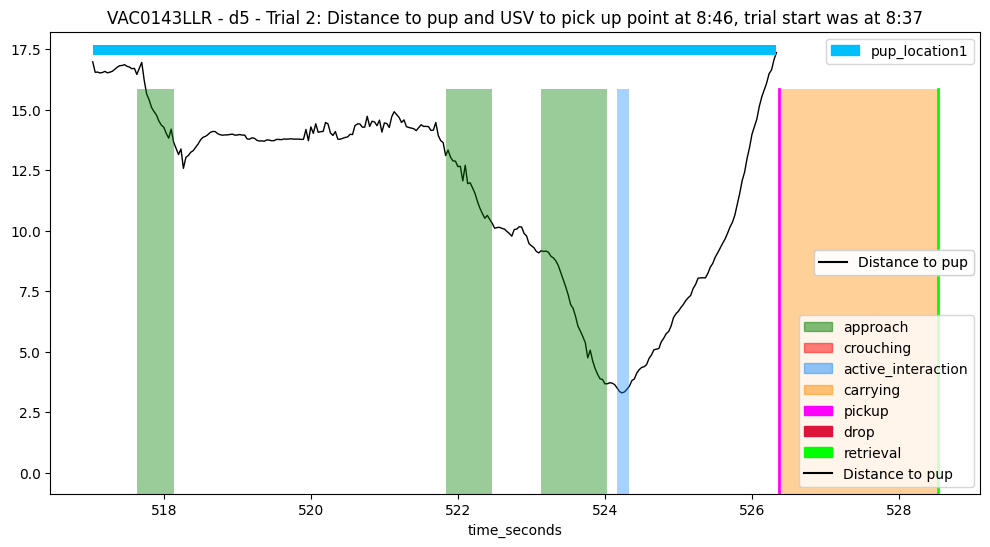

 ==== Example: VAC0143LLR - d5 - 3 ==== 
 ==== Example: VAC0143LLR - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3974
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_degrees    0
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_d

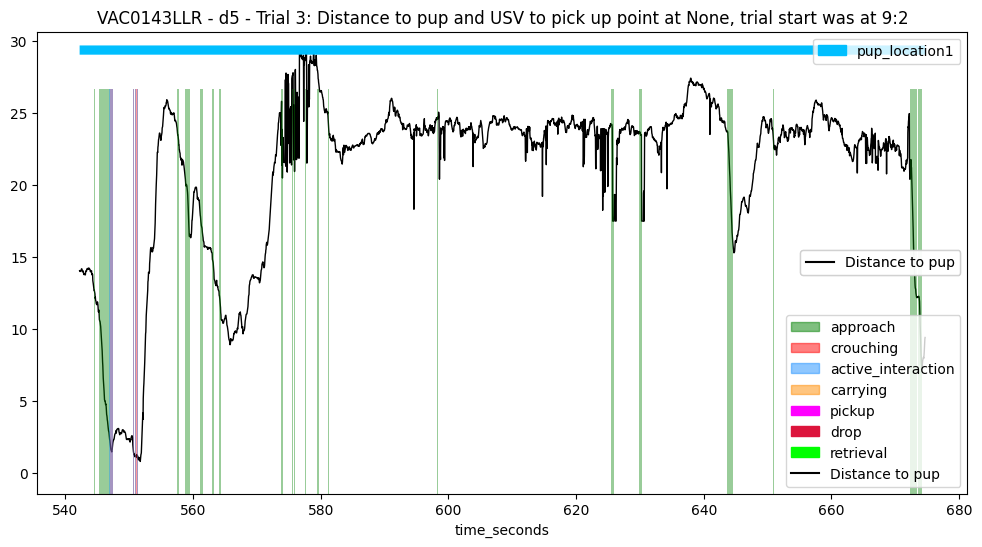

 ==== Example: VAC0143LLR - d5 - 4 ==== 
 ==== Example: VAC0143LLR - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3685
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_degrees    0
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        0
distance_head_to_pup         0
head_angle_to_pup_d

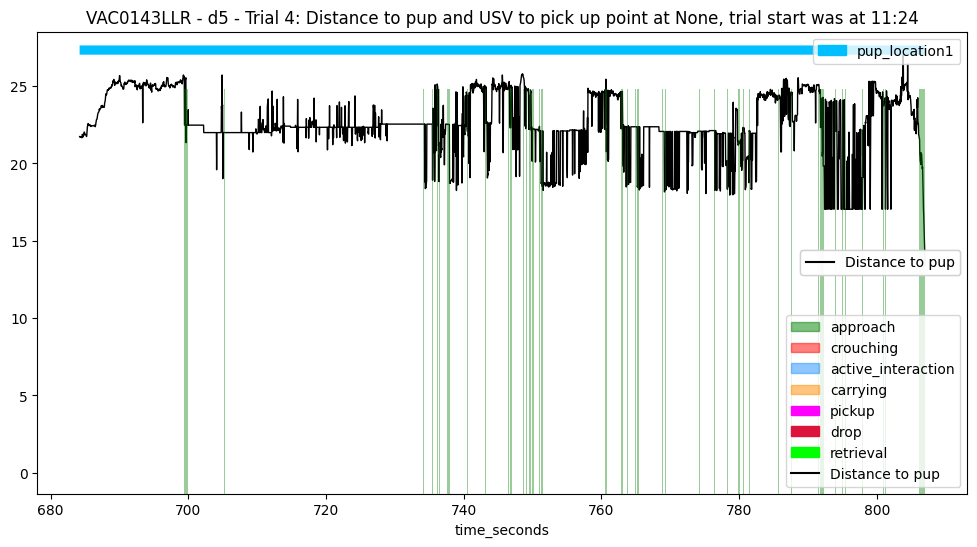

 ==== Example: VAC0143LLR - d5 - 5 ==== 
 ==== Example: VAC0143LLR - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 818.0
* Success time: 822.0
---> Pick up frame: 24540, Start frame: 24420, End frame: 24660
---> Retrieval frame: 24660; Start frame: 24420; End frame: 24660
---> Final frame: 24660
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24540 * Pickup time:  818.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 241
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 24540, instantly drop at 24541
---> Processing last pup location: pup

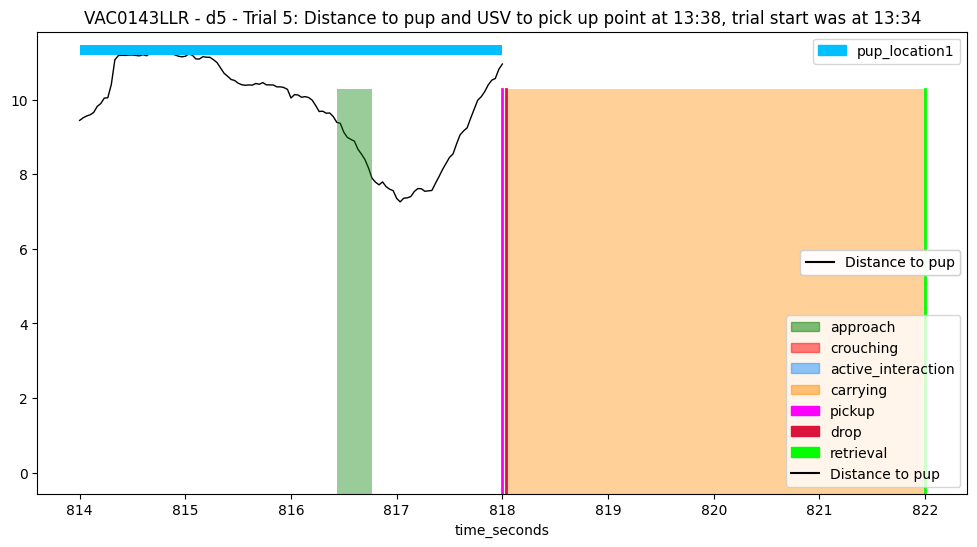

 ==== Example: VAC0143LLR - d5 - 6 ==== 
 ==== Example: VAC0143LLR - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 854.0
* Success time: 856.0
---> Pick up frame: 25620, Start frame: 25290, End frame: 25680
---> Retrieval frame: 25680; Start frame: 25290; End frame: 25680
---> Final frame: 25680
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25620 * Pickup time:  854.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 391
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        119
distance_head_to_

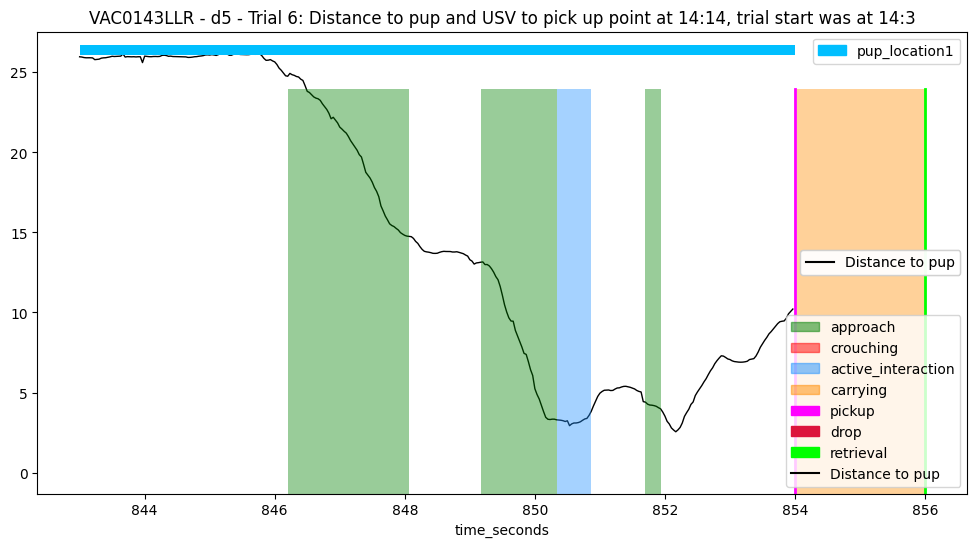

 ==== Example: VAC0143LLR - d5 - 7 ==== 
 ==== Example: VAC0143LLR - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 873.0
* Success time: None
---> Pick up frame: 26190, Start frame: 26040, End frame: 29760
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  26190 * Pickup time:  873.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3721
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        124
distance_head_to_pup         124
head_angle_to_pup_degrees    124
dtype: int64
-

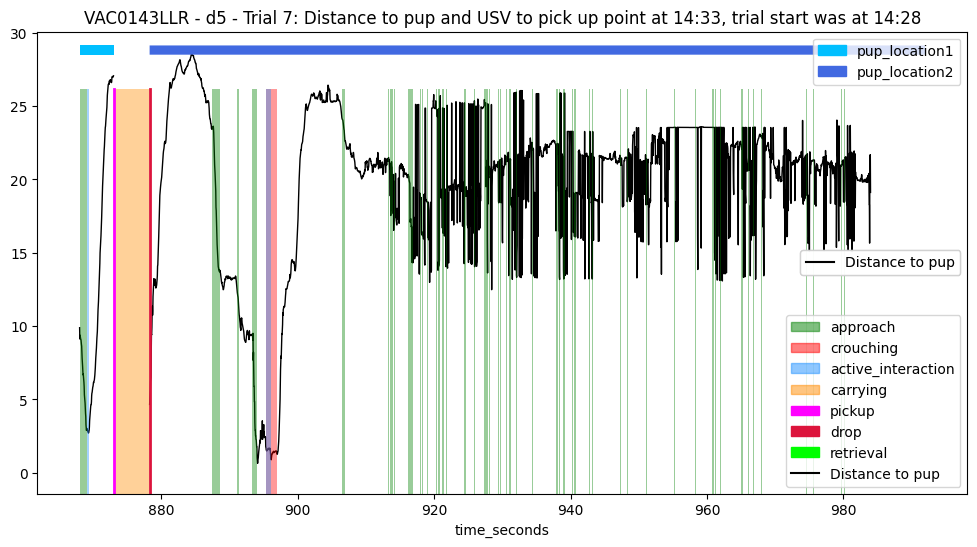

 ==== Example: VAC0143LLR - d5 - 8 ==== 
 ==== Example: VAC0143LLR - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3781
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        191
distance_head_to_pup         191
head_angle_to_pup_degrees    191
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        191
distance_head_to_pup         191
head_angl

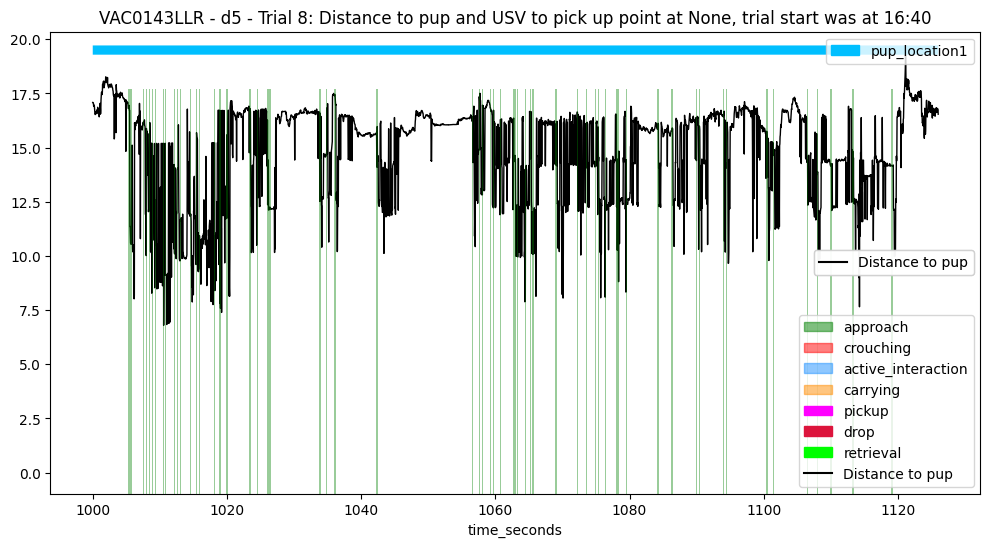

 ==== Example: VAC0143LLR - d5 - 9 ==== 
 ==== Example: VAC0143LLR - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1202.721
* Success time: 1205.201
---> Pick up frame: 36082, Start frame: 33960, End frame: 36156
---> Retrieval frame: 36156; Start frame: 33960; End frame: 36156
---> Final frame: 36156
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  36082 * Pickup time:  1202.721
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2197
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        97
distance

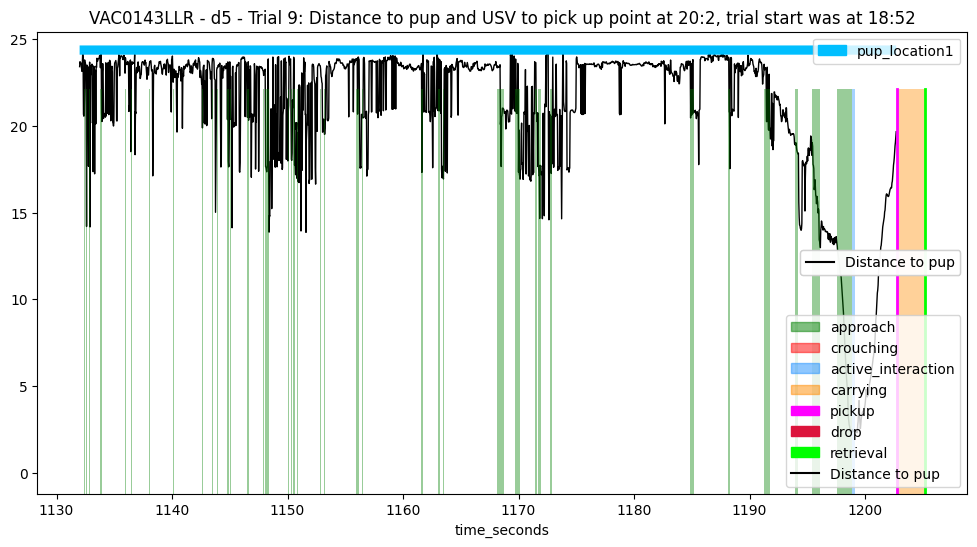

 ==== Example: VAC0143LLR - d6 - 1 ==== 
 ==== Example: VAC0143LLR - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 422.0
* Success time: 445.0
---> Pick up frame: 12660, Start frame: 12600, End frame: 13350
---> Retrieval frame: 13350; Start frame: 12600; End frame: 13350
---> Final frame: 13350
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12660 * Pickup time:  422.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 751
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 12660, instantly drop at 12661
---> Processing last pup location: pup

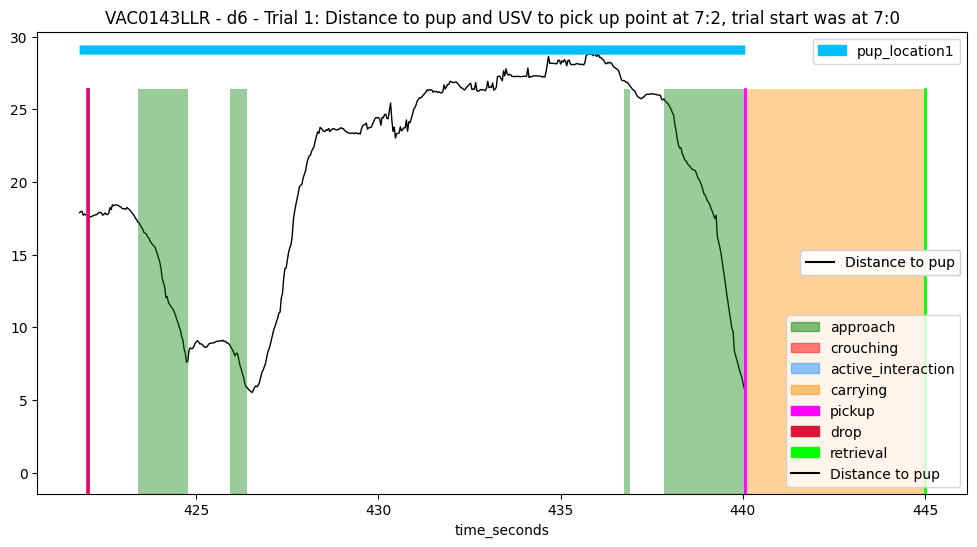

 ==== Example: VAC0143LLR - d6 - 2 ==== 
 ==== Example: VAC0143LLR - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 473.0
* Success time: 478.0
---> Pick up frame: 14190, Start frame: 13770, End frame: 14340
---> Retrieval frame: 14340; Start frame: 13770; End frame: 14340
---> Final frame: 14340
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14190 * Pickup time:  473.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 571
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to_p

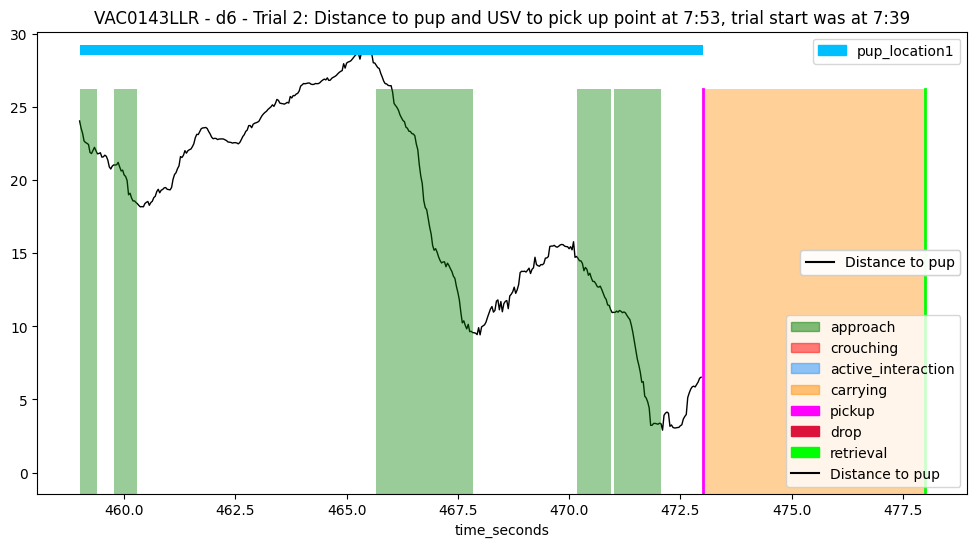

 ==== Example: VAC0143LLR - d6 - 3 ==== 
 ==== Example: VAC0143LLR - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4034
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        4034
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 500.0 to 500.4666666666

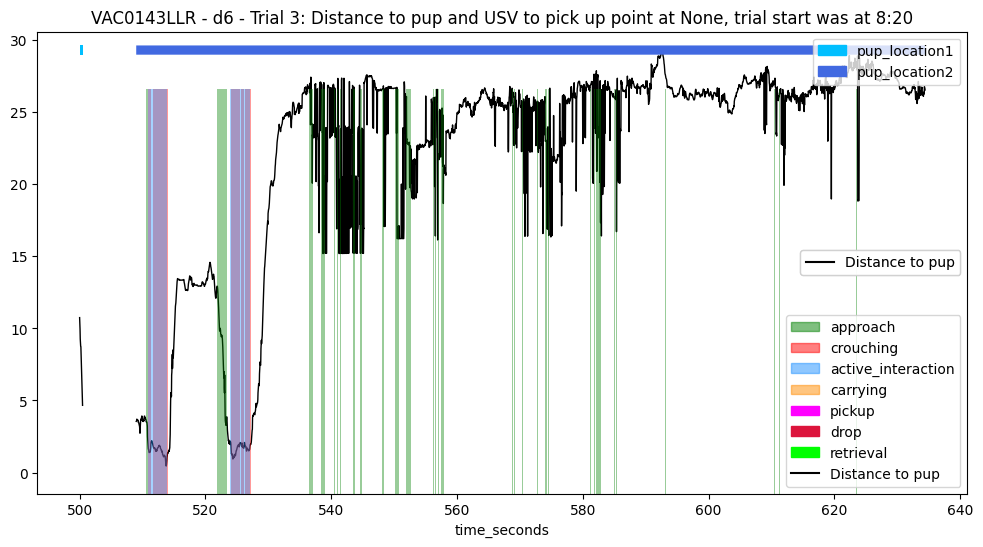

 ==== Example: VAC0143LLR - d6 - 4 ==== 
 ==== Example: VAC0143LLR - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 650.114
* Success time: 651.906
---> Pick up frame: 19503, Start frame: 19246, End frame: 19557
---> Retrieval frame: 19557; Start frame: 19246; End frame: 19557
---> Final frame: 19557
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19503 * Pickup time:  650.114
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 312
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        72
distance_hea

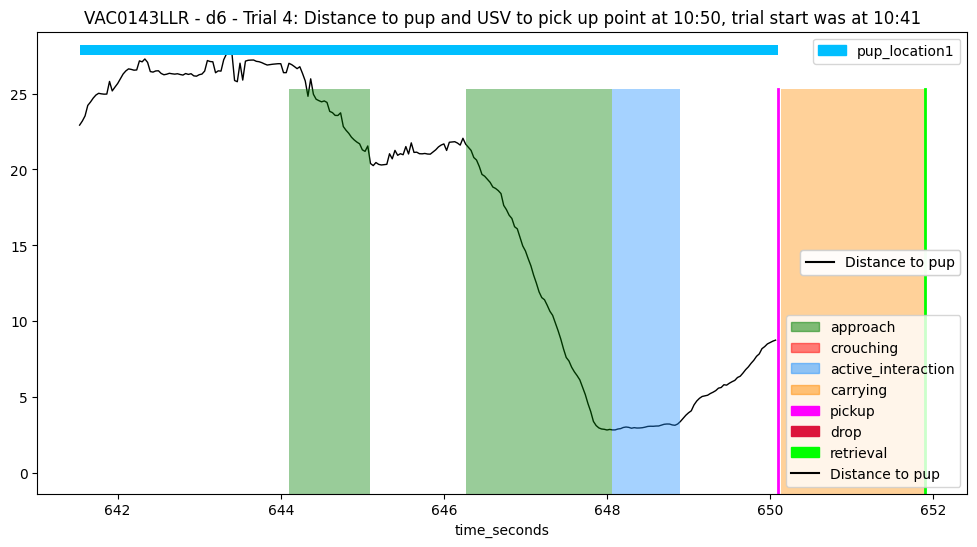

 ==== Example: VAC0143LLR - d6 - 5 ==== 
 ==== Example: VAC0143LLR - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 688.078
* Success time: 689.871
---> Pick up frame: 20642, Start frame: 19956, End frame: 20696
---> Retrieval frame: 20696; Start frame: 19956; End frame: 20696
---> Final frame: 20696
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  20642 * Pickup time:  688.078
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 741
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        90
distance_hea

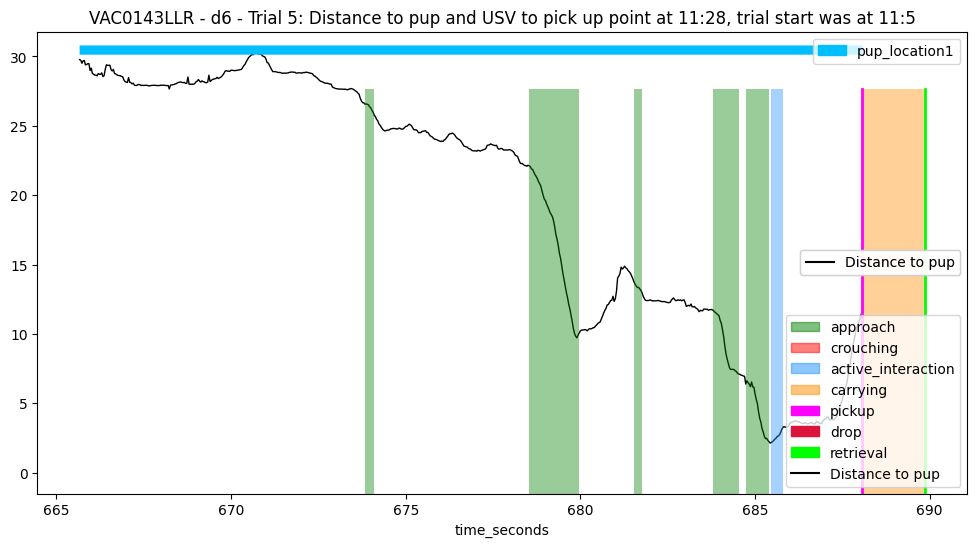

 ==== Example: VAC0143LLR - d6 - 6 ==== 
 ==== Example: VAC0143LLR - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 747.134
* Success time: 751.215
---> Pick up frame: 22414, Start frame: 20998, End frame: 22536
---> Retrieval frame: 22536; Start frame: 20998; End frame: 22536
---> Final frame: 22536
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22414 * Pickup time:  747.134
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1539
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        11
distance_he

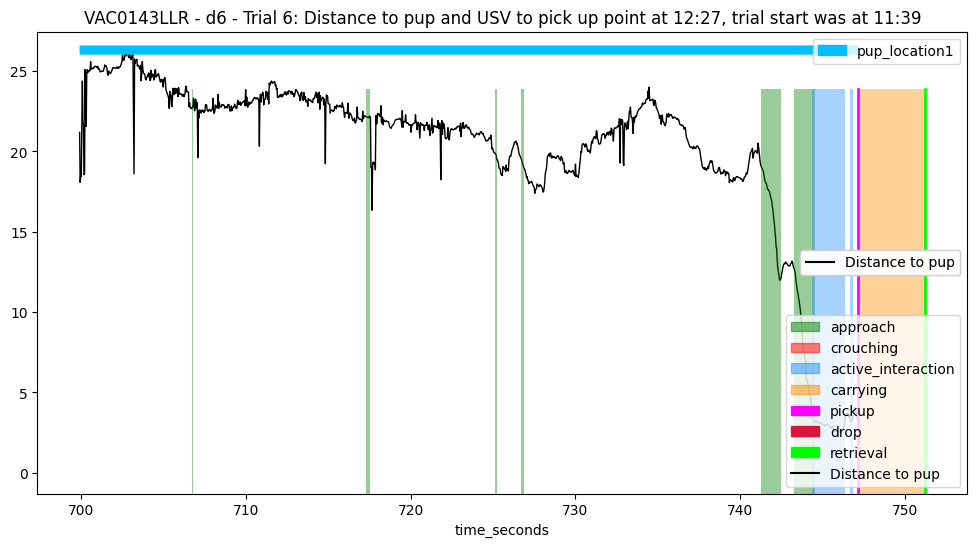

 ==== Example: VAC0143LLR - d6 - 7 ==== 
 ==== Example: VAC0143LLR - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 861.709
* Success time: 865.309
---> Pick up frame: 25851, Start frame: 22889, End frame: 25959
---> Retrieval frame: 25959; Start frame: 22889; End frame: 25959
---> Final frame: 25959
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25851 * Pickup time:  861.709
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3071
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        24
distance_he

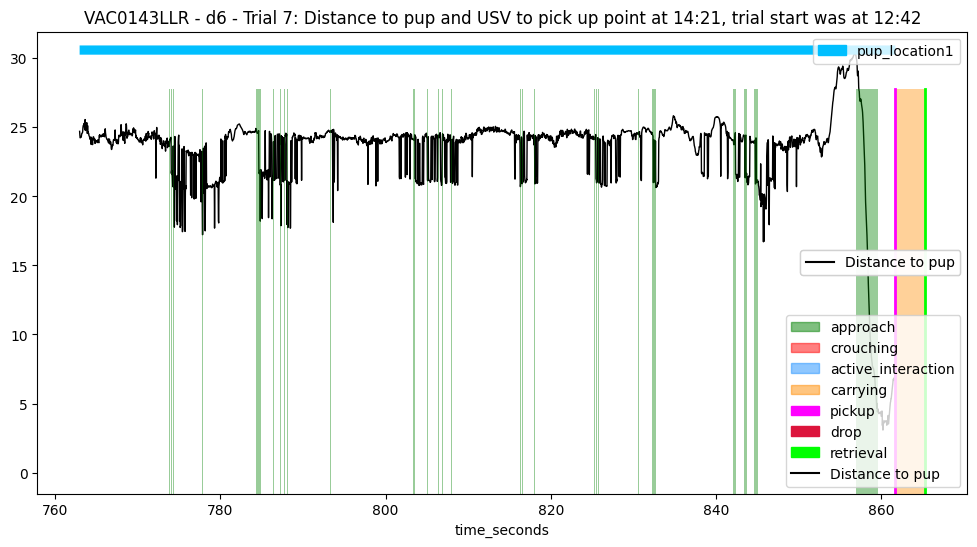

 ==== Example: VAC0143LLR - d6 - 8 ==== 
 ==== Example: VAC0143LLR - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 925.469
* Success time: 926.493
---> Pick up frame: 27764, Start frame: 26339, End frame: 27794
---> Retrieval frame: 27795; Start frame: 26339; End frame: 27794
---> Final frame: 27794
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27764 * Pickup time:  925.469
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1456
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        100
distance_h

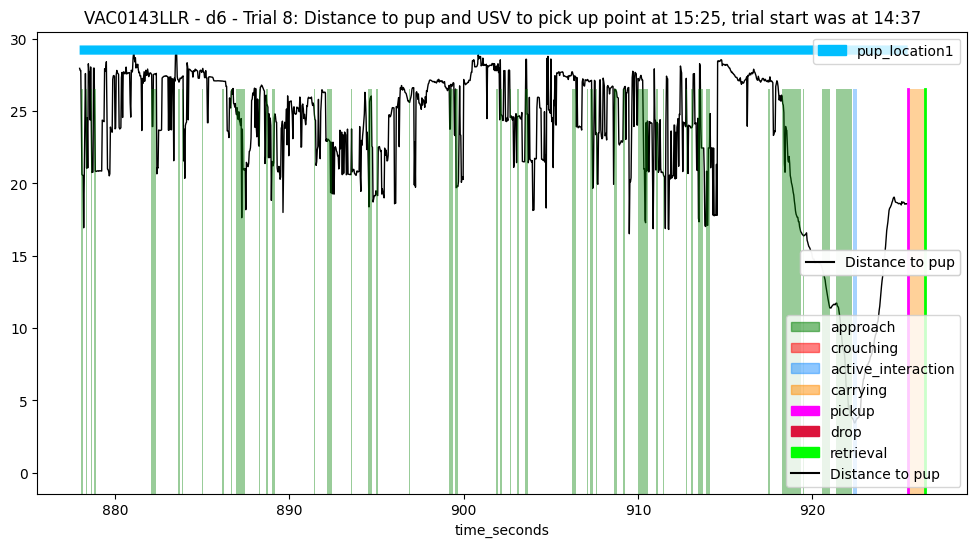

 ==== Example: VAC0143LLR - d6 - 9 ==== 
 ==== Example: VAC0143LLR - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 951.056
* Success time: 953.496
---> Pick up frame: 28532, Start frame: 28262, End frame: 28604
---> Retrieval frame: 28605; Start frame: 28262; End frame: 28604
---> Final frame: 28604
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28532 * Pickup time:  951.056
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 343
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        67
distance_hea

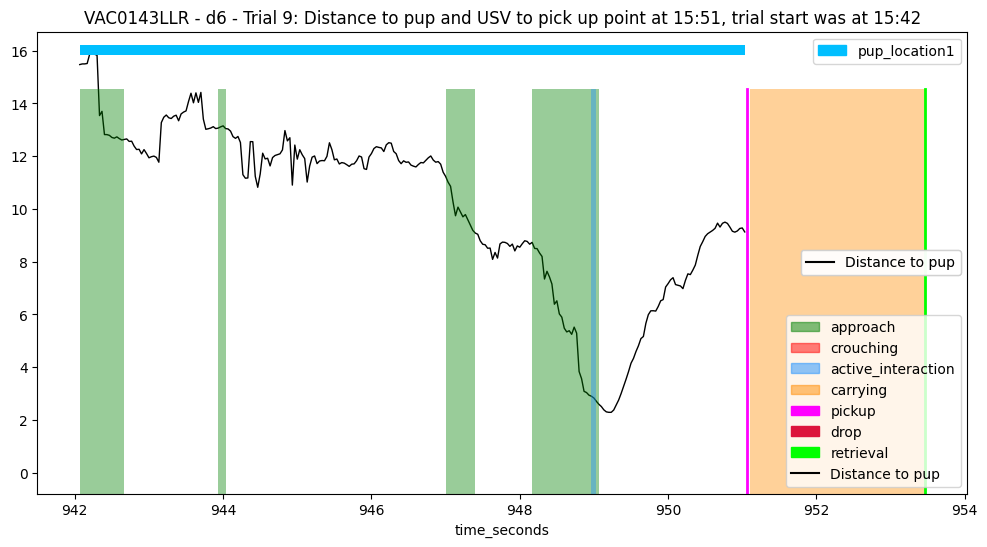

 ==== Example: VBQ0261L - d1 - 1 ==== 
 ==== Example: VBQ0261L - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4068
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        4068
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 435.0 to 442.7
Window lengt

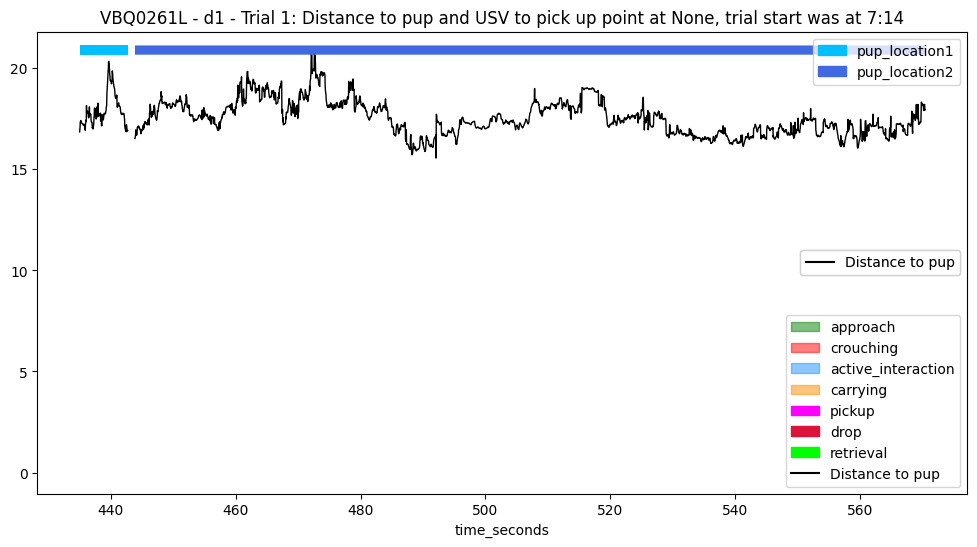

 ==== Example: VBQ0261L - d1 - 2 ==== 
 ==== Example: VBQ0261L - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4274
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_head_to_pup         74
head_angle_to_pup_degrees    74
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        74
distance_head_to_pup         74
head_angle_to_pup_

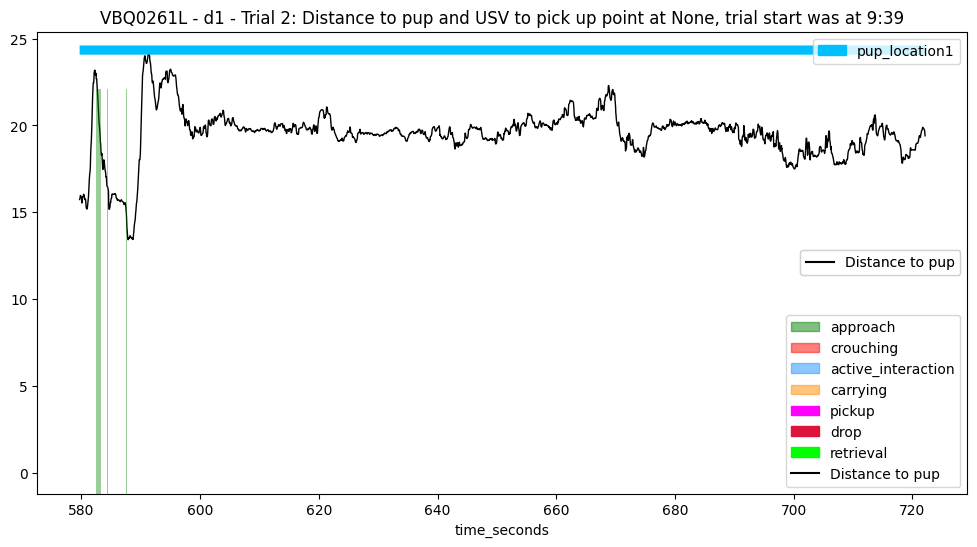

 ==== Example: VBQ0261L - d1 - 3 ==== 
 ==== Example: VBQ0261L - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3713
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3713
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 726.7 to 727.1
Window lengt

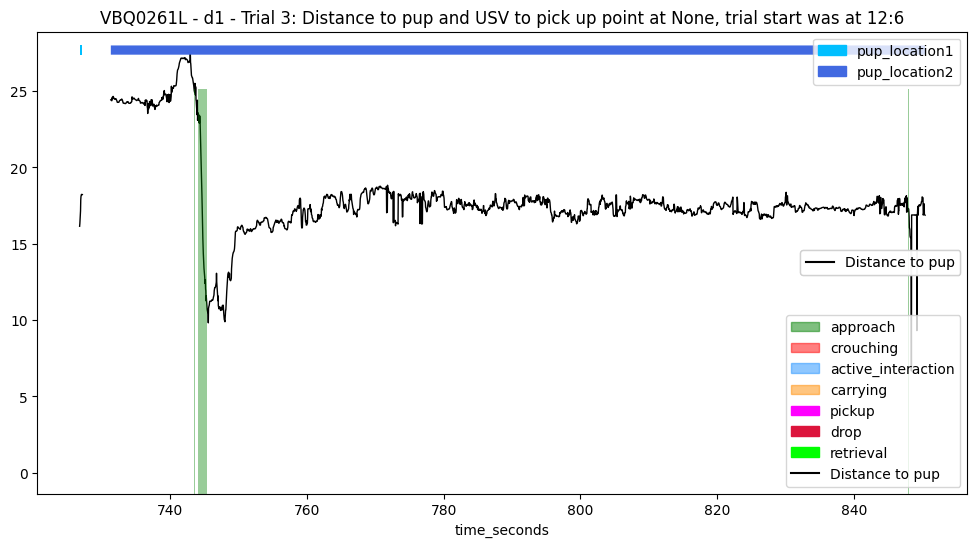

 ==== Example: VBQ0261L - d1 - 4 ==== 
 ==== Example: VBQ0261L - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 864.977
* Success time: None
---> Pick up frame: 25949, Start frame: 25737, End frame: 29474
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  25949 * Pickup time:  864.977
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3738
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        129
distance_head_to_pup         129
head_angle_to_pup_degrees    129
dtype: int64
-

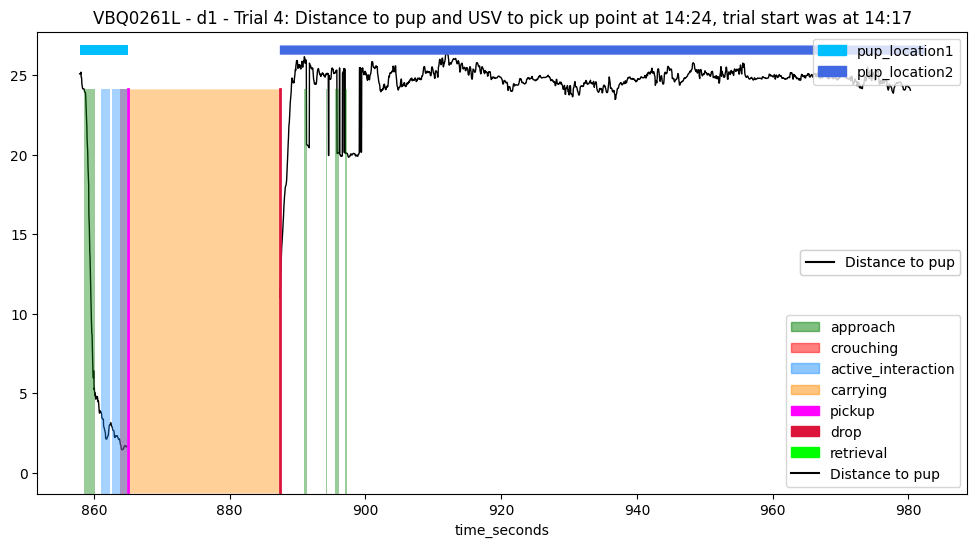

 ==== Example: VBQ0261L - d1 - 5 ==== 
 ==== Example: VBQ0261L - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3860
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        59
distance_head_to_pup         59
head_angle_to_pup_degrees    59
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        644
distance_head_to_pup         644
head_angle_to_pu

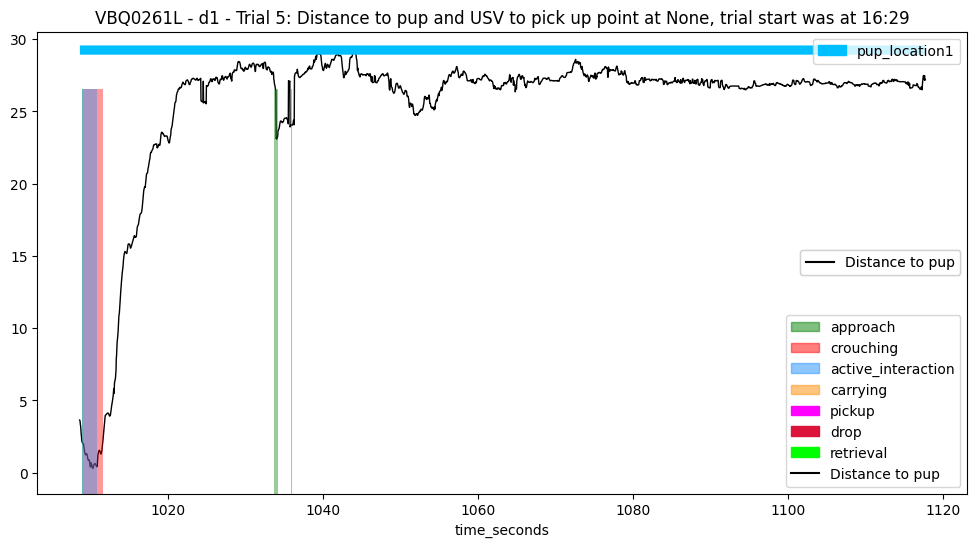

 ==== Example: VBQ0261L - d1 - 6 ==== 
 ==== Example: VBQ0261L - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3909
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        54
distance_head_to_pup         54
head_angle_to_pup_degrees    54
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        61
distance_head_to_pup         61
head_angle_to_pup_

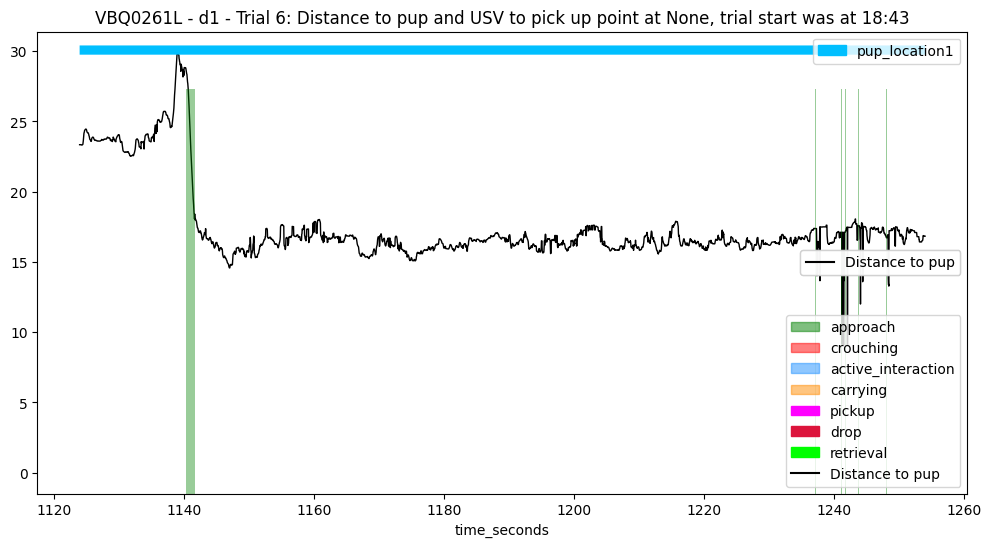

 ==== Example: VBQ0261L - d1 - 7 ==== 
 ==== Example: VBQ0261L - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3749
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3749
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 1264.3666666666666 to 1366.

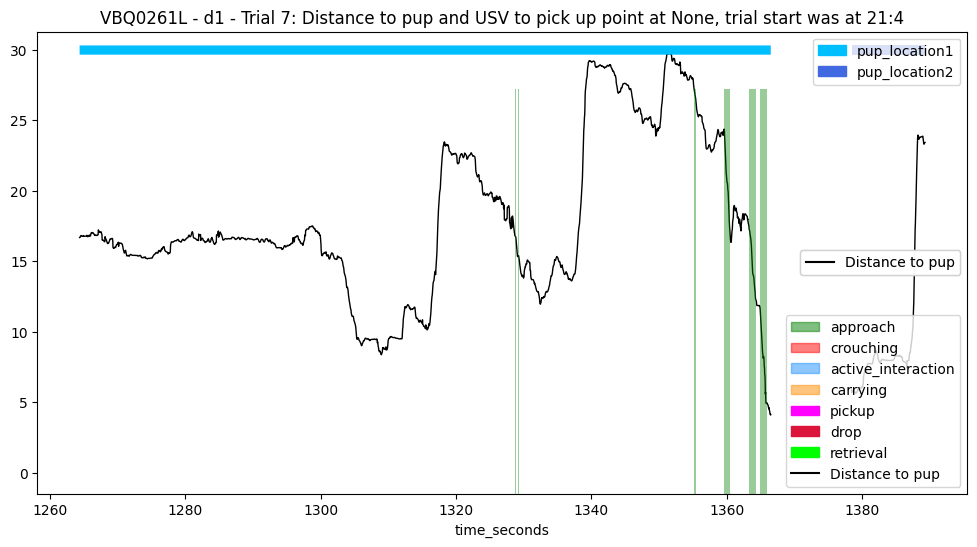

 ==== Example: VBQ0261L - d1 - 8 ==== 
 ==== Example: VBQ0261L - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3814
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        53
distance_head_to_pup         53
head_angle_to_pup_degrees    53
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        83
distance_head_to_pup         83
head_angle_to_pup_

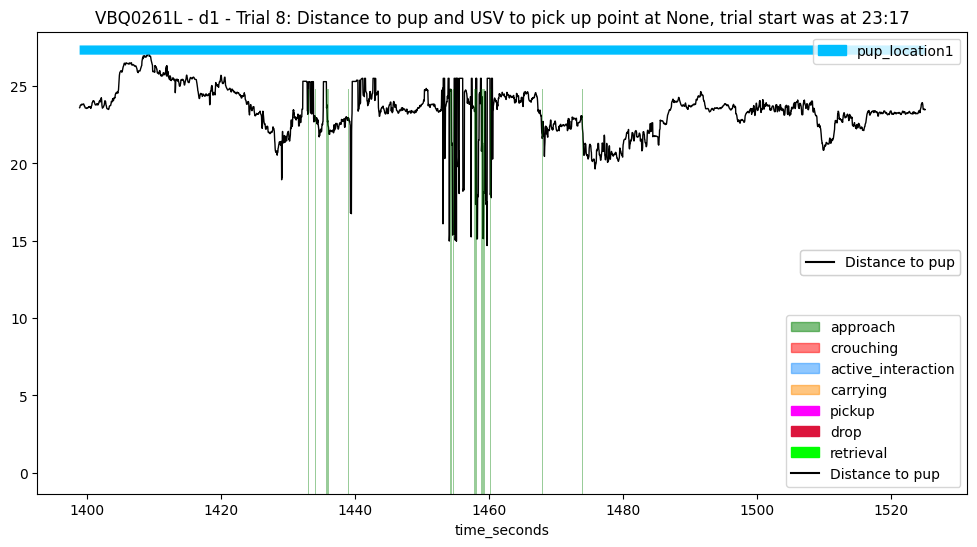

 ==== Example: VBQ0261L - d1 - 9 ==== 
 ==== Example: VBQ0261L - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1654.313
* Success time: None
---> Pick up frame: 49629, Start frame: 46244, End frame: 49946
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  49629 * Pickup time:  1654.313
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3703
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 49629, instantly drop at 49630
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head_t

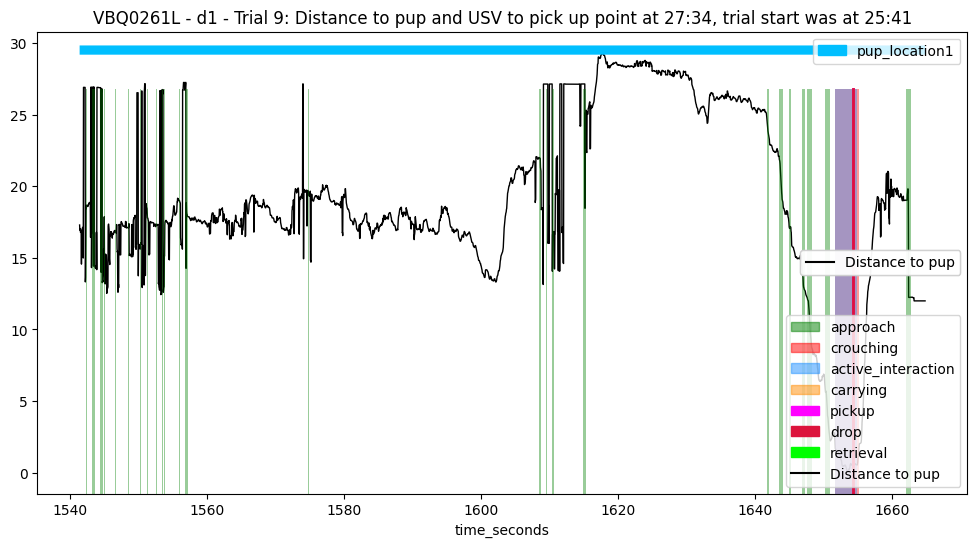

 ==== Example: VBQ0261L - d2 - 1 ==== 
 ==== Example: VBQ0261L - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4033
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to_pup         28
head_angle_to_pup_degrees    28
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        29
distance_head_to_pup         29
head_angle_to_pup_

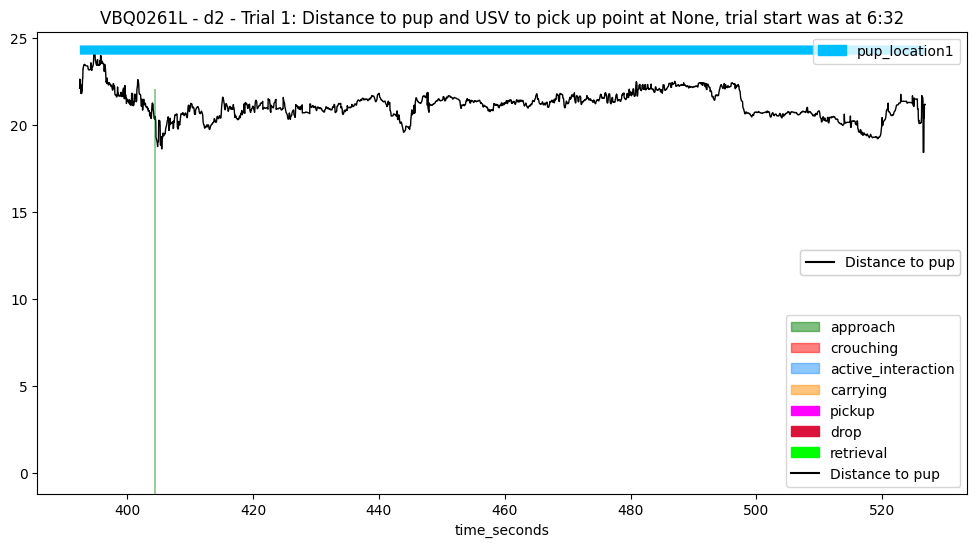

 ==== Example: VBQ0261L - d2 - 2 ==== 
 ==== Example: VBQ0261L - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3710
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3710
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 534.7 to 552.8
Window lengt

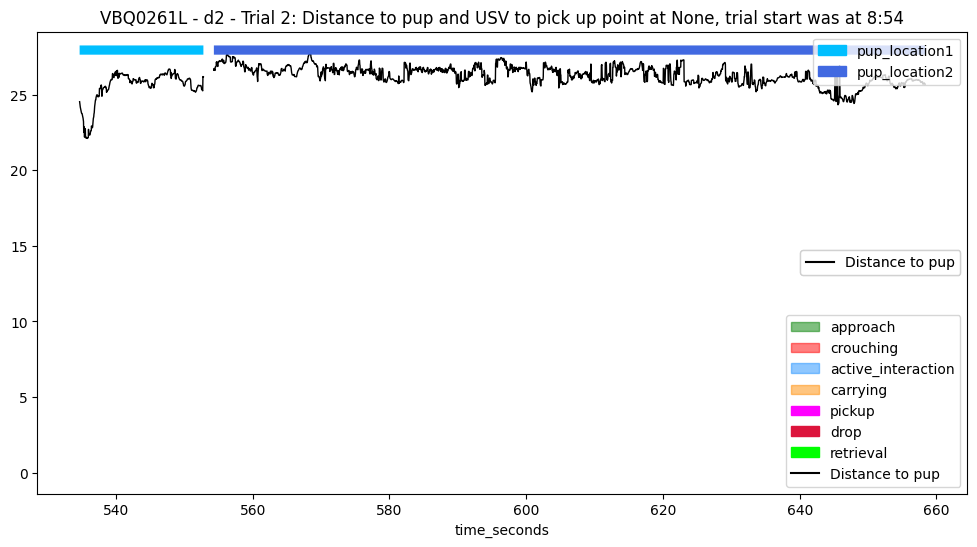

 ==== Example: VBQ0261L - d2 - 3 ==== 
 ==== Example: VBQ0261L - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3791
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_to_pup         38
head_angle_to_pup_degrees    38
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        39
distance_head_to_pup         39
head_angle_to_pup_

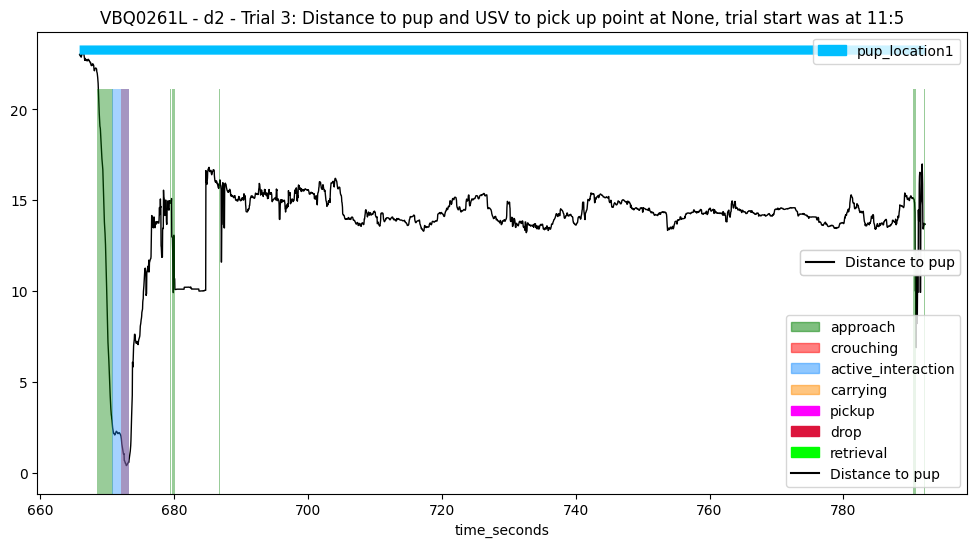

 ==== Example: VBQ0261L - d2 - 4 ==== 
 ==== Example: VBQ0261L - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 826.896
* Success time: 832.29
---> Pick up frame: 24807, Start frame: 24009, End frame: 24968
---> Retrieval frame: 24969; Start frame: 24009; End frame: 24968
---> Final frame: 24968
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24807 * Pickup time:  826.896
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 960
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_to_

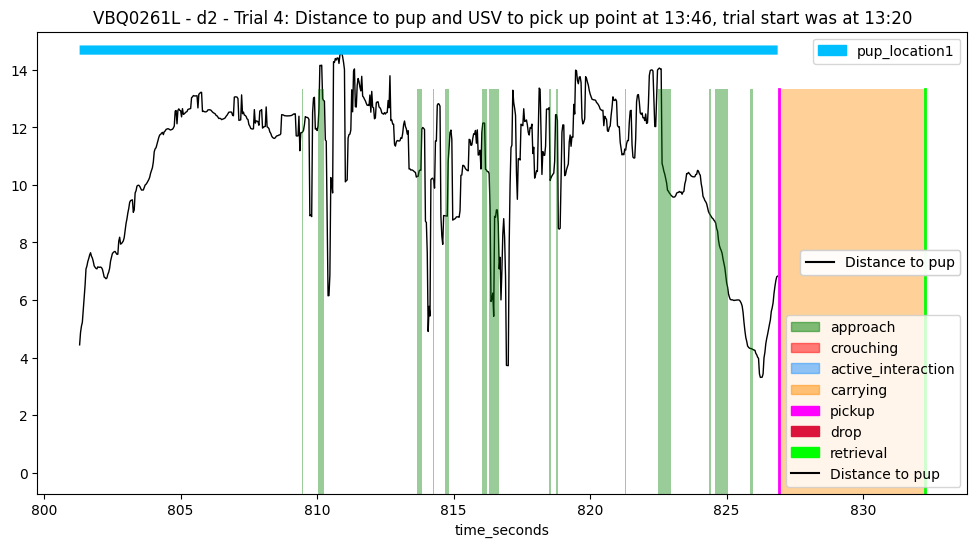

 ==== Example: VBQ0261L - d2 - 5 ==== 
 ==== Example: VBQ0261L - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 851.072
* Success time: None
---> Pick up frame: 25532, Start frame: 25409, End frame: 29104
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25532 * Pickup time:  851.072
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3696
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 25532, instantly drop at 25533
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        3572
distance_head_t

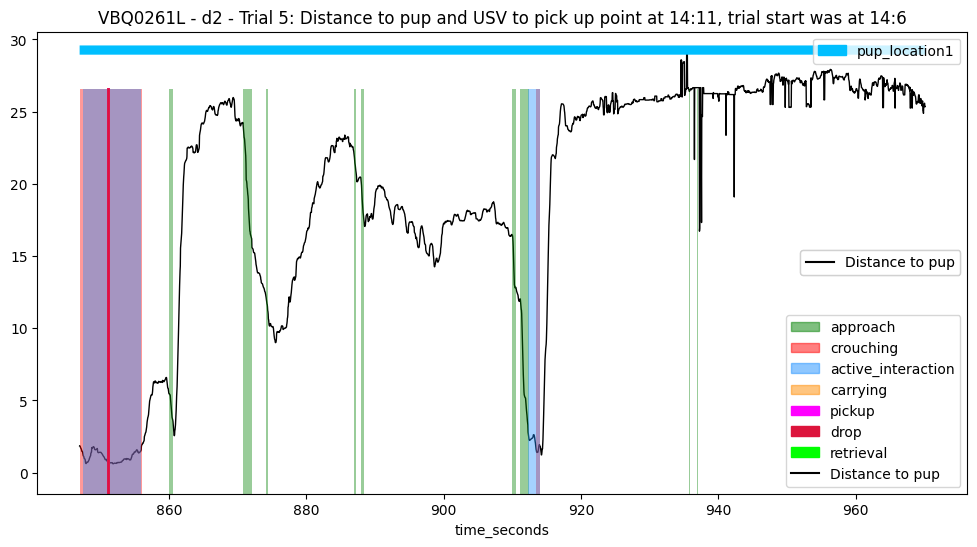

 ==== Example: VBQ0261L - d2 - 6 ==== 
 ==== Example: VBQ0261L - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 987.64
* Success time: None
---> Pick up frame: 29629, Start frame: 29540, End frame: 33258
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  29629 * Pickup time:  987.64
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3719
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_to_pup         29
head_angle_to_pup_degrees    29
dtype: int64
---Ove

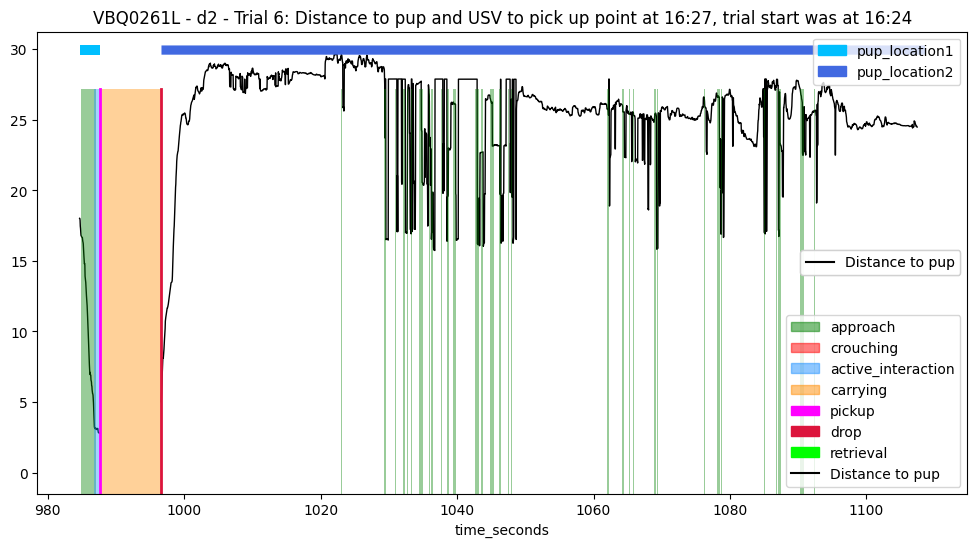

 ==== Example: VBQ0261L - d2 - 7 ==== 
 ==== Example: VBQ0261L - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1246.744
* Success time: 1248.608
---> Pick up frame: 37402, Start frame: 33655, End frame: 37458
---> Retrieval frame: 37458; Start frame: 33655; End frame: 37458
---> Final frame: 37458
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  37402 * Pickup time:  1246.744
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3804
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        57
distance_hea

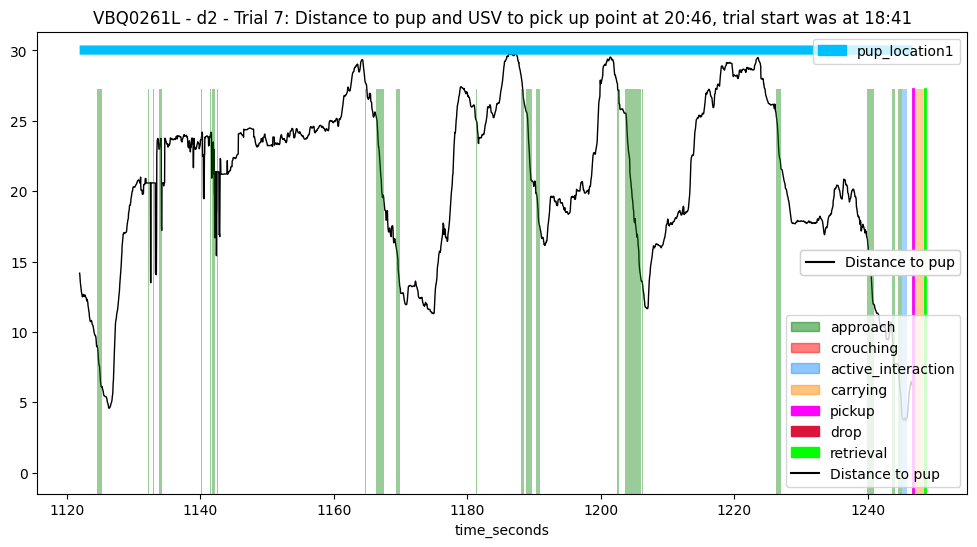

 ==== Example: VBQ0261L - d2 - 8 ==== 
 ==== Example: VBQ0261L - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3787
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pup_degrees    52
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        52
distance_head_to_pup         52
head_angle_to_pup_

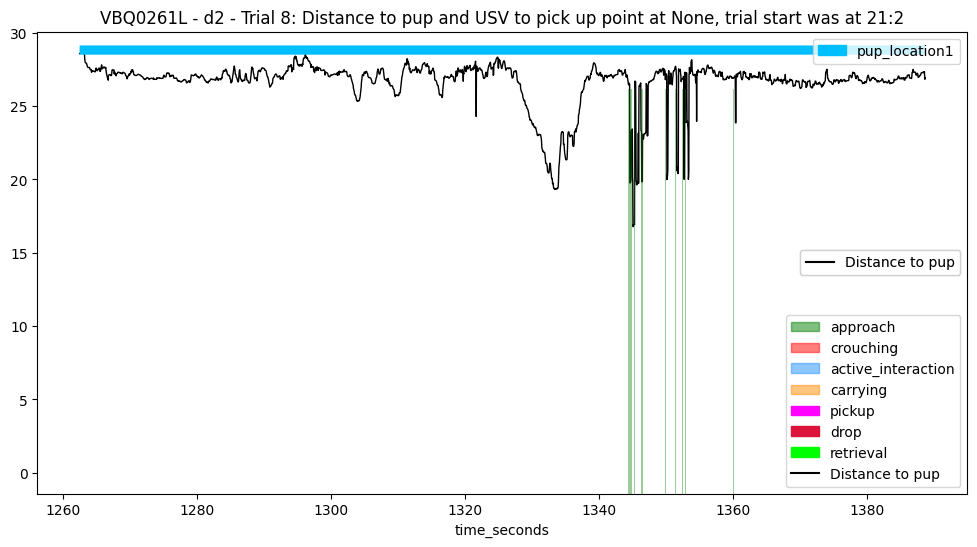

 ==== Example: VBQ0261L - d2 - 9 ==== 
 ==== Example: VBQ0261L - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1405.672
* Success time: 1407.48
---> Pick up frame: 42170, Start frame: 42017, End frame: 42224
---> Retrieval frame: 42224; Start frame: 42017; End frame: 42224
---> Final frame: 42224
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  42170 * Pickup time:  1405.672
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 208
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        85
distance_head_

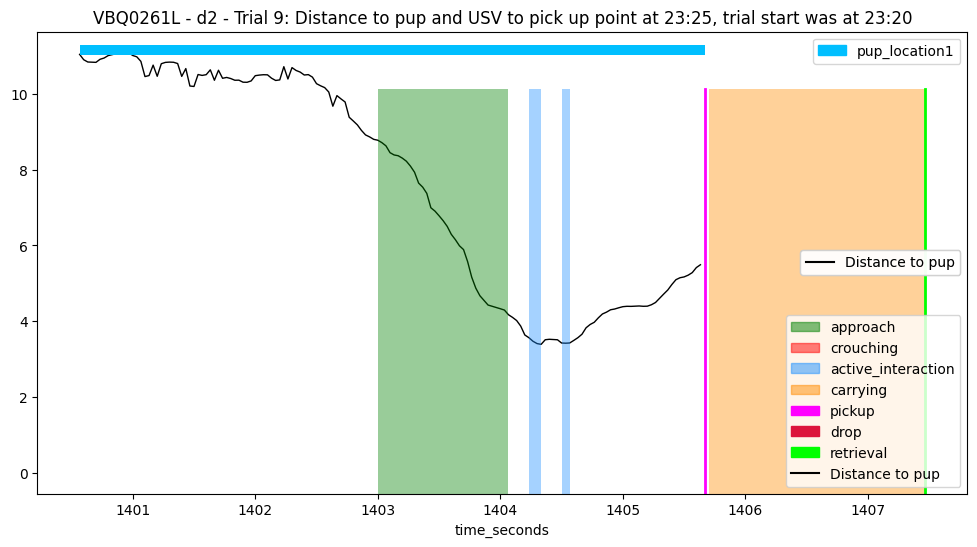

 ==== Example: VBQ0261L - d3 - 1 ==== 
 ==== Example: VBQ0261L - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3699
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_degrees    60
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_

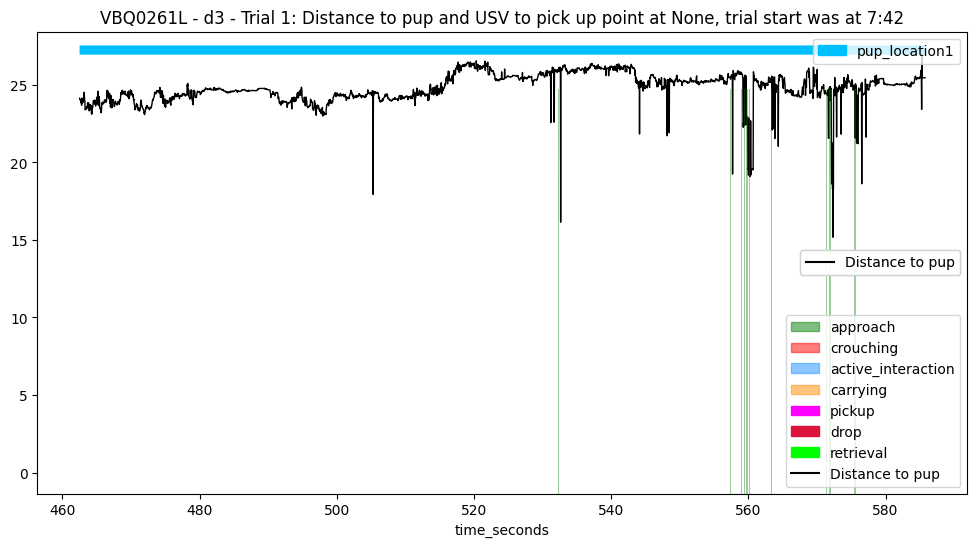

 ==== Example: VBQ0261L - d3 - 2 ==== 
 ==== Example: VBQ0261L - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4790
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        61
distance_head_to_pup         61
head_angle_to_pup_degrees    61
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        65
distance_head_to_pup         65
head_angle_to_pup_

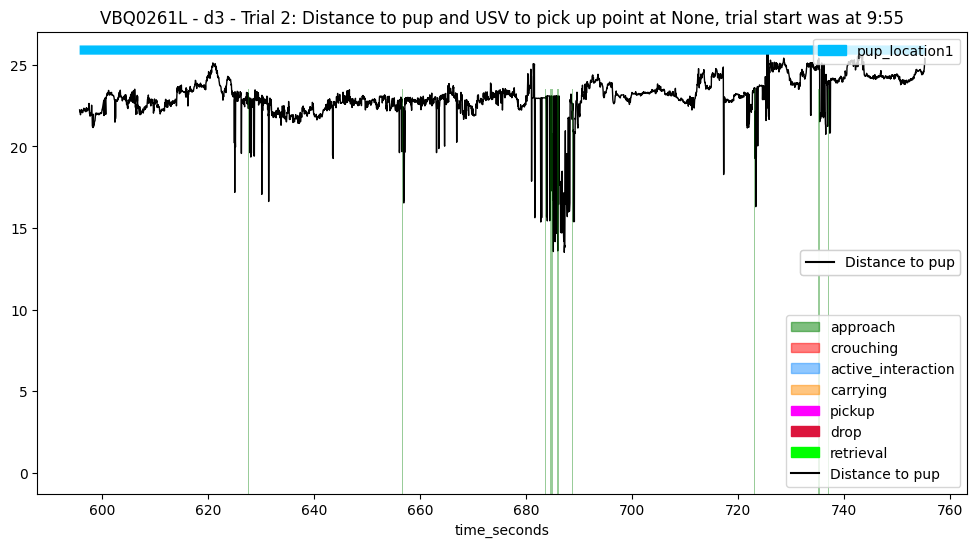

 ==== Example: VBQ0261L - d3 - 3 ==== 
 ==== Example: VBQ0261L - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4105
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        3722
distance_head_to_pup         3722
head_angle_to_pup_degrees    3722
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        3722
distance_head_to_pup         3722
head_ang

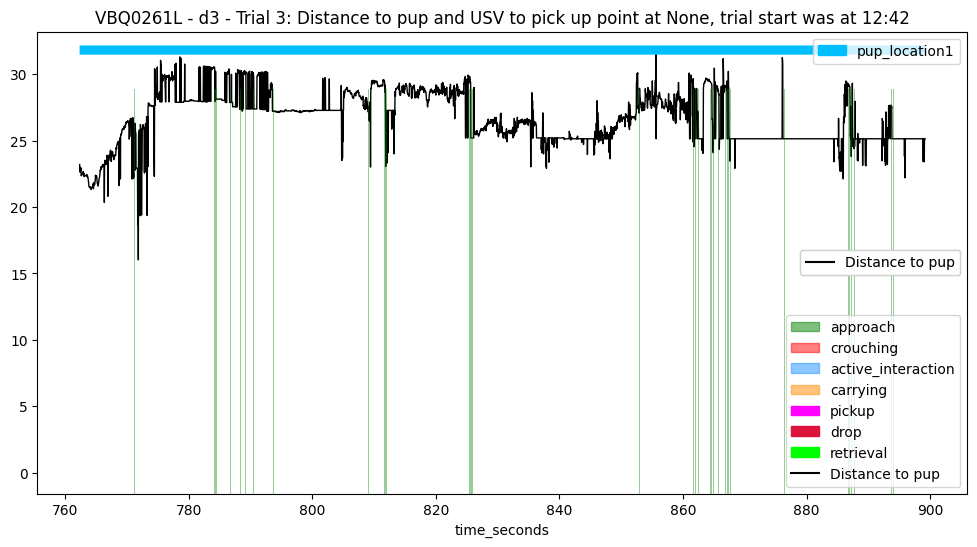

 ==== Example: VBQ0261L - d3 - 4 ==== 
 ==== Example: VBQ0261L - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 910.834
* Success time: 917.202
---> Pick up frame: 27325, Start frame: 27141, End frame: 27516
---> Retrieval frame: 27516; Start frame: 27141; End frame: 27516
---> Final frame: 27516
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27325 * Pickup time:  910.834
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 376
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        84
distance_head_to

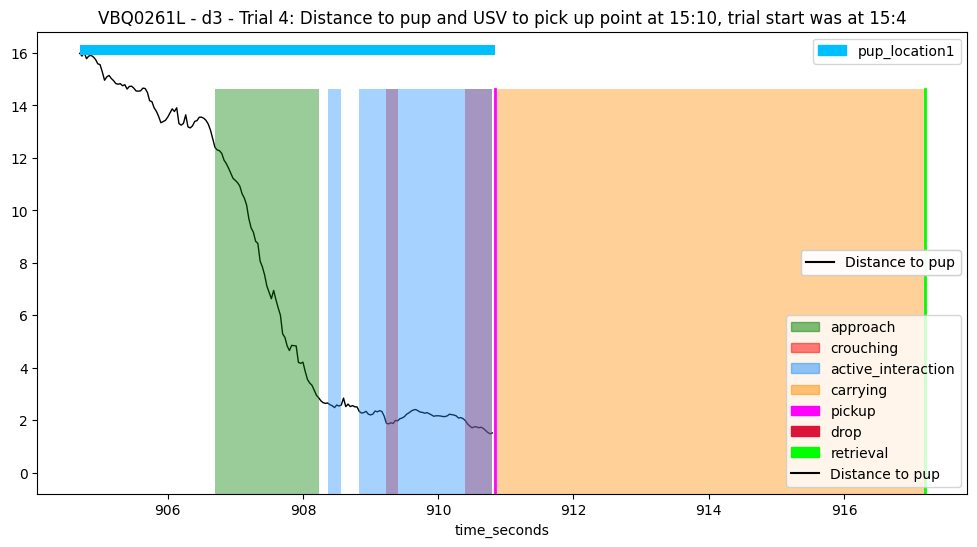

 ==== Example: VBQ0261L - d3 - 5 ==== 
 ==== Example: VBQ0261L - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3970
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        46
distance_head_to_pup         46
head_angle_to_pup_degrees    47
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         46
distance_head_to_pup          46
head_angle_to_pu

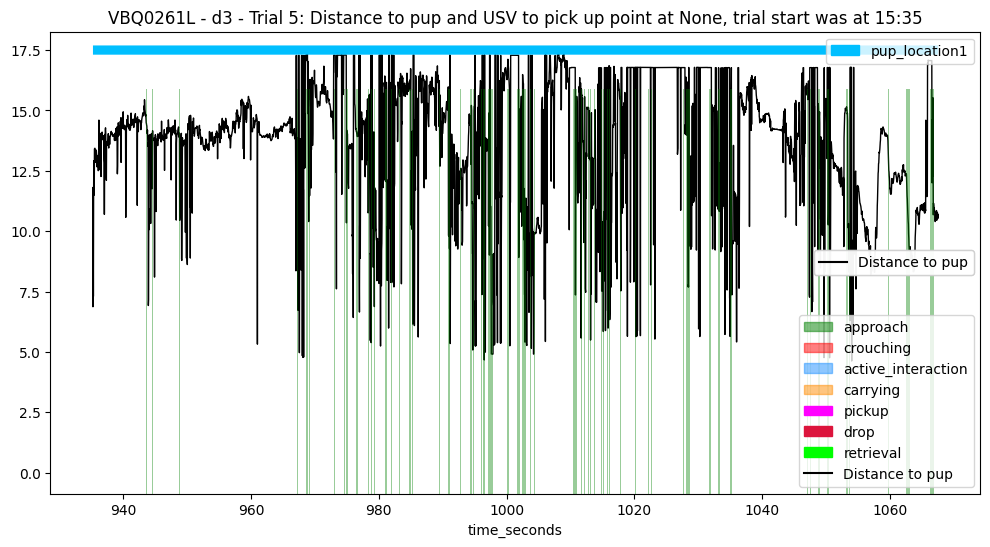

 ==== Example: VBQ0261L - d3 - 6 ==== 
 ==== Example: VBQ0261L - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1113.354
* Success time: 1115.074
---> Pick up frame: 33401, Start frame: 32316, End frame: 33452
---> Retrieval frame: 33452; Start frame: 32316; End frame: 33452
---> Final frame: 33452
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  33401 * Pickup time:  1113.354
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1137
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_hea

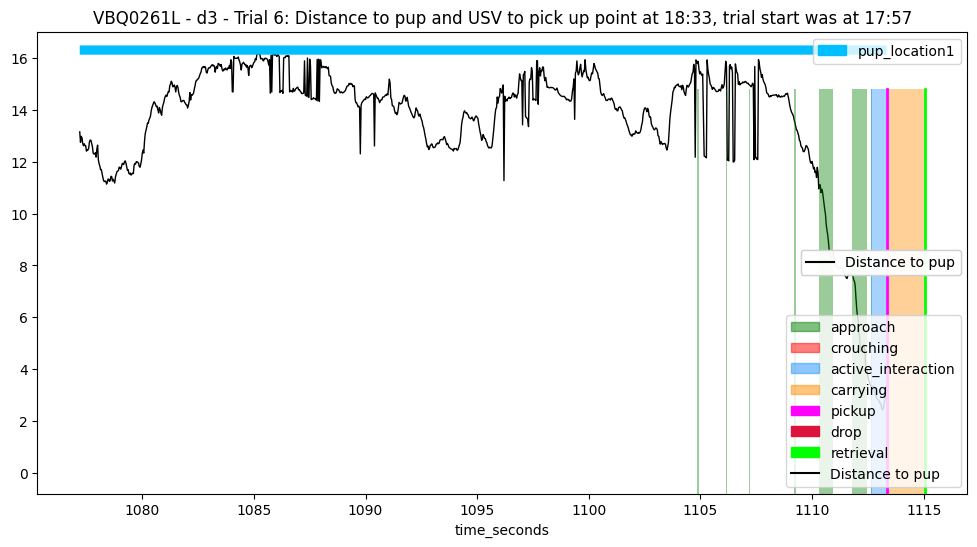

 ==== Example: VBQ0261L - d3 - 7 ==== 
 ==== Example: VBQ0261L - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1238.722
* Success time: 1242.498
---> Pick up frame: 37162, Start frame: 33896, End frame: 37274
---> Retrieval frame: 37275; Start frame: 33896; End frame: 37274
---> Final frame: 37274
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  37162 * Pickup time:  1238.722
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3379
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_hea

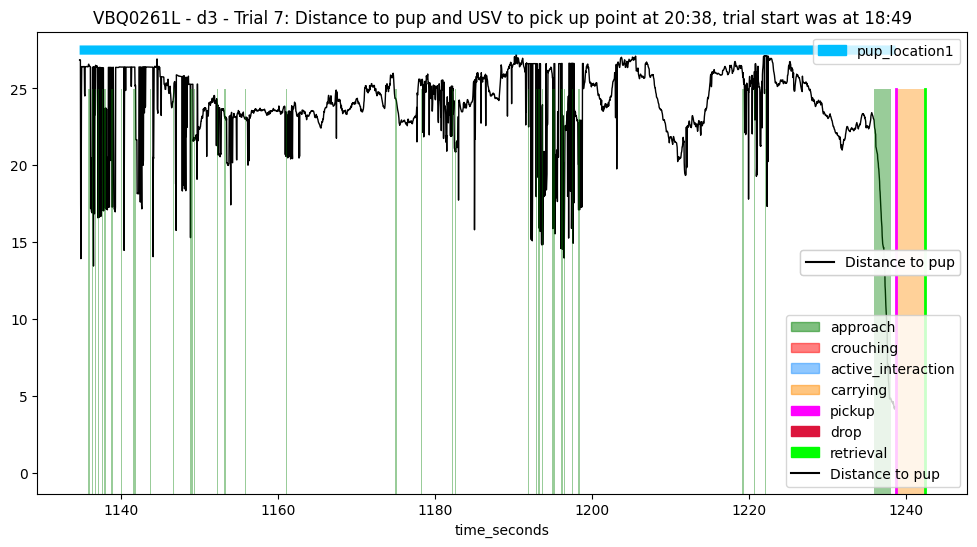

 ==== Example: VBQ0261L - d3 - 8 ==== 
 ==== Example: VBQ0261L - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1272.05
* Success time: None
---> Pick up frame: 38162, Start frame: 37623, End frame: 41512
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38162 * Pickup time:  1272.05
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3890
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 38162, instantly drop at 38163
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        52
distance_head_to_

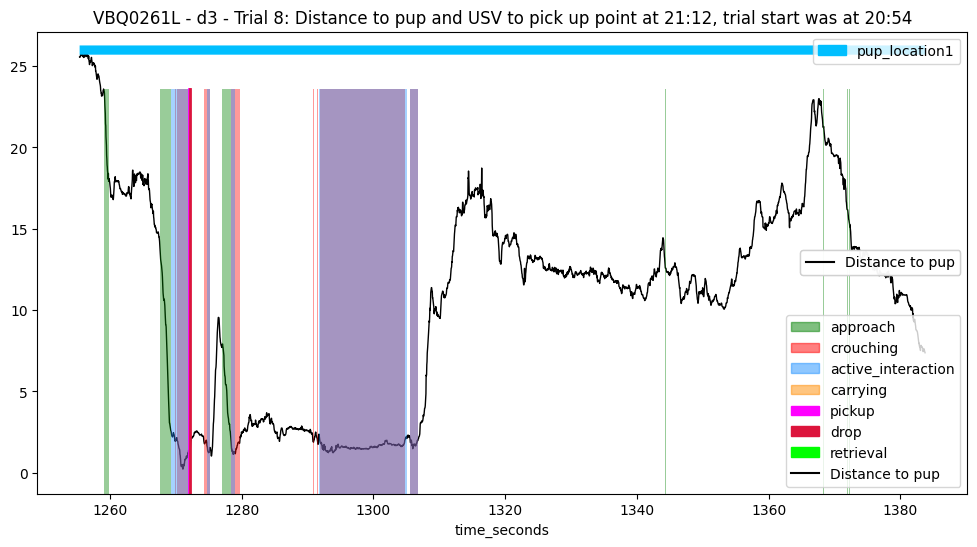

 ==== Example: VBQ0261L - d3 - 9 ==== 
 ==== Example: VBQ0261L - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3895
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        58
distance_head_to_pup         58
head_angle_to_pup_degrees    58
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_

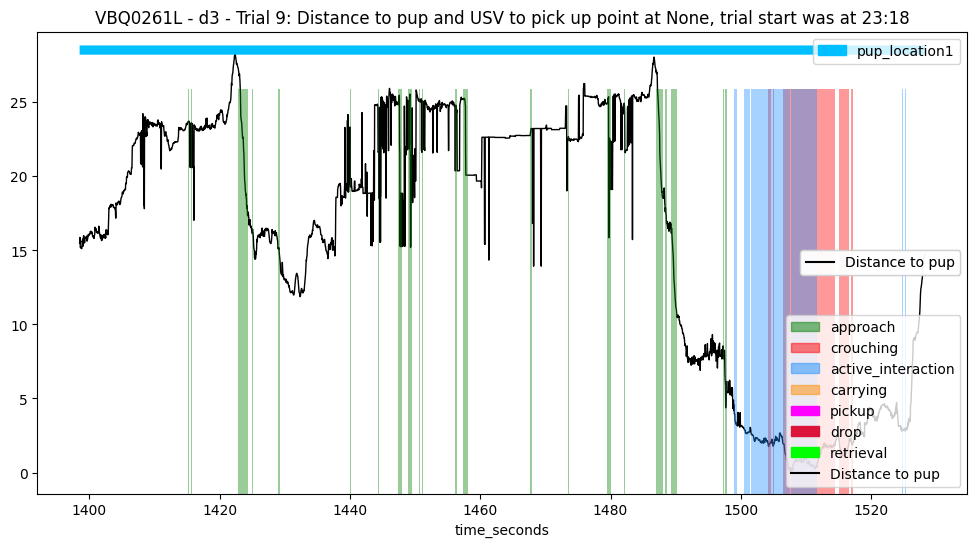

 ==== Example: VBQ0261L - d4 - 1 ==== 
 ==== Example: VBQ0261L - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 415.013
* Success time: 417.774
---> Pick up frame: 12450, Start frame: 12178, End frame: 12533
---> Retrieval frame: 12533; Start frame: 12178; End frame: 12533
---> Final frame: 12533
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12450 * Pickup time:  415.013
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 356
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        23
distance_head_to

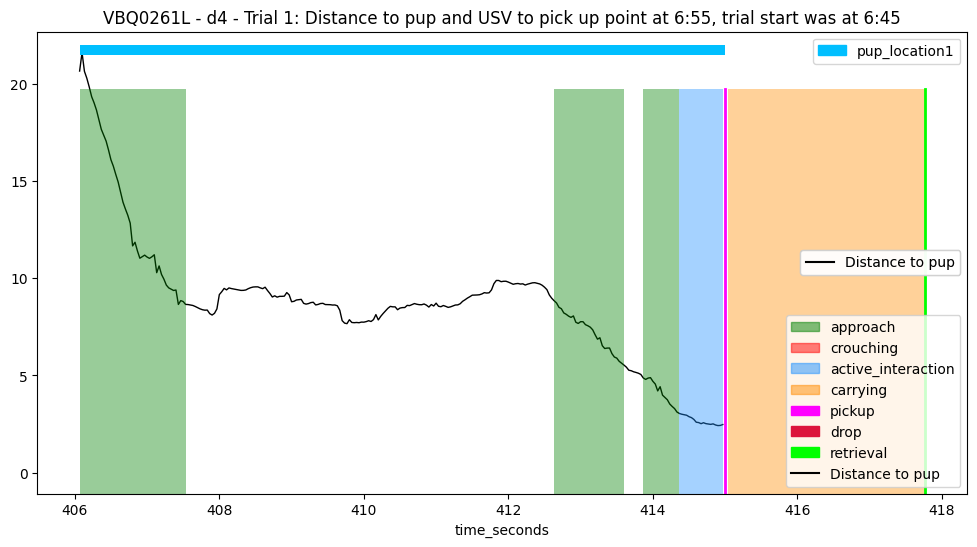

 ==== Example: VBQ0261L - d4 - 2 ==== 
 ==== Example: VBQ0261L - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3707
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        54
distance_head_to_pup         54
head_angle_to_pup_degrees    54
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        61
distance_head_to_pup         61
head_angle_to_pup_

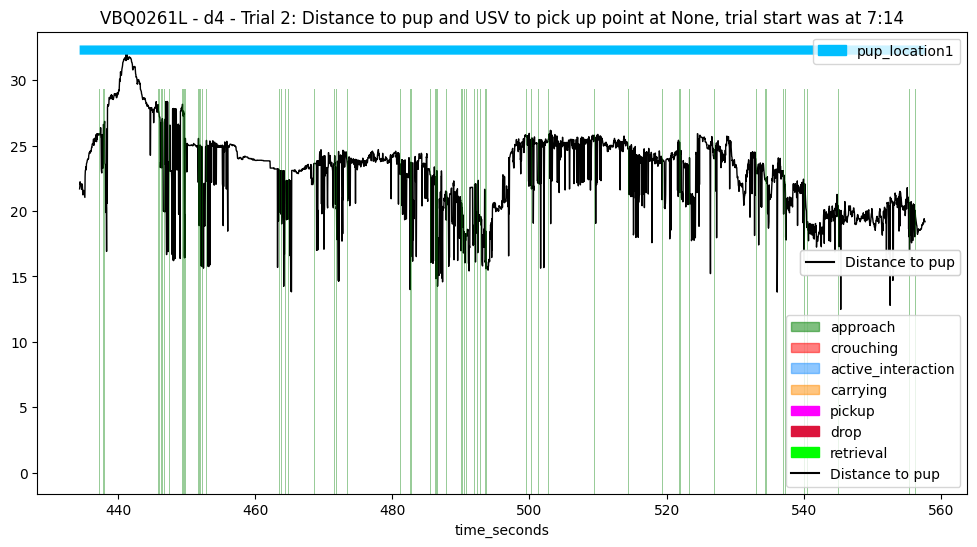

 ==== Example: VBQ0261L - d4 - 3 ==== 
 ==== Example: VBQ0261L - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 649.07
* Success time: 652.838
---> Pick up frame: 19472, Start frame: 17536, End frame: 19585
---> Retrieval frame: 19585; Start frame: 17536; End frame: 19585
---> Final frame: 19585
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19472 * Pickup time:  649.07
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2050
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        21
distance_head_to_

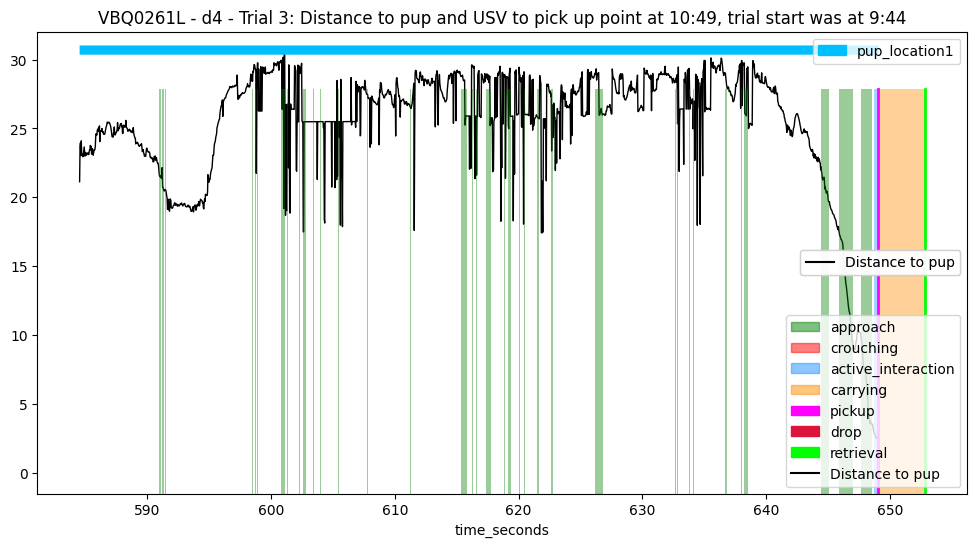

 ==== Example: VBQ0261L - d4 - 4 ==== 
 ==== Example: VBQ0261L - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 717.646
* Success time: 720.534
---> Pick up frame: 21529, Start frame: 20141, End frame: 21616
---> Retrieval frame: 21616; Start frame: 20141; End frame: 21616
---> Final frame: 21616
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21529 * Pickup time:  717.646
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1476
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'retrieval' 
Pick up at 21529, instantly drop at 21530
---> Processing last pup location: 

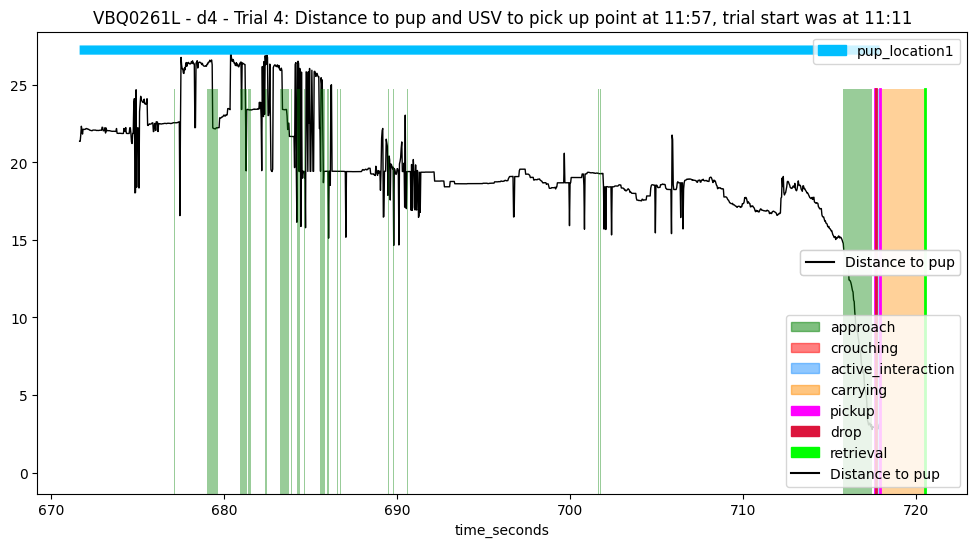

 ==== Example: VBQ0261L - d4 - 5 ==== 
 ==== Example: VBQ0261L - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3754
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        57
distance_head_to_pup         57
head_angle_to_pup_degrees    57
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        57
distance_head_to_pup         57
head_angle_to_pup_

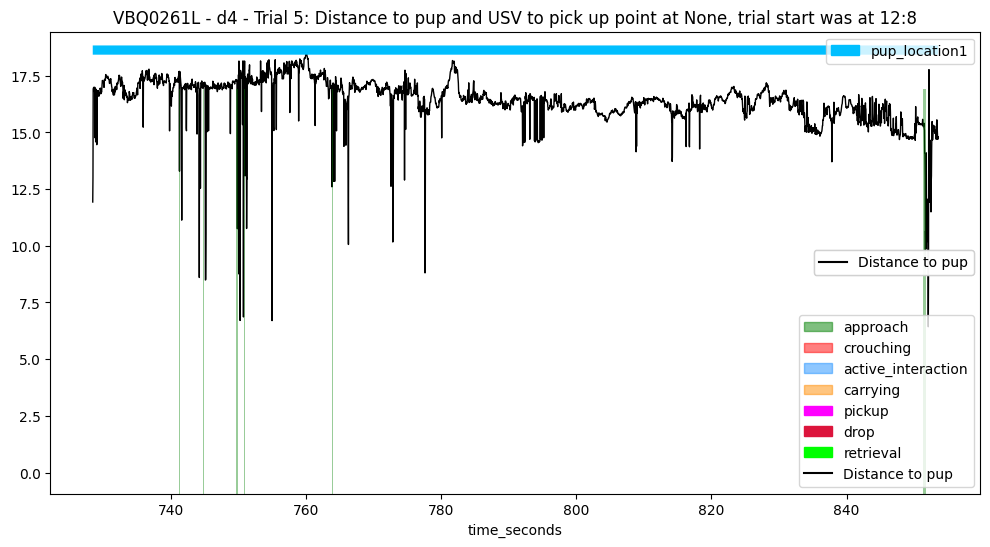

 ==== Example: VBQ0261L - d4 - 6 ==== 
 ==== Example: VBQ0261L - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 865.142
* Success time: 867.158
---> Pick up frame: 25954, Start frame: 25857, End frame: 26014
---> Retrieval frame: 26015; Start frame: 25857; End frame: 26014
---> Final frame: 26014
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25954 * Pickup time:  865.142
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 158
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to

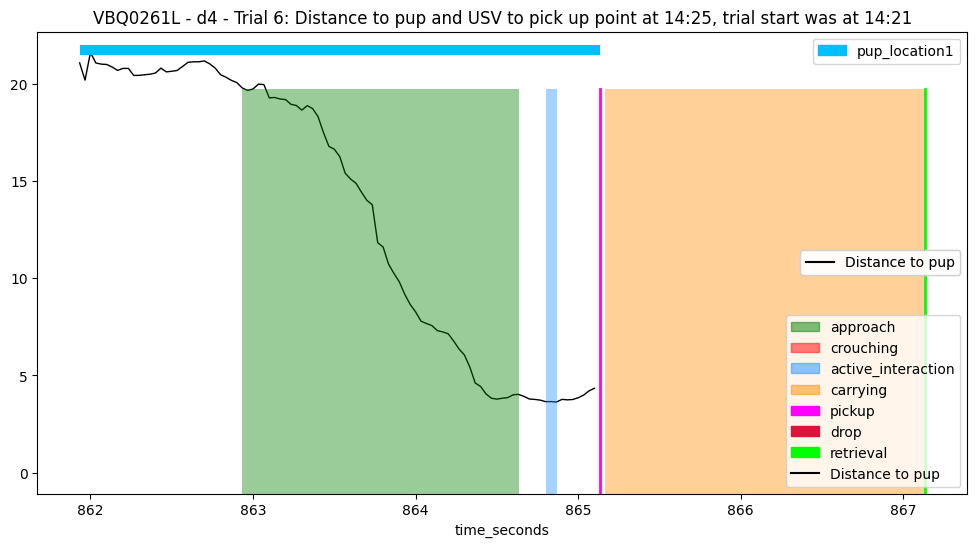

 ==== Example: VBQ0261L - d4 - 7 ==== 
 ==== Example: VBQ0261L - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 932.0
* Success time: None
---> Pick up frame: 27960, Start frame: 26613, End frame: 28071
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27960 * Pickup time:  932.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1459
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        65
distance_head_to_pup         65
head_angle_to_pup_degrees    65
dtype: int64
---Overall NaN counts:  distance_mouse

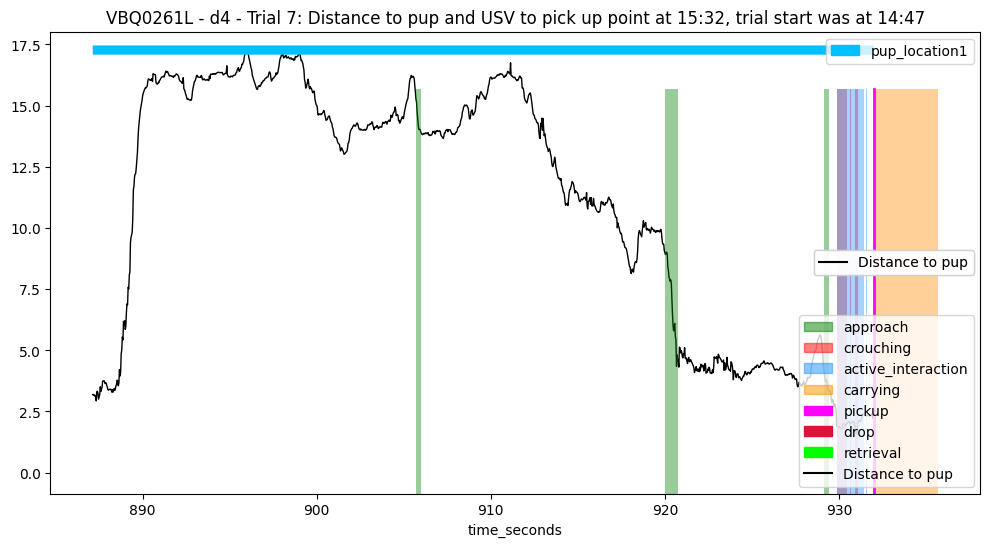

 ==== Example: VBQ0261L - d4 - 8 ==== 
 ==== Example: VBQ0261L - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1073.27
* Success time: 1075.902
---> Pick up frame: 32198, Start frame: 28585, End frame: 32277
---> Retrieval frame: 32277; Start frame: 28585; End frame: 32277
---> Final frame: 32277
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  32198 * Pickup time:  1073.27
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3693
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        18
distance_head_

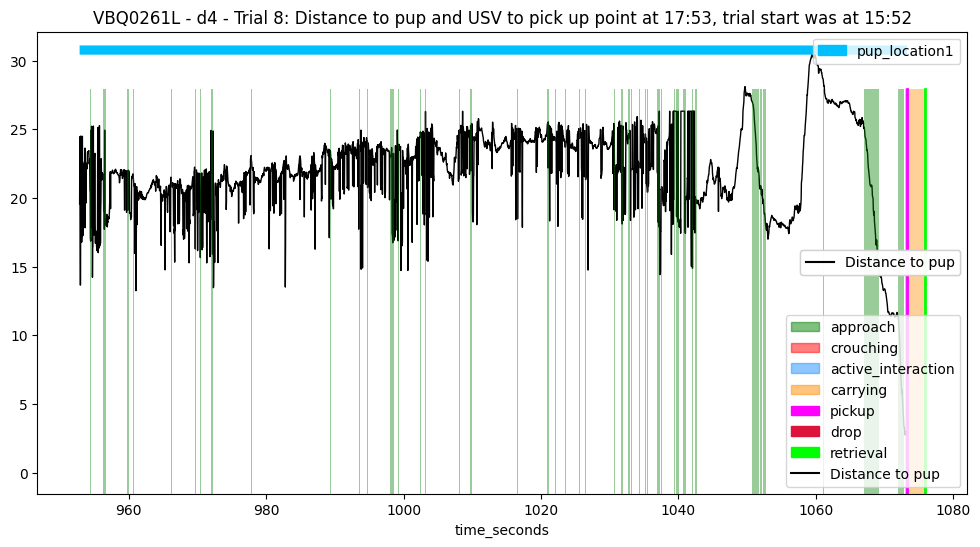

 ==== Example: VBQ0261L - d4 - 9 ==== 
 ==== Example: VBQ0261L - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4534
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        40
distance_head_to_pup         40
head_angle_to_pup_degrees    40
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup          40
distance_head_to_pup           40
head_angle_to_

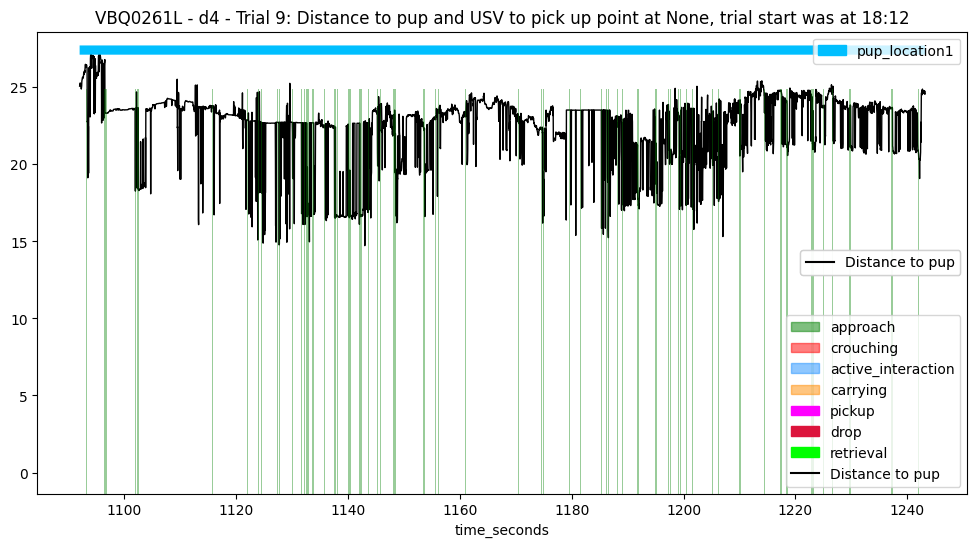

 ==== Example: VBQ0261L - d5 - 1 ==== 
 ==== Example: VBQ0261L - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3738
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pup_degrees    37
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pup_

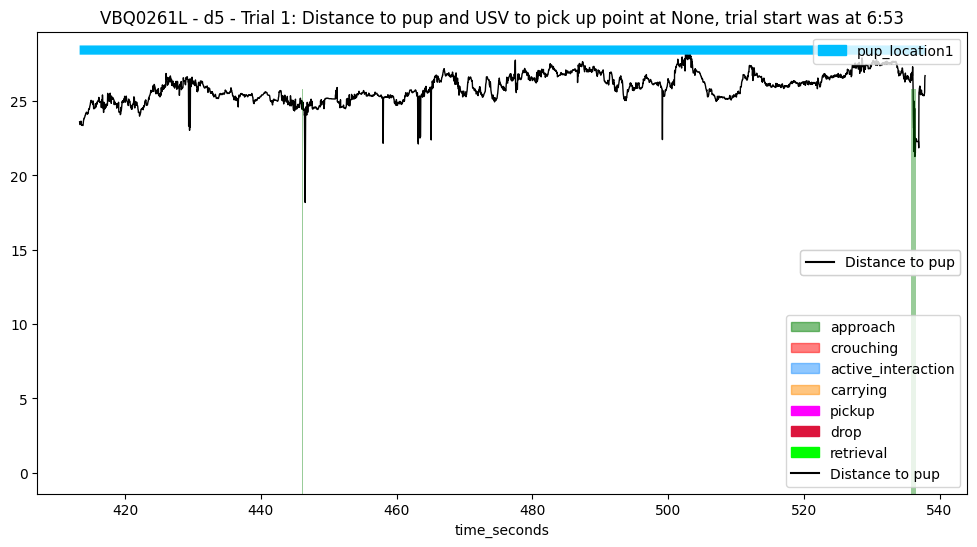

 ==== Example: VBQ0261L - d5 - 2 ==== 
 ==== Example: VBQ0261L - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3954
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        60
distance_head_to_pup         60
head_angle_to_pup_degrees    60
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         60
distance_head_to_pup          60
head_angle_to_pu

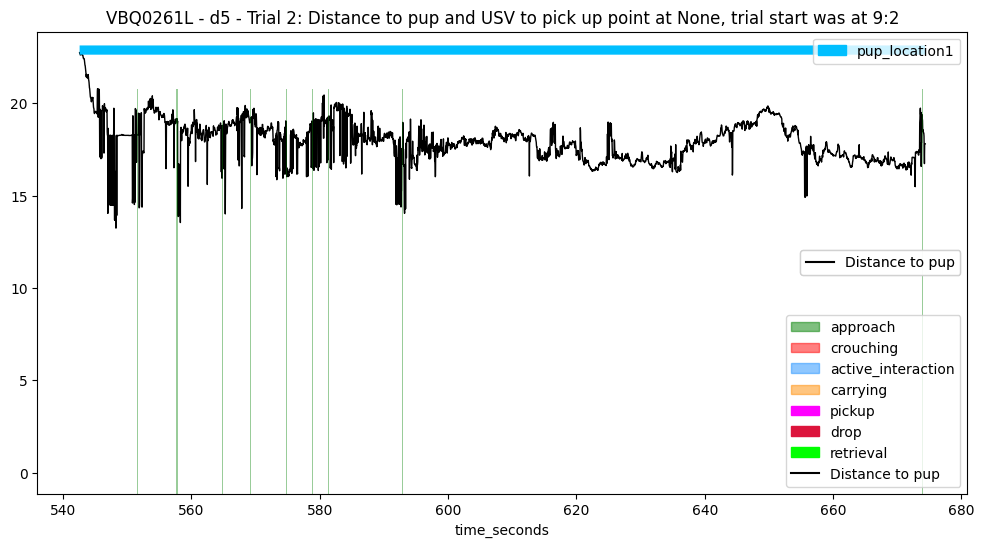

 ==== Example: VBQ0261L - d5 - 3 ==== 
 ==== Example: VBQ0261L - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 803.267
* Success time: 805.355
---> Pick up frame: 24098, Start frame: 20472, End frame: 24160
---> Retrieval frame: 24161; Start frame: 20472; End frame: 24160
---> Final frame: 24160
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24098 * Pickup time:  803.267
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3689
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_t

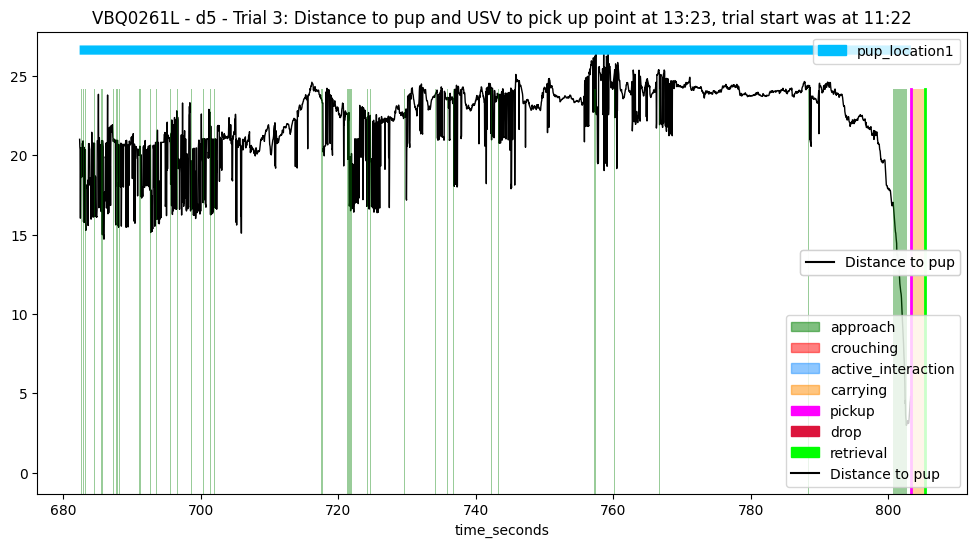

 ==== Example: VBQ0261L - d5 - 4 ==== 
 ==== Example: VBQ0261L - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4187
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        49
distance_head_to_pup         49
head_angle_to_pup_degrees    50
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         56
distance_head_to_pup          56
head_angle_to_pu

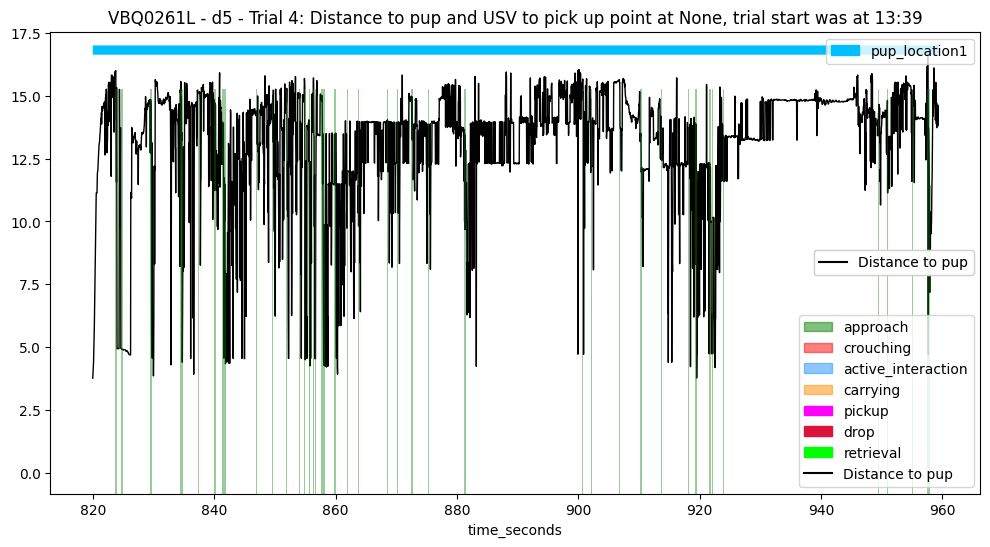

 ==== Example: VBQ0261L - d5 - 5 ==== 
 ==== Example: VBQ0261L - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2922
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        111
distance_head_to_pup         111
head_angle_to_pup_degrees    111
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        114
distance_head_to_pup         114
head_angle_to

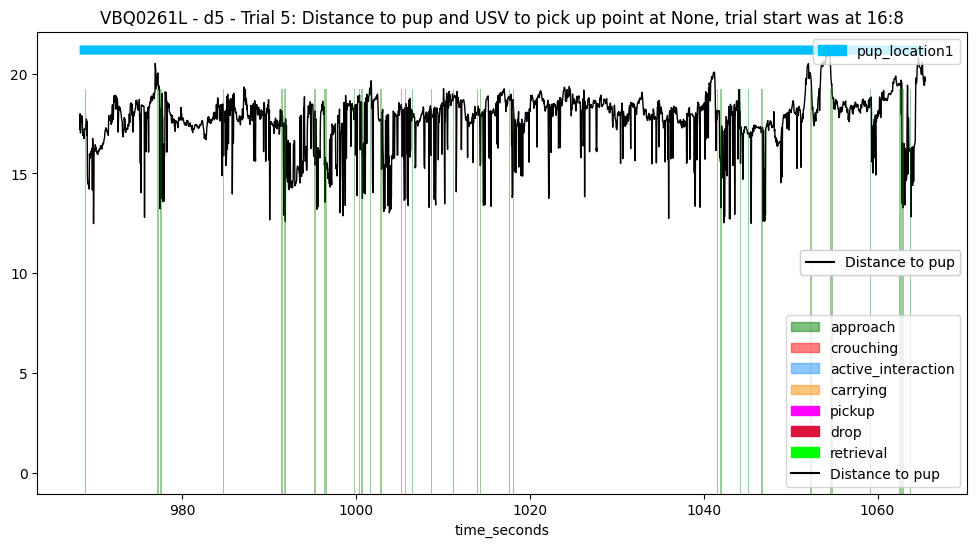

 ==== Example: VBQ0261L - d5 - 6 ==== 
 ==== Example: VBQ0261L - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1177.563
* Success time: 1180.203
---> Pick up frame: 35327, Start frame: 32288, End frame: 35406
---> Retrieval frame: 35406; Start frame: 32288; End frame: 35406
---> Final frame: 35406
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  35327 * Pickup time:  1177.563
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3119
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_hea

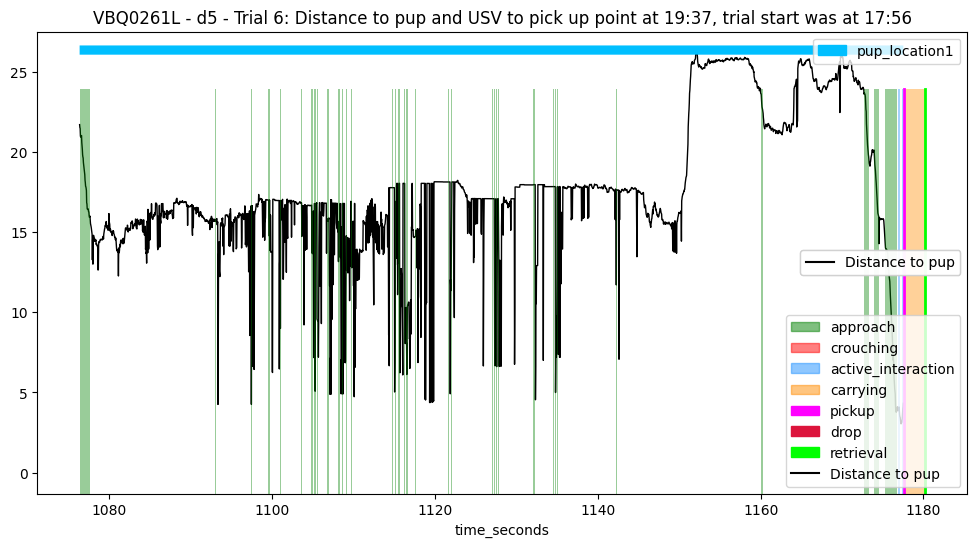

 ==== Example: VBQ0261L - d5 - 7 ==== 
 ==== Example: VBQ0261L - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1251.507
* Success time: 1254.827
---> Pick up frame: 37545, Start frame: 35802, End frame: 37644
---> Retrieval frame: 37645; Start frame: 35802; End frame: 37644
---> Final frame: 37644
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  37545 * Pickup time:  1251.507
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1843
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        15
distance_hea

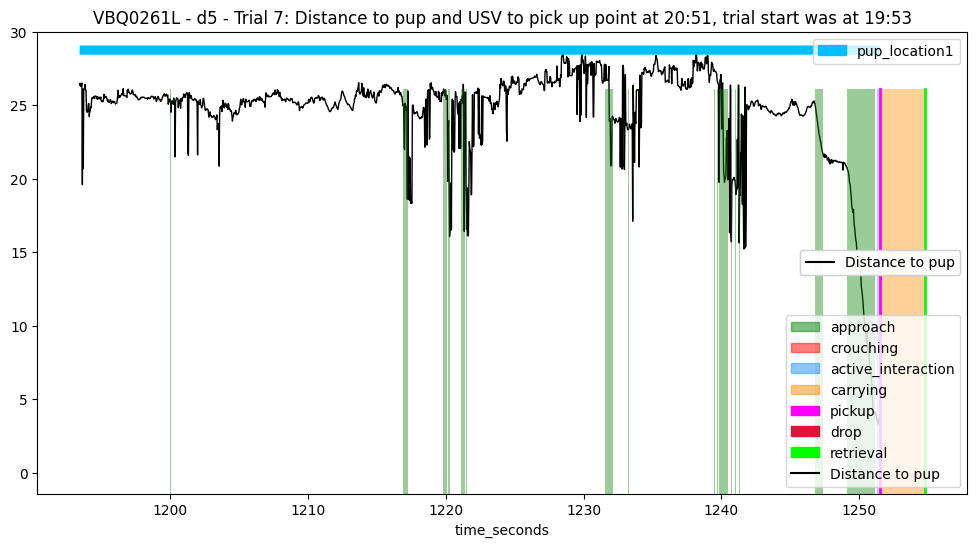

 ==== Example: VBQ0261L - d5 - 8 ==== 
 ==== Example: VBQ0261L - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1302.275
* Success time: 1304.835
---> Pick up frame: 39068, Start frame: 38125, End frame: 39145
---> Retrieval frame: 39145; Start frame: 38125; End frame: 39145
---> Final frame: 39145
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  39068 * Pickup time:  1302.275
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1021
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        17
distance_hea

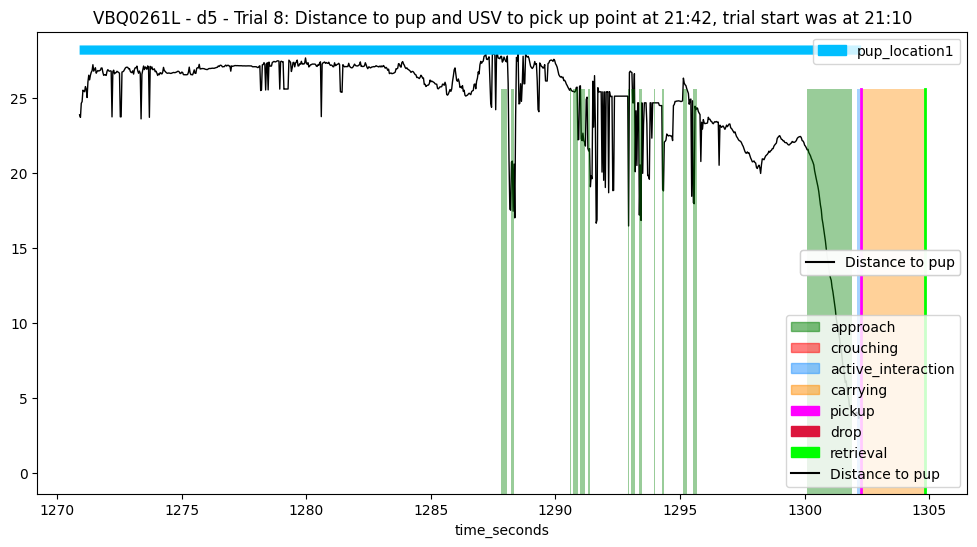

 ==== Example: VBQ0261L - d5 - 9 ==== 
 ==== Example: VBQ0261L - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1338.467
* Success time: 1341.459
---> Pick up frame: 40154, Start frame: 39479, End frame: 40243
---> Retrieval frame: 40244; Start frame: 39479; End frame: 40243
---> Final frame: 40243
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  40154 * Pickup time:  1338.467
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 765
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        63
distance_head

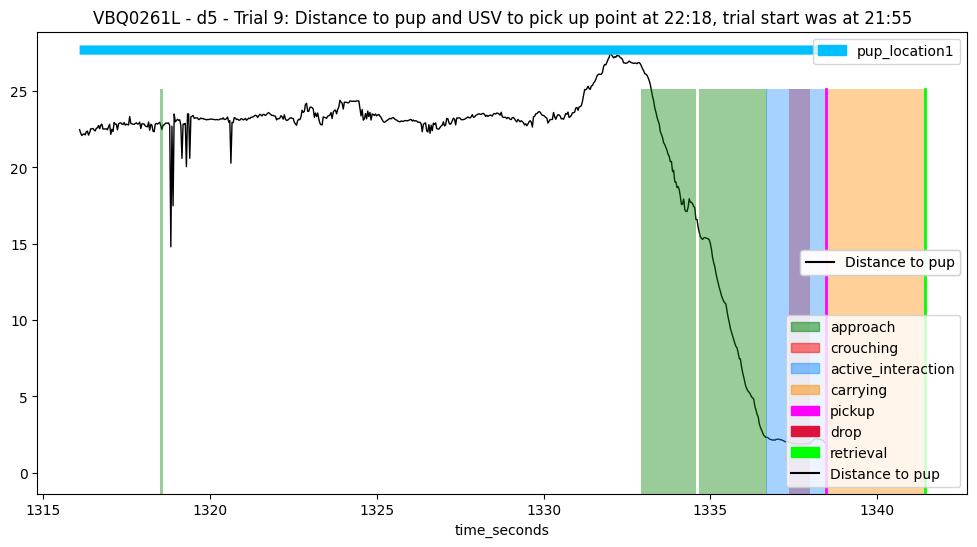

 ==== Example: VBQ0261L - d6 - 1 ==== 
 ==== Example: VBQ0261L - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4930
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        58
distance_head_to_pup         58
head_angle_to_pup_degrees    58
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        64
distance_head_to_pup         64
head_angle_to_pup_

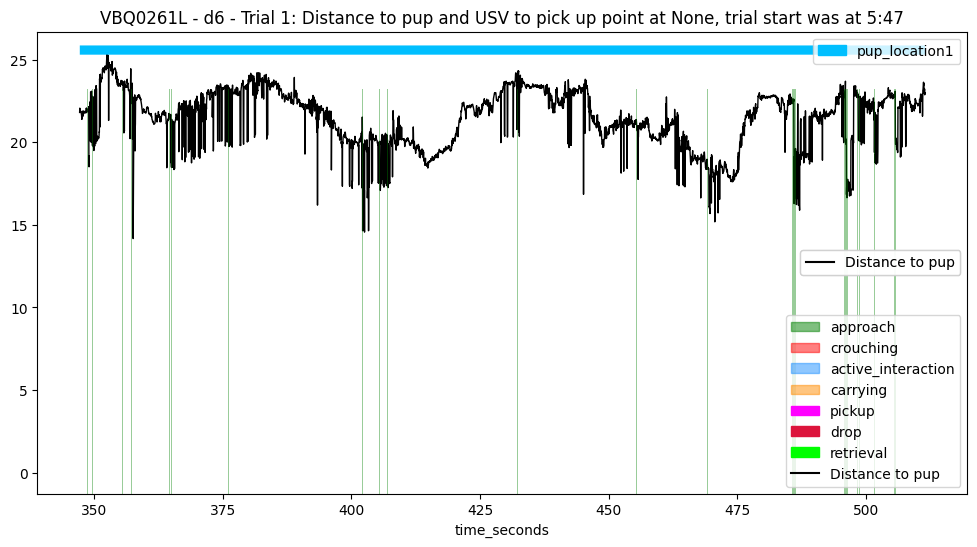

 ==== Example: VBQ0261L - d6 - 2 ==== 
 ==== Example: VBQ0261L - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3554
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pup_degrees    37
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        37
distance_head_to_pup         37
head_angle_to_pup_

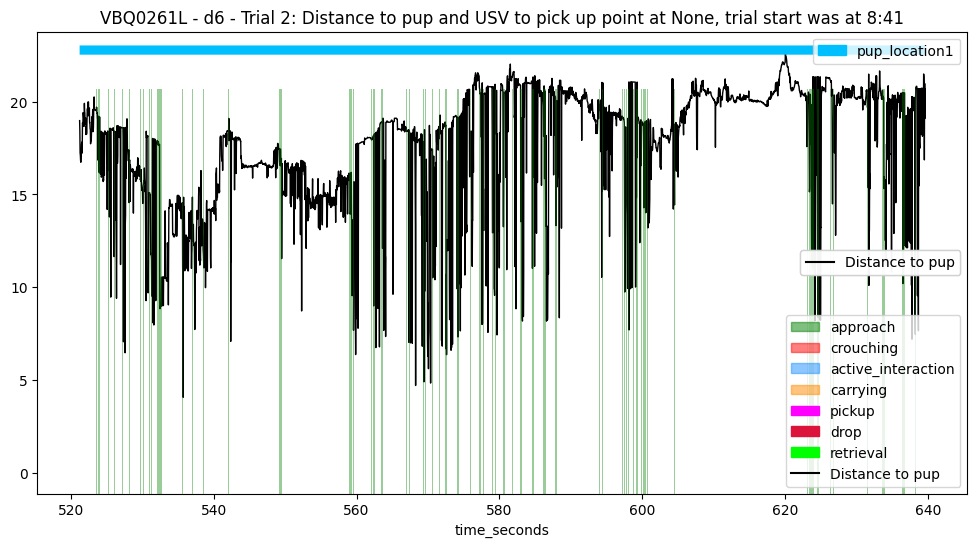

 ==== Example: VBQ0261L - d6 - 3 ==== 
 ==== Example: VBQ0261L - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3785
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pup_degrees    43
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         43
distance_head_to_pup          43
head_angle_to_pu

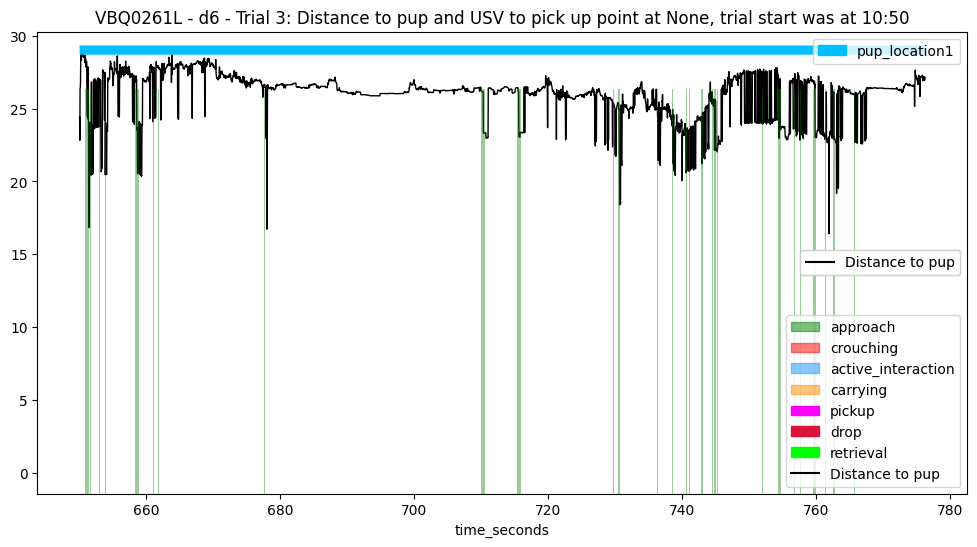

 ==== Example: VBQ0261L - d6 - 4 ==== 
 ==== Example: VBQ0261L - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3877
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        63
distance_head_to_pup         63
head_angle_to_pup_degrees    63
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        66
distance_head_to_pup         66
head_angle_to_pup_

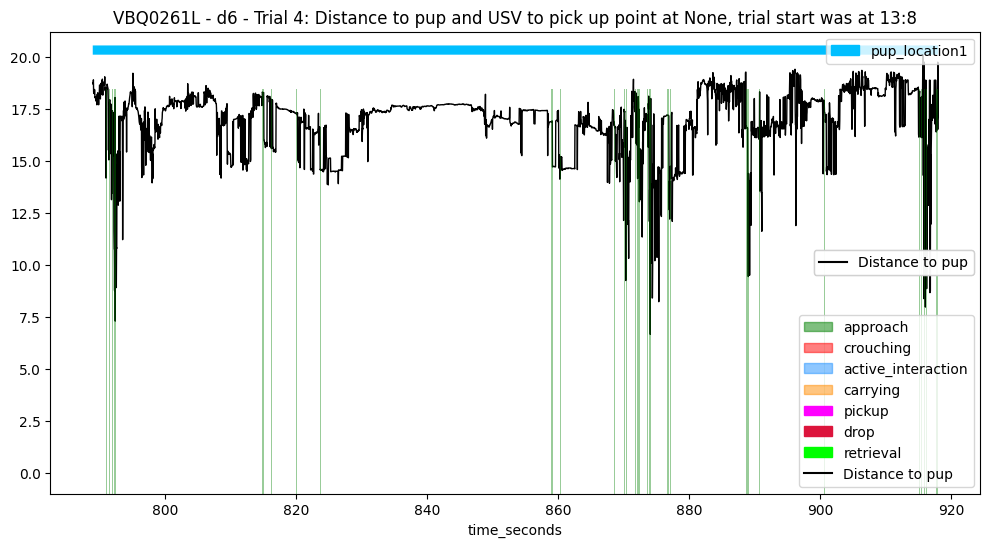

 ==== Example: VBQ0261L - d6 - 5 ==== 
 ==== Example: VBQ0261L - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 5377
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        43
distance_head_to_pup         43
head_angle_to_pup_degrees    43
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup         44
distance_head_to_pup          44
head_angle_to_pu

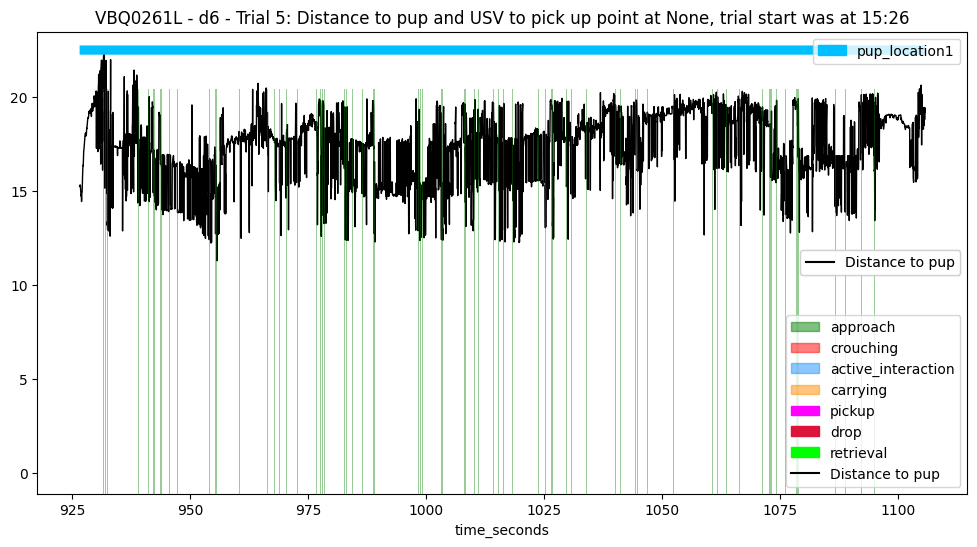

 ==== Example: VBQ0261L - d6 - 6 ==== 
 ==== Example: VBQ0261L - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4759
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        79
distance_head_to_pup         79
head_angle_to_pup_

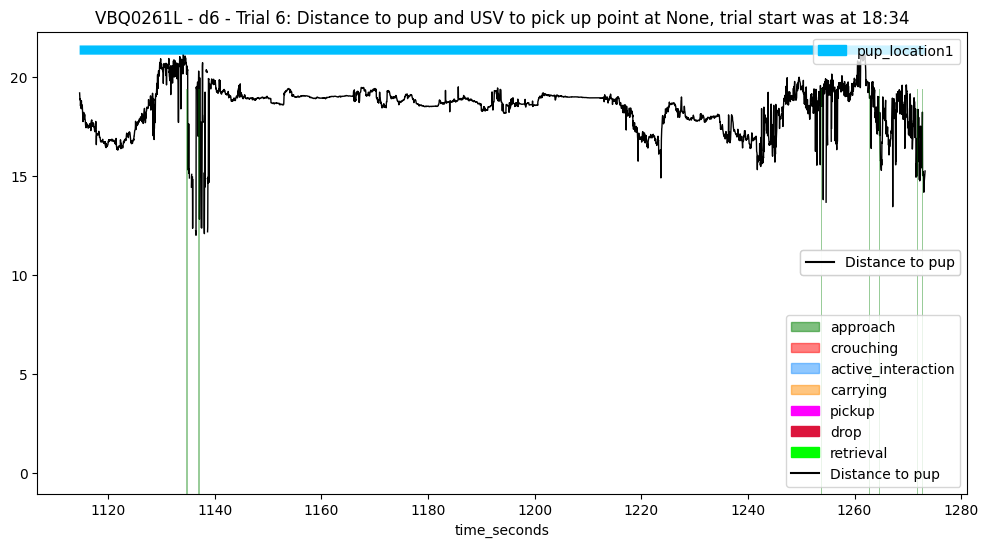

 ==== Example: VBQ0261L - d6 - 7 ==== 
 ==== Example: VBQ0261L - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1386.763
* Success time: 1388.499
---> Pick up frame: 41603, Start frame: 38452, End frame: 41654
---> Retrieval frame: 41655; Start frame: 38452; End frame: 41654
---> Final frame: 41654
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  41603 * Pickup time:  1386.763
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3203
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        32
distance_hea

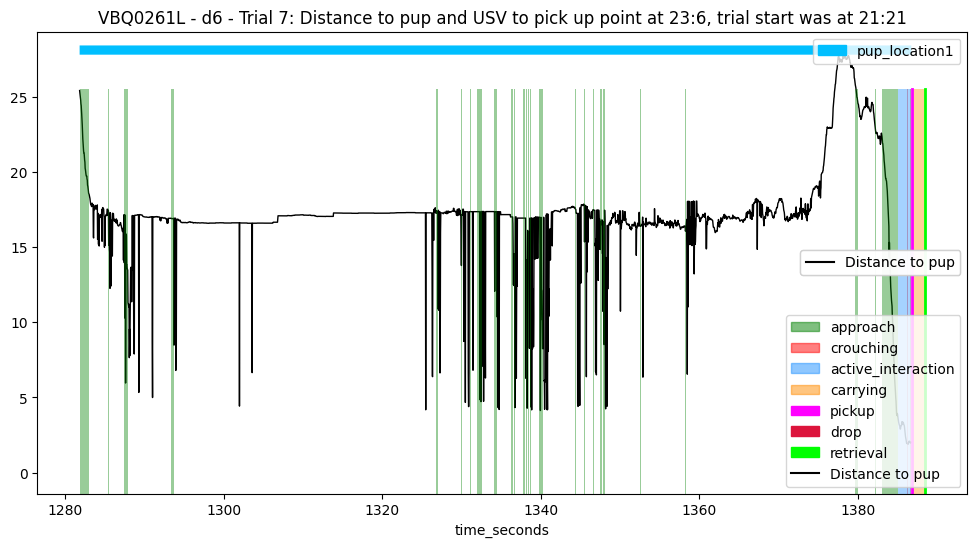

 ==== Example: VBQ0261L - d6 - 8 ==== 
 ==== Example: VBQ0261L - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1426.13
* Success time: 1428.563
---> Pick up frame: 42784, Start frame: 42167, End frame: 42856
---> Retrieval frame: 42857; Start frame: 42167; End frame: 42856
---> Final frame: 42856
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  42784 * Pickup time:  1426.13
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 690
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        35
distance_head_t

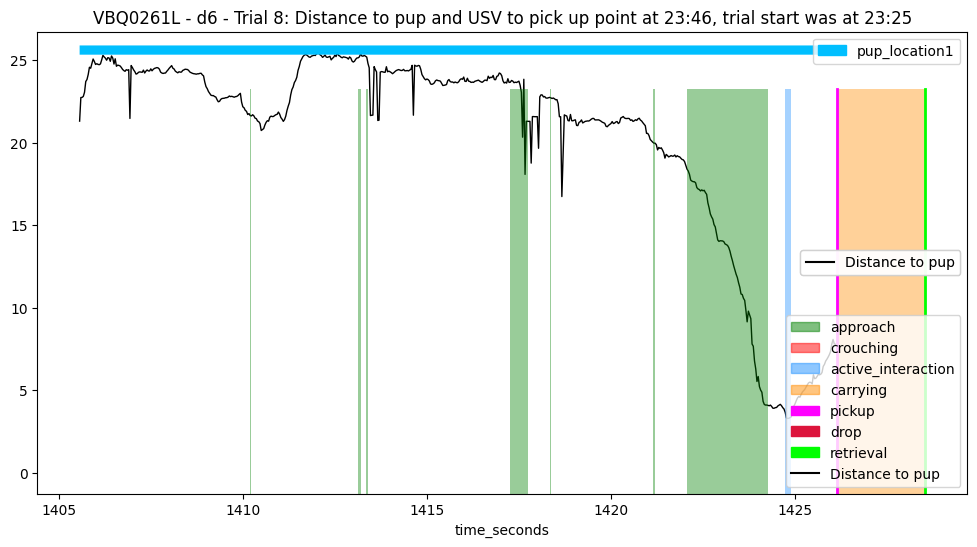

 ==== Example: VBQ0261L - d6 - 9 ==== 
 ==== Example: VBQ0261L - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1453.692
* Success time: 1458.819
---> Pick up frame: 43611, Start frame: 43512, End frame: 43764
---> Retrieval frame: 43765; Start frame: 43512; End frame: 43764
---> Final frame: 43764
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  43611 * Pickup time:  1453.692
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 253
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        18
distance_head

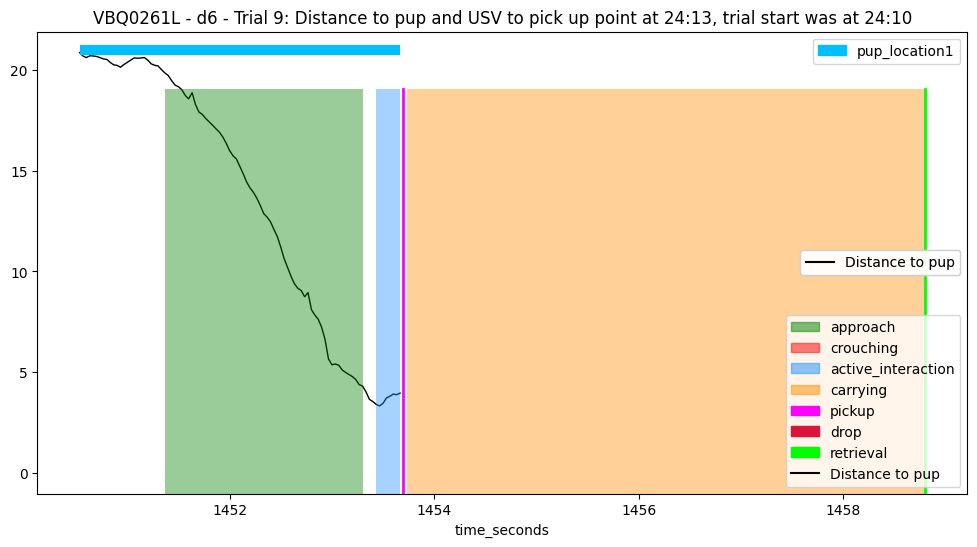

 ==== Example: MBI3793R - d1 - 1 ==== 
 ==== Example: MBI3793R - d1 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3723
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        46
distance_head_to_pup         46
head_angle_to_pup_

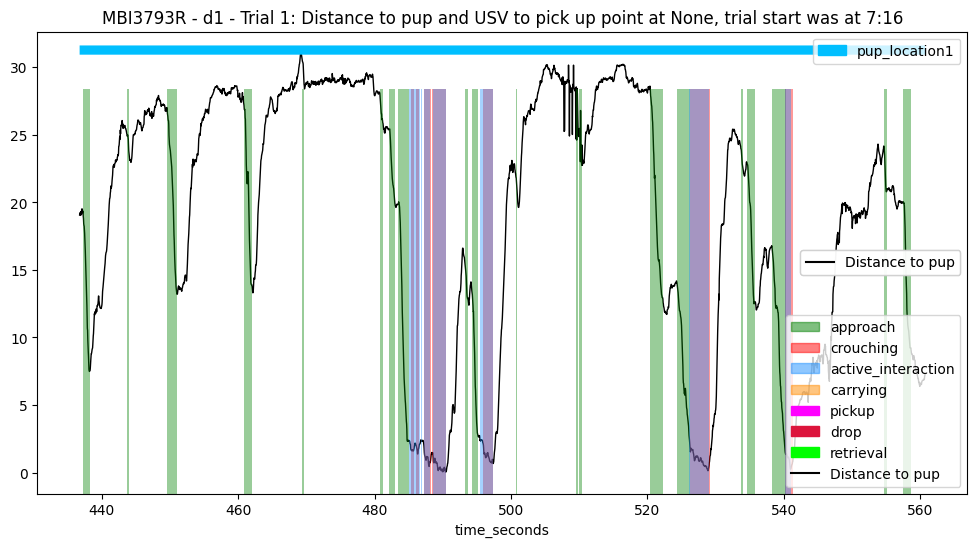

 ==== Example: MBI3793R - d1 - 2 ==== 
 ==== Example: MBI3793R - d1 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3805
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head_to_pup         47
head_angle_to_pup_degrees    47
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        48
distance_head_to_pup         48
head_angle_to_pup_

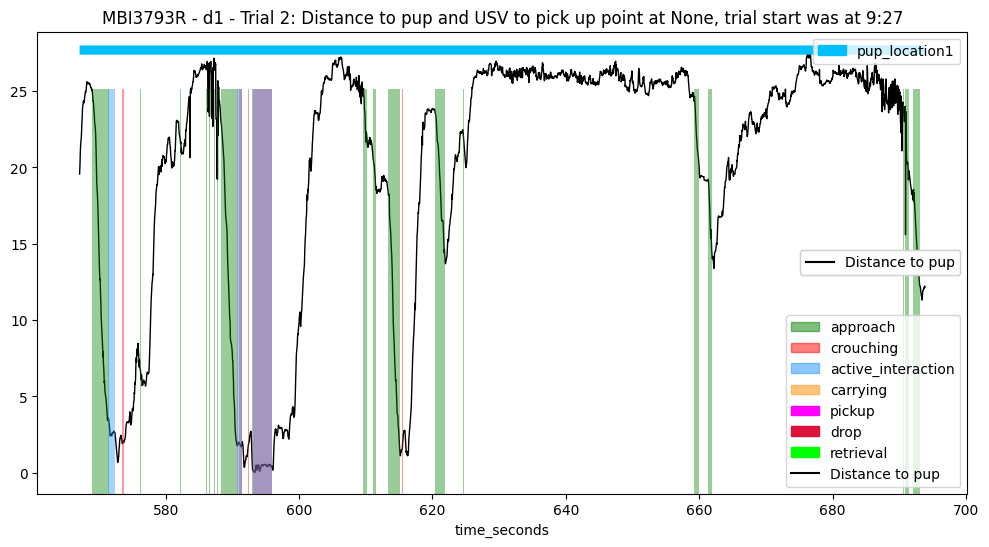

 ==== Example: MBI3793R - d1 - 3 ==== 
 ==== Example: MBI3793R - d1 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 717.915
* Success time: 720.875
---> Pick up frame: 21537, Start frame: 21056, End frame: 21626
---> Retrieval frame: 21626; Start frame: 21056; End frame: 21626
---> Final frame: 21626
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21537 * Pickup time:  717.915
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 571
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to

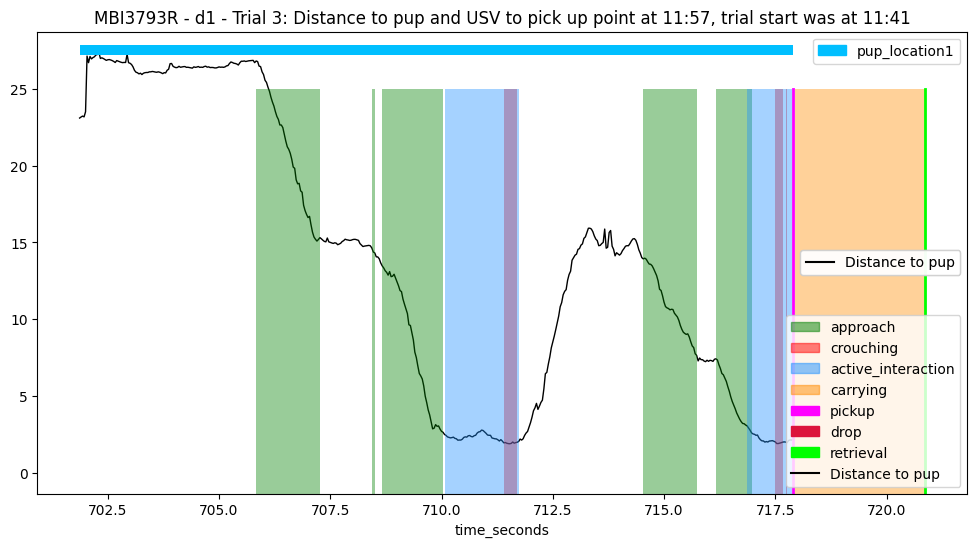

 ==== Example: MBI3793R - d1 - 4 ==== 
 ==== Example: MBI3793R - d1 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 772.963
* Success time: 776.147
---> Pick up frame: 23189, Start frame: 22265, End frame: 23284
---> Retrieval frame: 23284; Start frame: 22265; End frame: 23284
---> Final frame: 23284
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  23189 * Pickup time:  772.963
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1020
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carryin

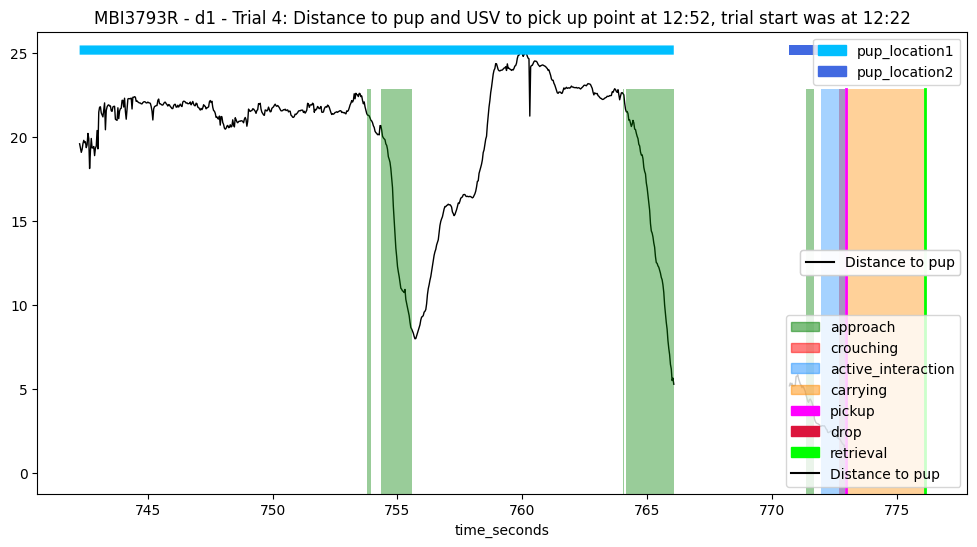

 ==== Example: MBI3793R - d1 - 5 ==== 
 ==== Example: MBI3793R - d1 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 818.835
* Success time: 820.571
---> Pick up frame: 24565, Start frame: 23666, End frame: 24617
---> Retrieval frame: 24617; Start frame: 23666; End frame: 24617
---> Final frame: 24617
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  24565 * Pickup time:  818.835
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 952
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        44
distance_head_to

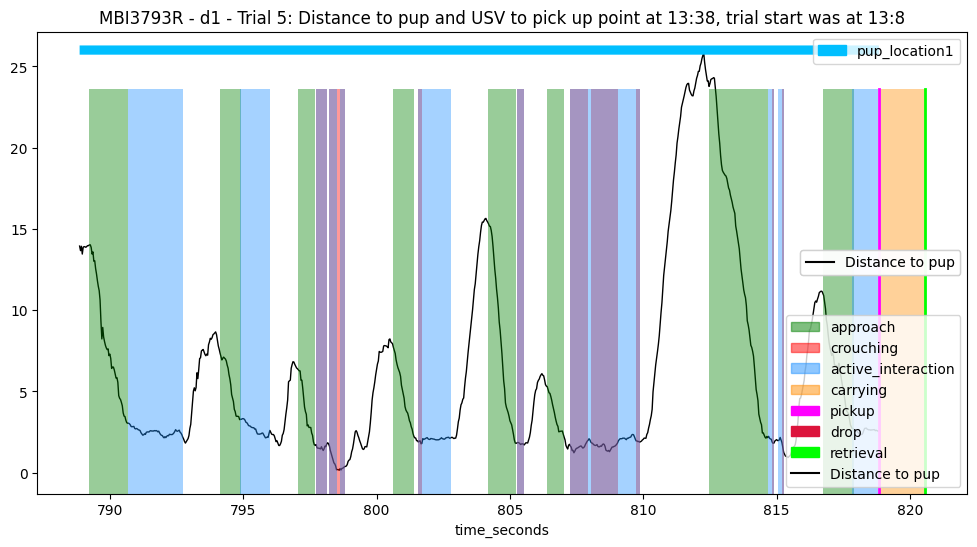

 ==== Example: MBI3793R - d1 - 6 ==== 
 ==== Example: MBI3793R - d1 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 845.299
* Success time: None
---> Pick up frame: 25359, Start frame: 25079, End frame: 28928
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25359 * Pickup time:  845.299
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3850
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 25359, instantly drop at 25360
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        175
distance_head_to

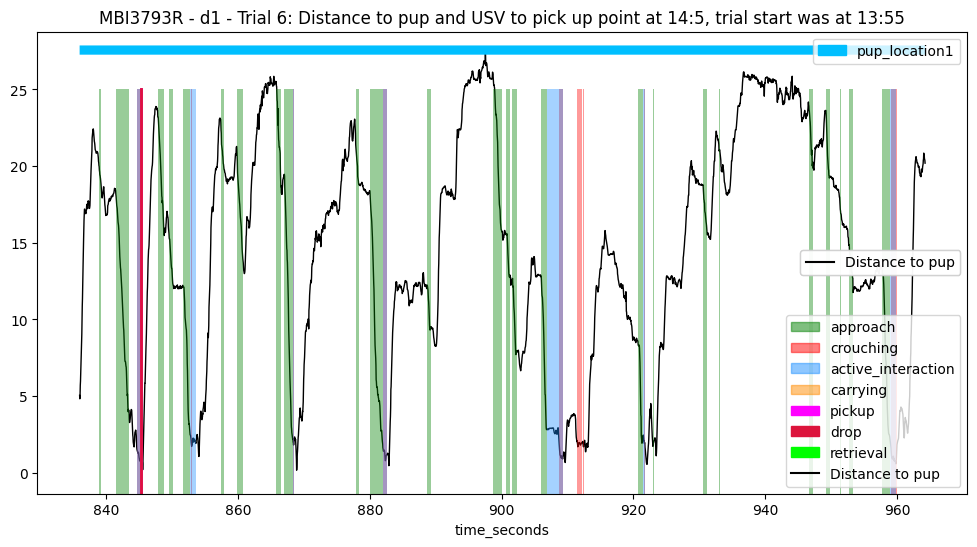

 ==== Example: MBI3793R - d1 - 7 ==== 
 ==== Example: MBI3793R - d1 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1026.147
* Success time: 1027.347
---> Pick up frame: 30784, Start frame: 29125, End frame: 30820
---> Retrieval frame: 30820; Start frame: 29125; End frame: 30820
---> Final frame: 30820
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  30784 * Pickup time:  1026.147
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1696
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_hea

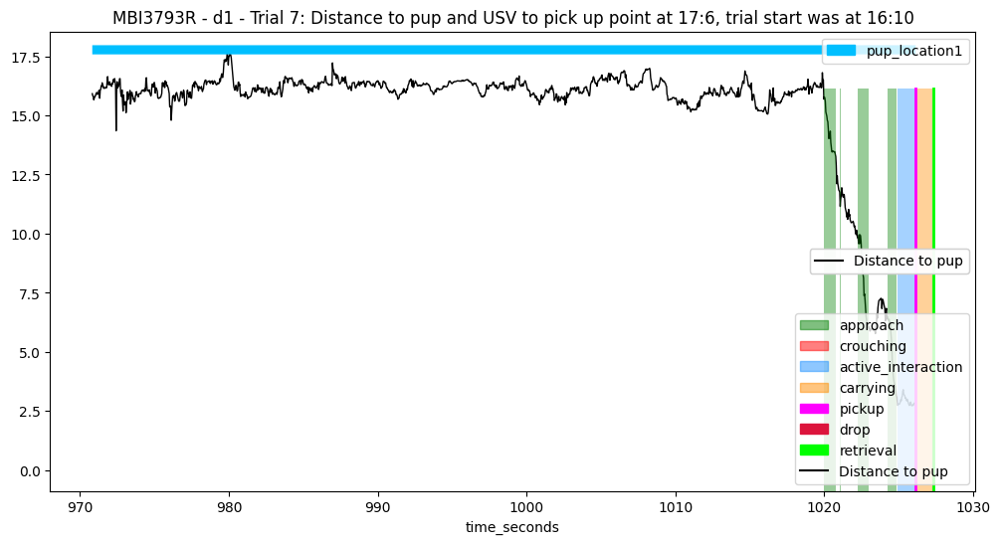

 ==== Example: MBI3793R - d1 - 8 ==== 
 ==== Example: MBI3793R - d1 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1062.691
* Success time: 1065.235
---> Pick up frame: 31881, Start frame: 31390, End frame: 31957
---> Retrieval frame: 31957; Start frame: 31390; End frame: 31957
---> Final frame: 31957
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  31881 * Pickup time:  1062.691
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 568
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        35
distance_head

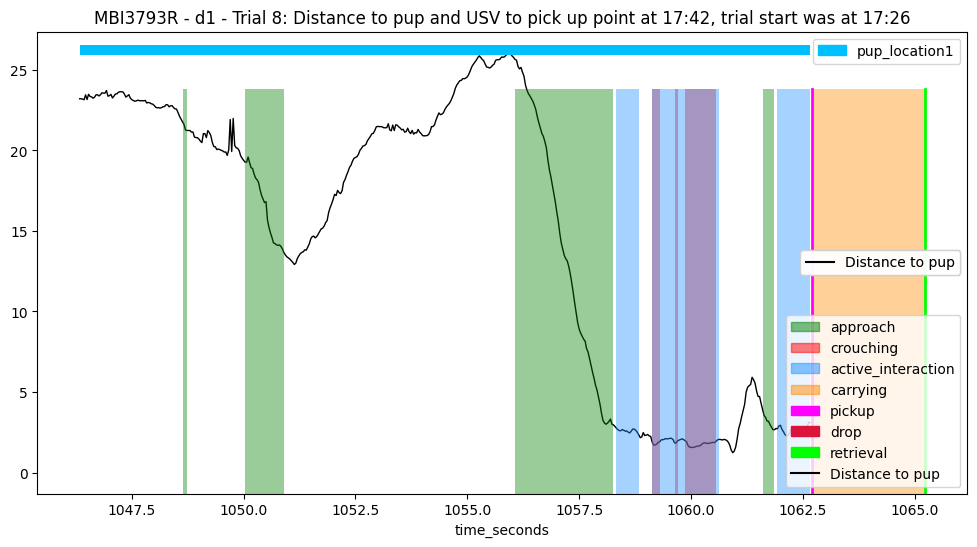

 ==== Example: MBI3793R - d1 - 9 ==== 
 ==== Example: MBI3793R - d1 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1122.051
* Success time: 1124.299
---> Pick up frame: 33662, Start frame: 33265, End frame: 33728
---> Retrieval frame: 33729; Start frame: 33265; End frame: 33728
---> Final frame: 33728
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  33662 * Pickup time:  1122.051
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 464
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        48
distance_head

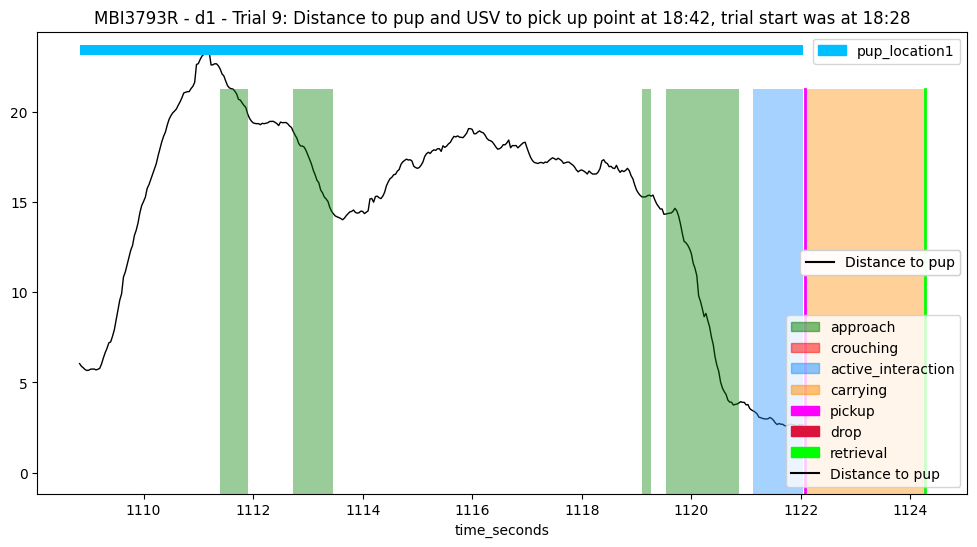

 ==== Example: MBI3793R - d2 - 1 ==== 
 ==== Example: MBI3793R - d2 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 412.549
* Success time: 414.957
---> Pick up frame: 12376, Start frame: 12201, End frame: 12448
---> Retrieval frame: 12449; Start frame: 12201; End frame: 12448
---> Final frame: 12448
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  12376 * Pickup time:  412.549
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 248
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        53
distance_head_to

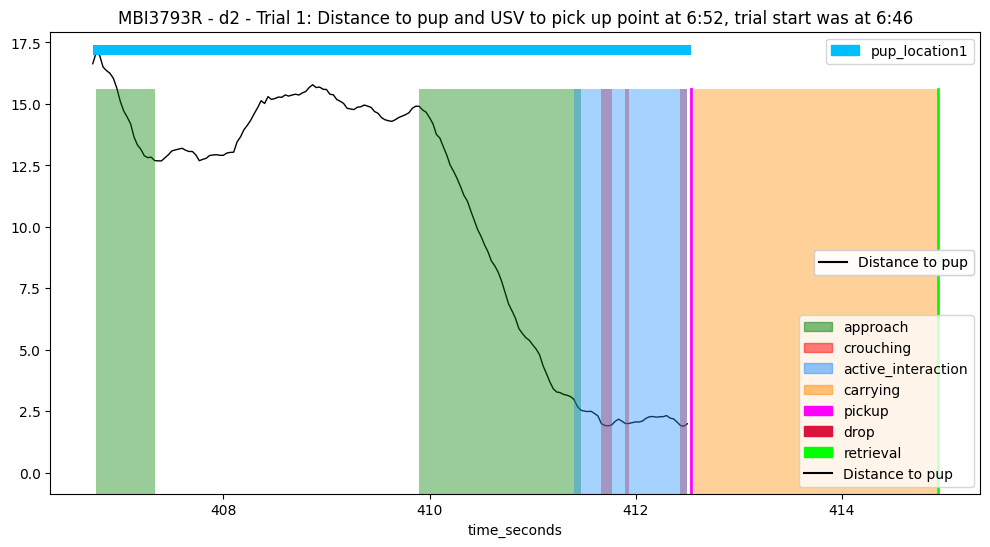

 ==== Example: MBI3793R - d2 - 2 ==== 
 ==== Example: MBI3793R - d2 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 484.461
* Success time: 487.814
---> Pick up frame: 14534, Start frame: 12846, End frame: 14634
---> Retrieval frame: 14634; Start frame: 12846; End frame: 14634
---> Final frame: 14634
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14534 * Pickup time:  484.461
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1789
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        61
distance_head_t

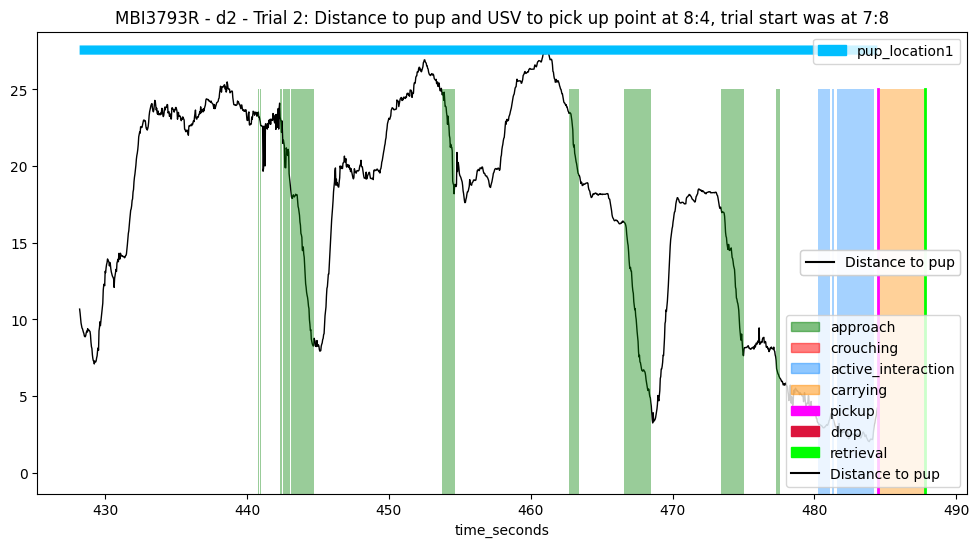

 ==== Example: MBI3793R - d2 - 3 ==== 
 ==== Example: MBI3793R - d2 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 607.814
* Success time: None
---> Pick up frame: 18234, Start frame: 15051, End frame: 18724
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  18234 * Pickup time:  607.814
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3674
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  7.284766912450784

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   True     

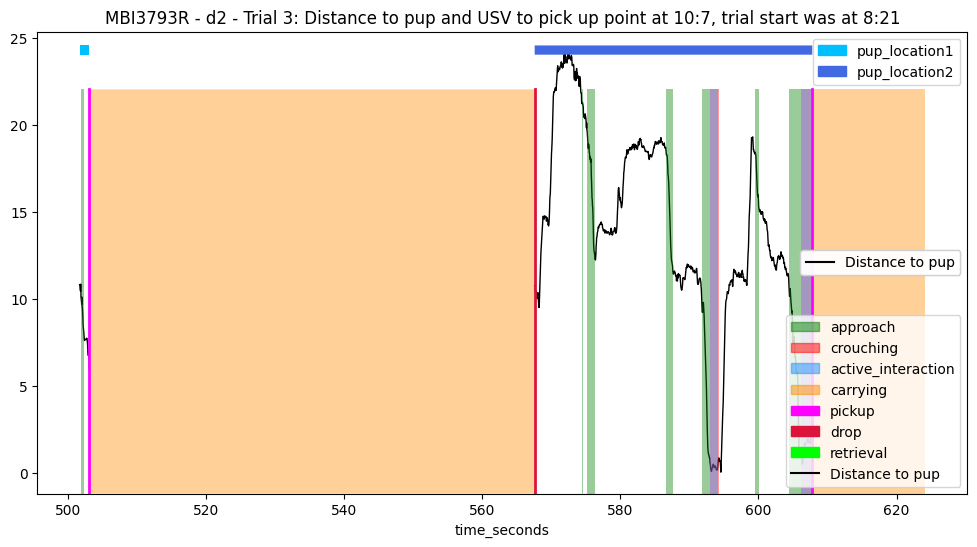

 ==== Example: MBI3793R - d2 - 4 ==== 
 ==== Example: MBI3793R - d2 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 671.382
* Success time: None
---> Pick up frame: 20141, Start frame: 19125, End frame: 22766
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  20141 * Pickup time:  671.382
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3642
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3641
   

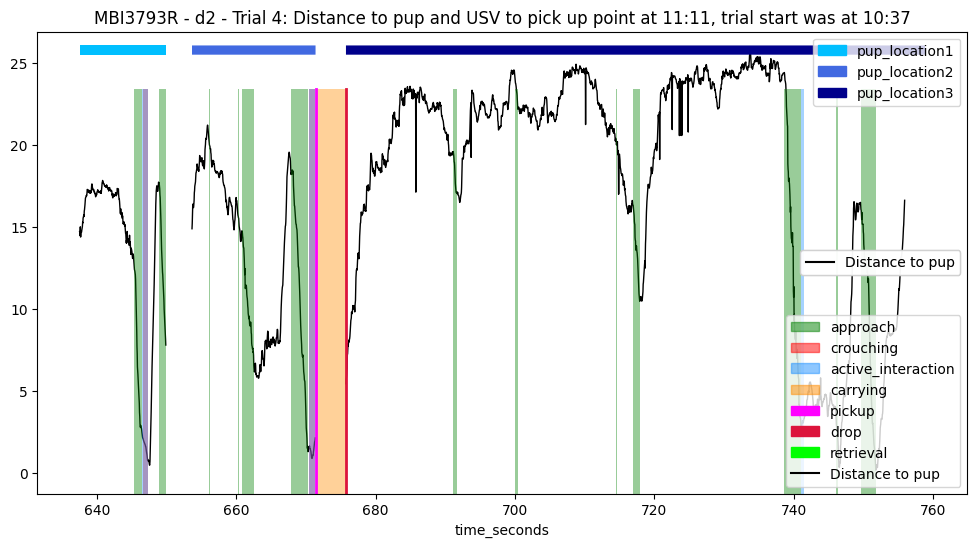

 ==== Example: MBI3793R - d2 - 5 ==== 
 ==== Example: MBI3793R - d2 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 880.758
* Success time: None
---> Pick up frame: 26423, Start frame: 23221, End frame: 26955
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26423 * Pickup time:  880.758
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3735
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        42
distance_head_to_pup         42
head_angle_to_pup_degrees    42
dtype: int64
---Overall NaN counts:  distance_m

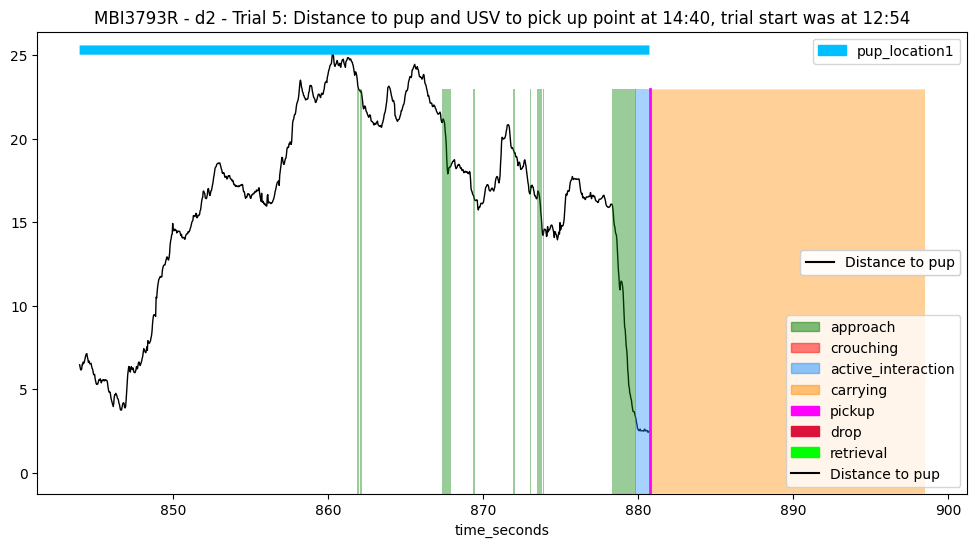

 ==== Example: MBI3793R - d2 - 6 ==== 
 ==== Example: MBI3793R - d2 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1026.742
* Success time: None
---> Pick up frame: 30802, Start frame: 27291, End frame: 31088
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  30802 * Pickup time:  1026.742
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3798
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3797
       True    False     False     

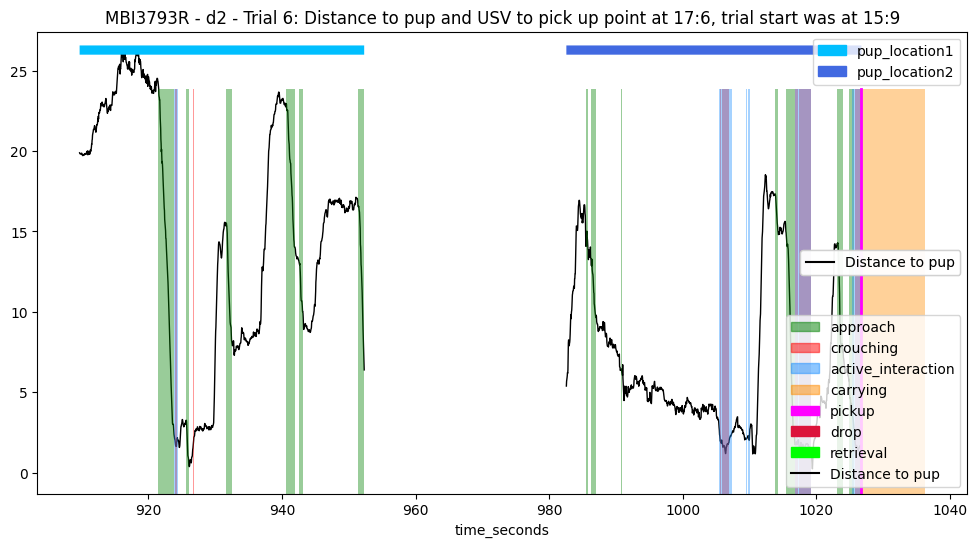

 ==== Example: MBI3793R - d2 - 7 ==== 
 ==== Example: MBI3793R - d2 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1070.51
* Success time: None
---> Pick up frame: 32115, Start frame: 31506, End frame: 35260
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  32115 * Pickup time:  1070.51
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3755
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  15.890866388308979

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False   

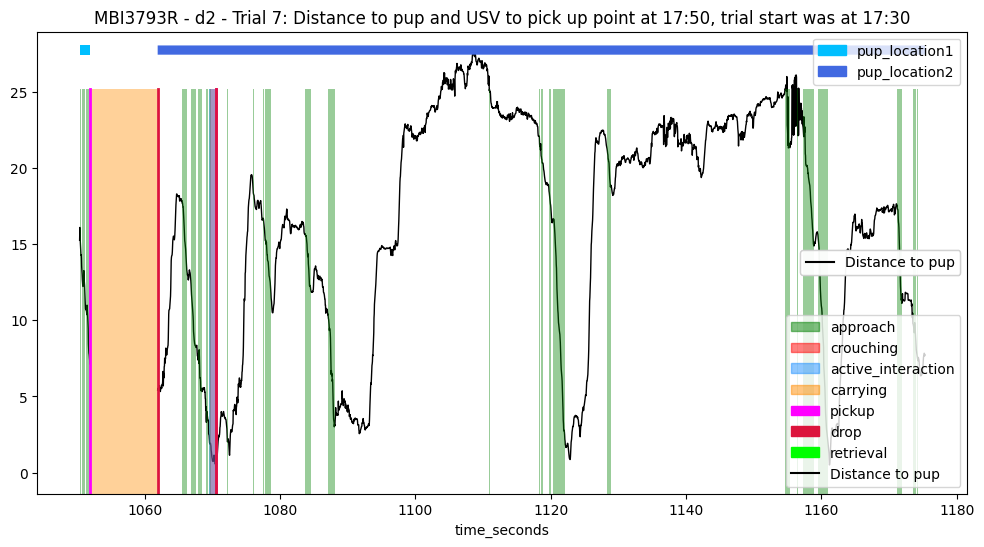

 ==== Example: MBI3793R - d2 - 8 ==== 
 ==== Example: MBI3793R - d2 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1267.086
* Success time: 1270.878
---> Pick up frame: 38013, Start frame: 35921, End frame: 38126
---> Retrieval frame: 38126; Start frame: 35921; End frame: 38126
---> Final frame: 38126
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38013 * Pickup time:  1267.086
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 2206
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        32
distance_hea

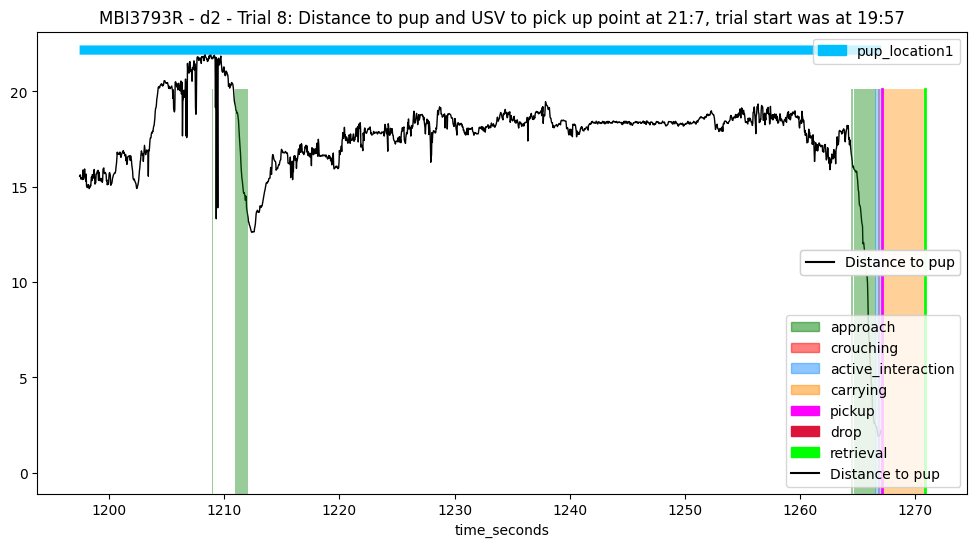

 ==== Example: MBI3793R - d2 - 9 ==== 
 ==== Example: MBI3793R - d2 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1297.398
* Success time: 1299.694
---> Pick up frame: 38922, Start frame: 38532, End frame: 38990
---> Retrieval frame: 38991; Start frame: 38532; End frame: 38990
---> Final frame: 38990
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  38922 * Pickup time:  1297.398
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 459
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        81
distance_head

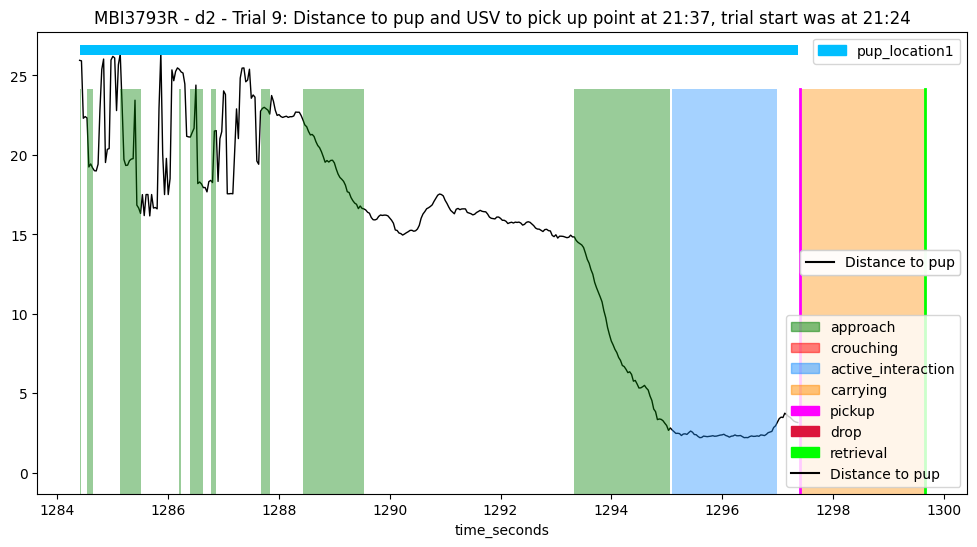

 ==== Example: MBI3793R - d3 - 1 ==== 
 ==== Example: MBI3793R - d3 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 480.698
* Success time: 483.97
---> Pick up frame: 14421, Start frame: 13687, End frame: 14519
---> Retrieval frame: 14519; Start frame: 13687; End frame: 14519
---> Final frame: 14519
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14421 * Pickup time:  480.698
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 833
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        25
distance_head_to_

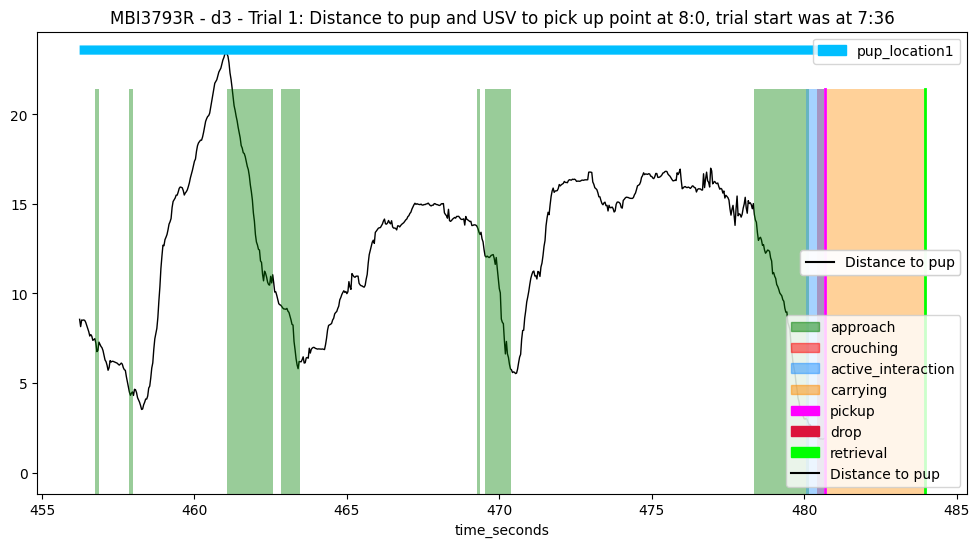

 ==== Example: MBI3793R - d3 - 2 ==== 
 ==== Example: MBI3793R - d3 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 500.25
* Success time: 503.034
---> Pick up frame: 15008, Start frame: 14946, End frame: 15091
---> Retrieval frame: 15091; Start frame: 14946; End frame: 15091
---> Final frame: 15091
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  15008 * Pickup time:  500.25
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 146
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        36
distance_head_to_p

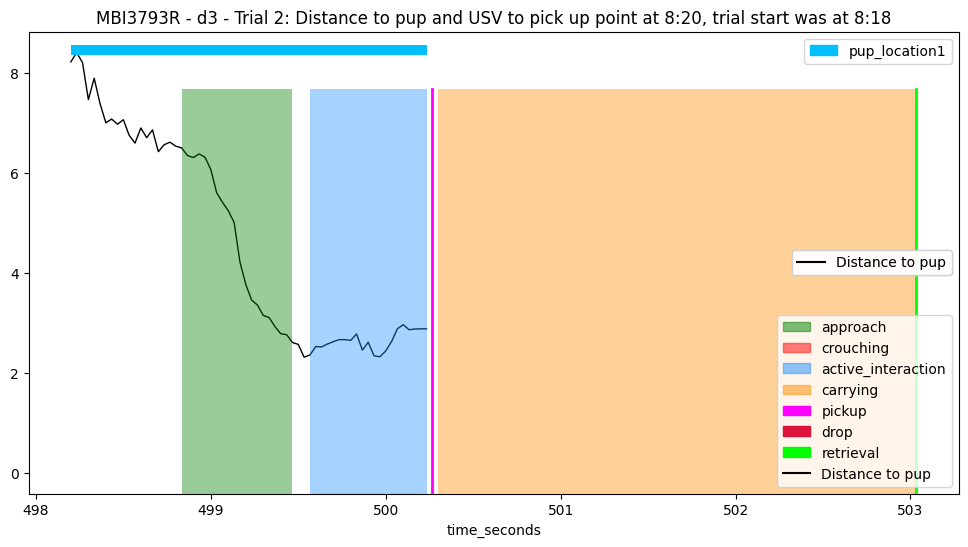

 ==== Example: MBI3793R - d3 - 3 ==== 
 ==== Example: MBI3793R - d3 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 539.77
* Success time: None
---> Pick up frame: 16193, Start frame: 15505, End frame: 19193
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16193 * Pickup time:  539.77
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3689
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 16193, instantly drop at 16194
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_head_to_pu

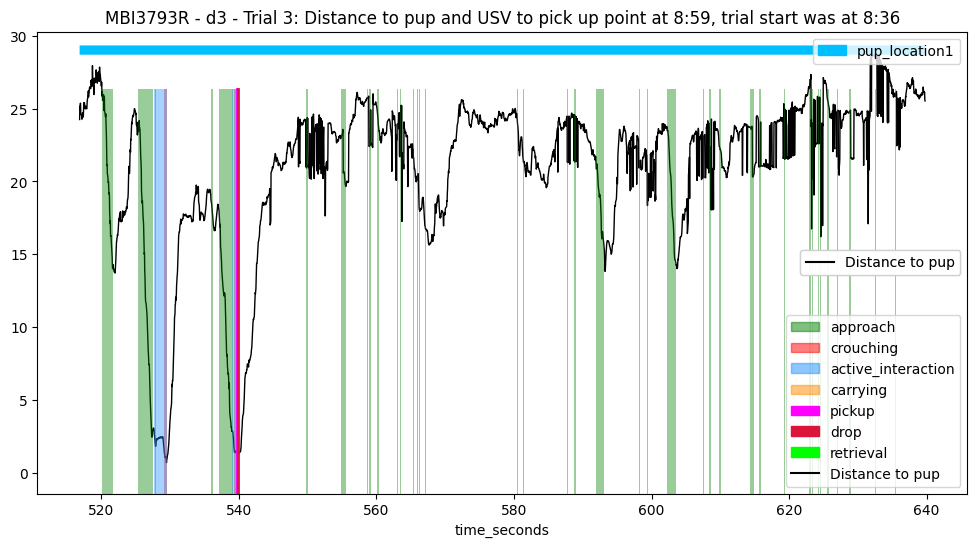

 ==== Example: MBI3793R - d3 - 4 ==== 
 ==== Example: MBI3793R - d3 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 703.258
* Success time: 706.746
---> Pick up frame: 21098, Start frame: 19659, End frame: 21202
---> Retrieval frame: 21202; Start frame: 19659; End frame: 21202
---> Final frame: 21202
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  21098 * Pickup time:  703.258
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1544
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        46
distance_head_t

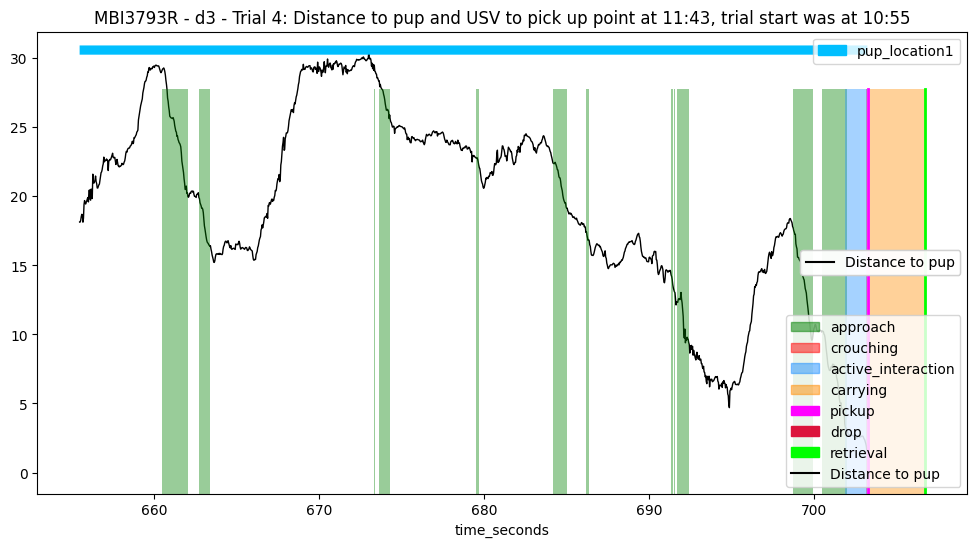

 ==== Example: MBI3793R - d3 - 5 ==== 
 ==== Example: MBI3793R - d3 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 759.866
* Success time: 762.682
---> Pick up frame: 22796, Start frame: 21609, End frame: 22880
---> Retrieval frame: 22880; Start frame: 21609; End frame: 22880
---> Final frame: 22880
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  22796 * Pickup time:  759.866
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1272
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        74
distance_head_t

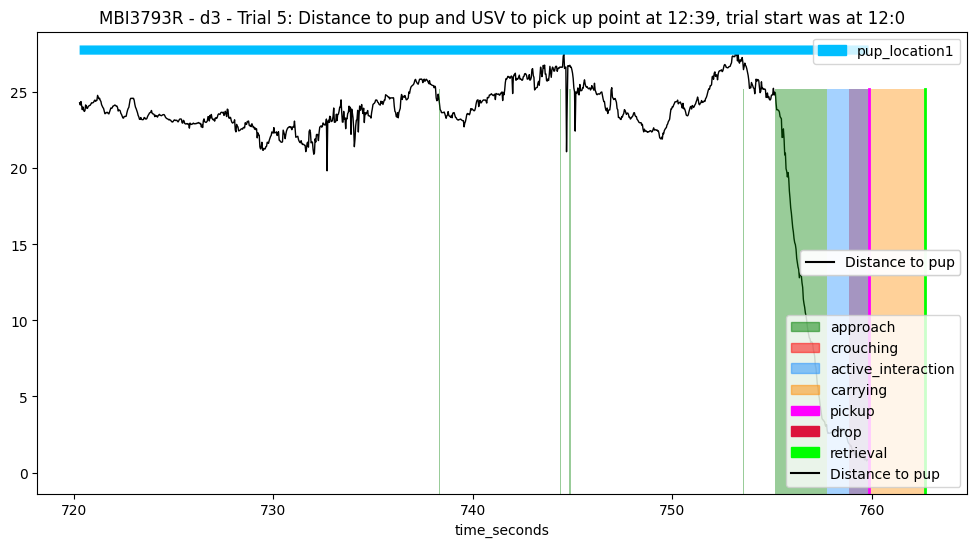

 ==== Example: MBI3793R - d3 - 6 ==== 
 ==== Example: MBI3793R - d3 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 866.154
* Success time: None
---> Pick up frame: 25985, Start frame: 23558, End frame: 27335
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  25985 * Pickup time:  866.154
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3778
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 25985, instantly drop at 25986
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        69
distance_head_to_

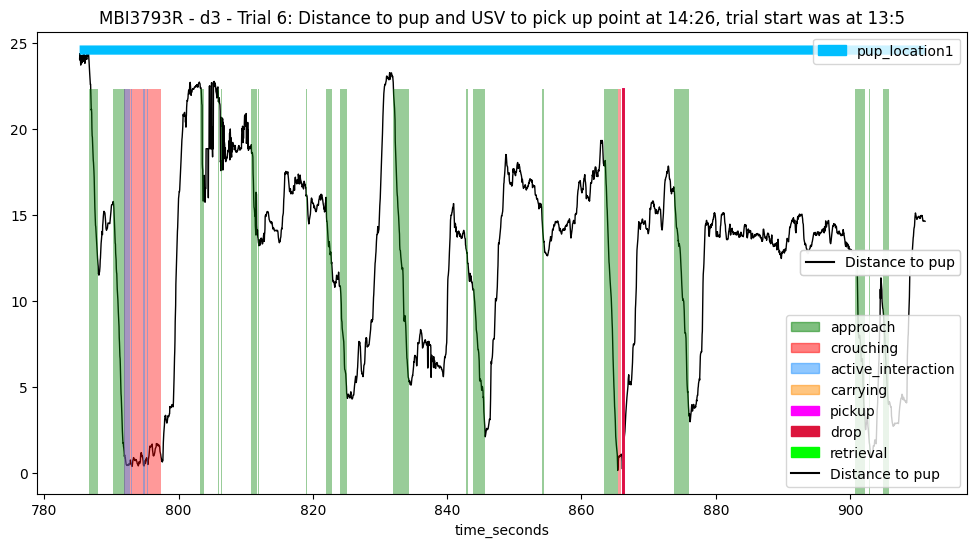

 ==== Example: MBI3793R - d3 - 7 ==== 
 ==== Example: MBI3793R - d3 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3774
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        44
distance_head_to_pup         44
head_angle_to_pup_degrees    44
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        205
distance_head_to_pup         205
head_angle_to_pu

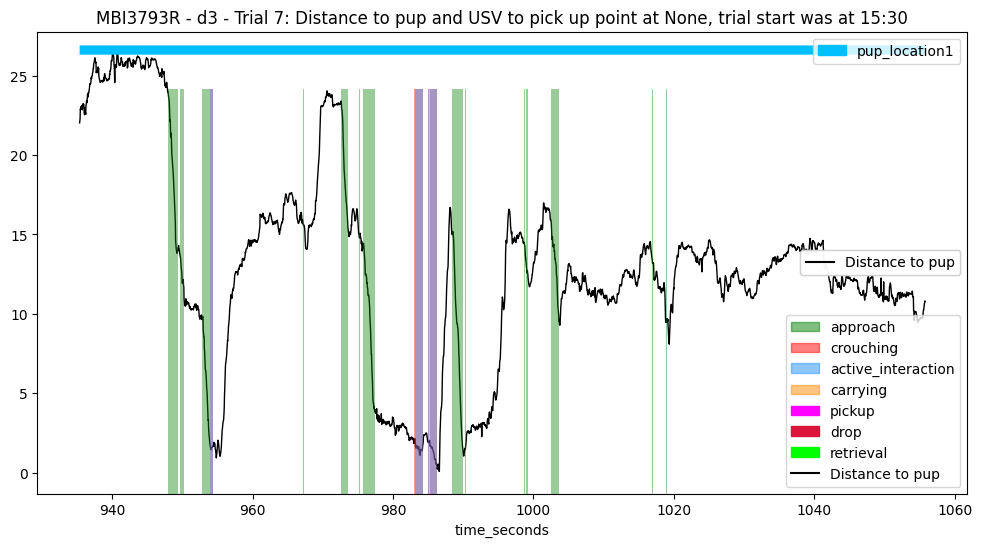

 ==== Example: MBI3793R - d3 - 8 ==== 
 ==== Example: MBI3793R - d3 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1159.675
* Success time: None
---> Pick up frame: 34790, Start frame: 32228, End frame: 35889
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  34790 * Pickup time:  1159.675
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3662
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        26
distance_head_to_pup         26
head_angle_to

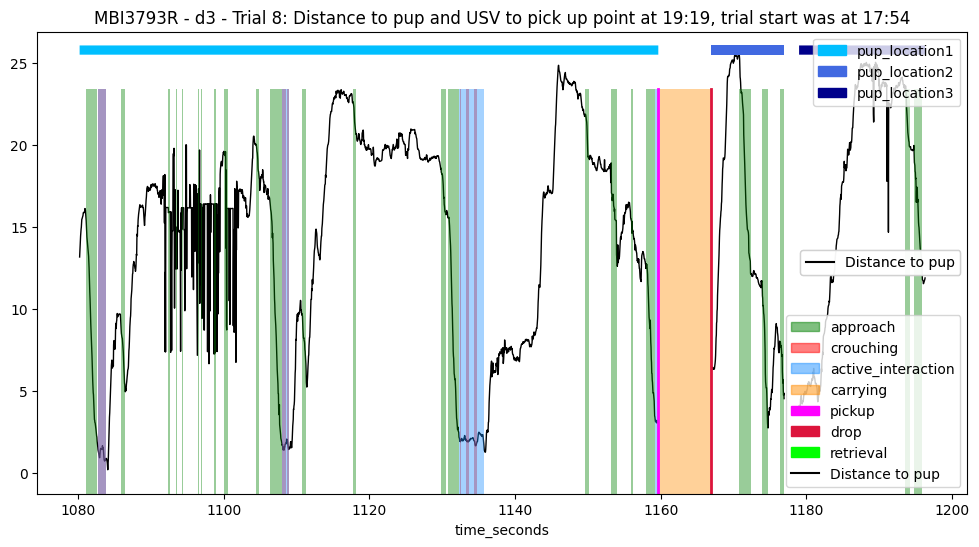

 ==== Example: MBI3793R - d3 - 9 ==== 
 ==== Example: MBI3793R - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1221.731
* Success time: 1232.067
---> Pick up frame: 36652, Start frame: 36500, End frame: 36962
---> Retrieval frame: 36962; Start frame: 36500; End frame: 36962
---> Final frame: 36962
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  36652 * Pickup time:  1221.731
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 463
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_

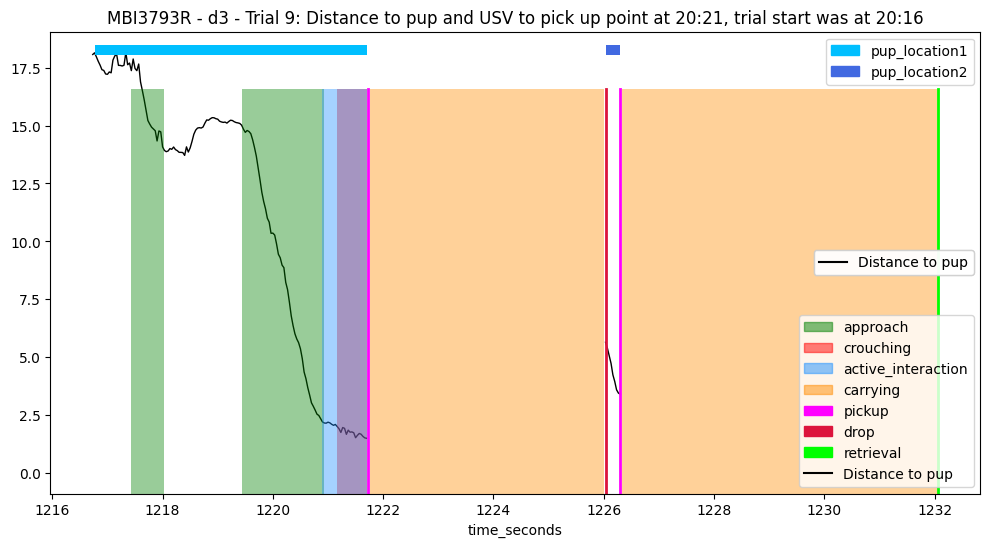

 ==== Example: MBI3793R - d4 - 1 ==== 
 ==== Example: MBI3793R - d4 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 476.817
* Success time: None
---> Pick up frame: 14305, Start frame: 12786, End frame: 16528
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  14305 * Pickup time:  476.817
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3743
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        538
distance_head_to_pup         538
head_angle_to_pup_degrees    538
dtype: int64
---Overall NaN counts:  distanc

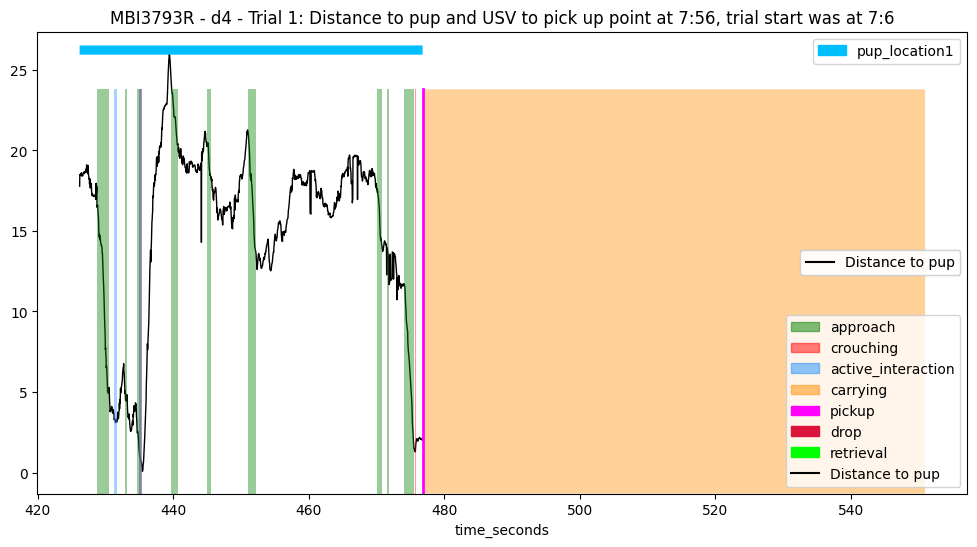

 ==== Example: MBI3793R - d4 - 2 ==== 
 ==== Example: MBI3793R - d4 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 563.777
* Success time: 566.593
---> Pick up frame: 16913, Start frame: 16770, End frame: 16997
---> Retrieval frame: 16998; Start frame: 16770; End frame: 16997
---> Final frame: 16997
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  16913 * Pickup time:  563.777
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 228
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to

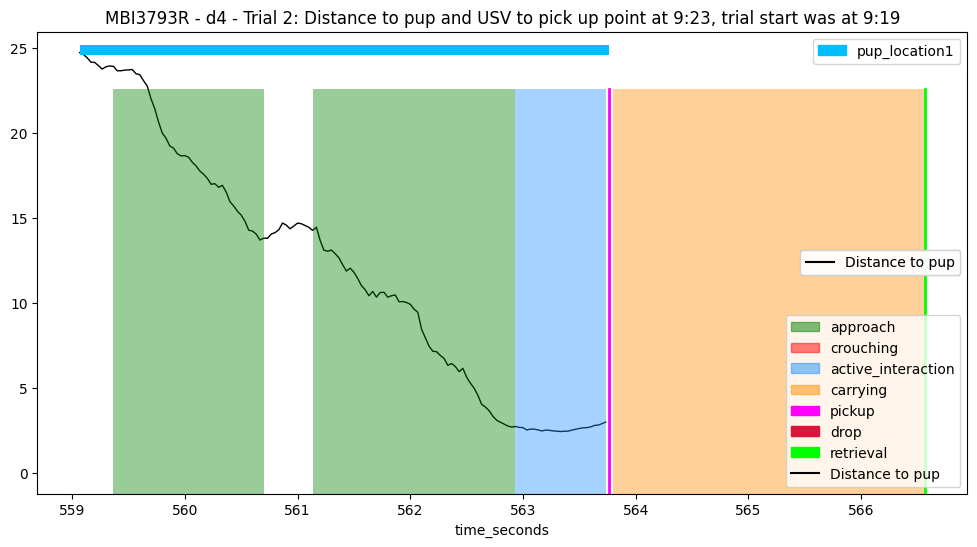

 ==== Example: MBI3793R - d4 - 3 ==== 
 ==== Example: MBI3793R - d4 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 595.345
* Success time: None
---> Pick up frame: 17860, Start frame: 17593, End frame: 21299
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  17860 * Pickup time:  595.345
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3707
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        34
distance_head_to_pup         34
head_angle_to_pup_degrees    34
dtype: int64
---O

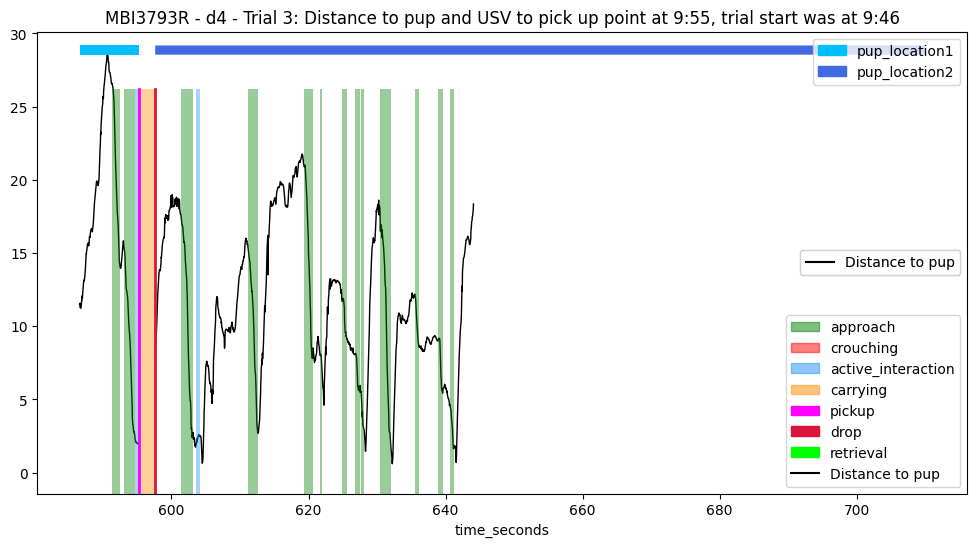

 ==== Example: MBI3793R - d4 - 4 ==== 
 ==== Example: MBI3793R - d4 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 773.393
* Success time: None
---> Pick up frame: 23202, Start frame: 21706, End frame: 26222
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  23202 * Pickup time:  773.393
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4517
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        158
distance_head_to_pup         158
head_angle_to_pup_degrees    158
dtype: int64
-

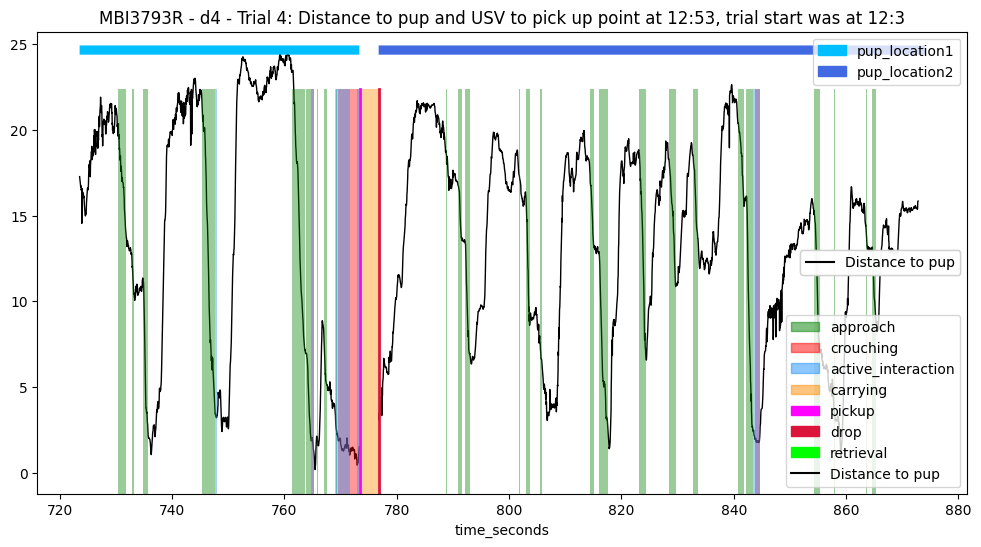

 ==== Example: MBI3793R - d4 - 5 ==== 
 ==== Example: MBI3793R - d4 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 886.761
* Success time: None
---> Pick up frame: 26603, Start frame: 26459, End frame: 30114
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26603 * Pickup time:  886.761
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3656
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 26603, instantly drop at 26604
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        39
distance_head_to_

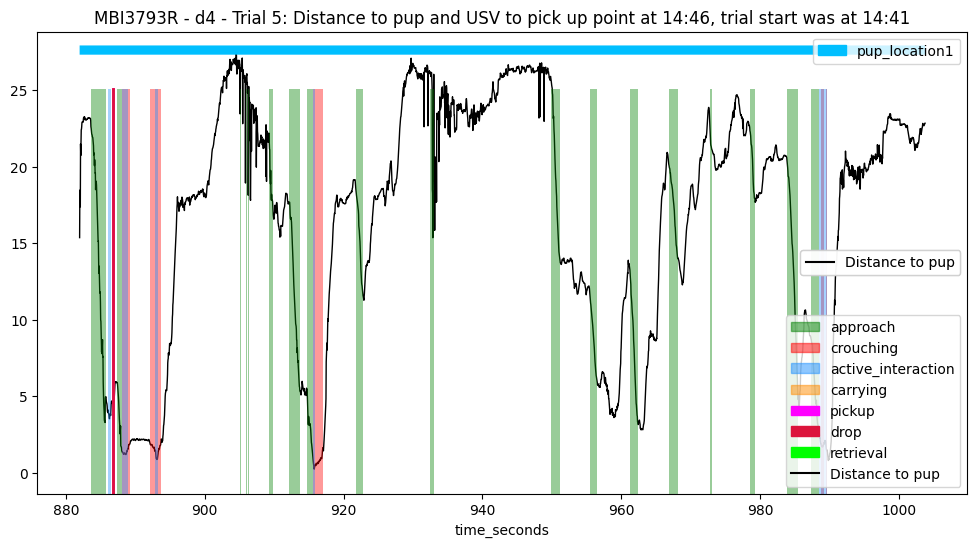

 ==== Example: MBI3793R - d4 - 6 ==== 
 ==== Example: MBI3793R - d4 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 4151
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        644
distance_head_to_pup         644
head_angle_to_pup_degrees    644
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        4134
distance_head_to_pup         4134
head_angle_

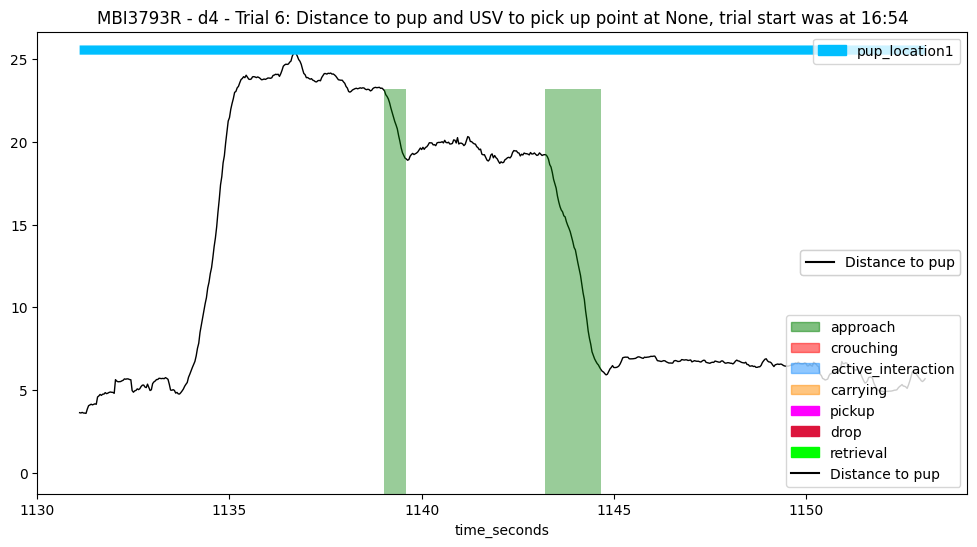

 ==== Example: MBI3793R - d4 - 7 ==== 
 ==== Example: MBI3793R - d4 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3808
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3808
Name: count, dtype: int64

===== General pup-directed analysis =====
 -> Window: 1165.5333333333333 to 1179.

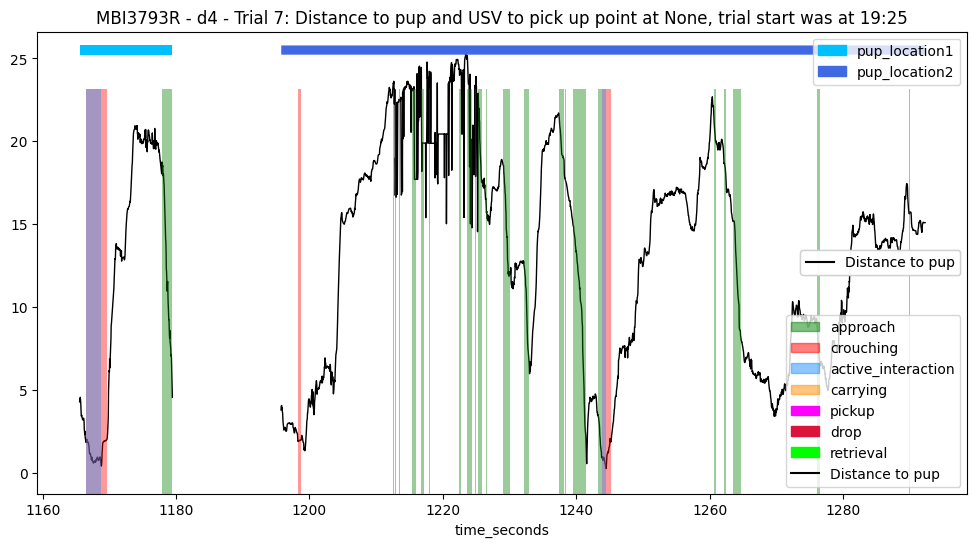

 ==== Example: MBI3793R - d4 - 8 ==== 
 ==== Example: MBI3793R - d4 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1318.553
* Success time: 1320.754
---> Pick up frame: 39557, Start frame: 39119, End frame: 39622
---> Retrieval frame: 39623; Start frame: 39119; End frame: 39622
---> Final frame: 39622
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  39557 * Pickup time:  1318.553
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 504
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        47
distance_head

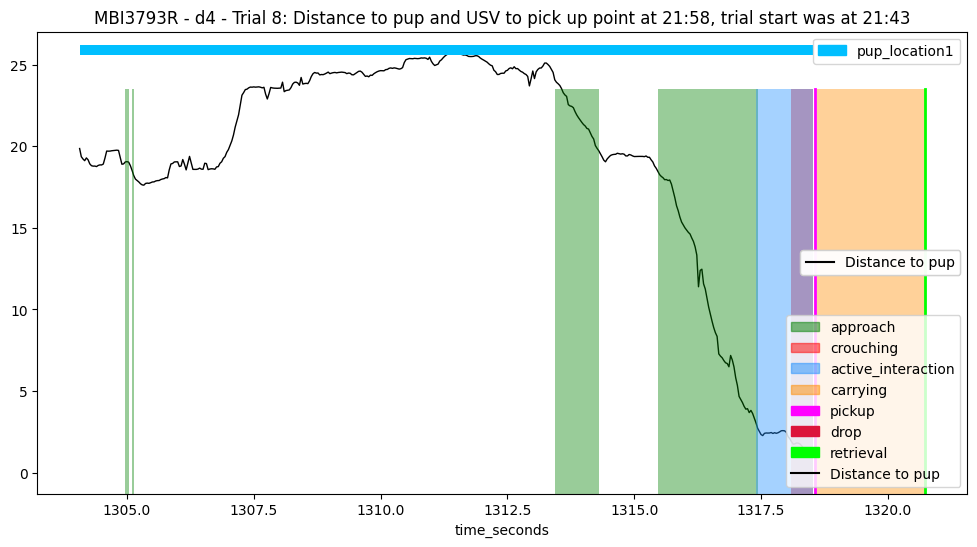

 ==== Example: MBI3793R - d4 - 9 ==== 
 ==== Example: MBI3793R - d4 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1355.506
* Success time: 1357.706
---> Pick up frame: 40665, Start frame: 40167, End frame: 40731
---> Retrieval frame: 40731; Start frame: 40167; End frame: 40731
---> Final frame: 40731
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  40665 * Pickup time:  1355.506
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 565
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head

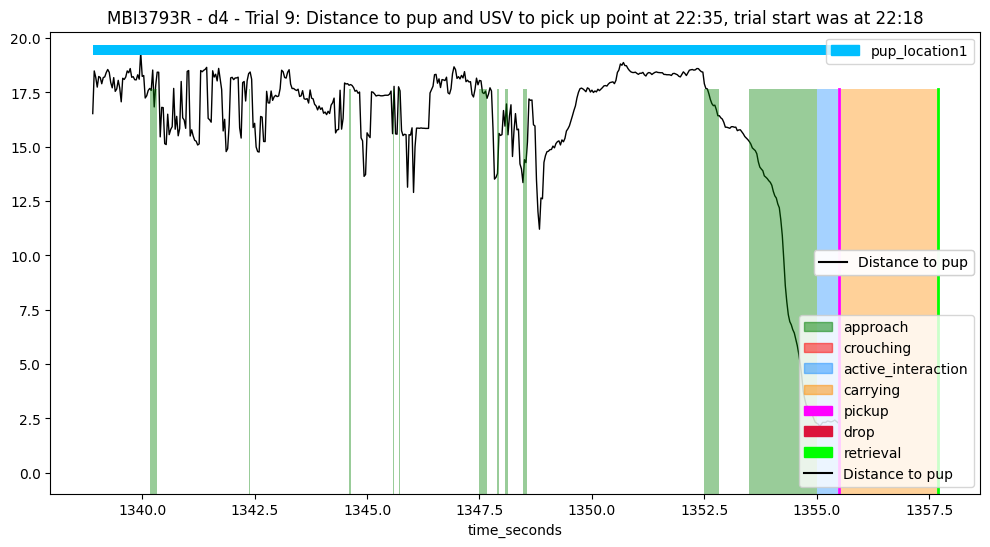

 ==== Example: MBI3793R - d5 - 1 ==== 
 ==== Example: MBI3793R - d5 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 501.218
* Success time: None
---> Pick up frame: 15037, Start frame: 14013, End frame: 17881
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  15037 * Pickup time:  501.218
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3869
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        94
distance_head_to_pup         94
head_angle_to_pup_degrees    94
dtype: int64
---O

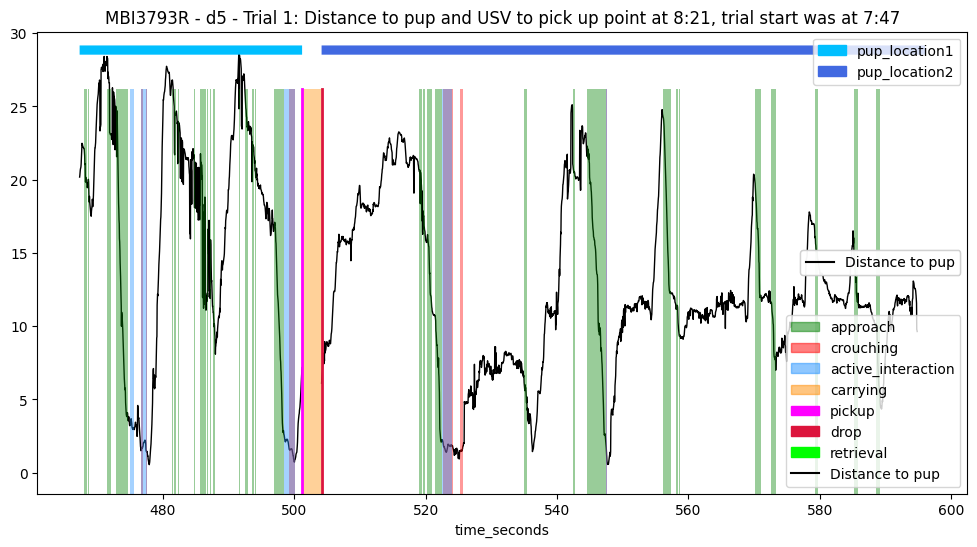

 ==== Example: MBI3793R - d5 - 2 ==== 
 ==== Example: MBI3793R - d5 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 605.706
* Success time: 608.578
---> Pick up frame: 18171, Start frame: 18116, End frame: 18257
---> Retrieval frame: 18257; Start frame: 18116; End frame: 18257
---> Final frame: 18257
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  18171 * Pickup time:  605.706
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 142
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        44
distance_head_to

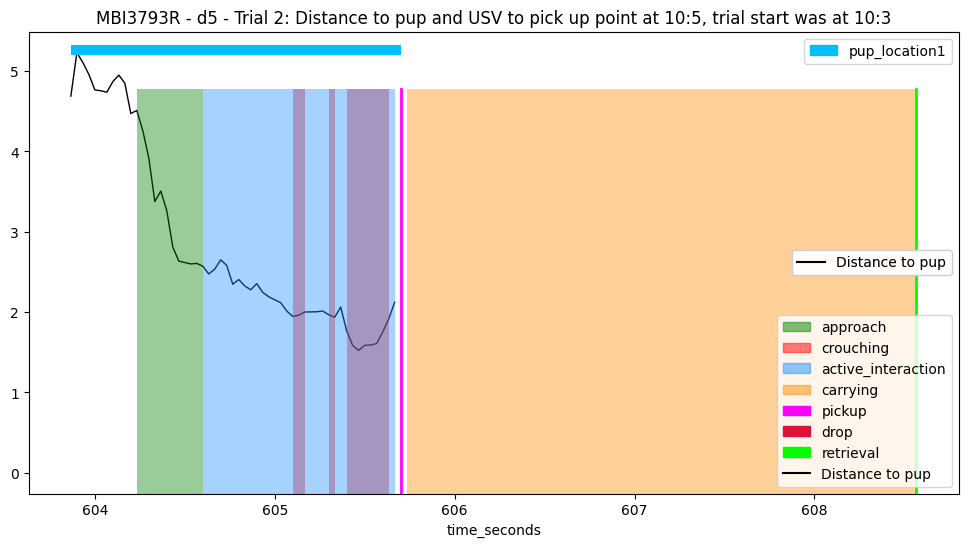

 ==== Example: MBI3793R - d5 - 3 ==== 
 ==== Example: MBI3793R - d5 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3781
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        3052
distance_head_to_pup         3052
head_angle_to_pup_degrees    3052
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        3052
distance_head_to_pup         3052
head_ang

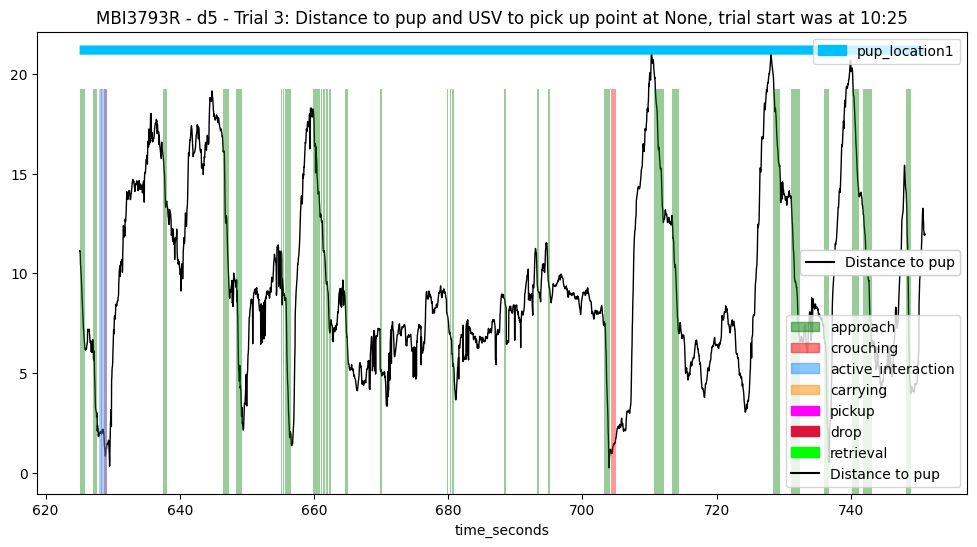

 ==== Example: MBI3793R - d5 - 4 ==== 
 ==== Example: MBI3793R - d5 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3703
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        2469
distance_head_to_pup         2469
head_angle_to_pup_degrees    2469
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        2737
distance_head_to_pup         2737
head_ang

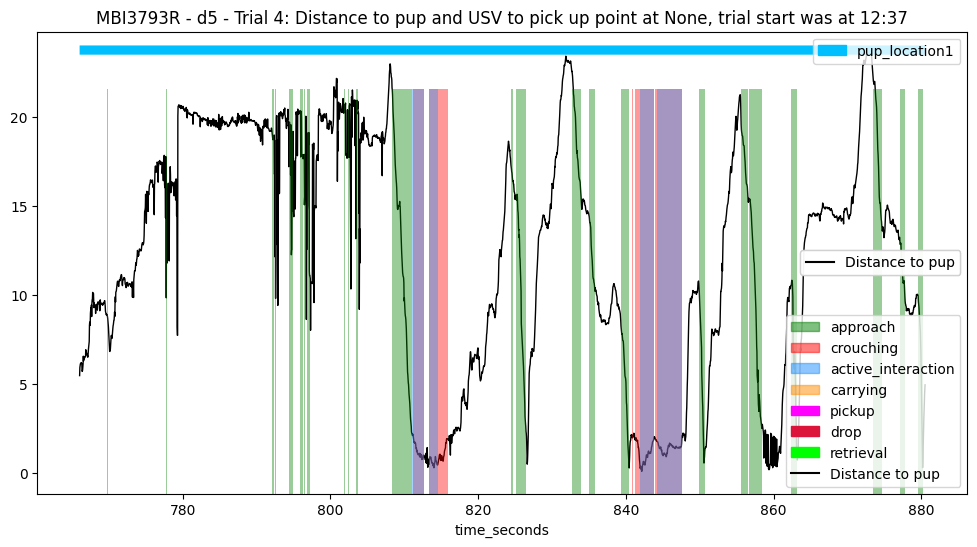

 ==== Example: MBI3793R - d5 - 5 ==== 
 ==== Example: MBI3793R - d5 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 893.922
* Success time: 897.37
---> Pick up frame: 26818, Start frame: 26589, End frame: 26921
---> Retrieval frame: 26921; Start frame: 26589; End frame: 26921
---> Final frame: 26921
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26818 * Pickup time:  893.922
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 333
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to_

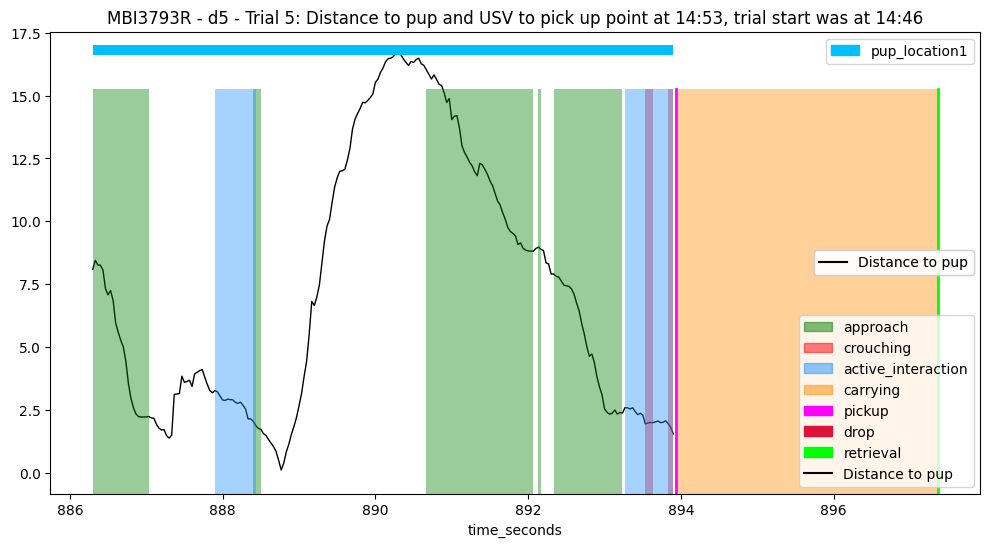

 ==== Example: MBI3793R - d5 - 6 ==== 
 ==== Example: MBI3793R - d5 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 915.762
* Success time: 919.682
---> Pick up frame: 27473, Start frame: 27427, End frame: 27590
---> Retrieval frame: 27590; Start frame: 27427; End frame: 27590
---> Final frame: 27590
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  27473 * Pickup time:  915.762
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 164
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to

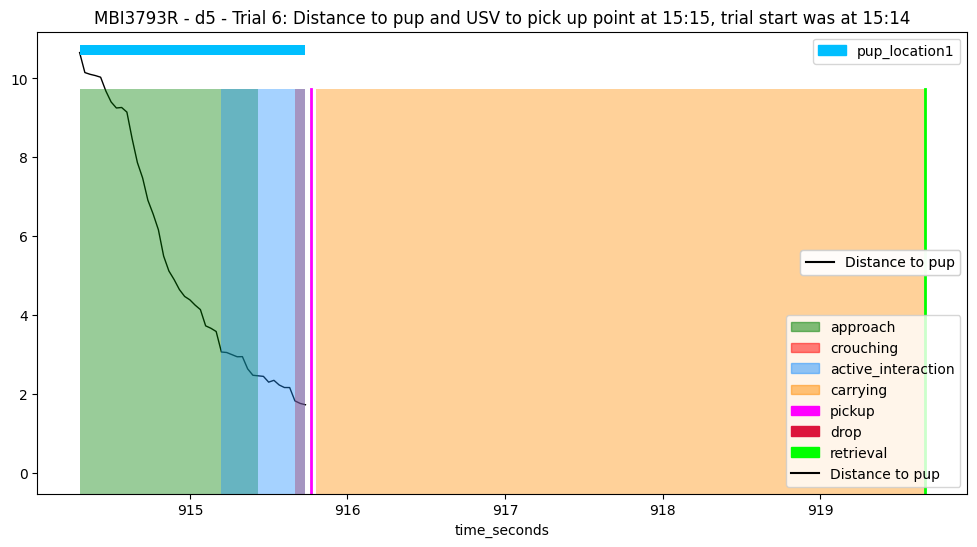

 ==== Example: MBI3793R - d5 - 7 ==== 
 ==== Example: MBI3793R - d5 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 946.618
* Success time: 948.698
---> Pick up frame: 28399, Start frame: 28106, End frame: 28460
---> Retrieval frame: 28461; Start frame: 28106; End frame: 28460
---> Final frame: 28460
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  28399 * Pickup time:  946.618
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 355
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        33
distance_head_to

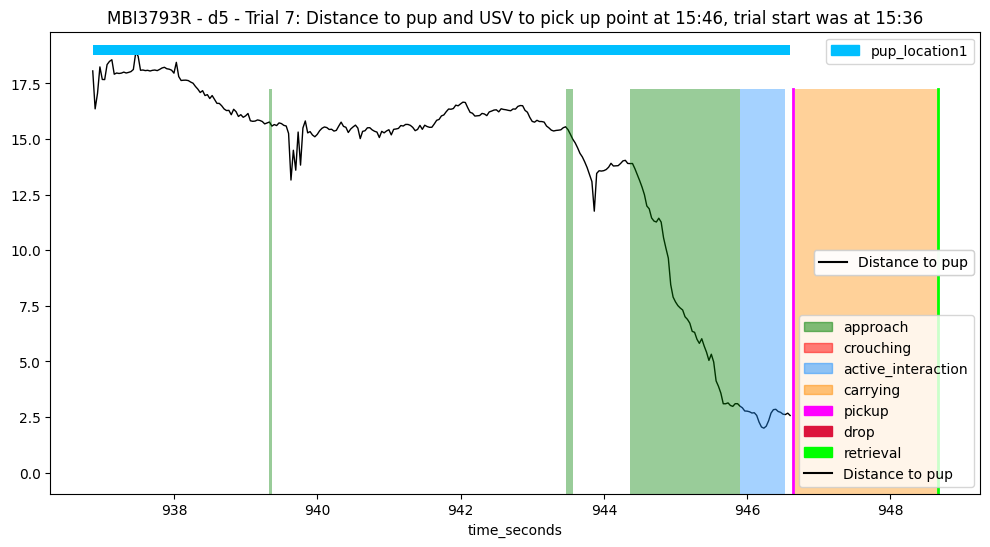

 ==== Example: MBI3793R - d5 - 8 ==== 
 ==== Example: MBI3793R - d5 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1054.674
* Success time: None
---> Pick up frame: 31640, Start frame: 28898, End frame: 32619
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2', 'pup_location3']
Last location: pup_location3
Pup locations no success: ['pup_location1', 'pup_location2']
4.Computing distances
5.Annotating trial
* Pick up frame:  31640 * Pickup time:  1054.674
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3722
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  retrieval
False  False   False     False        3721
 

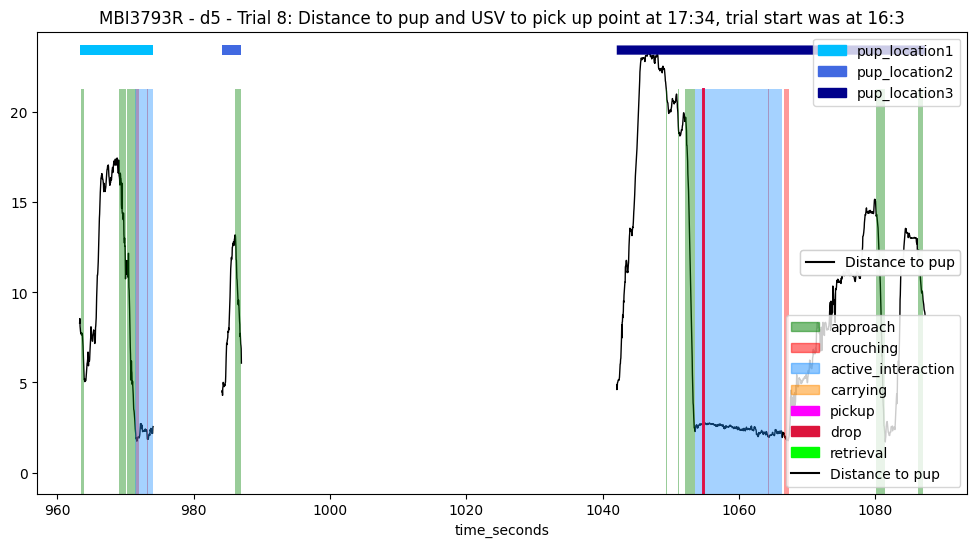

 ==== Example: MBI3793R - d5 - 9 ==== 
 ==== Example: MBI3793R - d5 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1152.0
* Success time: 1154.0
---> Pick up frame: 34560, Start frame: 32819, End frame: 34620
---> Retrieval frame: 34620; Start frame: 32819; End frame: 34620
---> Final frame: 34620
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34560 * Pickup time:  1152.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1802
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        22
distance_head_to_p

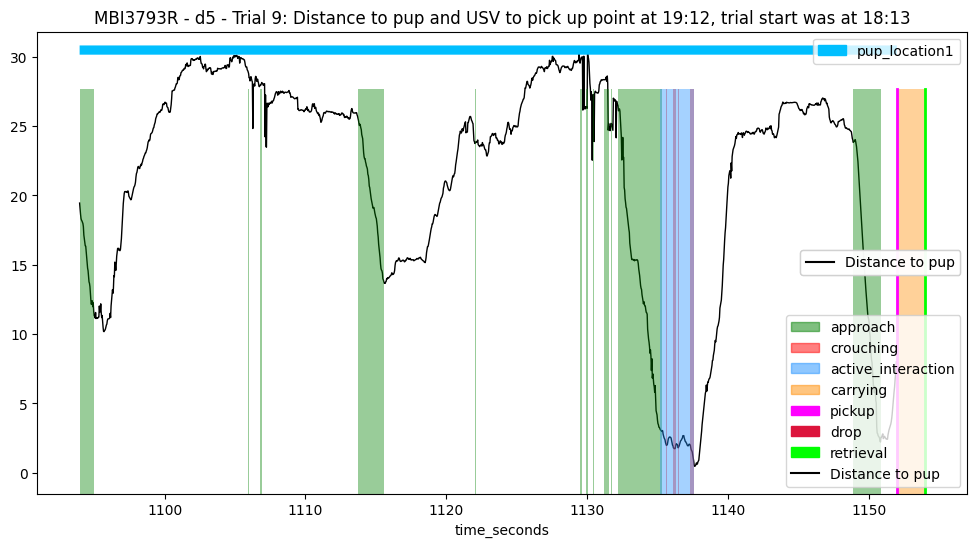

 ==== Example: MBI3793R - d6 - 1 ==== 
 ==== Example: MBI3793R - d6 - 1 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 582.964
* Success time: 583.812
---> Pick up frame: 17489, Start frame: 14246, End frame: 17514
---> Retrieval frame: 17514; Start frame: 14246; End frame: 17514
---> Final frame: 17514
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17489 * Pickup time:  582.964
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3269
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        2751
distance_head

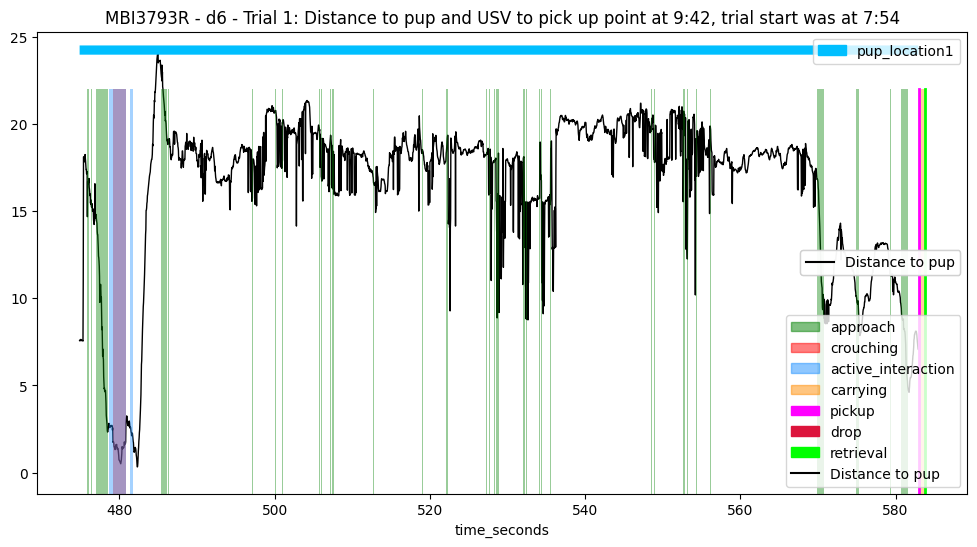

 ==== Example: MBI3793R - d6 - 2 ==== 
 ==== Example: MBI3793R - d6 - 2 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 598.42
* Success time: 602.412
---> Pick up frame: 17953, Start frame: 17858, End frame: 18072
---> Retrieval frame: 18072; Start frame: 17858; End frame: 18072
---> Final frame: 18072
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  17953 * Pickup time:  598.42
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 215
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        19
distance_head_to_p

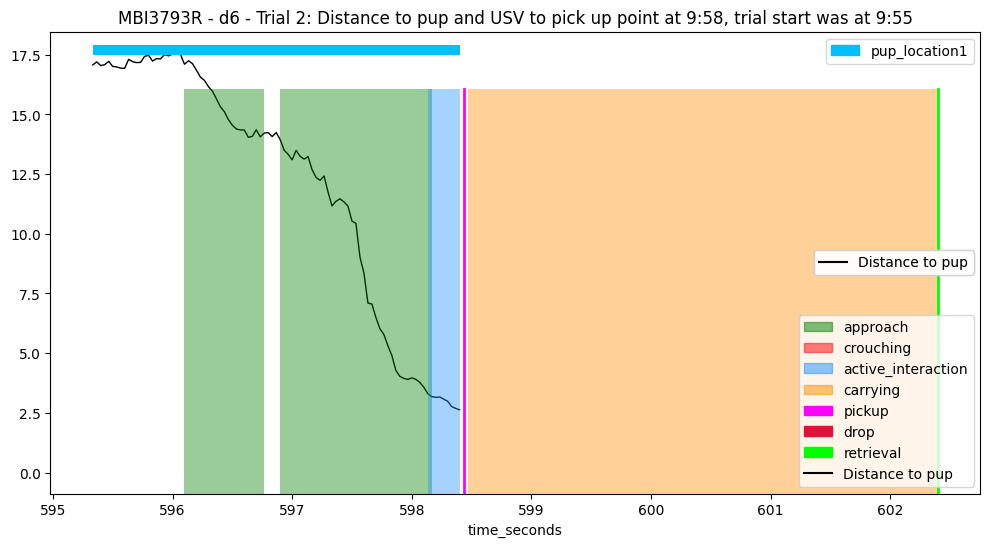

 ==== Example: MBI3793R - d6 - 3 ==== 
 ==== Example: MBI3793R - d6 - 3 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 638.0
* Success time: 640.004
---> Pick up frame: 19140, Start frame: 18435, End frame: 19200
---> Retrieval frame: 19200; Start frame: 18435; End frame: 19200
---> Final frame: 19200
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  19140 * Pickup time:  638.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 766
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 

===== After annotations edits:
drop   pickup  carrying  re

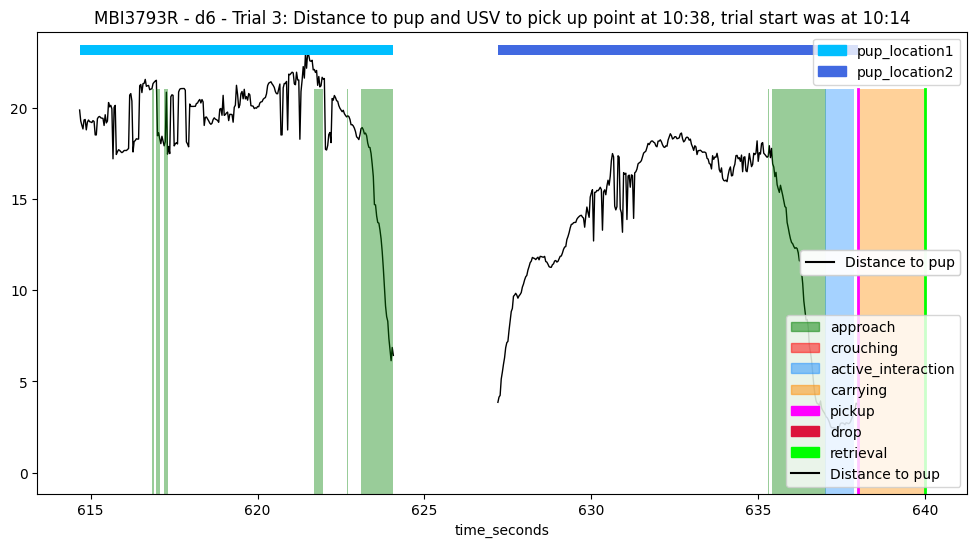

 ==== Example: MBI3793R - d6 - 4 ==== 
 ==== Example: MBI3793R - d6 - 4 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 663.092
* Success time: None
---> Pick up frame: 19893, Start frame: 19715, End frame: 23482
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  19893 * Pickup time:  663.092
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3768
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 19893, instantly drop at 19894
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        28
distance_head_to_

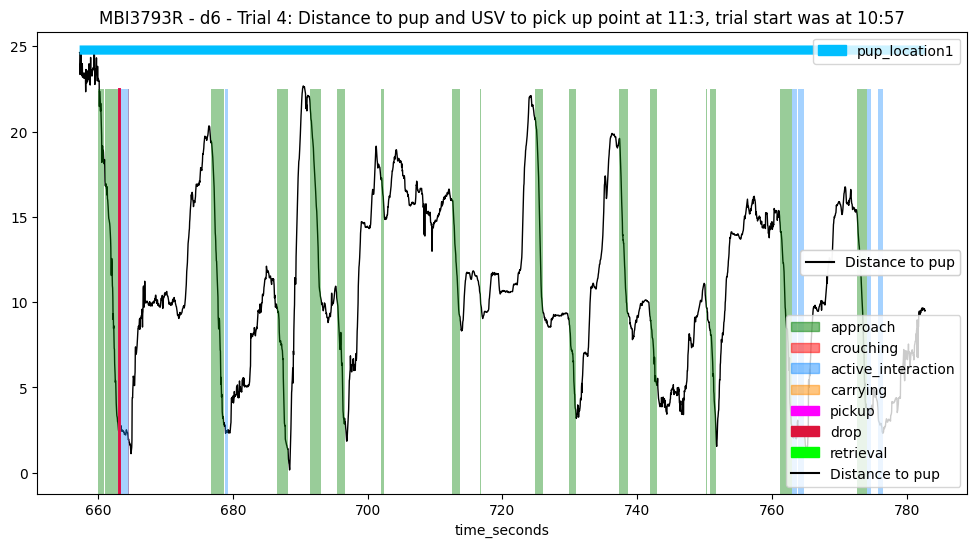

 ==== Example: MBI3793R - d6 - 5 ==== 
 ==== Example: MBI3793R - d6 - 5 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 852.0
* Success time: 856.0
---> Pick up frame: 25560, Start frame: 23774, End frame: 25680
---> Retrieval frame: 25680; Start frame: 23774; End frame: 25680
---> Final frame: 25680
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  25560 * Pickup time:  852.0
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 1907
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'none' 
Distance to next cluster is too big:  16.00807570186862

===

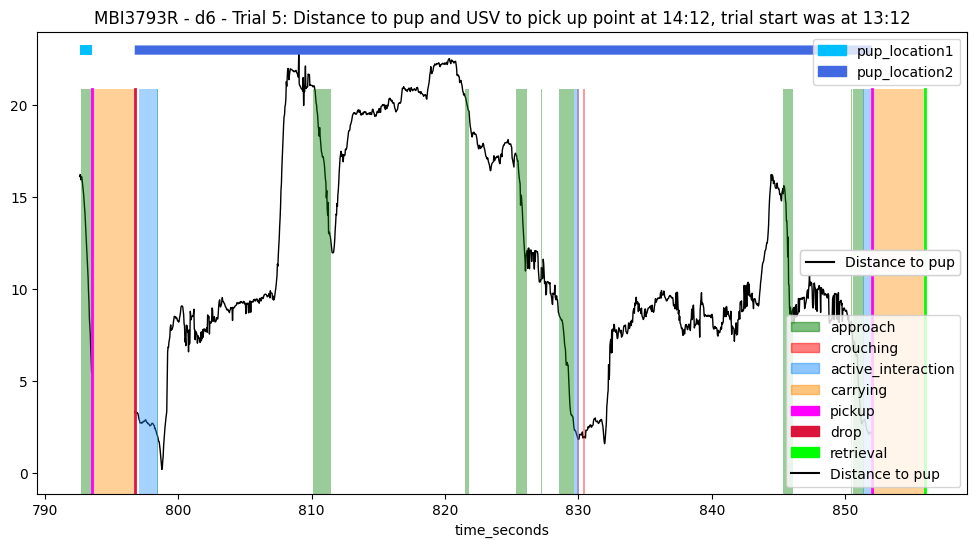

 ==== Example: MBI3793R - d6 - 6 ==== 
 ==== Example: MBI3793R - d6 - 6 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 884.092
* Success time: 887.108
---> Pick up frame: 26523, Start frame: 26232, End frame: 26613
---> Retrieval frame: 26613; Start frame: 26232; End frame: 26613
---> Final frame: 26613
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  26523 * Pickup time:  884.092
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 382
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'retrieval' 
NaN counts before forward fill:  distance_mouse_to_pup        3
distance_head_to_

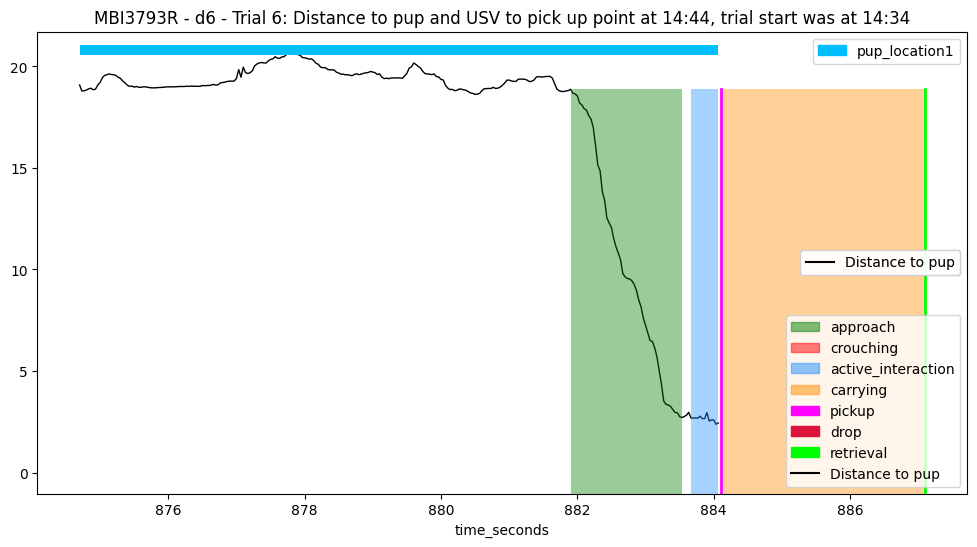

 ==== Example: MBI3793R - d6 - 7 ==== 
 ==== Example: MBI3793R - d6 - 7 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: None
* Success time: None
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  None * Pickup time:  None
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3675
Name: count, dtype: int64
====== pup_location1: pickup_type: 'none' success_type: 'failed' 
NaN counts before forward fill:  distance_mouse_to_pup        17
distance_head_to_pup         17
head_angle_to_pup_degrees    17
dtype: int64
---Overall NaN counts:  distance_mouse_to_pup        20
distance_head_to_pup         20
head_angle_to_pup_

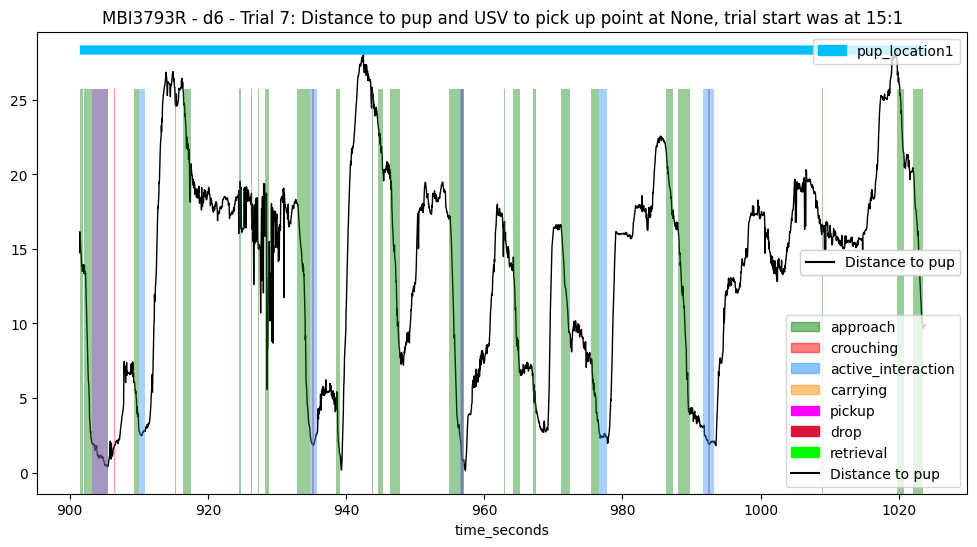

 ==== Example: MBI3793R - d6 - 8 ==== 
 ==== Example: MBI3793R - d6 - 8 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1073.429
* Success time: None
---> Pick up frame: 32203, Start frame: 30905, End frame: 34682
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  32203 * Pickup time:  1073.429
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3778
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 32203, instantly drop at 32204
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        38
distance_head_t

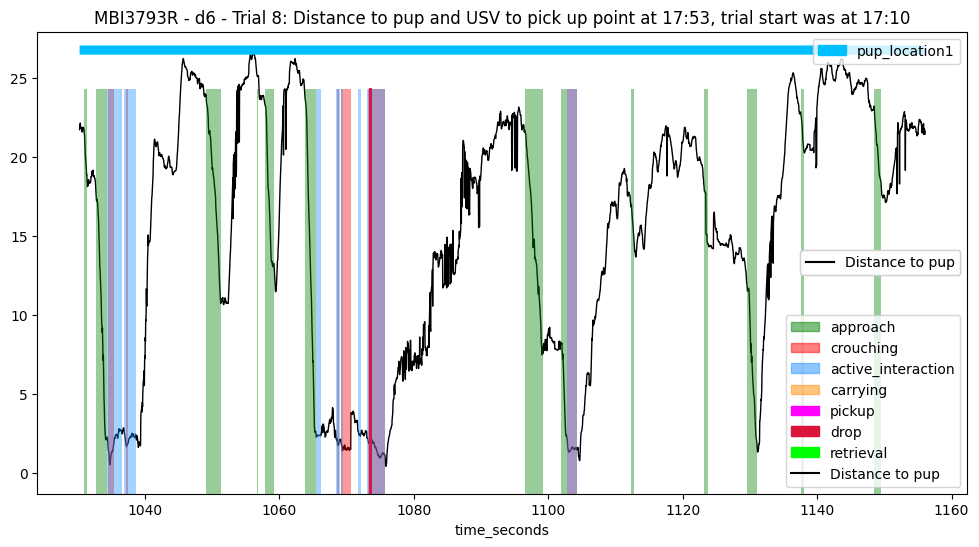

 ==== Example: MBI3793R - d6 - 9 ==== 
 ==== Example: MBI3793R - d6 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1162.677
* Success time: None
---> Pick up frame: 34880, Start frame: 34845, End frame: 38718
3.Assigning pick up and success types
Pup locations keys: ['pup_location1']
Last location: pup_location1
Pup locations no success: []
4.Computing distances
5.Annotating trial
* Pick up frame:  34880 * Pickup time:  1162.677
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 3874
Name: count, dtype: int64
====== pup_location1: pickup_type: 'included' success_type: 'failed' 
Pick up at 34880, instantly drop at 34881
---> Processing last pup location: pup_location1
NaN counts before forward fill:  distance_mouse_to_pup        29
distance_head_t

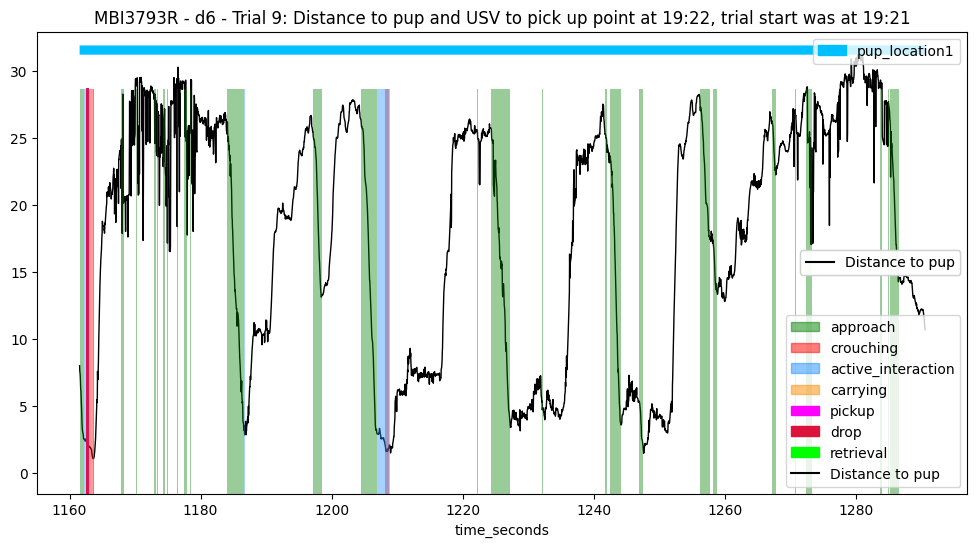

In [4]:
error_examples = []
trials_to_avoid = [("MBQ0012RR", "d6", i) for i in range(1, 10)] + [("VACO143LLR", "d6", 1), ("MBQ0231R", "d3", 5)]

for mouse_id in mouse_ids:
    for day in days:
        for trial_num in range(1, 10):

            print(f" ==== Example: {mouse_id} - {day} - {trial_num} ==== ")
            example = (mouse_id, day, trial_num)

            if example in trials_to_avoid:
                print(f" ==== Skipping example: {example} ==== ")
                continue

            try:
                trial_df =  copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["dlc_data"])
                df_summary = copy.deepcopy(experiment_data_processed[mouse_id][day]["Behavior"]["df_summary"])
                pup_locations = copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["pup_locations"])

                BA.run_pup_directed_behavior_annotation(mouse_id, day, trial_num,
                                                        trial_df, df_summary, pup_locations,
                                                        processed_data_dir = "annotated_data", export = True)
            except Exception as e:
                print(f"**** !!!! **** !!!! Error on example: {example} !!!! **** !!!! ****")
                error_examples.append(example)


### Treating error cases ###

In [4]:
error_examples = [] #[#('MBQ0231R', 'd5', 7),
 #('MBQ0231R', 'd5', 8),
 # ('MBI5336LL', 'd2', 6),
 # ('MBQ0012RR', 'd2', 9),
 # ('MBI5335RR', 'd4', 5), # attention
 #('VBQ0253LL', 'd6', 5),
 #('VAC0143LLR', 'd1', 8), # attention
 #('VAC0143LLR', 'd6', 3),
 #('VBQ0261L', 'd1', 3),
 # ('MBI3793R', 'd3', 9)]

 ==== Example: MBI3793R - d3 - 9 ==== 
1.Creating default columns
2.Marking existing times
* Pick up time: 1221.731
* Success time: 1232.067
---> Pick up frame: 36652, Start frame: 36500, End frame: 36962
---> Retrieval frame: 36962; Start frame: 36500; End frame: 36962
---> Final frame: 36962
3.Assigning pick up and success types
Pup locations keys: ['pup_location1', 'pup_location2']
Last location: pup_location2
Pup locations no success: ['pup_location1']
4.Computing distances
5.Annotating trial
* Pick up frame:  36652 * Pickup time:  1221.731
['distance_mouse_to_pup', 'distance_head_to_pup', 'head_angle_to_pup_degrees']
====== pup_location1: Annotation of carrying, pickup and drop  ======
Before annotation and analysis:
approach  crouching  active_interaction
False     False      False                 463
Name: count, dtype: int64
====== pup_location1: pickup_type: 'after' success_type: 'none' 
NaN counts before forward fill:  distance_mouse_to_pup        37
distance_head_to_pup     

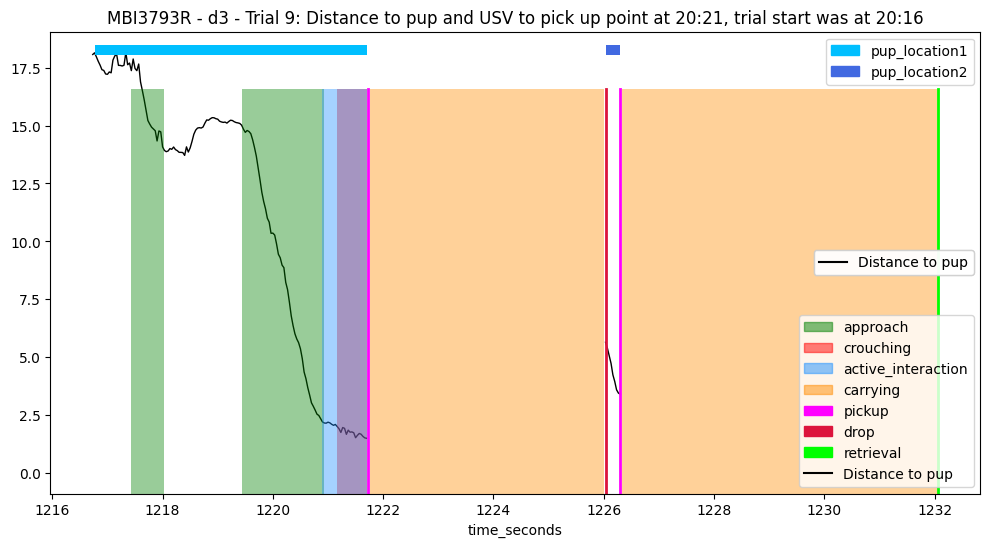

In [15]:
for example in [('MBI3793R', 'd3', 9)]:
    mouse_id, day, trial_num = example
    # try:
    trial_df =  copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["dlc_data"])
    df_summary = copy.deepcopy(experiment_data_processed[mouse_id][day]["Behavior"]["df_summary"])
    pup_locations = copy.deepcopy(experiment_data_processed[mouse_id][day]["trials"][trial_num]["pup_locations"])

    trial_df_annotated, pup_locations_annotated = BA.run_pup_directed_behavior_annotation(mouse_id, day, trial_num,
                                                trial_df, df_summary, pup_locations,
                                                processed_data_dir = "annotated_data", export = True)

    # BA.plot_behavioral_annotations(trial_df_annotated, df_summary, pup_locations_annotated,
    #                         mouse_id, day, trial_num,
    #                         start_time = None, end_time = 870, add_USV_plot = False, export_plot = False)

    # except Exception as e:
    #     print(f"**** !!!! **** !!!! Error on example: {example} !!!! **** !!!! ****")        
    #     print(e)

### Labeling passive behaviors ###

In [3]:
# load processed annotated data into a dictionary
BA = BehaviourAnnotator("config.json")
annotated_data_dir = "annotated_data"

mouse_ids = [mouse_id for mouse_id in os.listdir(annotated_data_dir) if os.path.isdir(os.path.join(annotated_data_dir, mouse_id)) and (mouse_id.startswith("M") or mouse_id.startswith("V"))]
mouse_ids = ["MBI3793R"]
days = [f"d{i}" for i in range(1, 7)]

processed_and_annotated_data = load_processed_data(annotated_data_dir, mouse_ids, days)


In [ ]:
def label_passive_behaviors_trials(BA, trial_df, df_summary):
    
    pup_x_col = BA.config["DLC_columns"]["pup"]["x"]
    pup_y_col = BA.config["DLC_columns"]["pup"]["y"]
    mouse_speed_col = BA.config["DLC_behaviour_columns"]["mouse_speed_px/s"]
    pixels_to_cm_ratio = BA.config["pixels_to_cm_ratio"]
    mouse_x_col = BA.config["DLC_columns"]["mouse"]["x"]
    mouse_y_col = BA.config["DLC_columns"]["mouse"]["y"]
    in_nest_col = BA.config["Behavioral_states"]["in_nest"]

    mouse_speed_cm = trial_df[mouse_speed_col] / pixels_to_cm_ratio
    mask_walking = (mouse_speed_cm > 5)
    mask_still = (mouse_speed_cm < 1)

    trial_df[BA.config["Behavioral_states"]["walking"]] = mask_walking
    trial_df[BA.config["Behavioral_states"]["still"]] = mask_still

    trial_df = BA.BF_instance.flag_nest_coordinates(trial_df, in_nest_col = in_nest_col,
                                                    x = mouse_x_col, y = mouse_y_col,
                                                    nest_bounds = BA.config["nest_bounds"])

    return trial_df


def resolve_simultaneous_labels(BA, trial_df):

    passive_behaviors = BA.config["passive_behaviors"]

    pass

In [ ]:
examples = [("MBI3793R", "d2", 1), ("MBI3793R", "d6", 9)]
